# Proyecto 3
Administración de Datos

**Estudiantes**:
* Alexa Coll
* David Corrales
* Raquel Mora

## Importaciones

### Librerías

In [ ]:
import torch
import torch.nn as nn
import torchvision.transforms as transforms
from torchvision.datasets import MNIST
from torch.utils.data import DataLoader
from torchvision import datasets, transforms
import matplotlib.pyplot as plt
import tensorflow as tf
import tensorflow_datasets as tfds
from torch.utils.data import DataLoader
import torch.optim as optim
import torchvision
import numpy as np
import imageio
import glob
import os

### Cargar Datasets

Transformación para pasar a tensores y normalizar los datos.

In [ ]:
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))
])

In [ ]:
mnist_trainset = datasets.MNIST(root='./data', train=True, download=True, transform=transform)
mnist_testset = datasets.MNIST(root='./data', train=False, download=True, transform=transform)

fashion_mnist_trainset = datasets.FashionMNIST(root='./data', train=True, download=True, transform=transform)
fashion_mnist_testset = datasets.FashionMNIST(root='./data', train=False, download=True, transform=transform)

In [ ]:
batch_size = 64

In [ ]:
mnist_train_loader = DataLoader(mnist_trainset, batch_size=batch_size, shuffle=True)

In [ ]:
fashion_mnist_train_loader = DataLoader(fashion_mnist_trainset, batch_size=batch_size, shuffle=True)

## Exploración y preprocesamiento de datos

Funciones generales

In [ ]:
def dataset_info(dataset, name):
    print(f"Dataset: {name}")
    print("Total de imágenes:", len(dataset))
    print("Dimensiones de cada imagen:", dataset.data.shape[1:], "píxeles")
    print("Número de clases:", len(dataset.classes))
    print("Clases y sus correspondientes etiquetas:", dataset.classes)
    print()

In [ ]:
def show_images(dataset, title):
    plt.figure(figsize=(10, 10))
    for i in range(25):
        plt.subplot(5, 5, i + 1)
        plt.xticks([])
        plt.yticks([])
        plt.grid(False)
        plt.imshow(dataset.data[i], cmap=plt.cm.binary)
        plt.xlabel(dataset.classes[dataset.targets[i]])
    plt.suptitle(title)
    plt.show()

In [ ]:
def plot_class_distribution(dataset, title):
    labels, counts = zip(*[(cls, (dataset.targets == idx).sum().item()) for idx, cls in enumerate(dataset.classes)])
    fig, ax = plt.subplots(figsize=(12, 6))
    bars = ax.bar(labels, counts, color='blue', alpha=0.7)
    ax.set_title(f'Class Distribution in {title}')
    ax.set_xlabel('Class Name')
    ax.set_ylabel('Frequency')
    for bar in bars:
        yval = bar.get_height()
        ax.text(bar.get_x() + bar.get_width()/2, yval, int(yval), va='bottom')

    plt.xticks(rotation=45)
    plt.show()


### MNIST Data Set

In [ ]:
mnist_trainset.data

tensor([[[0, 0, 0,  ..., 0, 0, 0],
         [0, 0, 0,  ..., 0, 0, 0],
         [0, 0, 0,  ..., 0, 0, 0],
         ...,
         [0, 0, 0,  ..., 0, 0, 0],
         [0, 0, 0,  ..., 0, 0, 0],
         [0, 0, 0,  ..., 0, 0, 0]],

        [[0, 0, 0,  ..., 0, 0, 0],
         [0, 0, 0,  ..., 0, 0, 0],
         [0, 0, 0,  ..., 0, 0, 0],
         ...,
         [0, 0, 0,  ..., 0, 0, 0],
         [0, 0, 0,  ..., 0, 0, 0],
         [0, 0, 0,  ..., 0, 0, 0]],

        [[0, 0, 0,  ..., 0, 0, 0],
         [0, 0, 0,  ..., 0, 0, 0],
         [0, 0, 0,  ..., 0, 0, 0],
         ...,
         [0, 0, 0,  ..., 0, 0, 0],
         [0, 0, 0,  ..., 0, 0, 0],
         [0, 0, 0,  ..., 0, 0, 0]],

        ...,

        [[0, 0, 0,  ..., 0, 0, 0],
         [0, 0, 0,  ..., 0, 0, 0],
         [0, 0, 0,  ..., 0, 0, 0],
         ...,
         [0, 0, 0,  ..., 0, 0, 0],
         [0, 0, 0,  ..., 0, 0, 0],
         [0, 0, 0,  ..., 0, 0, 0]],

        [[0, 0, 0,  ..., 0, 0, 0],
         [0, 0, 0,  ..., 0, 0, 0],
         [0,

In [ ]:
dataset_info(mnist_trainset, "MNIST Training Set")
dataset_info(mnist_testset, "MNIST Test Set")

Dataset: MNIST Training Set
Total de imágenes: 60000
Dimensiones de cada imagen: torch.Size([28, 28]) píxeles
Número de clases: 10
Clases y sus correspondientes etiquetas: ['0 - zero', '1 - one', '2 - two', '3 - three', '4 - four', '5 - five', '6 - six', '7 - seven', '8 - eight', '9 - nine']

Dataset: MNIST Test Set
Total de imágenes: 10000
Dimensiones de cada imagen: torch.Size([28, 28]) píxeles
Número de clases: 10
Clases y sus correspondientes etiquetas: ['0 - zero', '1 - one', '2 - two', '3 - three', '4 - four', '5 - five', '6 - six', '7 - seven', '8 - eight', '9 - nine']



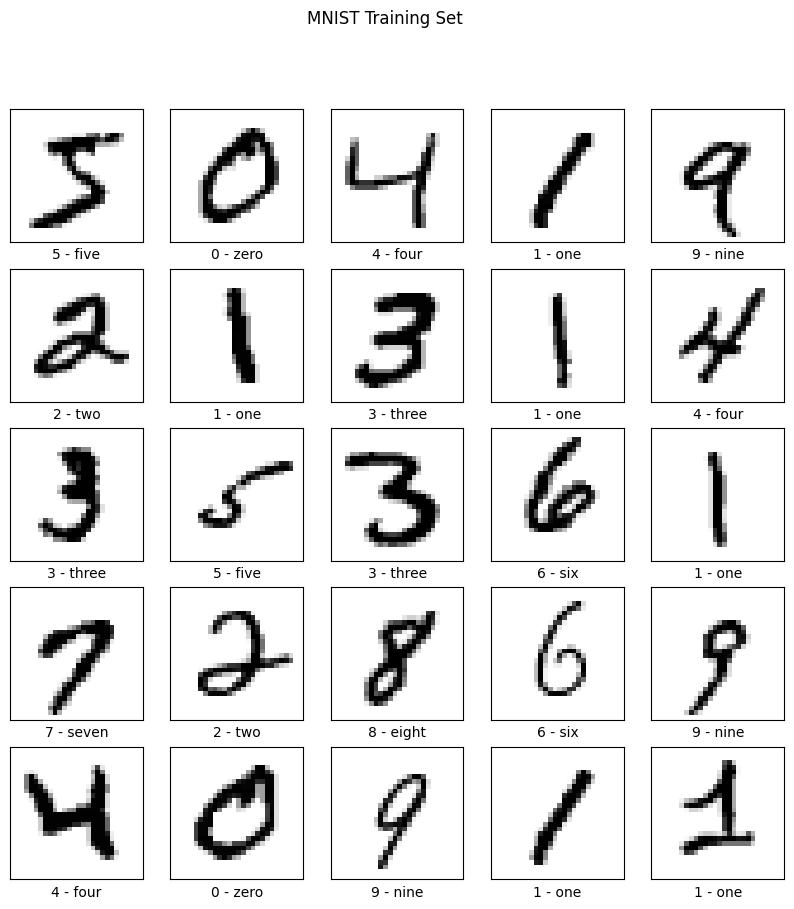

In [ ]:
show_images(mnist_trainset, "MNIST Training Set")

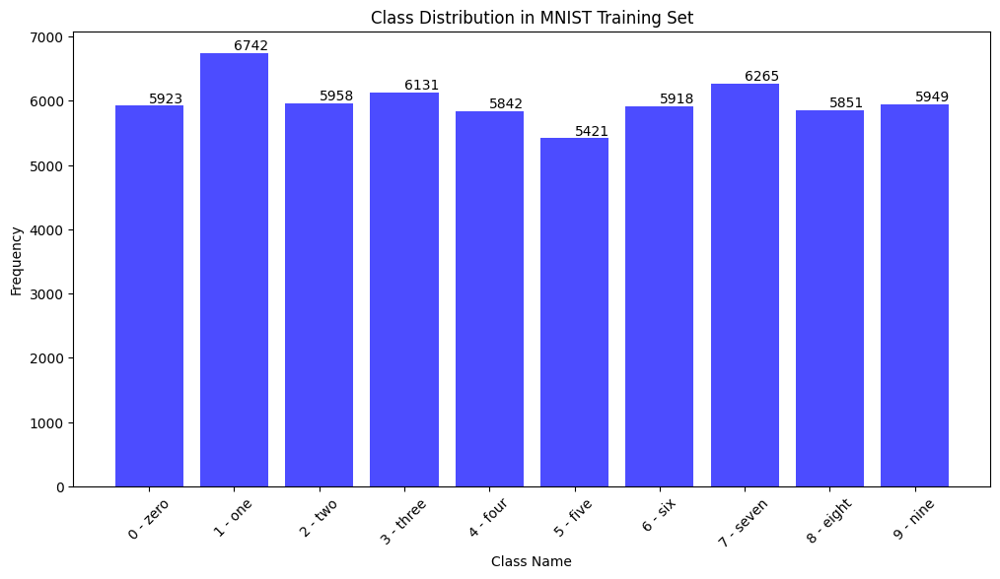

In [ ]:
plot_class_distribution(mnist_trainset, "MNIST Training Set")

### Fashion MNSIT Dataset

In [ ]:
dataset_info(fashion_mnist_trainset, "Fashion MNIST Training Set")
dataset_info(fashion_mnist_testset, "Fashion MNIST Test Set")

Dataset: Fashion MNIST Training Set
Total de imágenes: 60000
Dimensiones de cada imagen: torch.Size([28, 28]) píxeles
Número de clases: 10
Clases y sus correspondientes etiquetas: ['T-shirt/top', 'Trouser', 'Pullover', 'Dress', 'Coat', 'Sandal', 'Shirt', 'Sneaker', 'Bag', 'Ankle boot']

Dataset: Fashion MNIST Test Set
Total de imágenes: 10000
Dimensiones de cada imagen: torch.Size([28, 28]) píxeles
Número de clases: 10
Clases y sus correspondientes etiquetas: ['T-shirt/top', 'Trouser', 'Pullover', 'Dress', 'Coat', 'Sandal', 'Shirt', 'Sneaker', 'Bag', 'Ankle boot']



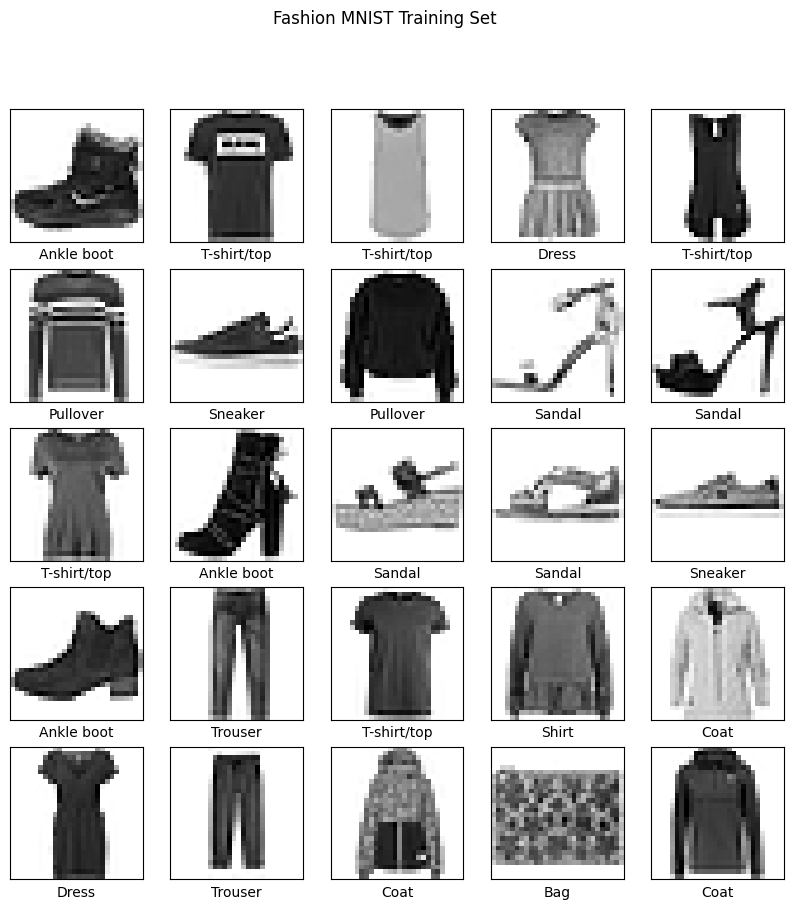

In [ ]:
show_images(fashion_mnist_trainset, "Fashion MNIST Training Set")

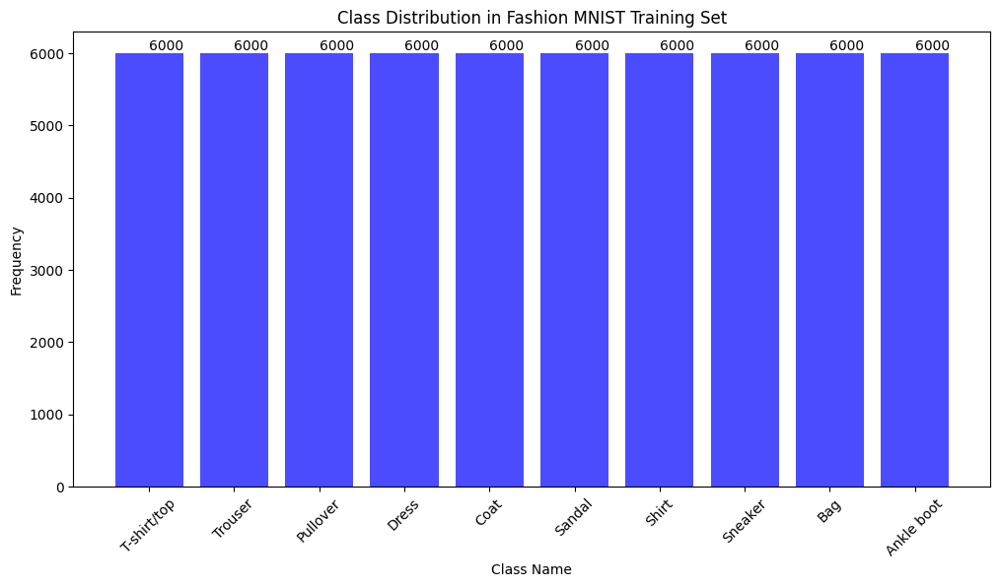

In [ ]:
plot_class_distribution(fashion_mnist_trainset, "Fashion MNIST Training Set")

In [ ]:
fashion_mnist_trainset.data

tensor([[[0, 0, 0,  ..., 0, 0, 0],
         [0, 0, 0,  ..., 0, 0, 0],
         [0, 0, 0,  ..., 0, 0, 0],
         ...,
         [0, 0, 0,  ..., 0, 0, 0],
         [0, 0, 0,  ..., 0, 0, 0],
         [0, 0, 0,  ..., 0, 0, 0]],

        [[0, 0, 0,  ..., 0, 0, 0],
         [0, 0, 0,  ..., 0, 0, 0],
         [0, 0, 0,  ..., 0, 0, 0],
         ...,
         [0, 0, 0,  ..., 0, 0, 0],
         [0, 0, 0,  ..., 0, 0, 0],
         [0, 0, 0,  ..., 0, 0, 0]],

        [[0, 0, 0,  ..., 0, 0, 0],
         [0, 0, 0,  ..., 0, 0, 0],
         [0, 0, 0,  ..., 0, 0, 0],
         ...,
         [0, 0, 0,  ..., 0, 0, 0],
         [0, 0, 0,  ..., 0, 0, 0],
         [0, 0, 0,  ..., 0, 0, 0]],

        ...,

        [[0, 0, 0,  ..., 0, 0, 0],
         [0, 0, 0,  ..., 0, 0, 0],
         [0, 0, 0,  ..., 0, 0, 0],
         ...,
         [0, 0, 0,  ..., 0, 0, 0],
         [0, 0, 0,  ..., 0, 0, 0],
         [0, 0, 0,  ..., 0, 0, 0]],

        [[0, 0, 0,  ..., 0, 0, 0],
         [0, 0, 0,  ..., 0, 0, 0],
         [0,

## Diseño y Entrenamiento de GAN

### Diseño

#### GAN Sencilla

##### Discriminador GAN

In [ ]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.model = nn.Sequential(
            nn.Linear(784, 512),
            nn.LeakyReLU(0.2),
            nn.Linear(512, 256),
            nn.LeakyReLU(0.2),
            nn.Linear(256, 1),
            nn.Sigmoid()  # Sigmoid para clasificar como real o falso
        )

    def forward(self, x):
        x = x.view(-1, 784)  # Aplanar la imagen
        return self.model(x)

##### Generador GAN

In [ ]:
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.model = nn.Sequential(
            nn.Linear(100, 256),
            nn.ReLU(),
            nn.Linear(256, 512),
            nn.ReLU(),
            nn.Linear(512, 784),
            nn.Tanh()
        )

    def forward(self, x):
        return self.model(x).view(-1, 1, 28, 28)

#### CGAN

##### Discriminador

In [ ]:
class DiscriminatorCGAN(nn.Module):
    def __init__(self):
        super(DiscriminatorCGAN, self).__init__()
        self.label_emb = nn.Embedding(10, 10)

        self.model = nn.Sequential(
            nn.Linear(784 + 10, 512),  # Entrada imagen aplanada (784) + etiqueta (10)
            nn.LeakyReLU(0.2),
            nn.Linear(512, 256),
            nn.LeakyReLU(0.2),
            nn.Linear(256, 1),
            nn.Sigmoid()
        )

    def forward(self, img, labels):
        # Aplanar la imagen y concatenar con la etiqueta incrustada
        img_flat = img.view(img.size(0), -1)
        c = self.label_emb(labels)
        x = torch.cat([img_flat, c], 1)
        return self.model(x)

##### Generador

In [ ]:
class GeneratorCGAN(nn.Module):
    def __init__(self):
        super(GeneratorCGAN, self).__init__()
        self.label_emb = nn.Embedding(10, 10)  # Embedding para 10 clases

        self.model = nn.Sequential(
            nn.Linear(100 + 10, 256),  # Entrada ruido (100) + etiqueta (10)
            nn.ReLU(),
            nn.Linear(256, 512),
            nn.ReLU(),
            nn.Linear(512, 1024),
            nn.ReLU(),
            nn.Linear(1024, 784),
            nn.Tanh()  # Salida de la forma del tamaño de imagen MNIST (28*28)
        )

    def forward(self, noise, labels):
        # Incrustar etiquetas y concatenar con el ruido
        c = self.label_emb(labels)
        x = torch.cat([noise, c], 1)
        return self.model(x).view(-1, 1, 28, 28)

### Entrenamiento

In [ ]:
def plot_metrics(G_losses, D_losses, D_real_accuracy, D_fake_accuracy):
    fig, axs = plt.subplots(2, 1, figsize=(10, 10))

    # Gráfica de pérdidas
    axs[0].plot(G_losses, label='Generador')
    axs[0].plot(D_losses, label='Discriminador')
    axs[0].set_ylabel('Pérdida')
    axs[0].set_title('Pérdida del Generador y Discriminador')
    axs[0].legend()

    # Gráfica de precisión del discriminador
    axs[1].plot(D_real_accuracy, label='Real')
    axs[1].plot(D_fake_accuracy, label='Falso')
    axs[1].set_ylabel('Precisión')
    axs[1].set_title('Precisión del Discriminador en Clasificar Imágenes Reales y Falsas')
    axs[1].legend()

    plt.xlabel('Épocas')
    plt.show()

In [ ]:
def show_generated_images(generator, device, labels=None, noise_dim=100, num_images=25):
    with torch.no_grad():
        noise = torch.randn(num_images, noise_dim, device=device)
        if labels is not None:
            labels = torch.randint(0, 10, (num_images,), device=device)
            images = generator(noise, labels).cpu()
        else:
            images = generator(noise).cpu()
        images = (images + 1) / 2  # Desnormalizar
        images_grid = torchvision.utils.make_grid(images, nrow=5, normalize=True)
        plt.figure(figsize=(8, 8))
        plt.imshow(np.transpose(images_grid, (1, 2, 0)))
        plt.axis('off')
        plt.show()

In [ ]:
def save_generated_images(generator, device, epoch, noise_dim=100, num_images=25, save_dir='generated_images', num_classes=10):
    # Asegurarse de que el directorio existe
    os.makedirs(save_dir, exist_ok=True)

    with torch.no_grad():
        # Generar ruido aleatorio
        noise = torch.randn(num_images, noise_dim, device=device)
        # Generar etiquetas aleatorias para CGAN
        labels = torch.randint(0, num_classes, (num_images,), device=device)

        # Generar imágenes
        if isinstance(generator, GeneratorCGAN):  # Chequea si el generador es CGAN
            images = generator(noise, labels).cpu()
        else:
            images = generator(noise).cpu()

        images = (images + 1) / 2  # Desnormalizar a [0,1] para guardar correctamente como imagen
        images_grid = torchvision.utils.make_grid(images, nrow=5, normalize=True)
        # Guardar la imagen a disco
        torchvision.utils.save_image(images_grid, os.path.join(save_dir, f"epoch_{epoch}.png"))

In [ ]:
def create_gif(image_folder, gif_name='training_progress.gif'):
    images = []
    for file_name in sorted(glob.glob(f"{image_folder}/*.png"), key=os.path.getmtime):
        images.append(imageio.imread(file_name))
    imageio.mimsave(gif_name, images, fps=2)  # Ajusta el fps según lo rápido que quieras que se mueva el GIF

#### MNIST Dataset

##### GAN Simple

<ipython-input-51-902d87a423af>:4: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  images.append(imageio.imread(file_name))


Epoch 1/30 completed


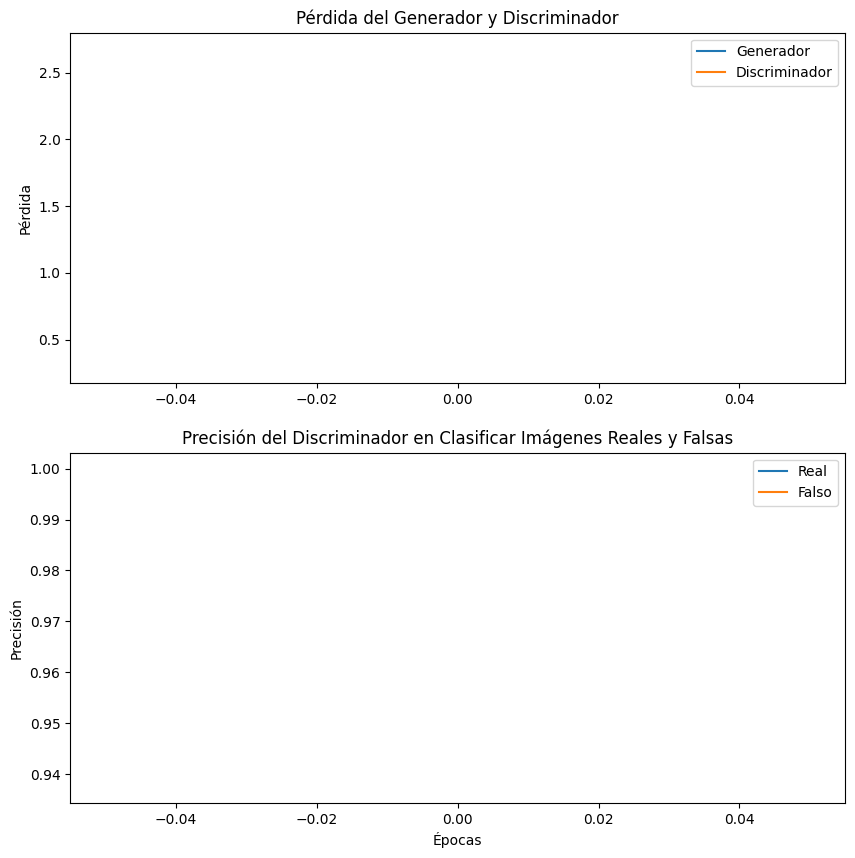

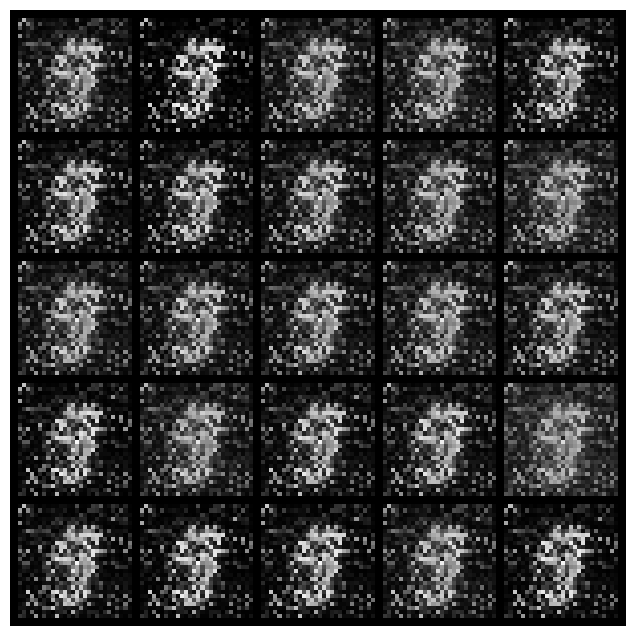

Discriminator Accuracy: 0.8739333333333333, Generator Accuracy: 0.8082833333333334
Epoch 2/30 completed


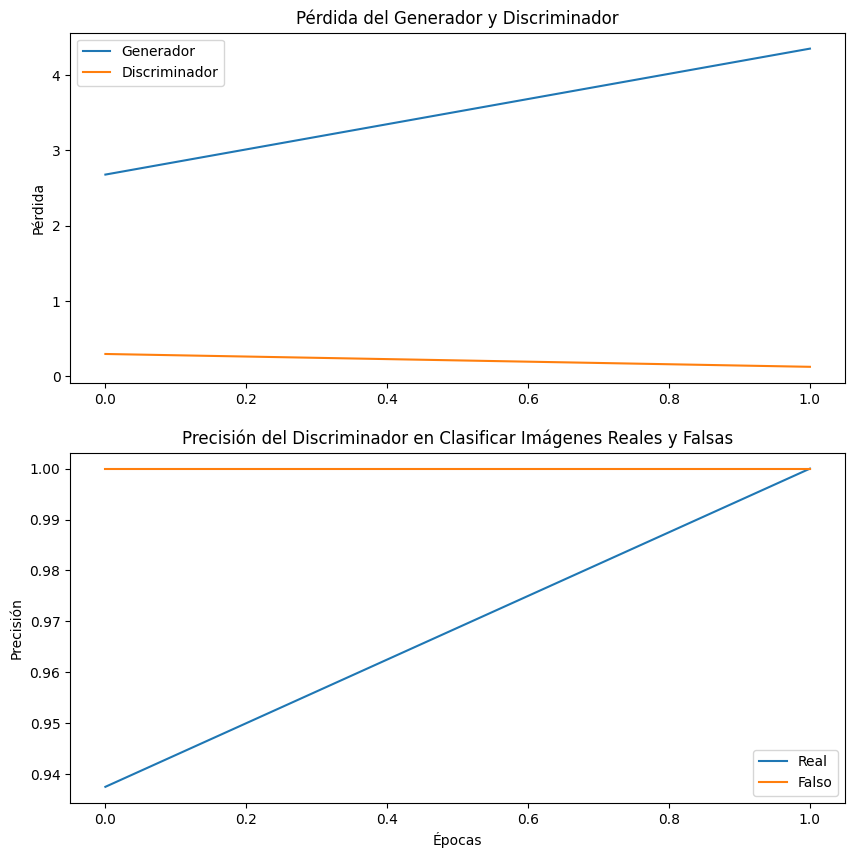

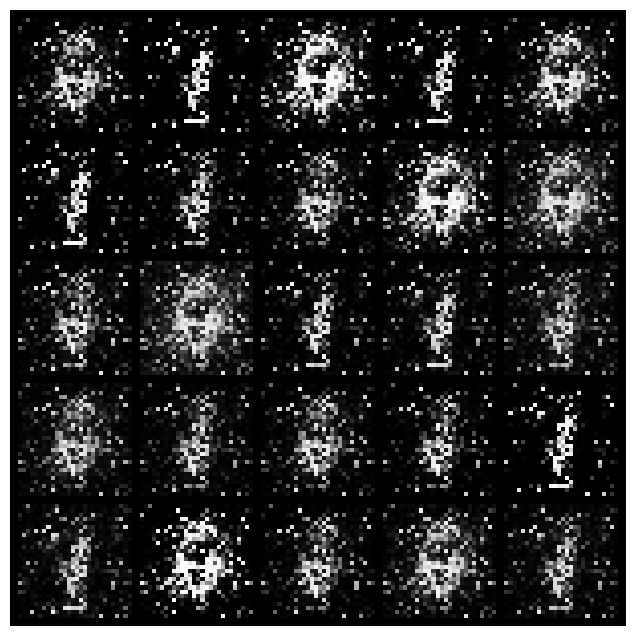

Discriminator Accuracy: 0.9632, Generator Accuracy: 0.9790833333333333
Epoch 3/30 completed


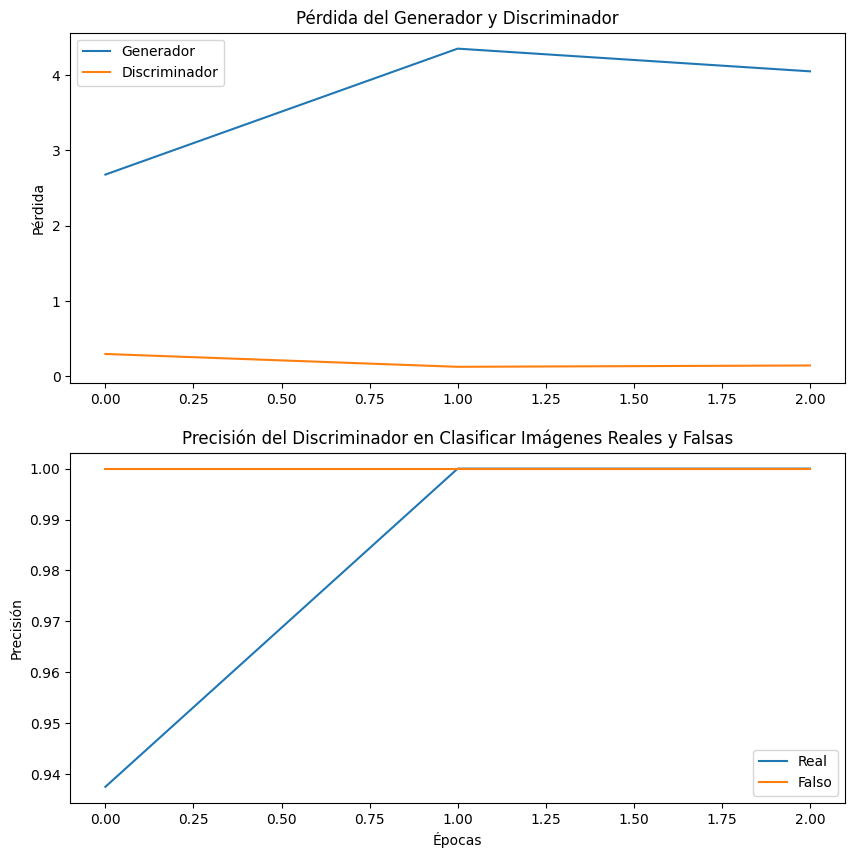

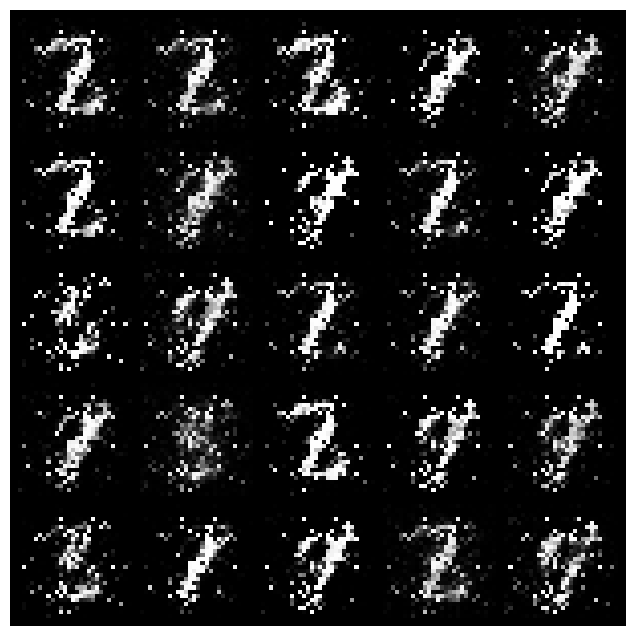

Discriminator Accuracy: 0.9552833333333334, Generator Accuracy: 0.9771666666666666
Epoch 4/30 completed


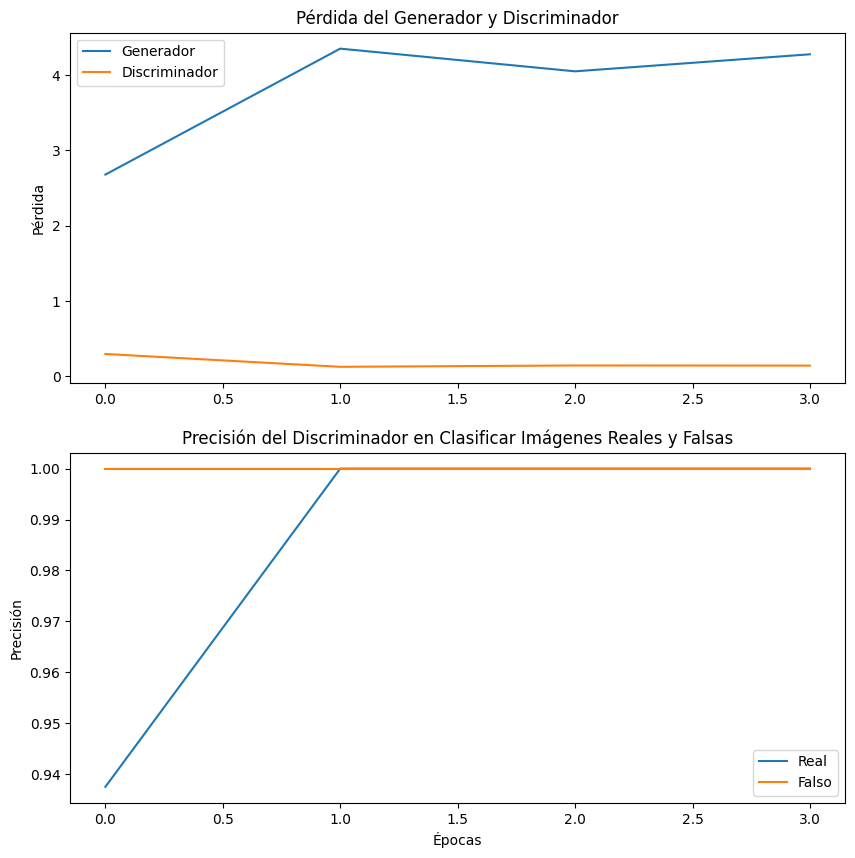

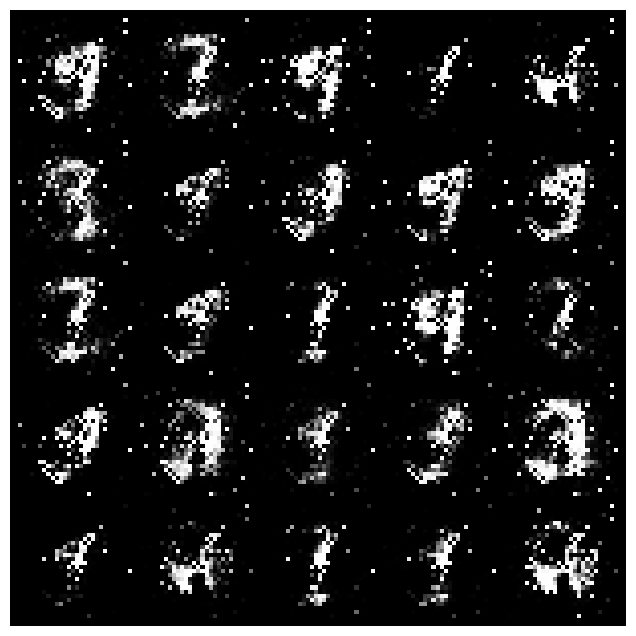

Discriminator Accuracy: 0.9539583333333334, Generator Accuracy: 0.9730666666666666
Epoch 5/30 completed


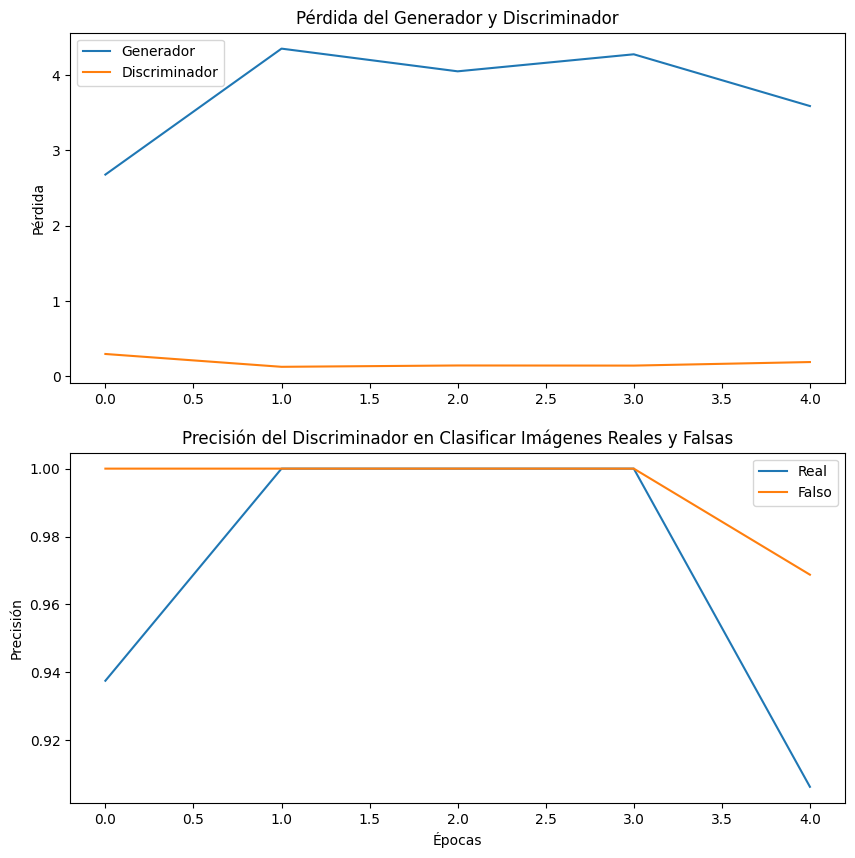

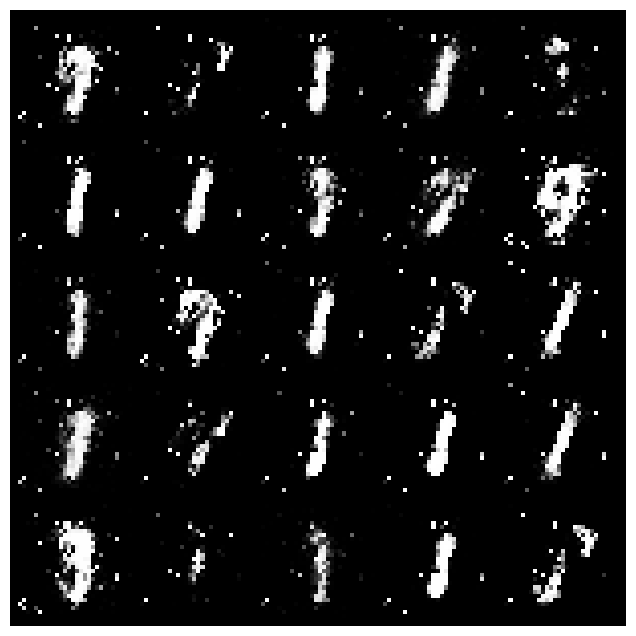

Discriminator Accuracy: 0.933925, Generator Accuracy: 0.9616333333333333
Epoch 6/30 completed


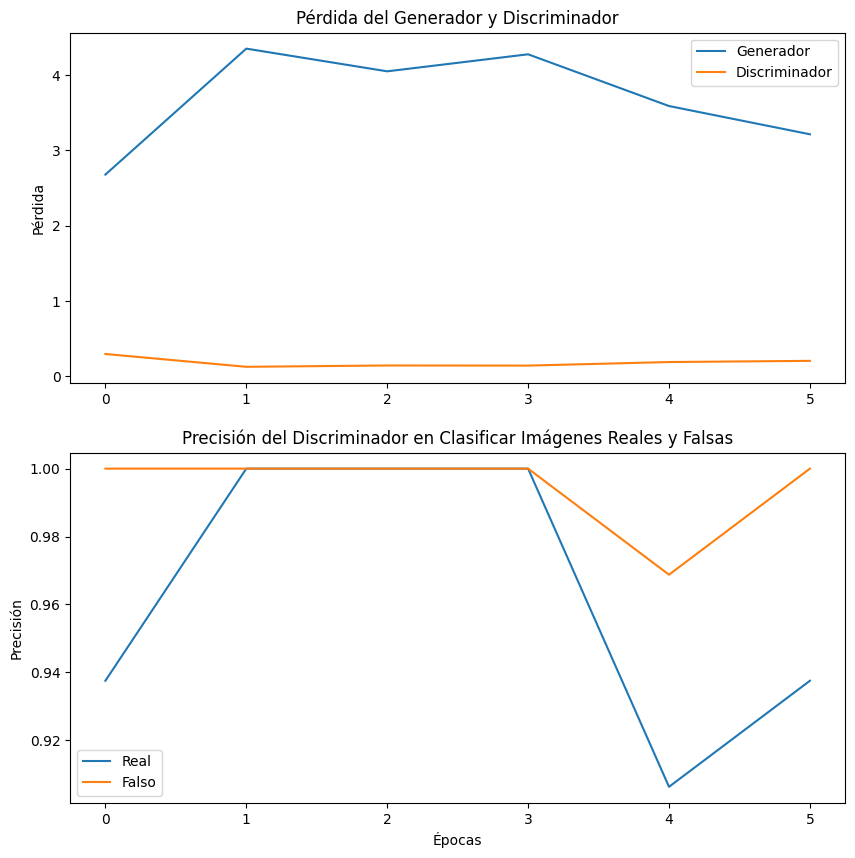

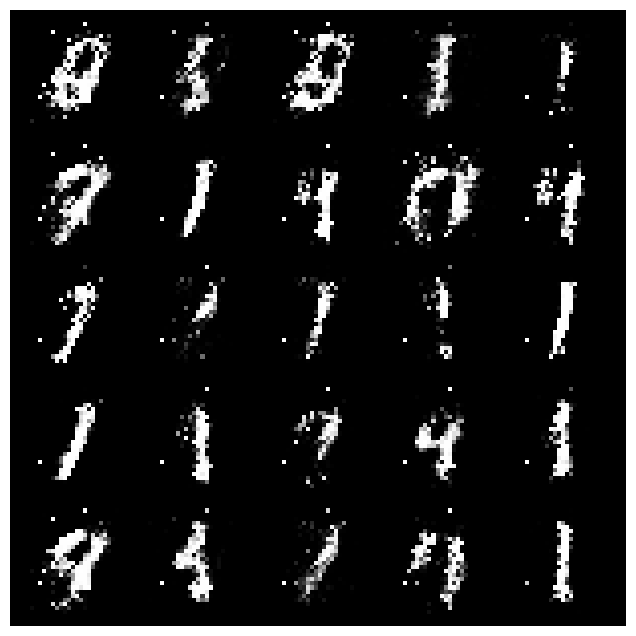

Discriminator Accuracy: 0.925725, Generator Accuracy: 0.9583333333333334
Epoch 7/30 completed


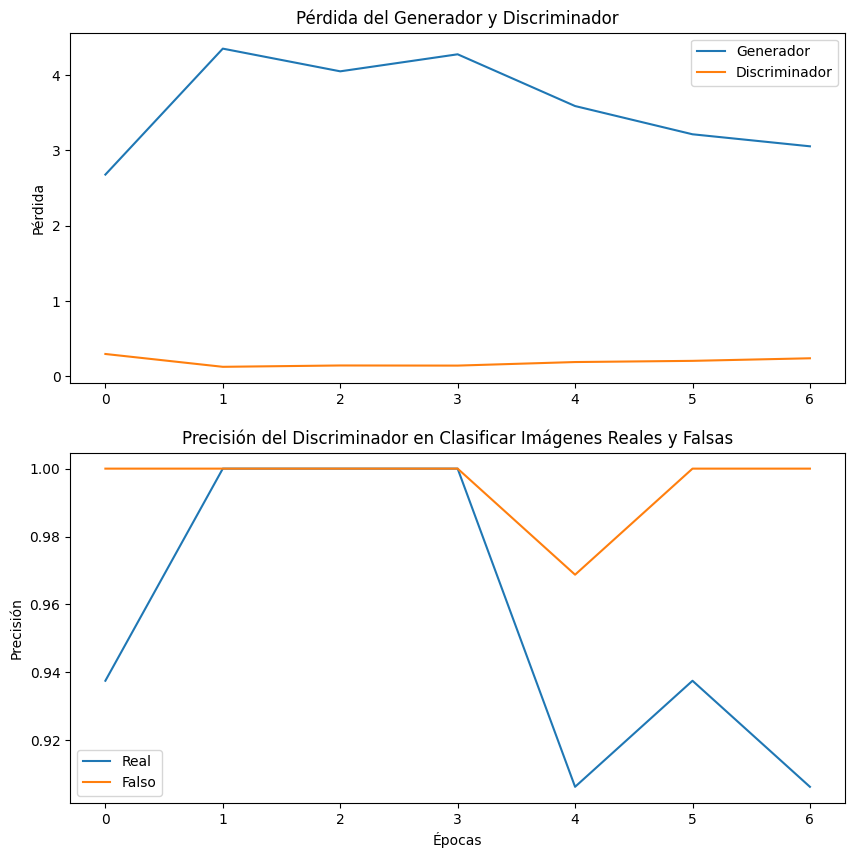

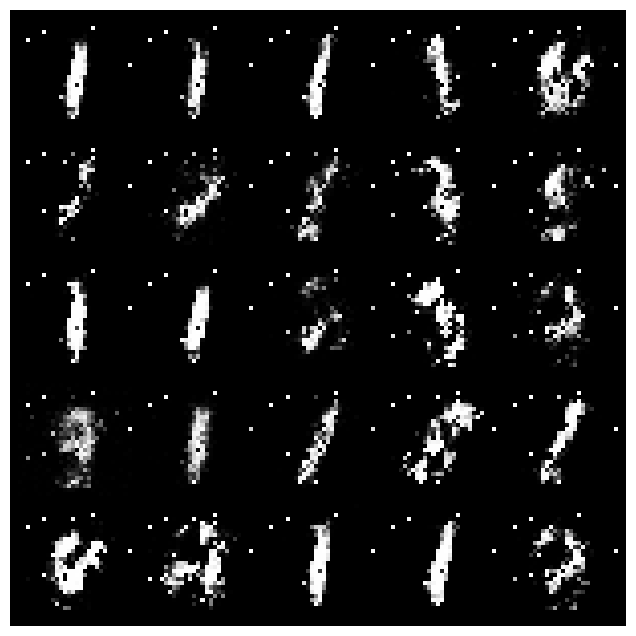

Discriminator Accuracy: 0.9110166666666667, Generator Accuracy: 0.9465333333333333
Epoch 8/30 completed


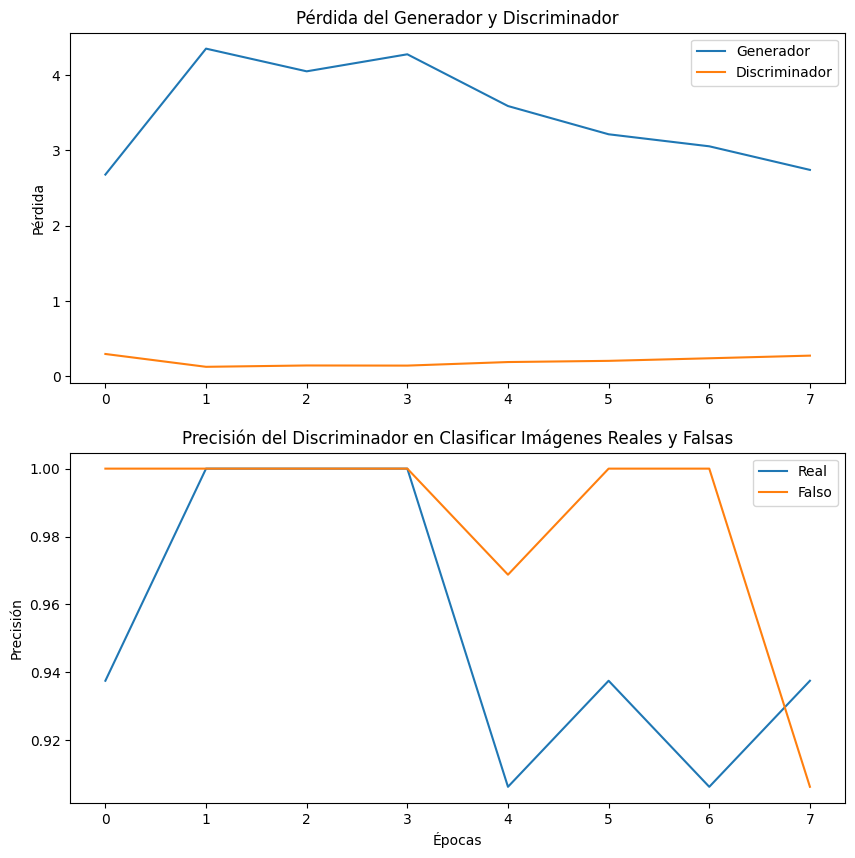

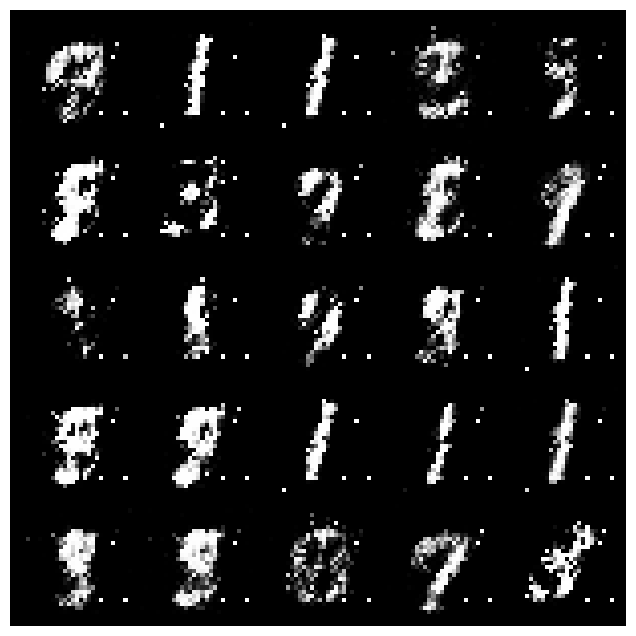

Discriminator Accuracy: 0.8920583333333333, Generator Accuracy: 0.9332833333333334
Epoch 9/30 completed


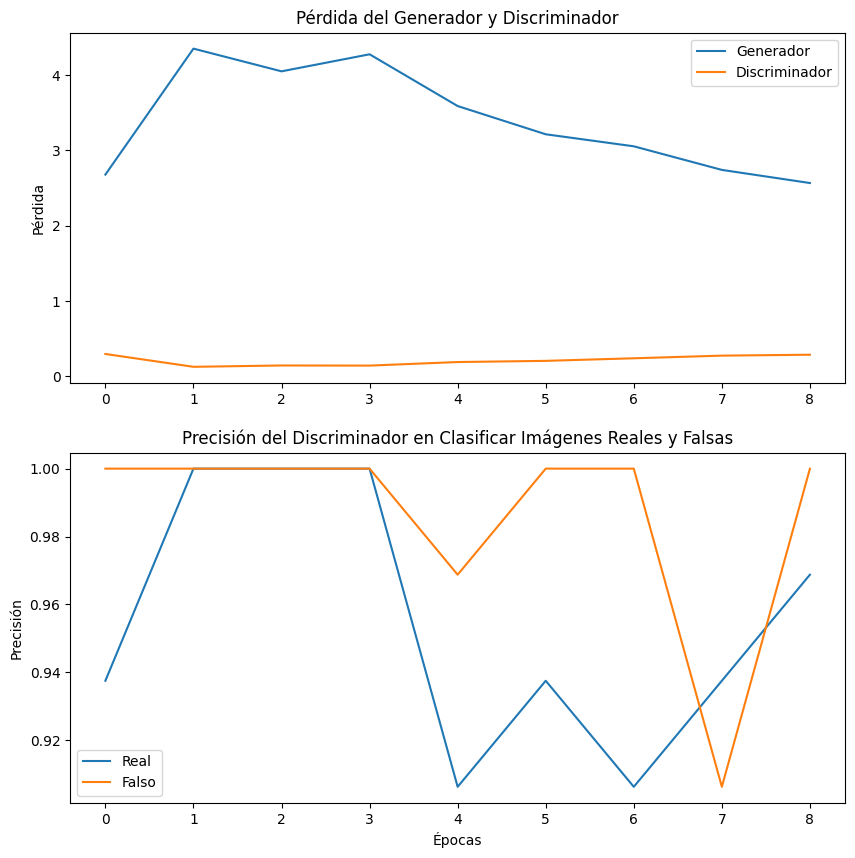

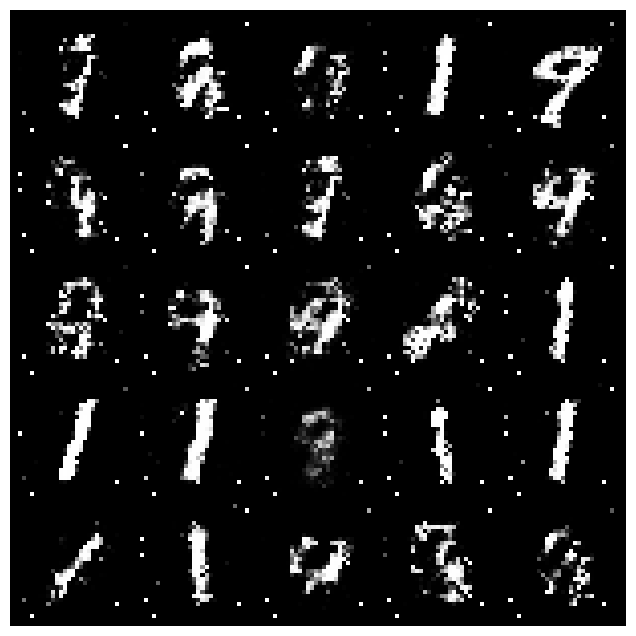

Discriminator Accuracy: 0.884575, Generator Accuracy: 0.9292666666666667
Epoch 10/30 completed


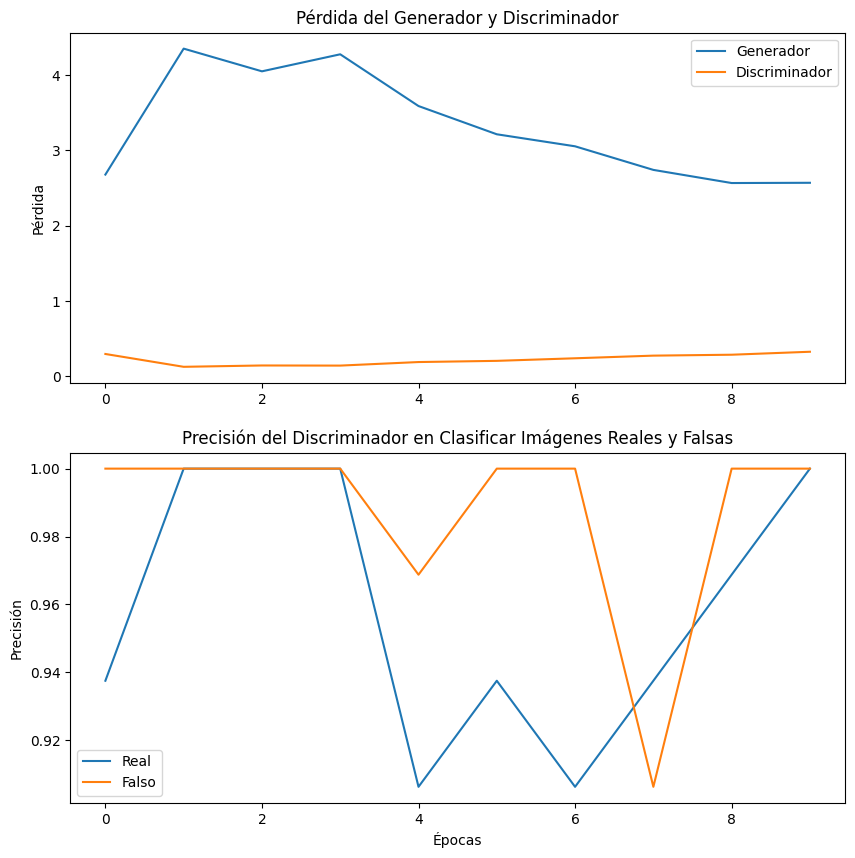

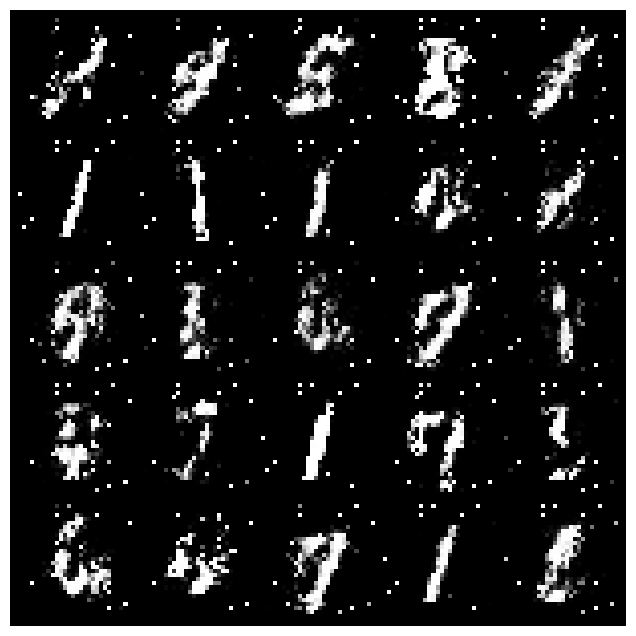

Discriminator Accuracy: 0.8631583333333334, Generator Accuracy: 0.902
Epoch 11/30 completed


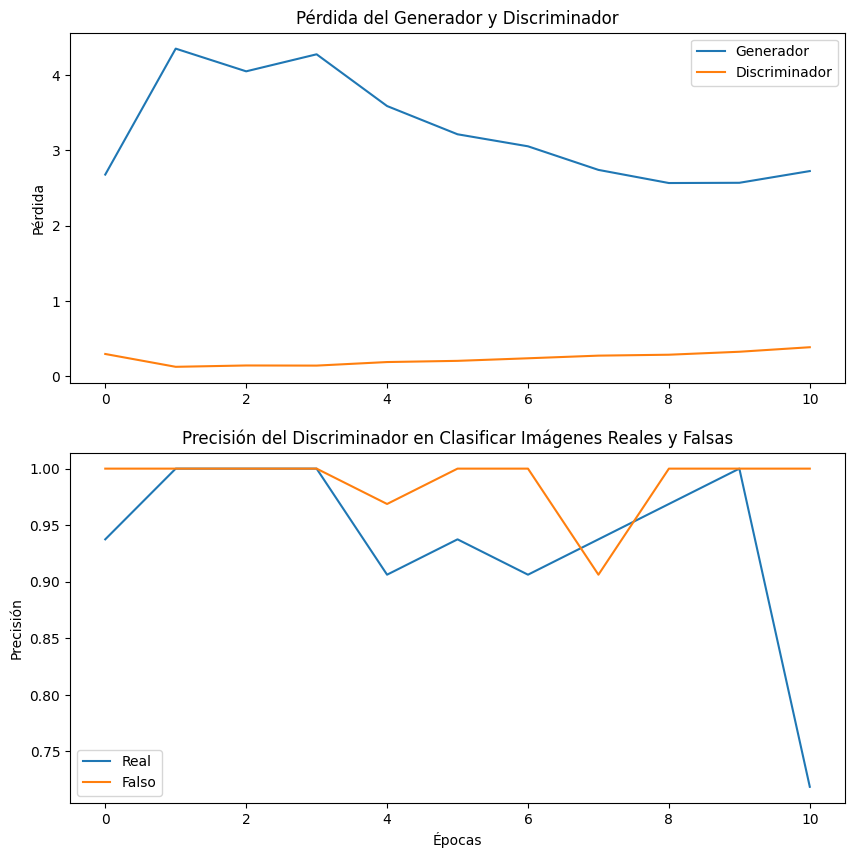

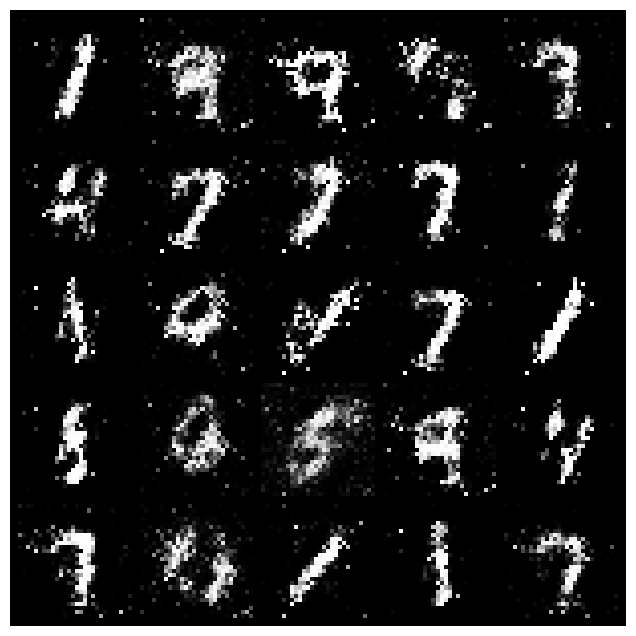

Discriminator Accuracy: 0.8303333333333334, Generator Accuracy: 0.8534833333333334
Epoch 12/30 completed


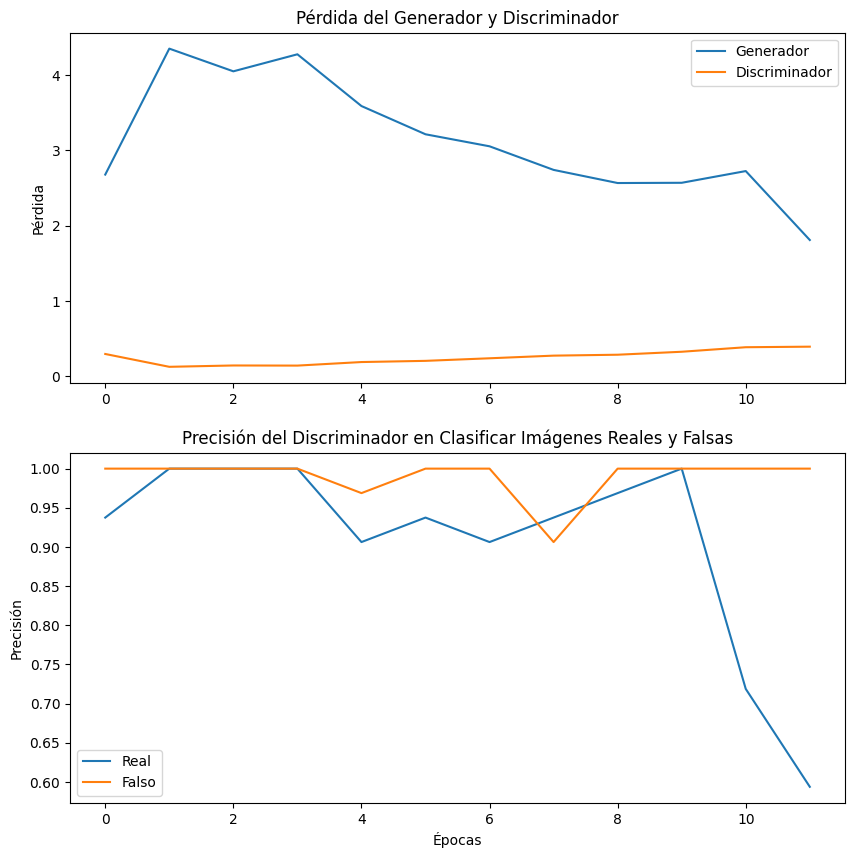

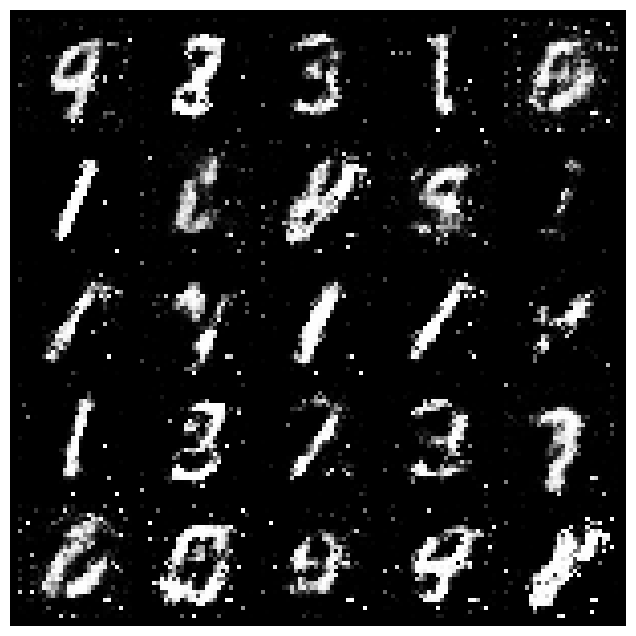

Discriminator Accuracy: 0.82485, Generator Accuracy: 0.87195
Epoch 13/30 completed


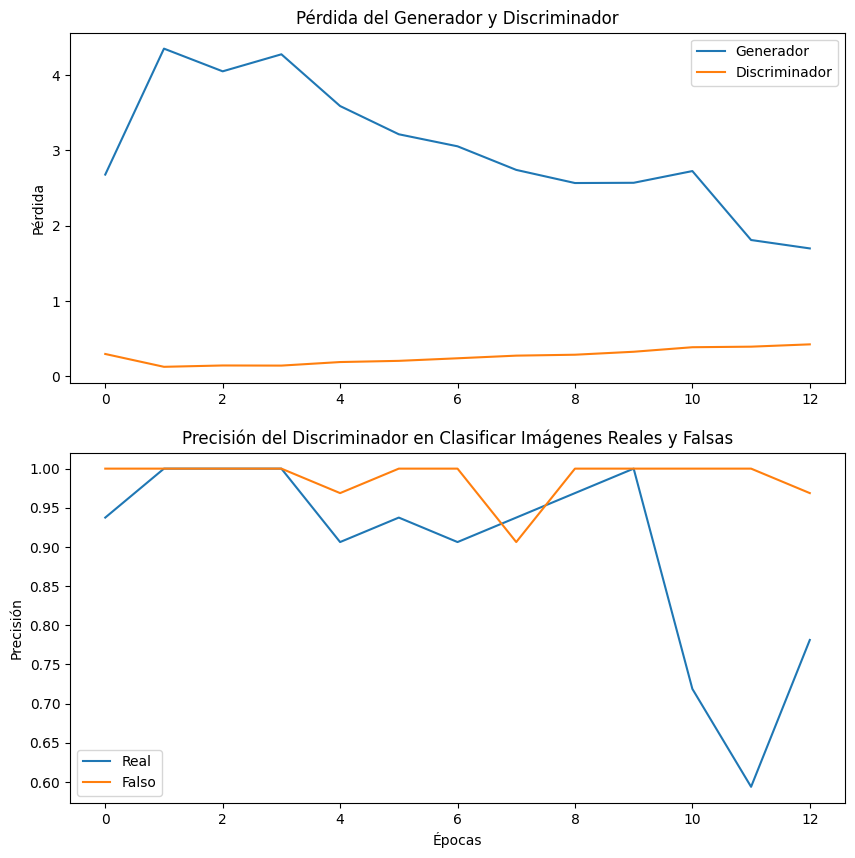

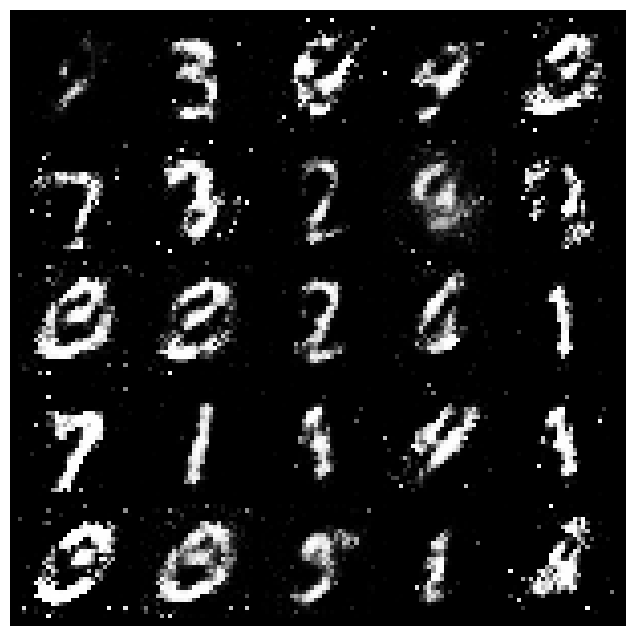

Discriminator Accuracy: 0.8057333333333333, Generator Accuracy: 0.8532333333333333
Epoch 14/30 completed


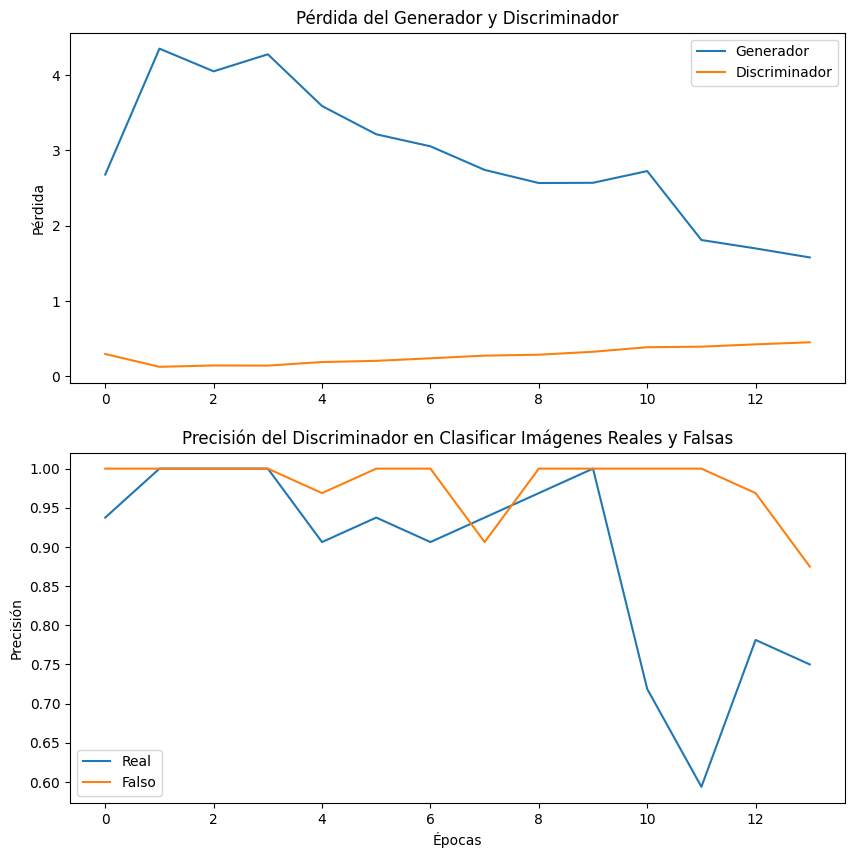

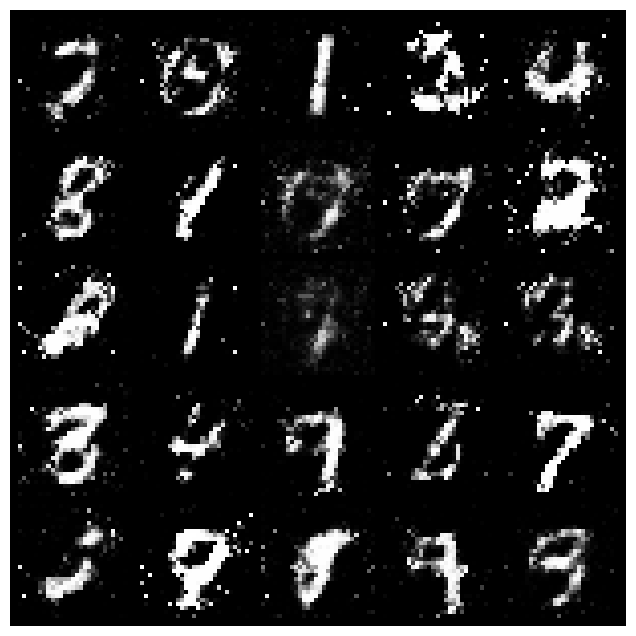

Discriminator Accuracy: 0.7865333333333333, Generator Accuracy: 0.8407166666666667
Epoch 15/30 completed


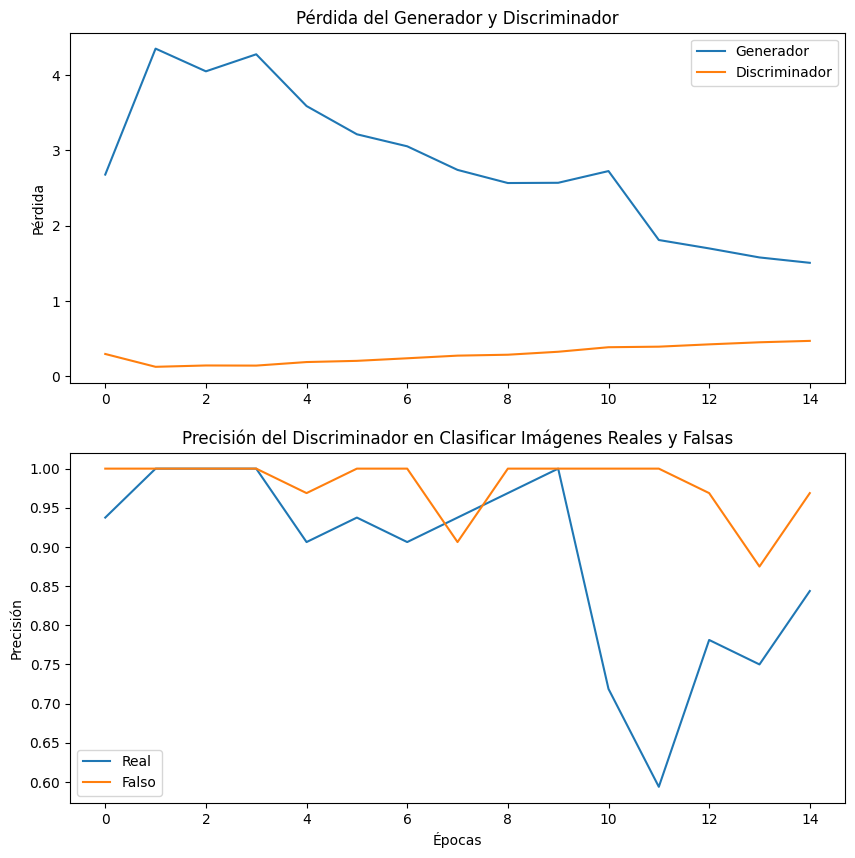

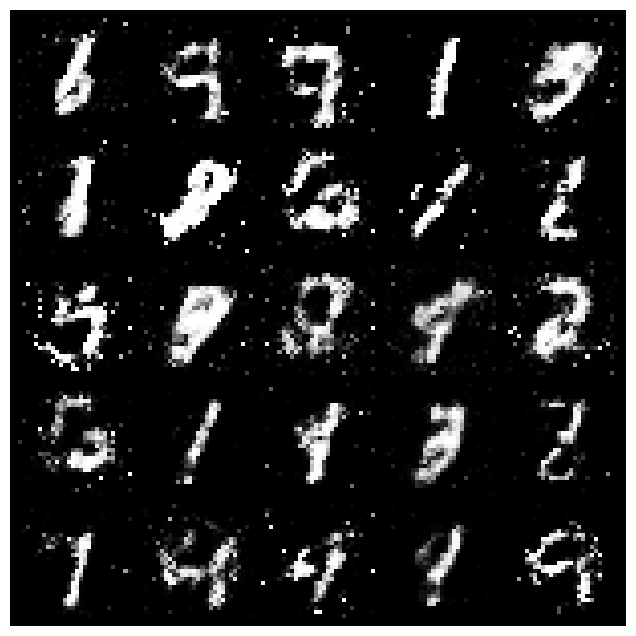

Discriminator Accuracy: 0.7726666666666666, Generator Accuracy: 0.8260833333333333
Epoch 16/30 completed


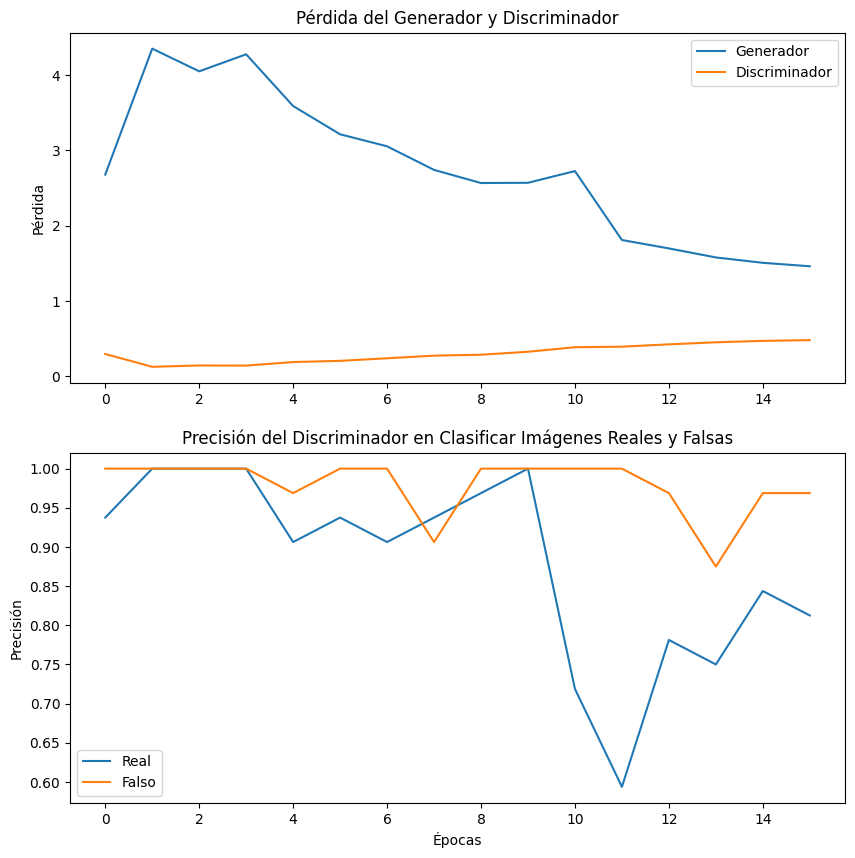

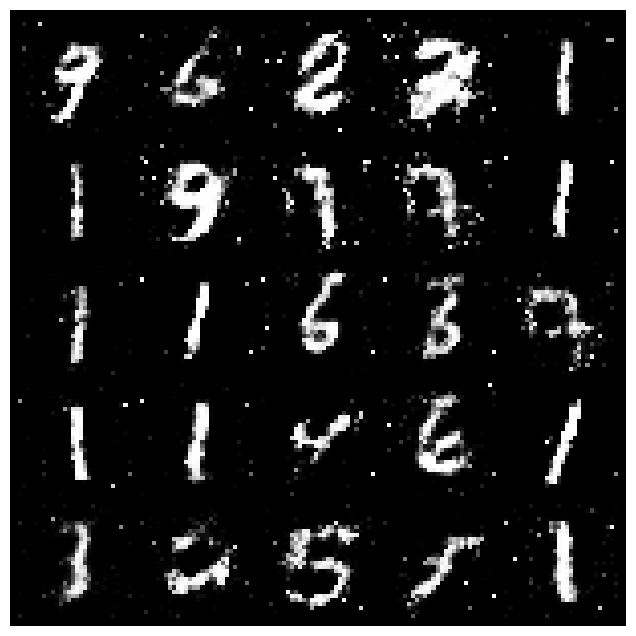

Discriminator Accuracy: 0.7645416666666667, Generator Accuracy: 0.81475
Epoch 17/30 completed


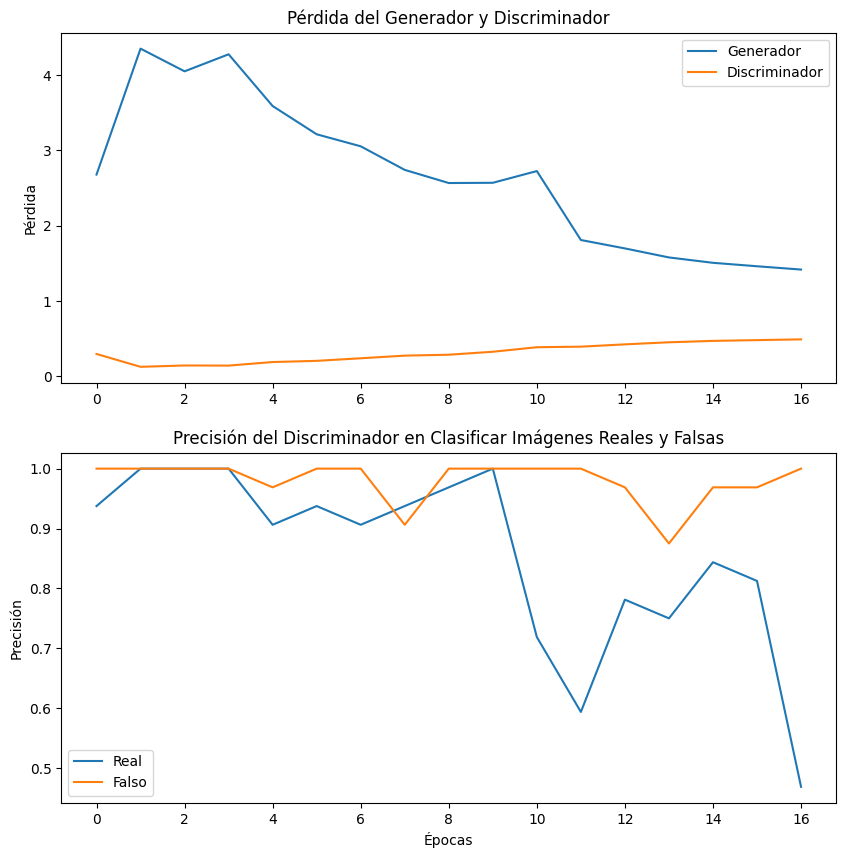

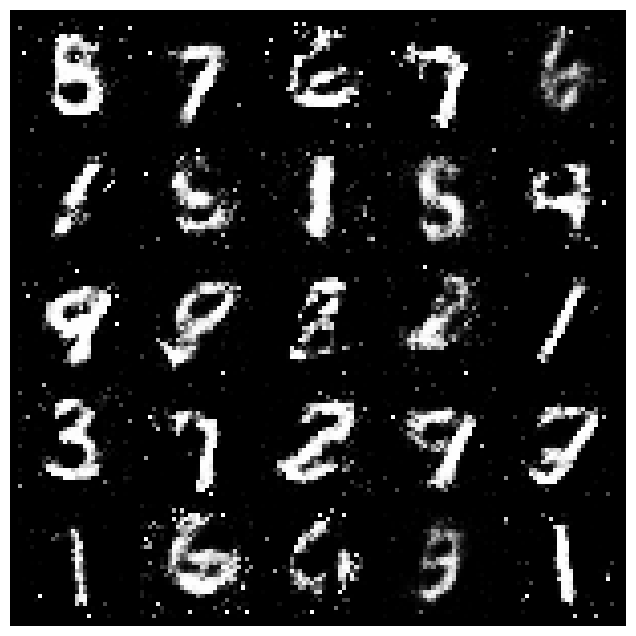

Discriminator Accuracy: 0.7586083333333333, Generator Accuracy: 0.8078666666666666
Epoch 18/30 completed


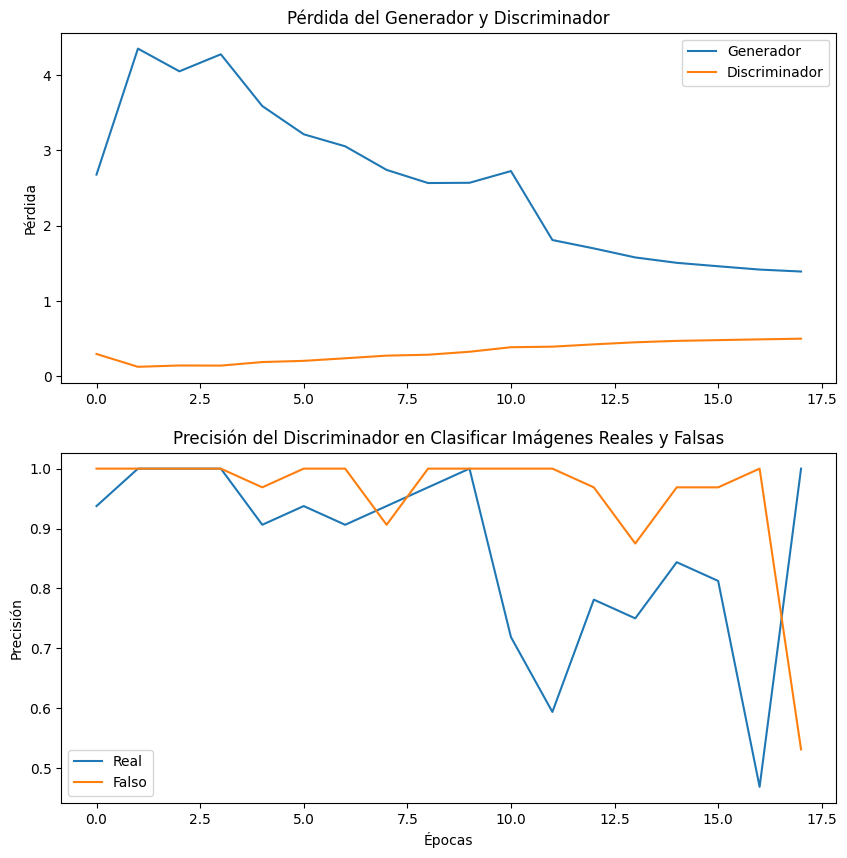

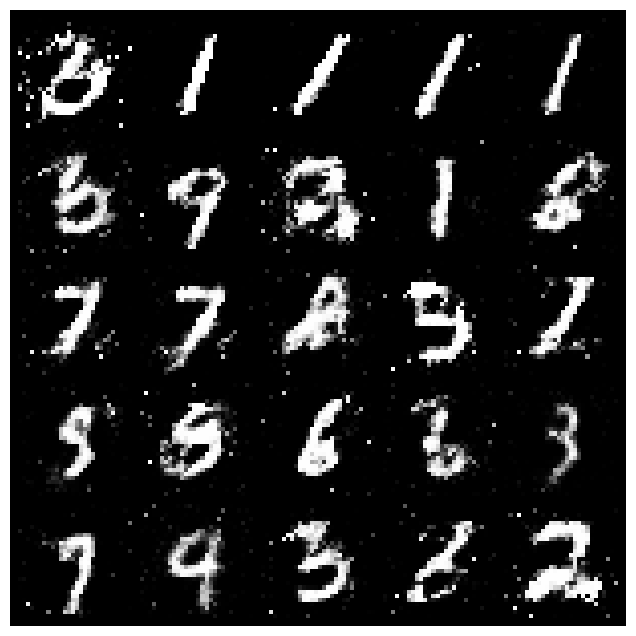

Discriminator Accuracy: 0.7513583333333334, Generator Accuracy: 0.79895
Epoch 19/30 completed


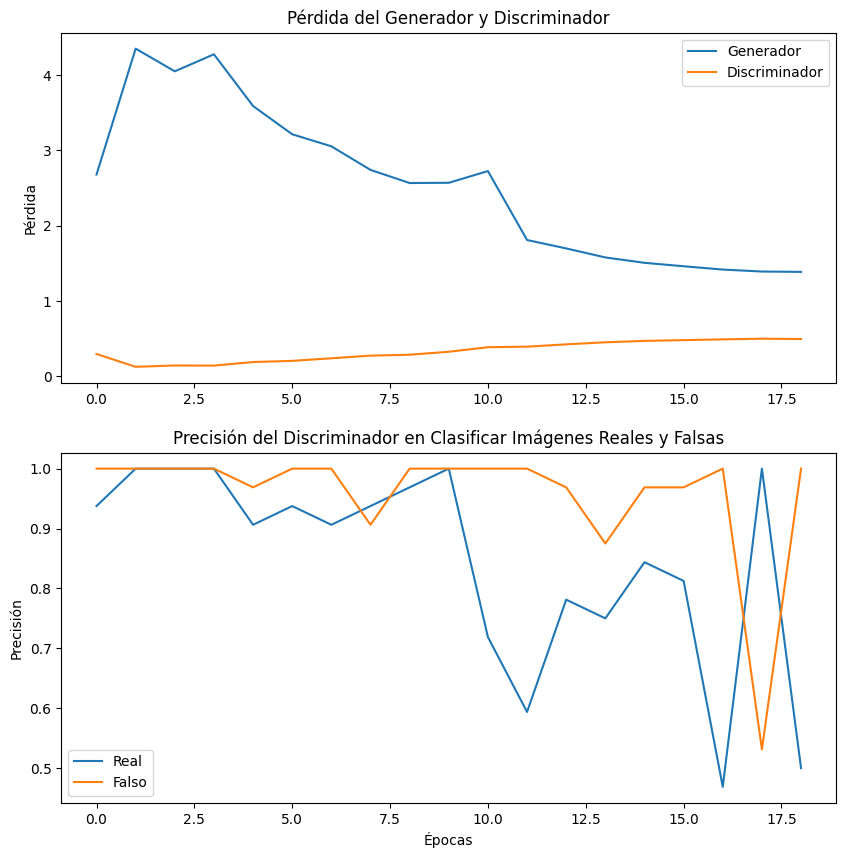

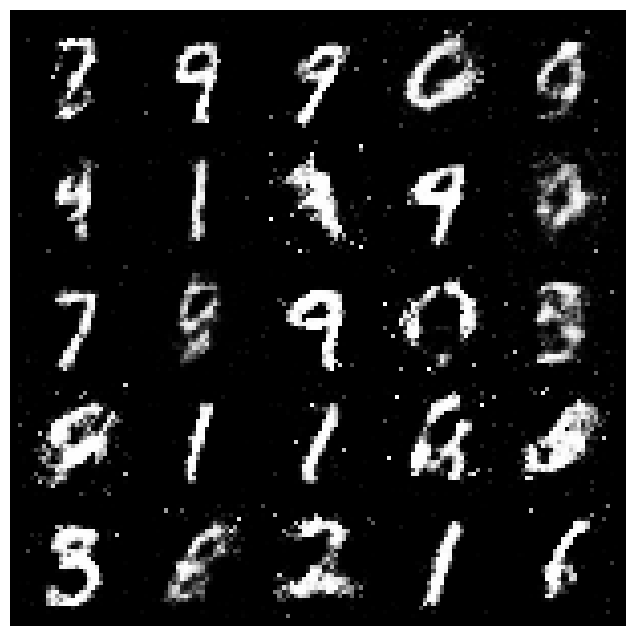

Discriminator Accuracy: 0.7532333333333333, Generator Accuracy: 0.8045
Epoch 20/30 completed


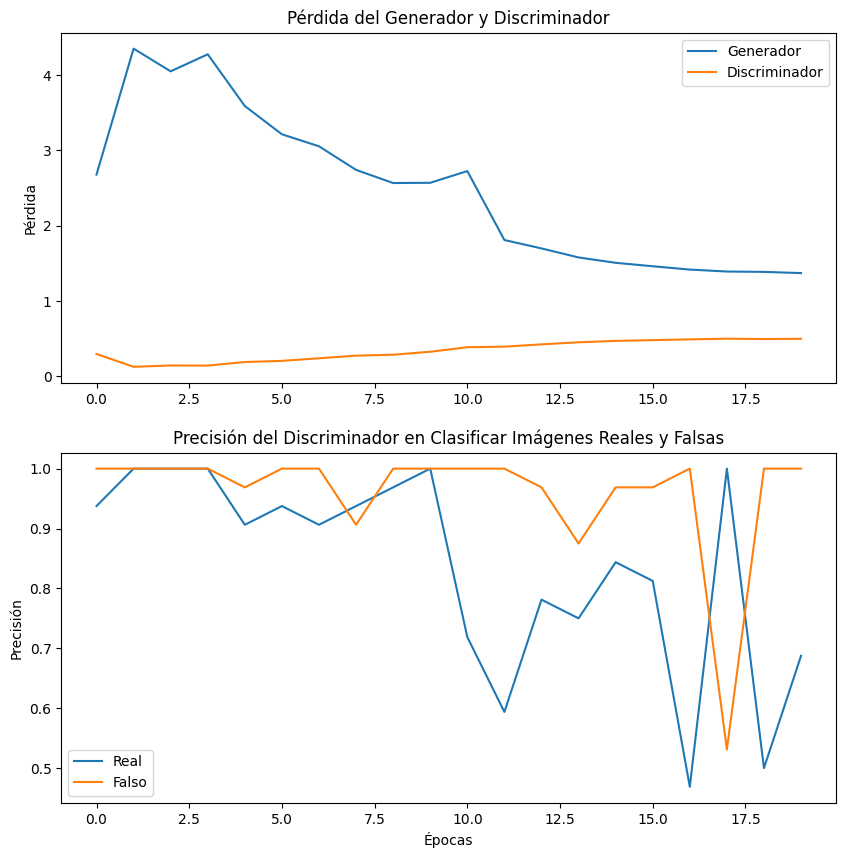

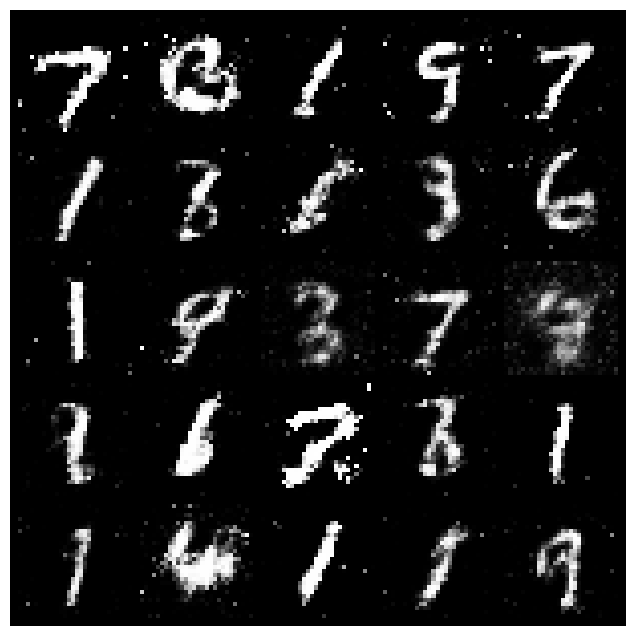

Discriminator Accuracy: 0.7526, Generator Accuracy: 0.8069
Epoch 21/30 completed


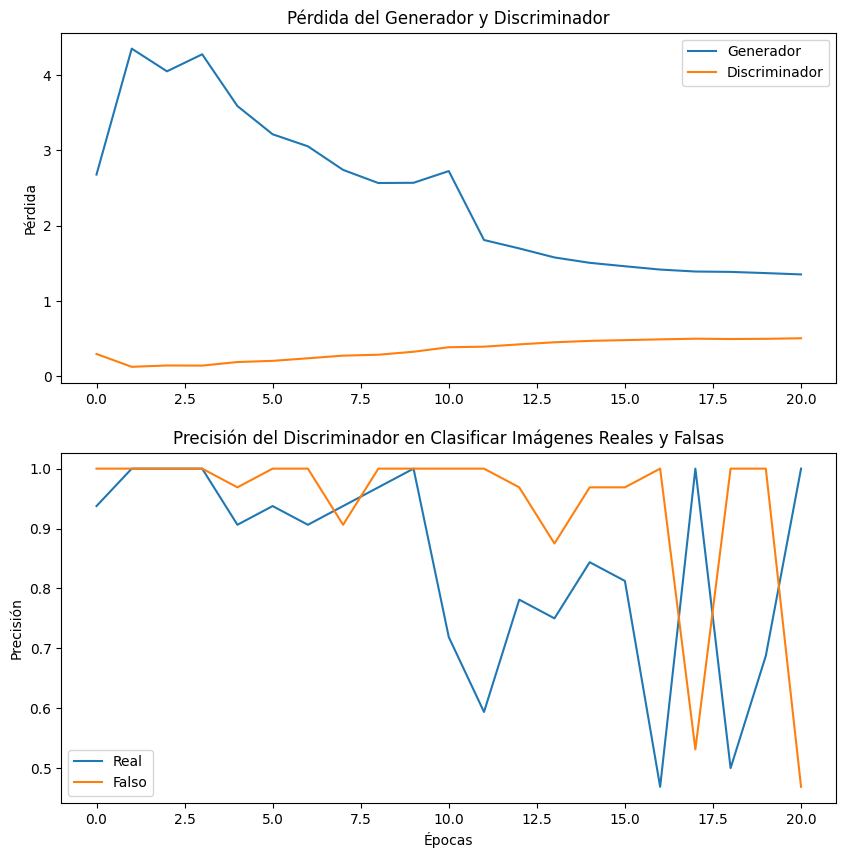

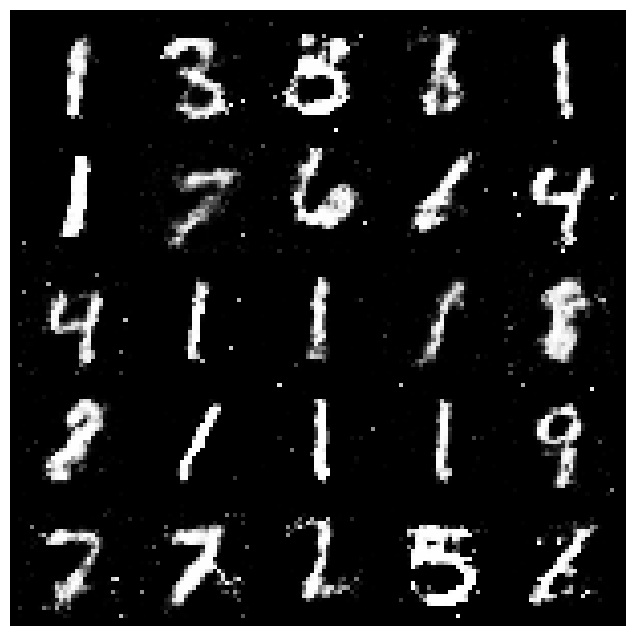

Discriminator Accuracy: 0.748125, Generator Accuracy: 0.7994166666666667
Epoch 22/30 completed


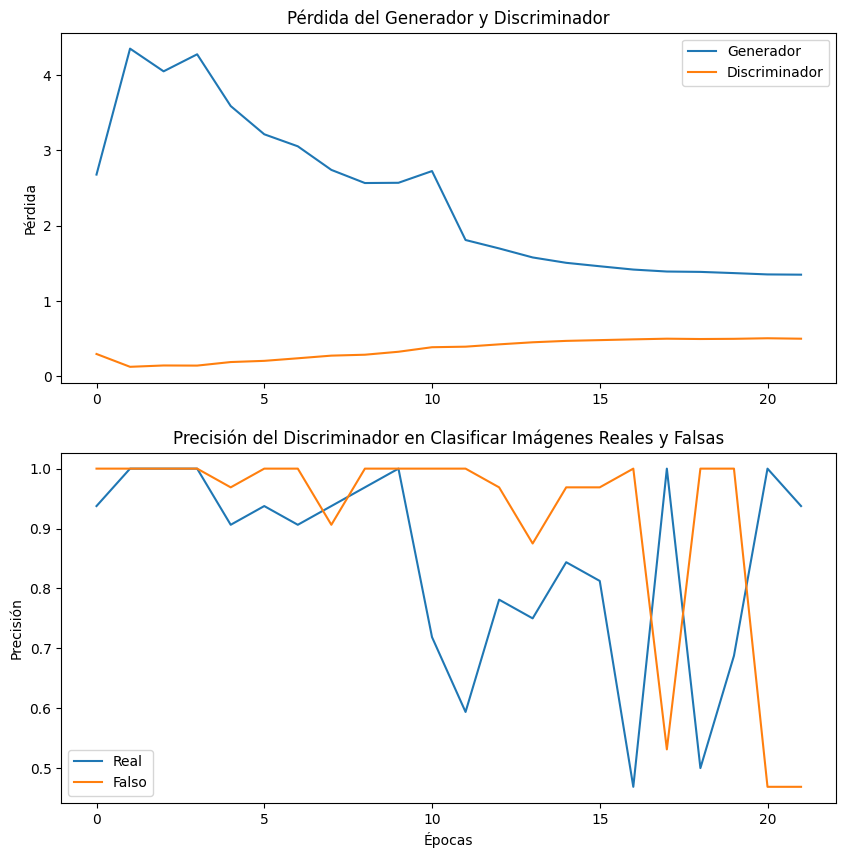

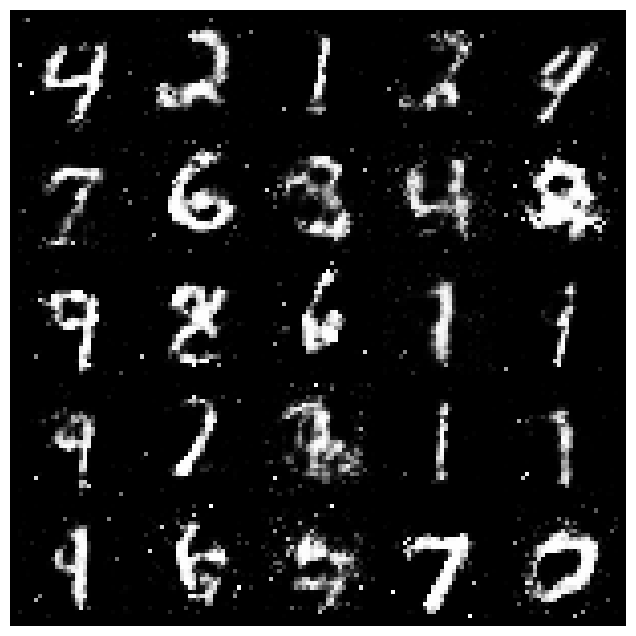

Discriminator Accuracy: 0.7506083333333333, Generator Accuracy: 0.8039333333333334
Epoch 23/30 completed


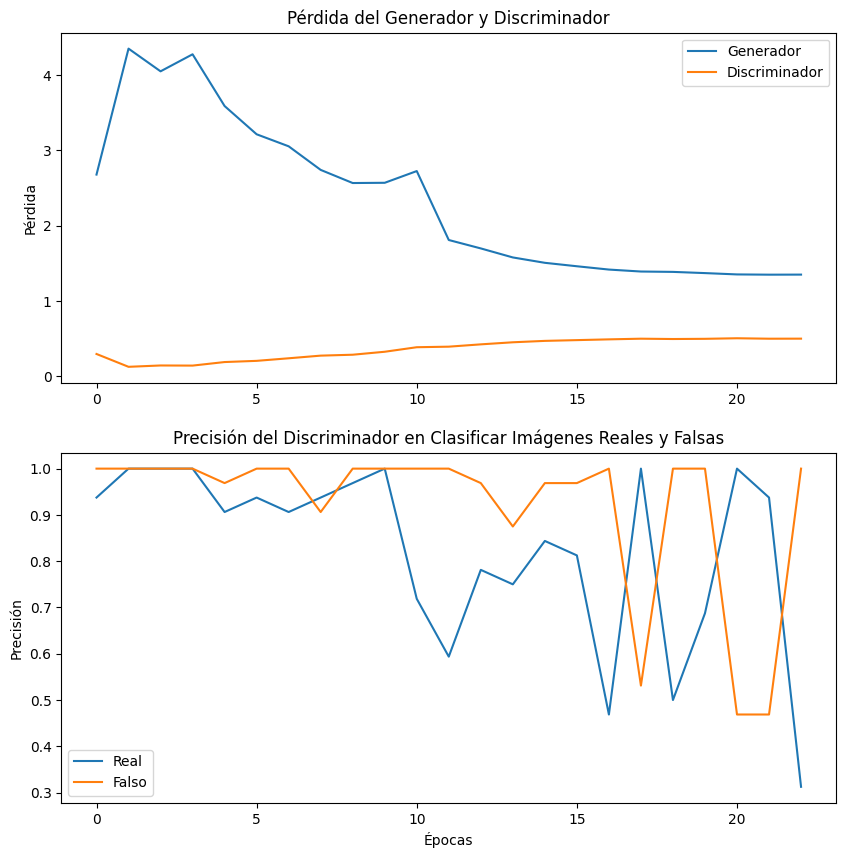

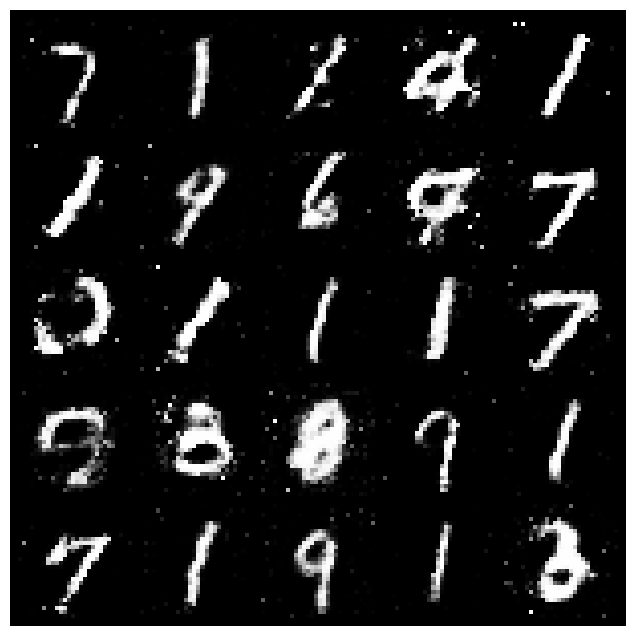

Discriminator Accuracy: 0.7496666666666667, Generator Accuracy: 0.8051666666666667
Epoch 24/30 completed


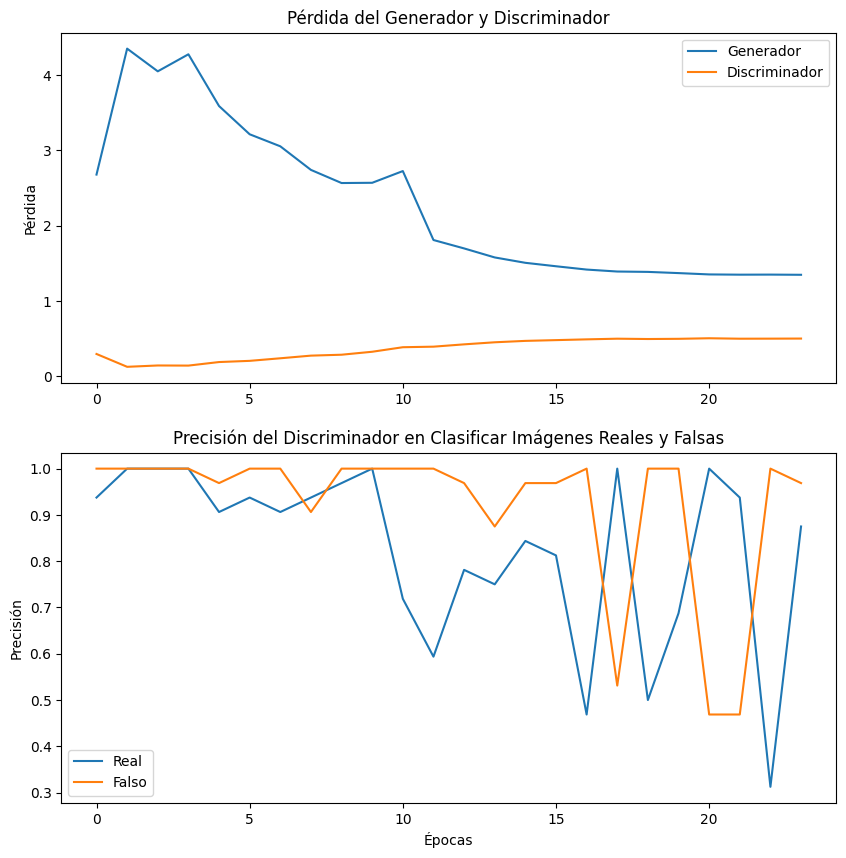

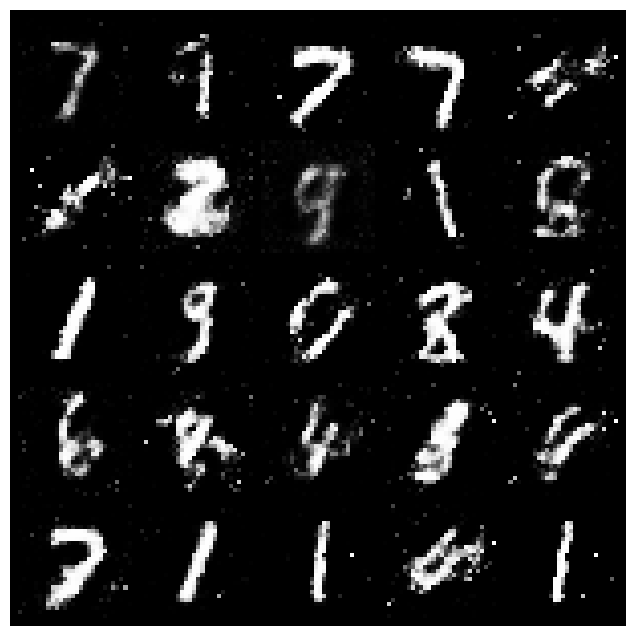

Discriminator Accuracy: 0.7477583333333333, Generator Accuracy: 0.8025
Epoch 25/30 completed


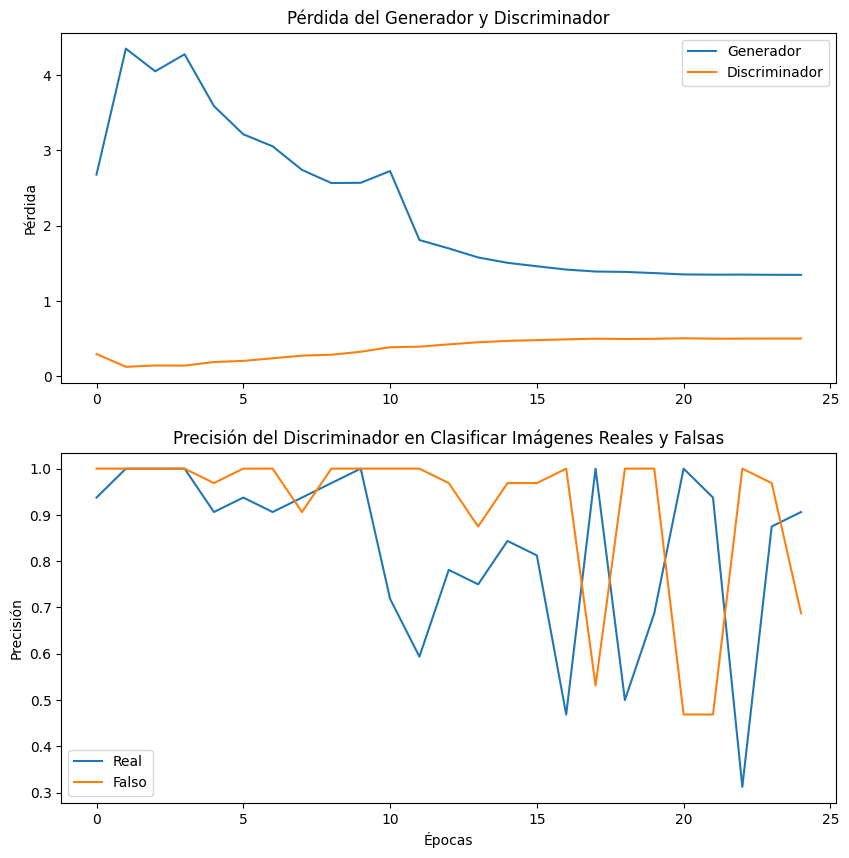

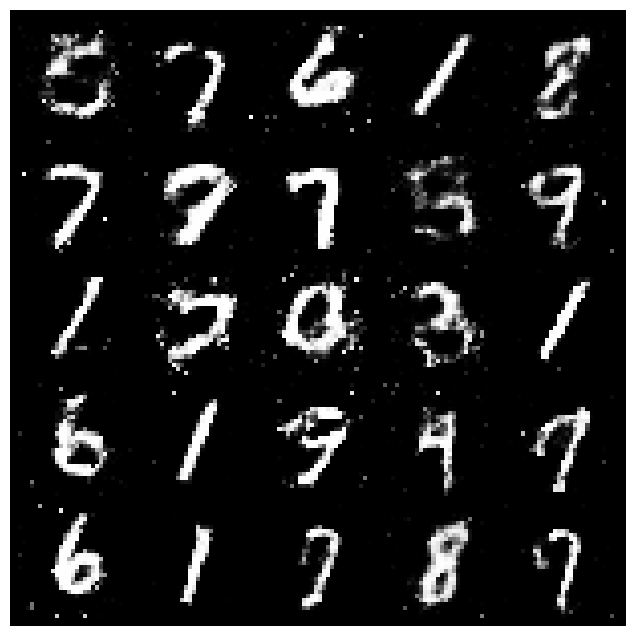

Discriminator Accuracy: 0.7502333333333333, Generator Accuracy: 0.8071166666666667
Epoch 26/30 completed


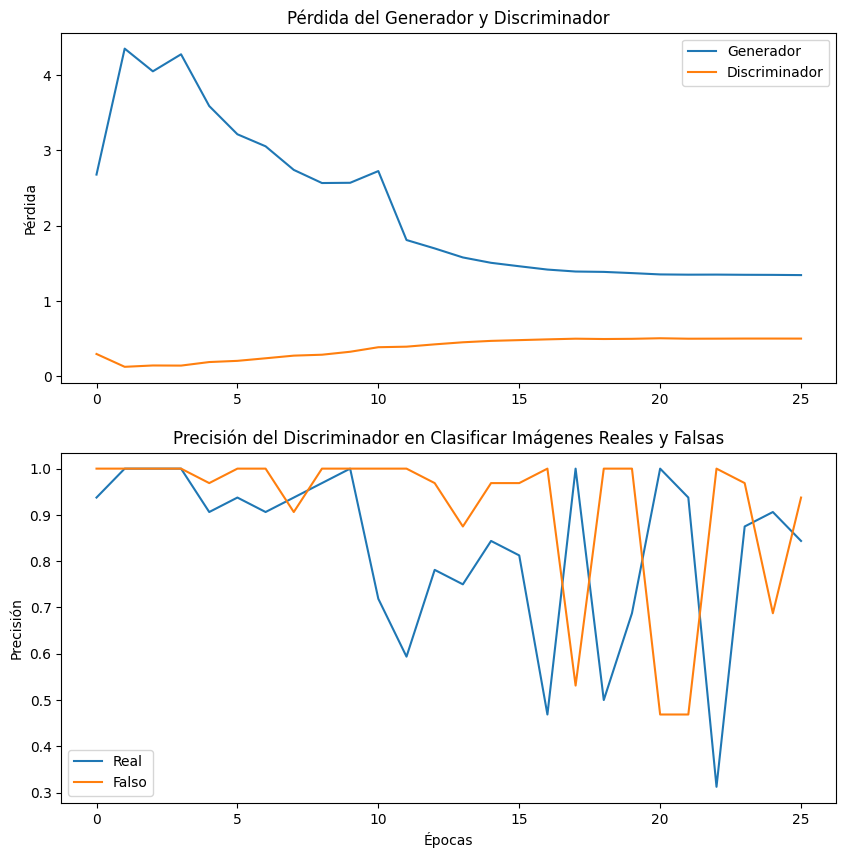

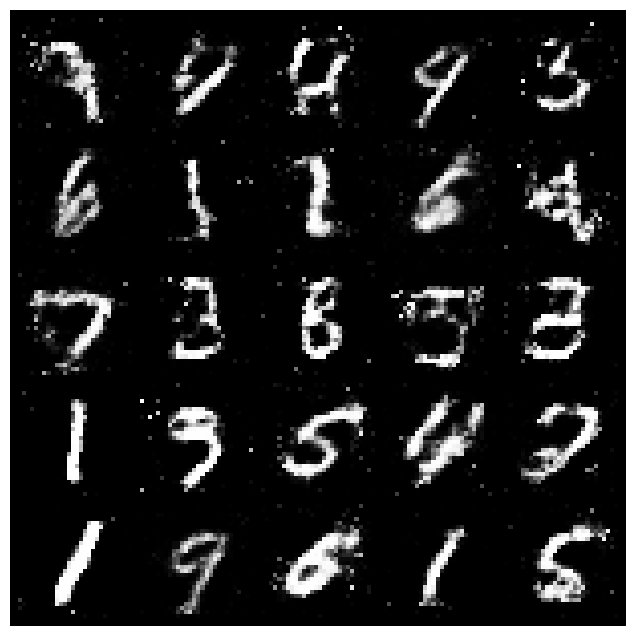

Discriminator Accuracy: 0.7493916666666667, Generator Accuracy: 0.8040833333333334
Epoch 27/30 completed


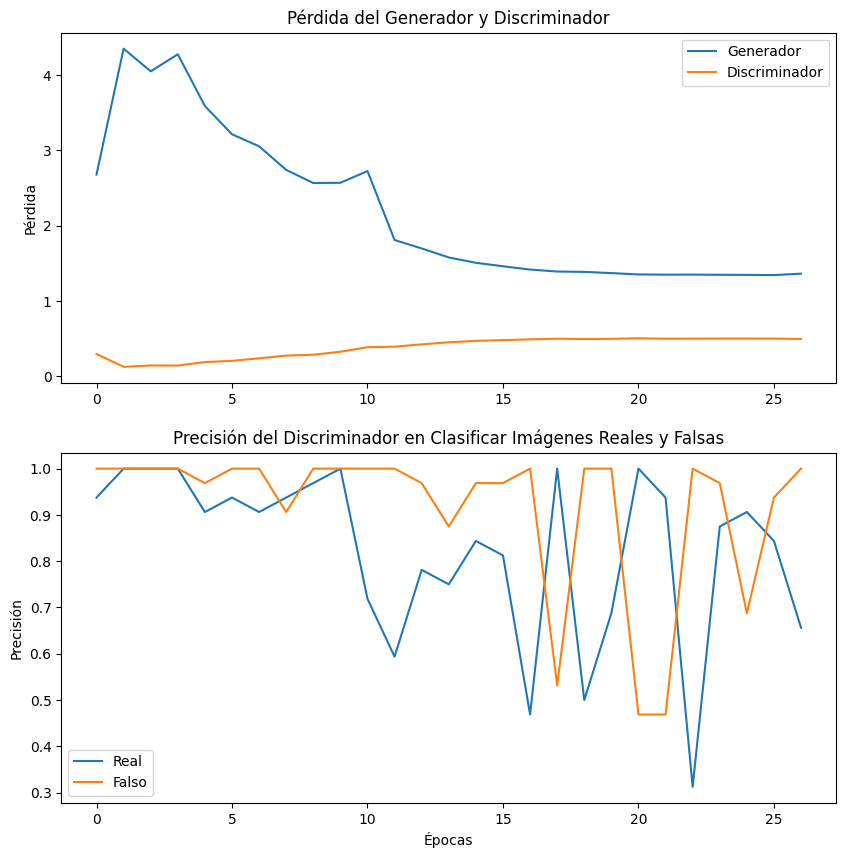

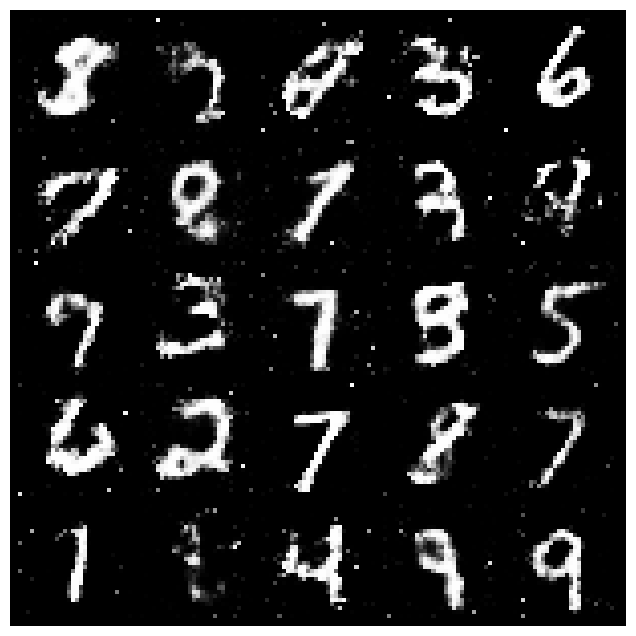

Discriminator Accuracy: 0.7533583333333334, Generator Accuracy: 0.8075166666666667
Epoch 28/30 completed


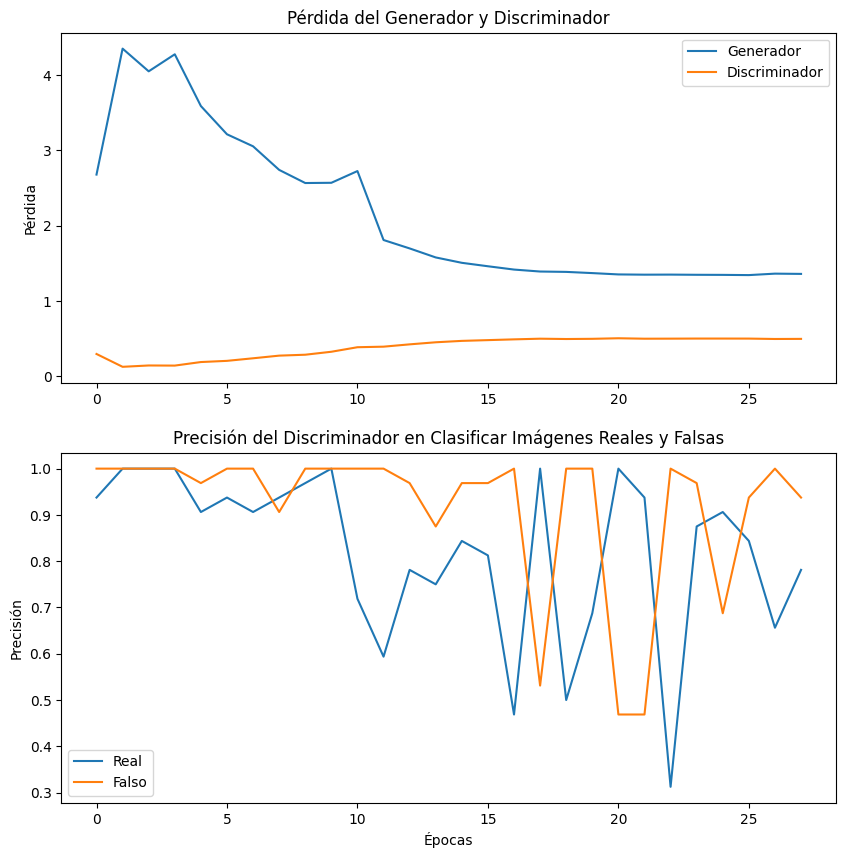

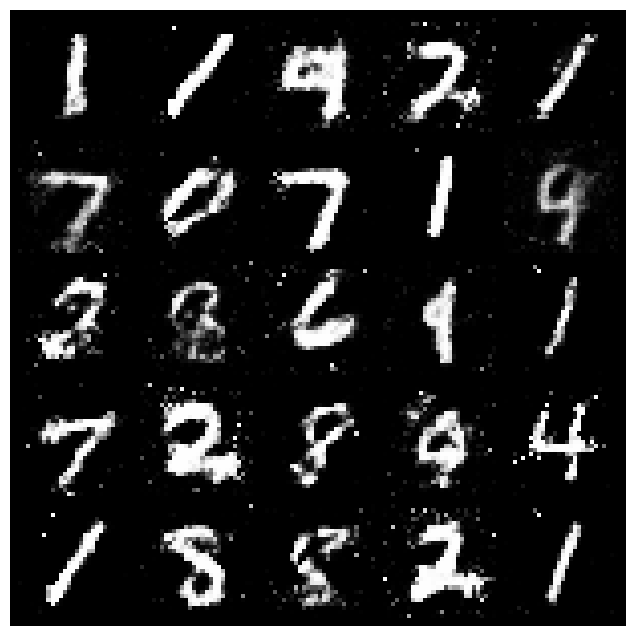

Discriminator Accuracy: 0.7529583333333333, Generator Accuracy: 0.8095166666666667
Epoch 29/30 completed


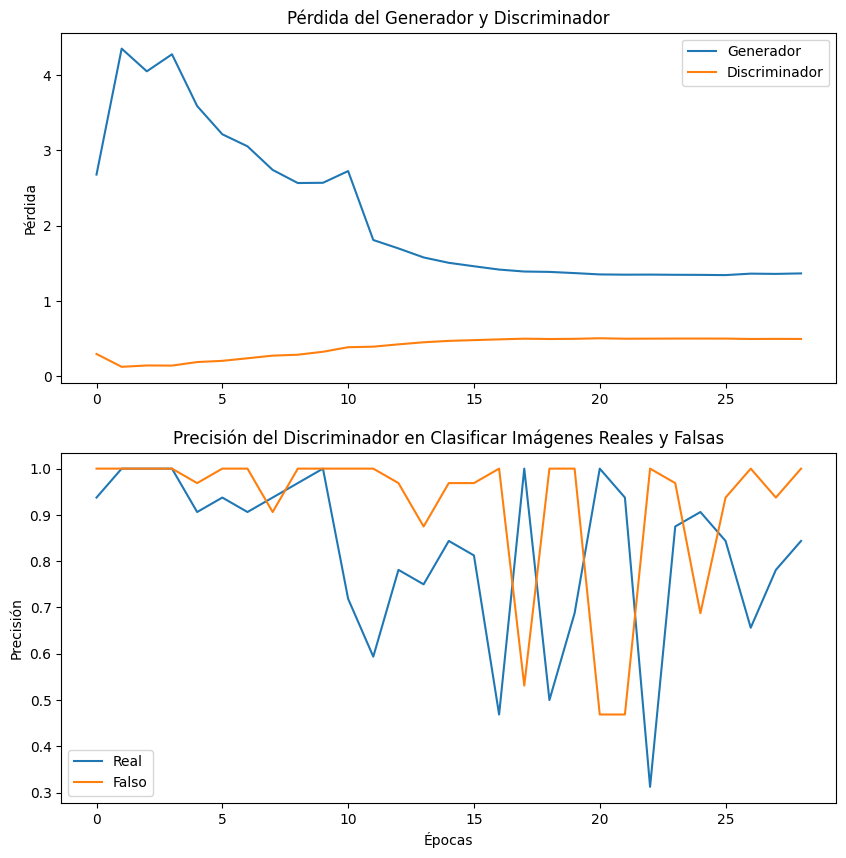

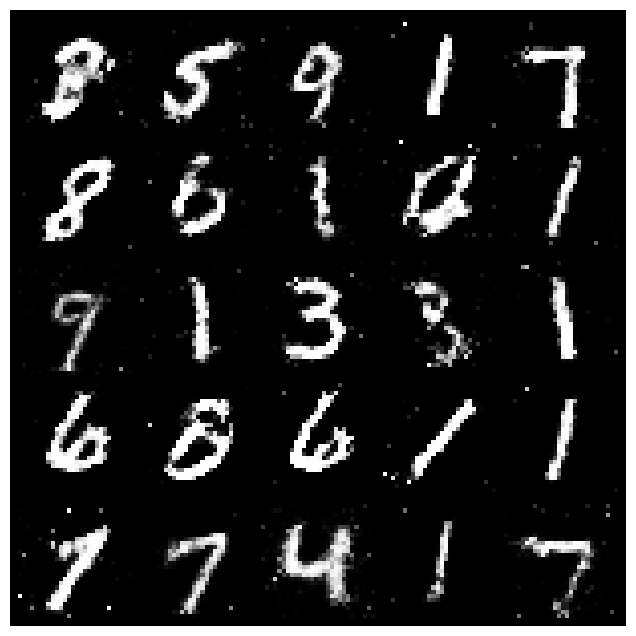

Discriminator Accuracy: 0.751925, Generator Accuracy: 0.8073
Epoch 30/30 completed


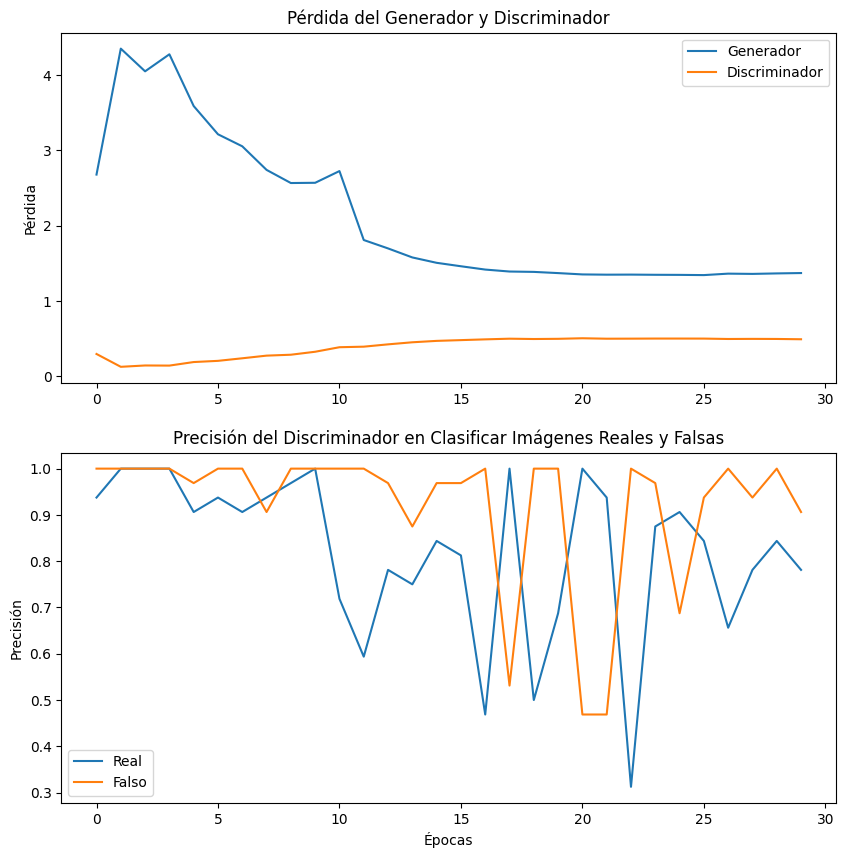

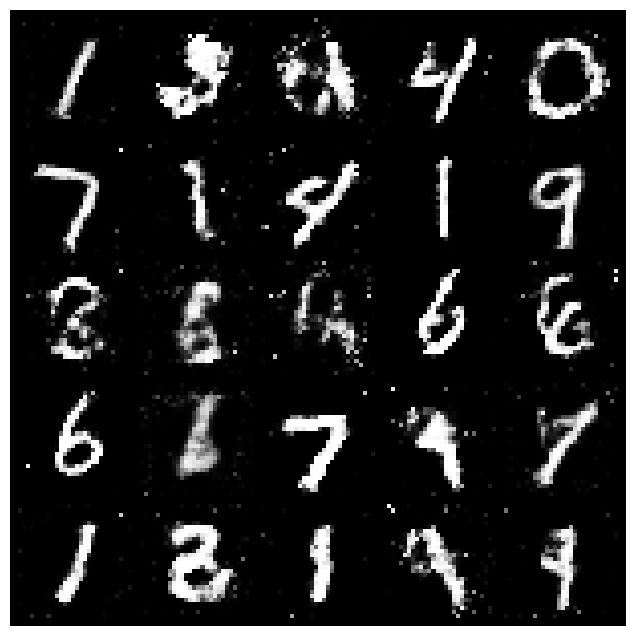

Discriminator Accuracy: 0.754825, Generator Accuracy: 0.8112833333333334
Average Generator Accuracy: 0.8568305555555557
Average Discriminator Accuracy: 0.8155380555555555


In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

generator = Generator().to(device)
discriminator = Discriminator().to(device)

# Optimizadores
optimizer_G = optim.Adam(generator.parameters(), lr=0.0002, betas=(0.5, 0.999))
optimizer_D = optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))

# Función de pérdida
criterion = nn.BCELoss()

# Listas para almacenar pérdidas
G_losses = []
D_losses = []
D_real_accuracy = []
D_fake_accuracy = []
average_G_losses = []
average_D_losses = []
G_accuracies = []
D_accuracies = []

# Número de épocas
num_epochs = 30

# Entrenamiento
for epoch in range(num_epochs):
    G_loss_accum = 0.0
    D_loss_accum = 0.0
    num_batches = 0
    num_correct_real = 0
    num_correct_fake = 0
    total_samples = 0

    for i, (real_images, _) in enumerate(mnist_train_loader):
        num_batches += 1
        total_samples += real_images.size(0)
        # Configuración de las etiquetas reales y falsas
        real = torch.ones(real_images.size(0), 1, device=device)
        fake = torch.zeros(real_images.size(0), 1, device=device)

        # Entrenar Discriminador
        discriminator.zero_grad()

        # Imágenes reales
        real_imgs = real_images.to(device)
        output_real = discriminator(real_imgs)
        loss_real = criterion(output_real, real)
        num_correct_real += torch.sum(output_real >= 0.5).item()  # Imágenes reales clasificadas como reales


        # Imágenes falsas
        noise = torch.randn(real_images.size(0), 100, device=device)
        fake_imgs = generator(noise)
        output_fake = discriminator(fake_imgs.detach())
        loss_fake = criterion(output_fake, fake)
        num_correct_fake += torch.sum(output_fake < 0.5).item()  # Imágenes falsas clasificadas como falsas


        # Pérdida total y actualizar
        loss_D = (loss_real + loss_fake) / 2
        loss_D.backward()
        optimizer_D.step()

        # Entrenar Generador
        generator.zero_grad()

        # Engañar al discriminador
        output_fake = discriminator(fake_imgs)
        loss_G = criterion(output_fake, real)
        loss_G.backward()
        optimizer_G.step()

        # Guardar las pérdidas para visualización
        G_losses.append(loss_G.item())
        D_losses.append(loss_D.item())
        G_loss_accum += loss_G.item()
        D_loss_accum += loss_D.item()



        with torch.no_grad():
            real_pred = discriminator(real_images.to(device))
            real_correct = torch.sum(real_pred >= 0.5).item()  # Imágenes reales clasificadas como reales
            fake_pred = discriminator(fake_imgs.detach())
            fake_correct = torch.sum(fake_pred < 0.5).item()  # Imágenes falsas clasificadas como falsas
    average_G_losses.append(G_loss_accum / num_batches)
    average_D_losses.append(D_loss_accum / num_batches)
    D_real_accuracy.append(real_correct / real_images.size(0))
    D_fake_accuracy.append(fake_correct / real_images.size(0))


  # Calcular precisión del discriminador y el generador
    D_accuracy = (num_correct_real + num_correct_fake) / (2 * total_samples)
    G_accuracy = num_correct_fake / total_samples
    D_accuracies.append(D_accuracy)
    G_accuracies.append(G_accuracy)


    save_generated_images(generator, device, epoch)
    create_gif('generated_images', "gan_mnist.gif")
    # Mostrar pérdidas y generar imágenes al final de cada época
    print(f"Epoch {epoch + 1}/{num_epochs} completed")
    plot_metrics(average_G_losses, average_D_losses, D_real_accuracy, D_fake_accuracy)
    show_generated_images(generator, device)
    print(f"Discriminator Accuracy: {D_accuracy}, Generator Accuracy: {G_accuracy}")

# Imprimir la precisión promedio del discriminador y del generador al final
print(f"Average Generator Accuracy: {np.mean(G_accuracies)}")
print(f"Average Discriminator Accuracy: {np.mean(D_accuracies)}")

##### CGAN

<ipython-input-51-902d87a423af>:4: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  images.append(imageio.imread(file_name))


Epoch 1/30 completed


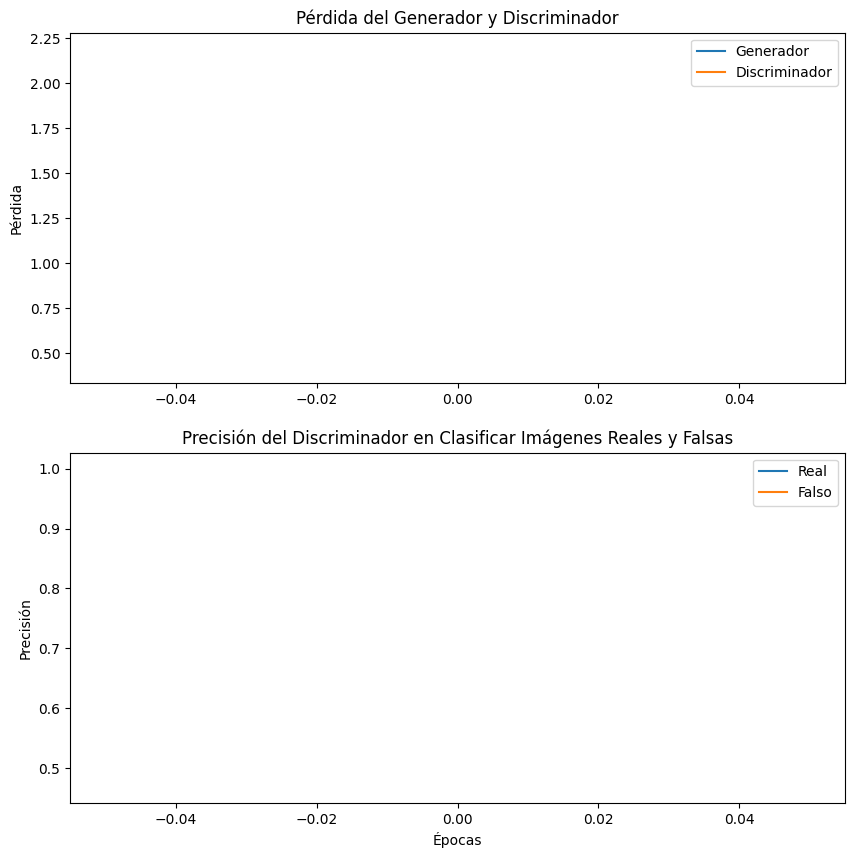

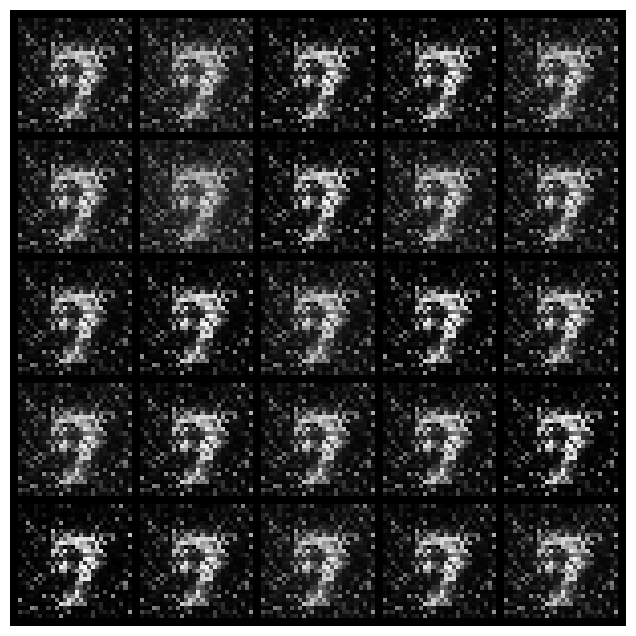

Discriminator Accuracy: 0.40646666666666664, Generator Accuracy: 0.45336666666666664
Epoch 2/30 completed


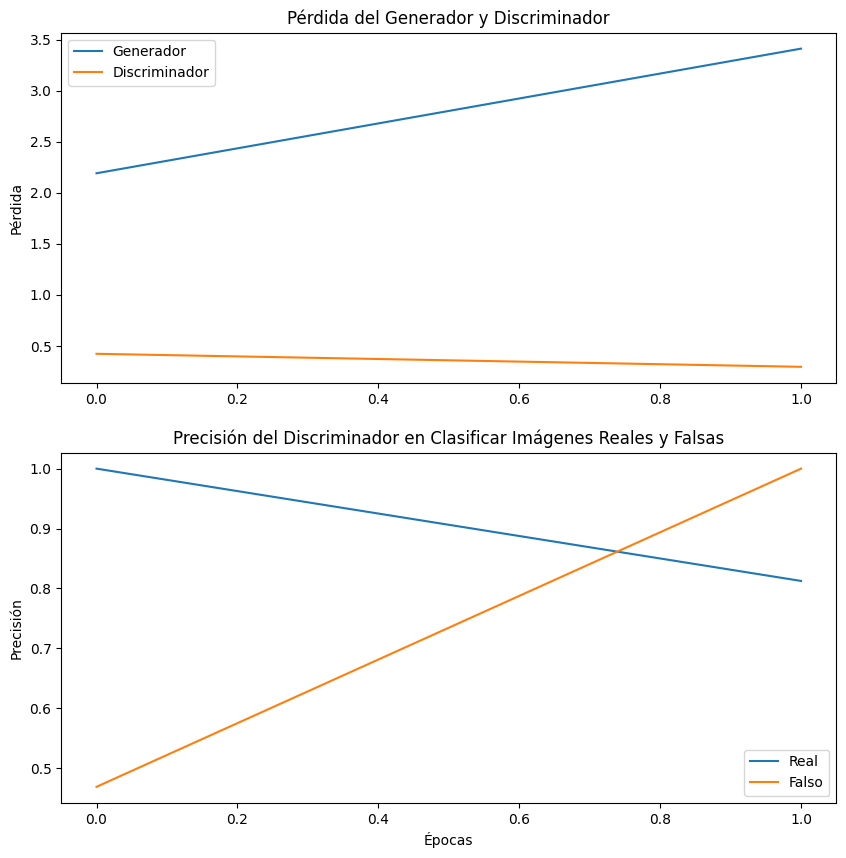

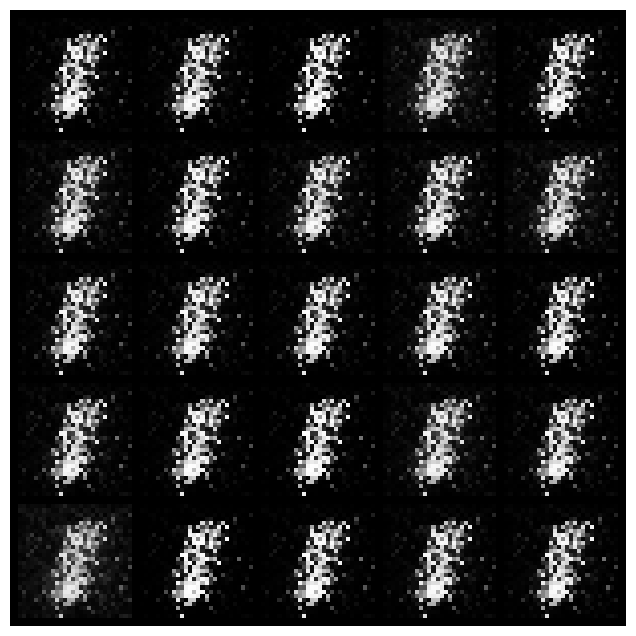

Discriminator Accuracy: 0.40646666666666664, Generator Accuracy: 0.45336666666666664
Epoch 3/30 completed


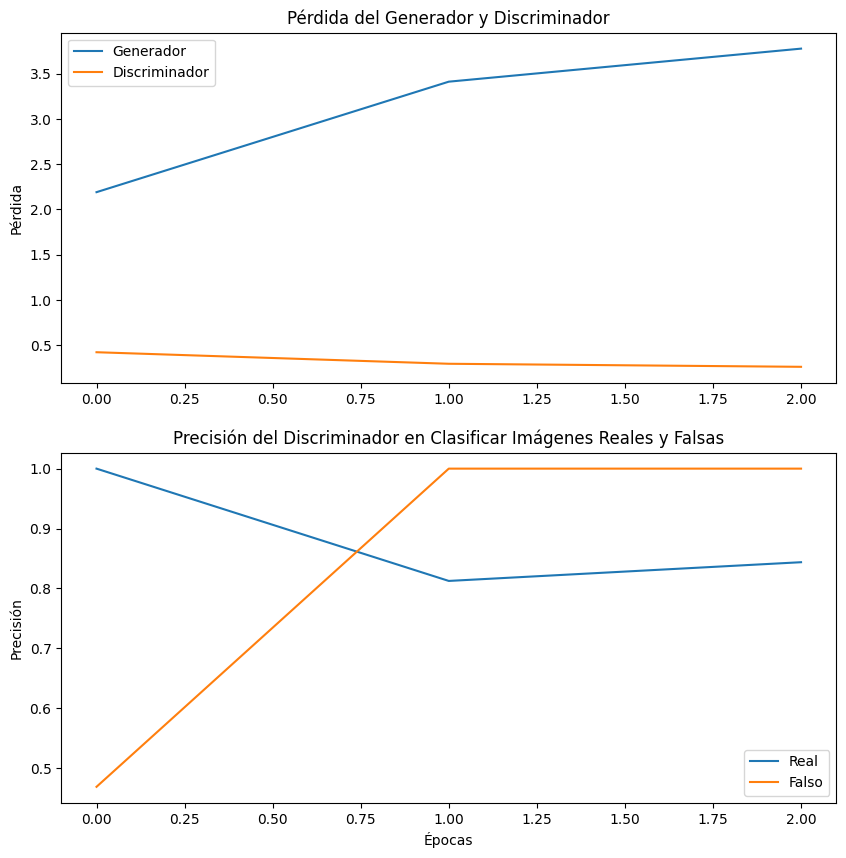

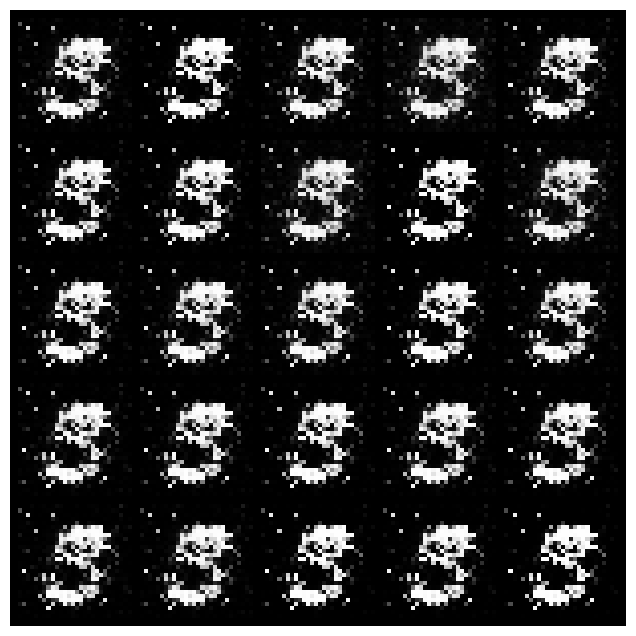

Discriminator Accuracy: 0.40646666666666664, Generator Accuracy: 0.45336666666666664
Epoch 4/30 completed


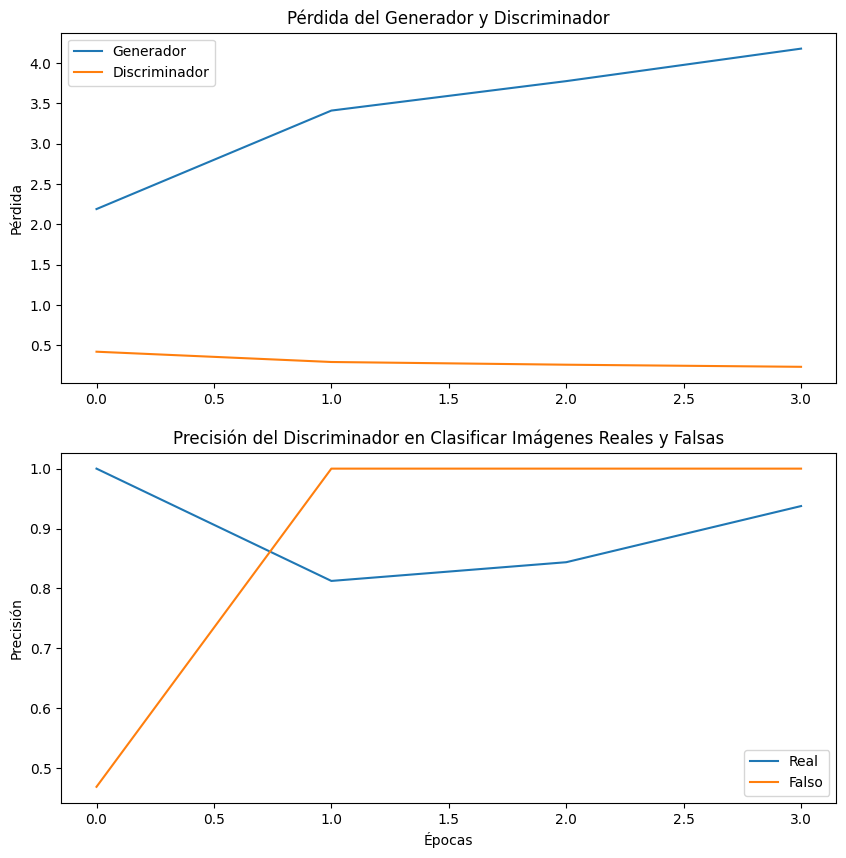

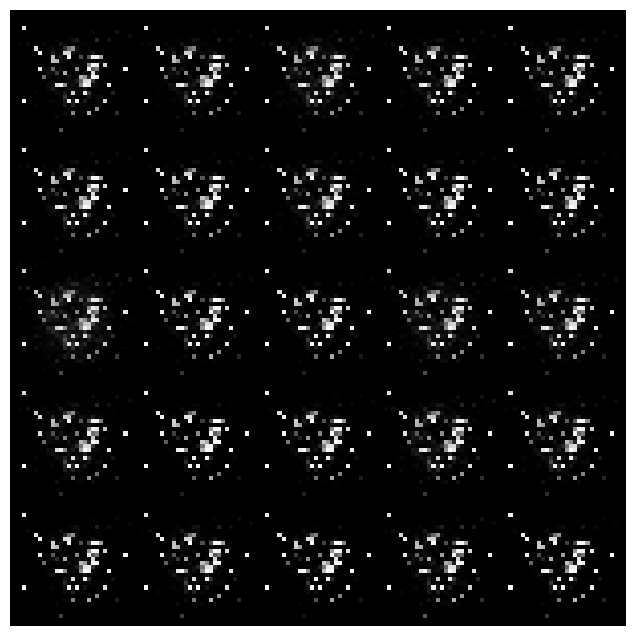

Discriminator Accuracy: 0.40646666666666664, Generator Accuracy: 0.45336666666666664
Epoch 5/30 completed


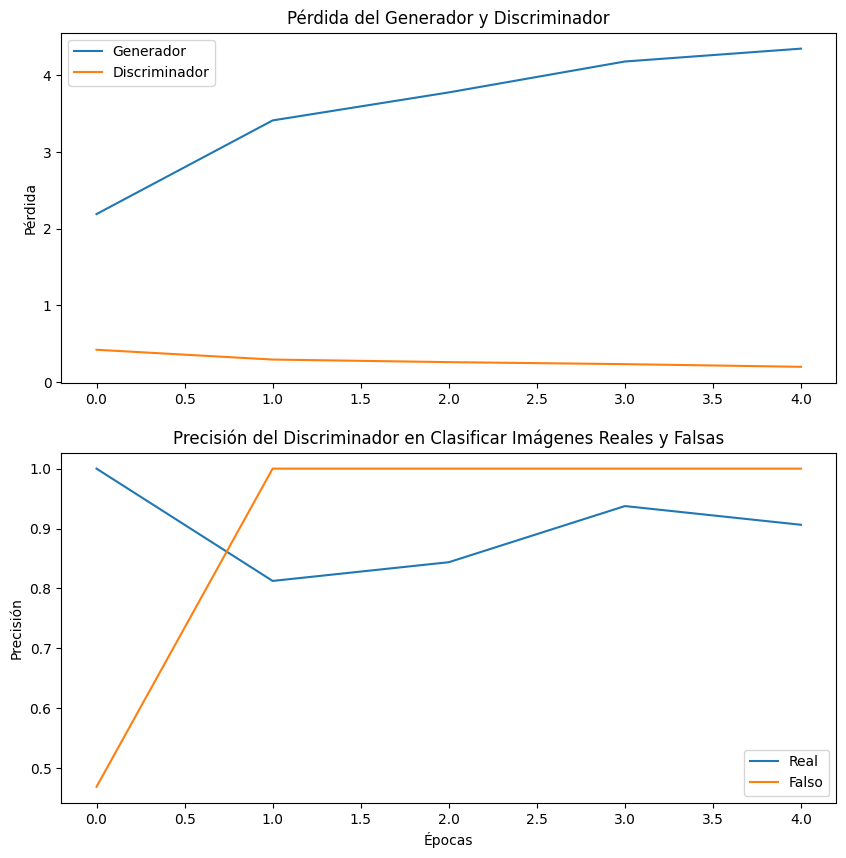

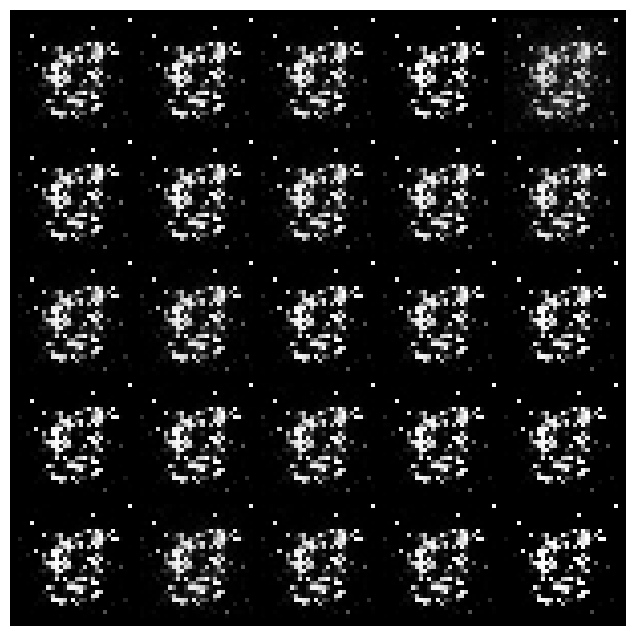

Discriminator Accuracy: 0.40646666666666664, Generator Accuracy: 0.45336666666666664
Epoch 6/30 completed


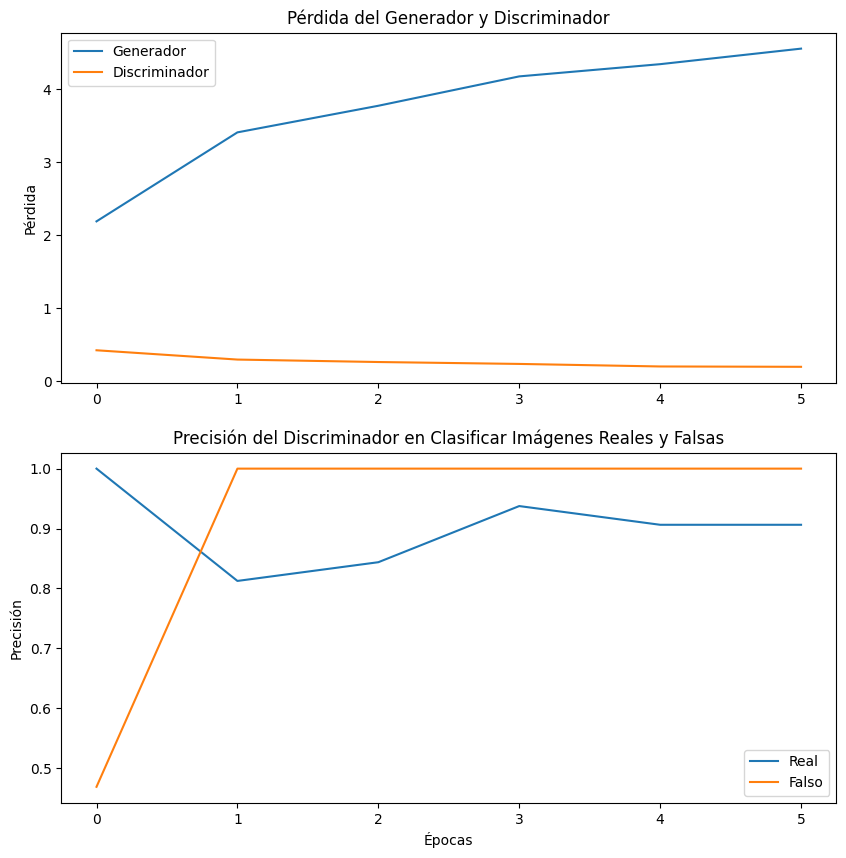

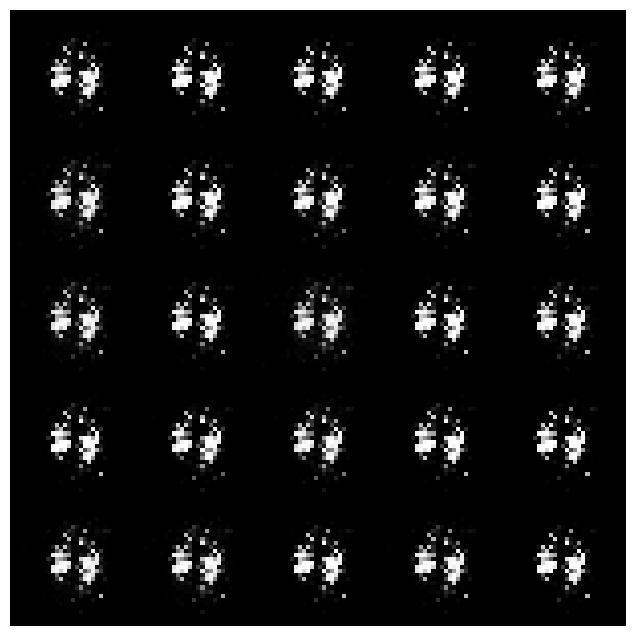

Discriminator Accuracy: 0.40646666666666664, Generator Accuracy: 0.45336666666666664
Epoch 7/30 completed


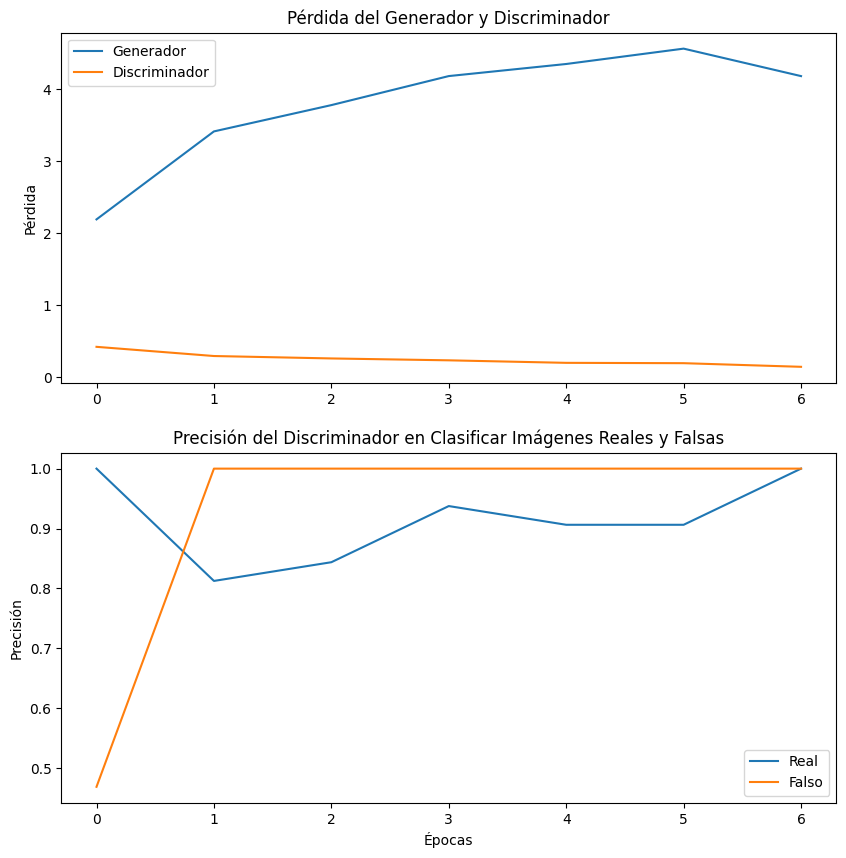

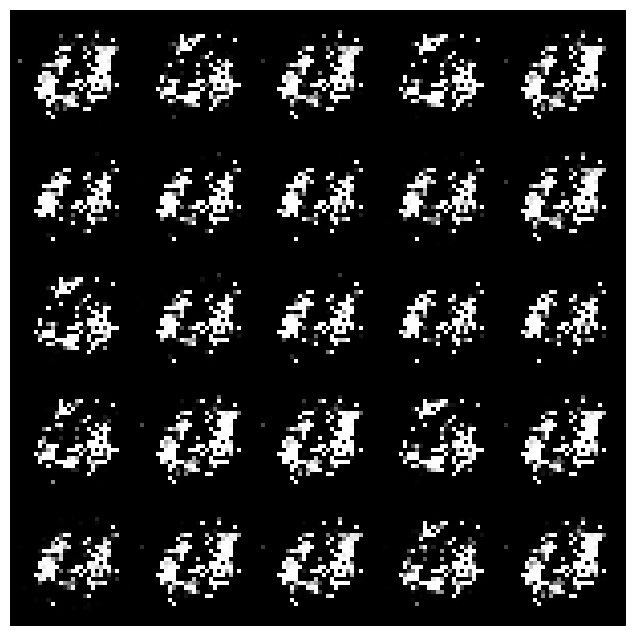

Discriminator Accuracy: 0.40646666666666664, Generator Accuracy: 0.45336666666666664
Epoch 8/30 completed


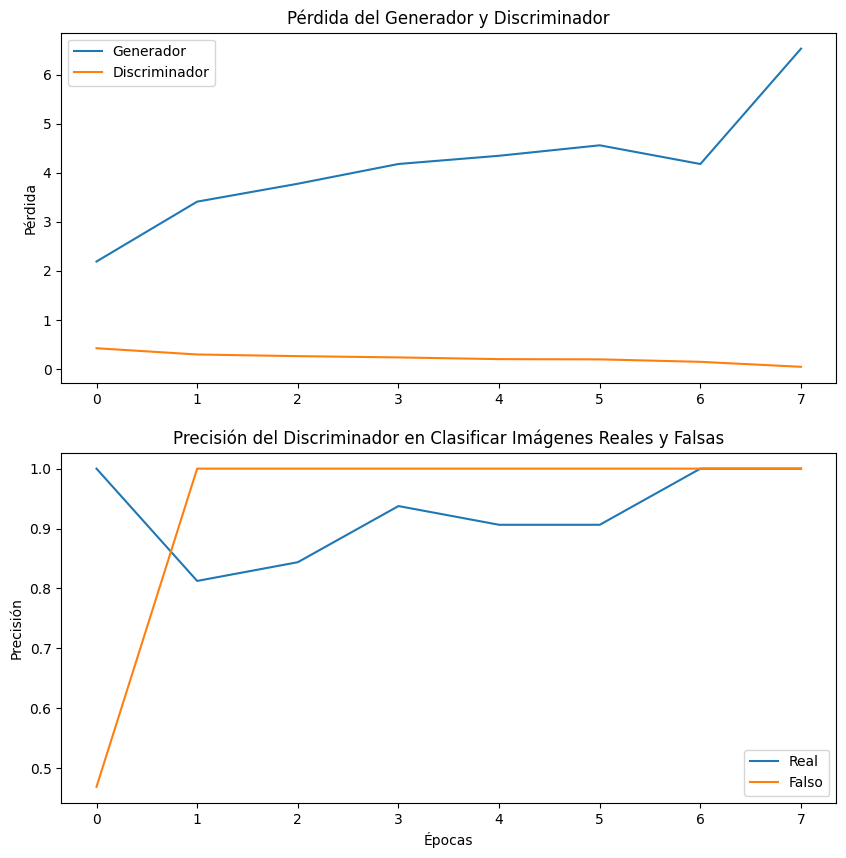

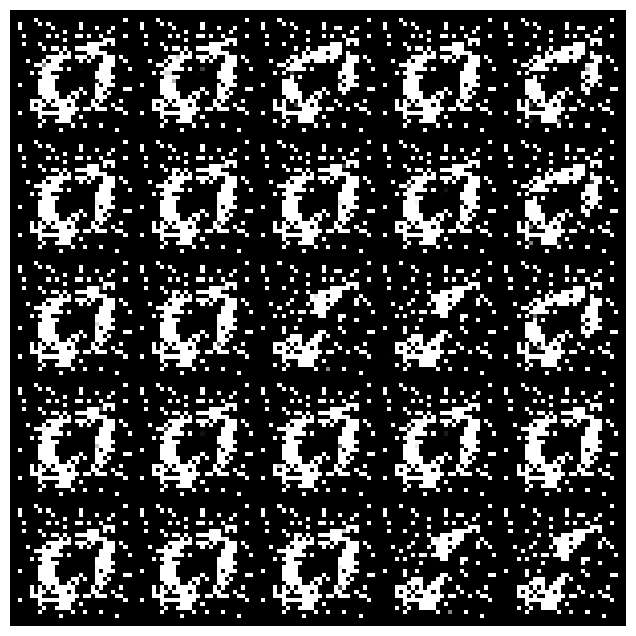

Discriminator Accuracy: 0.40646666666666664, Generator Accuracy: 0.45336666666666664
Epoch 9/30 completed


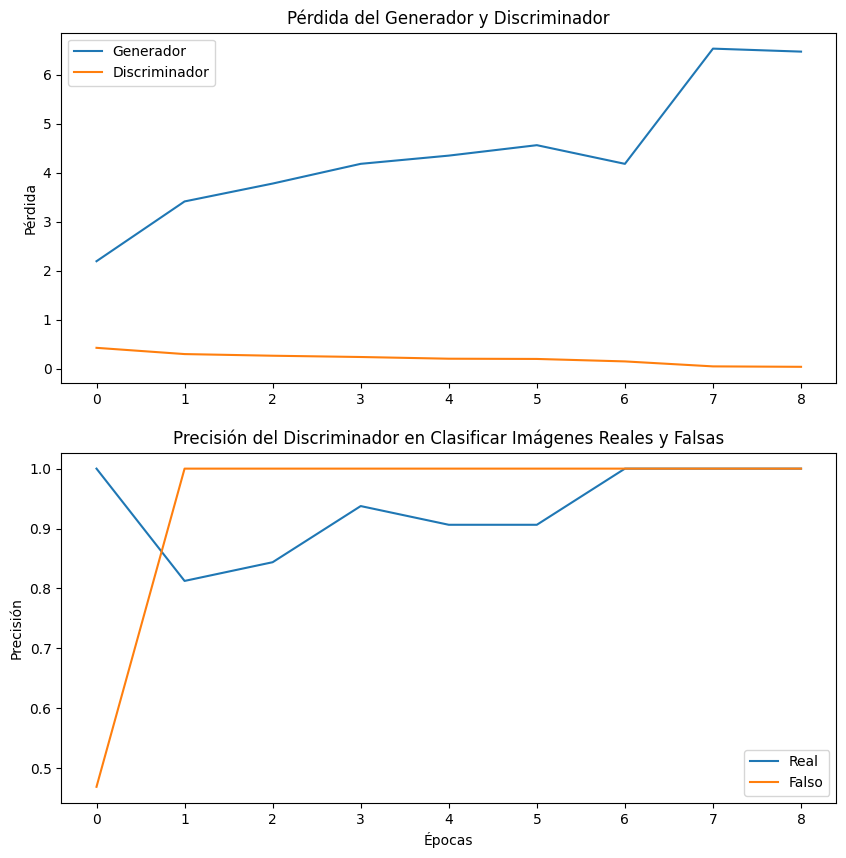

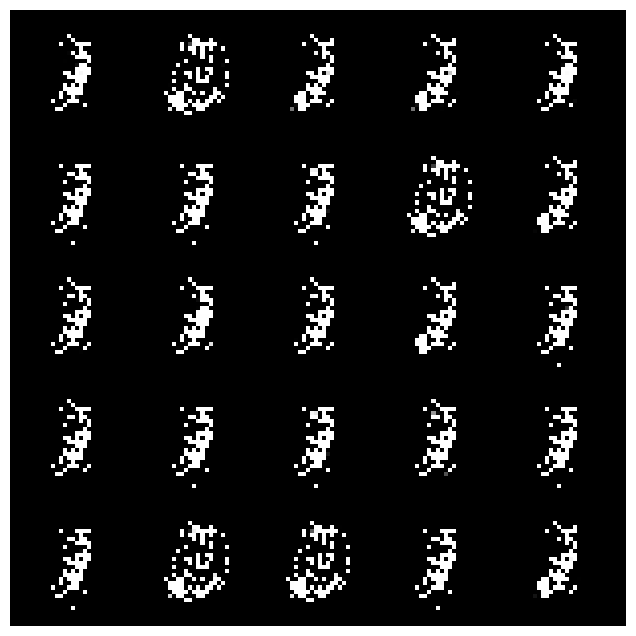

Discriminator Accuracy: 0.40646666666666664, Generator Accuracy: 0.45336666666666664
Epoch 10/30 completed


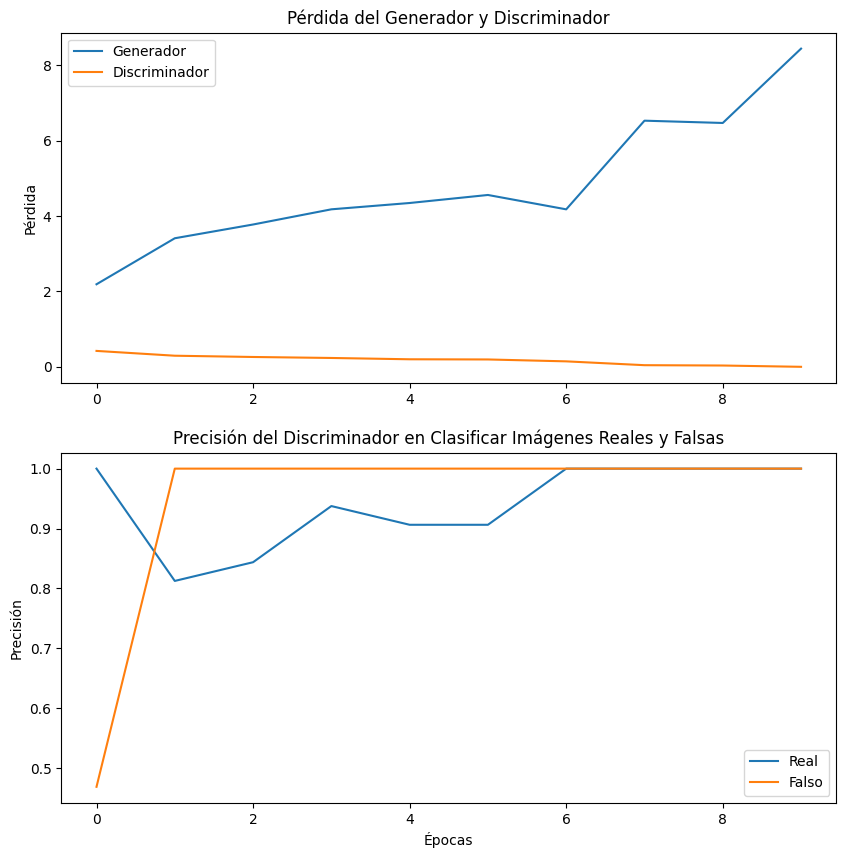

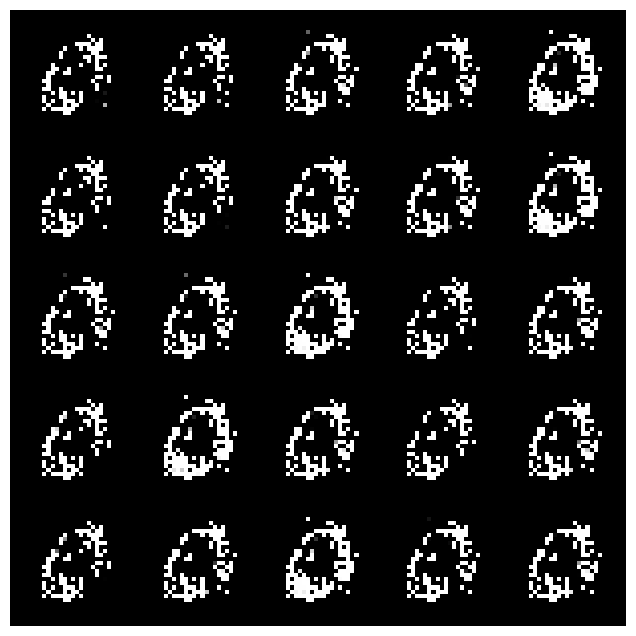

Discriminator Accuracy: 0.40646666666666664, Generator Accuracy: 0.45336666666666664
Epoch 11/30 completed


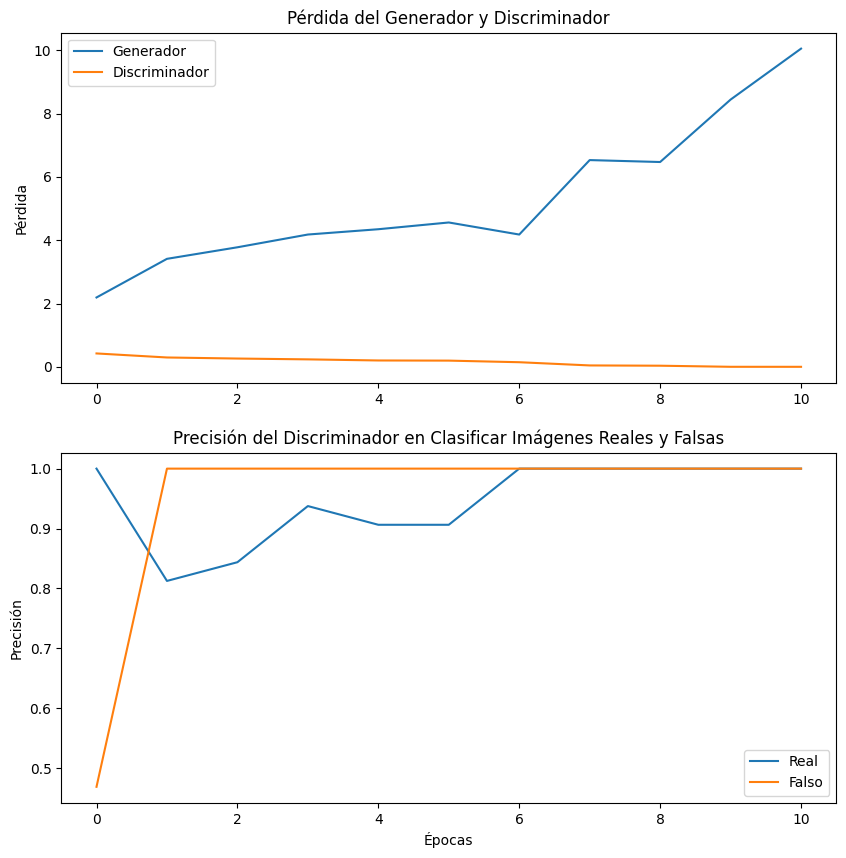

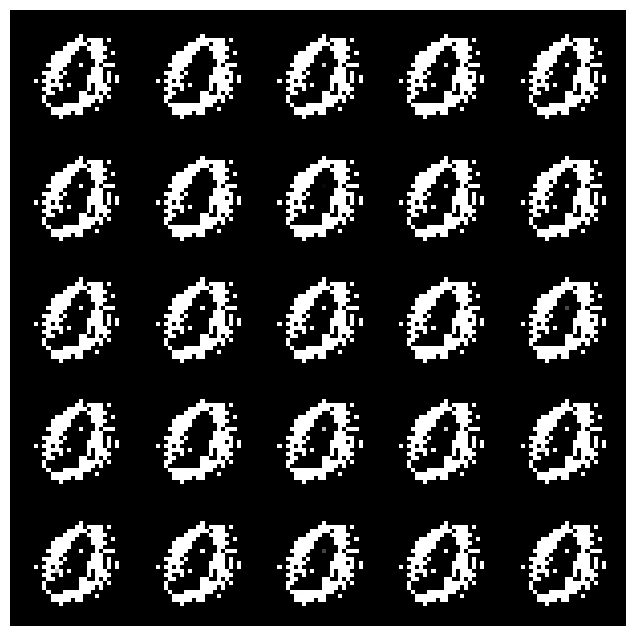

Discriminator Accuracy: 0.40646666666666664, Generator Accuracy: 0.45336666666666664
Epoch 12/30 completed


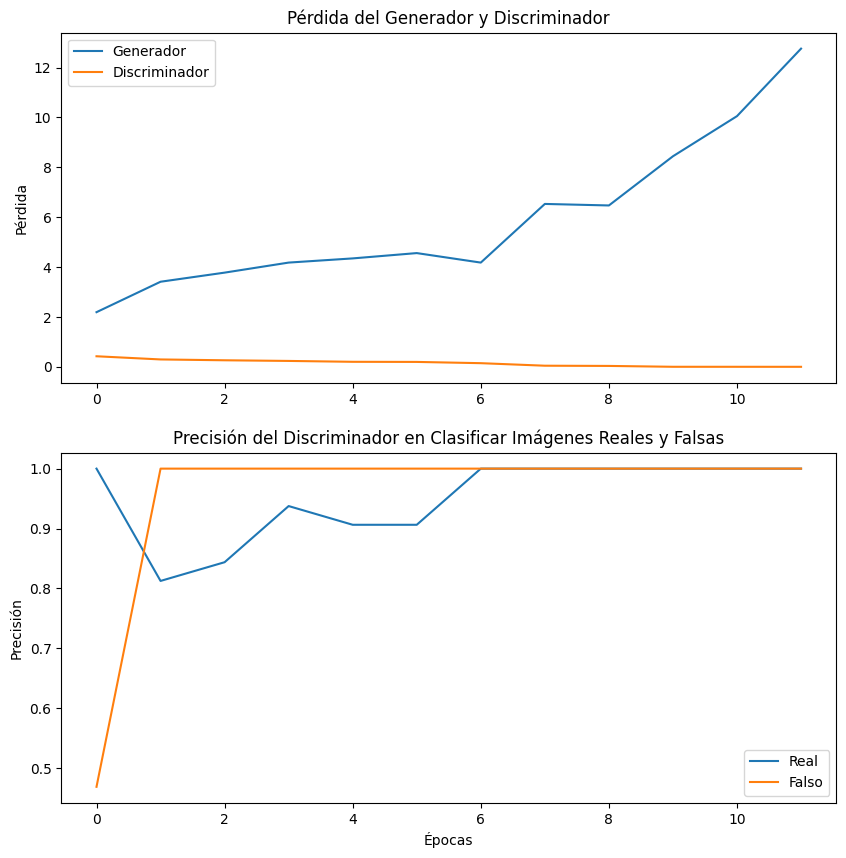

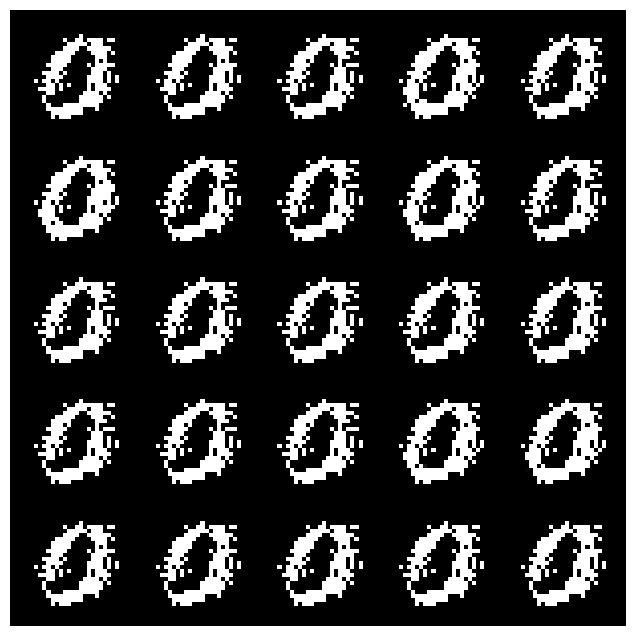

Discriminator Accuracy: 0.40646666666666664, Generator Accuracy: 0.45336666666666664
Epoch 13/30 completed


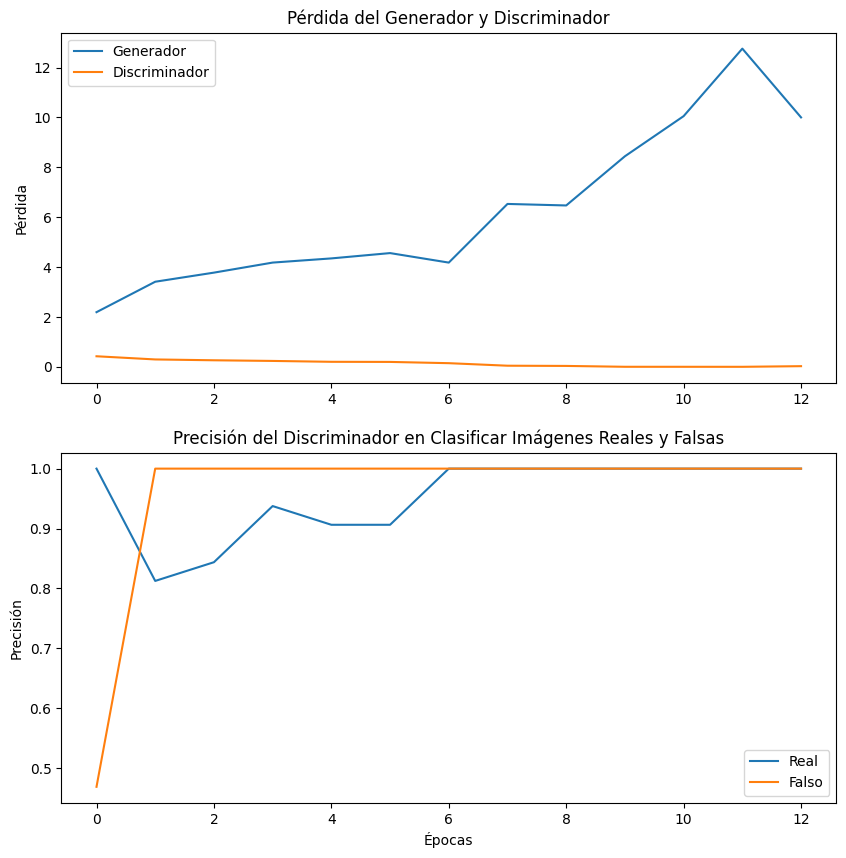

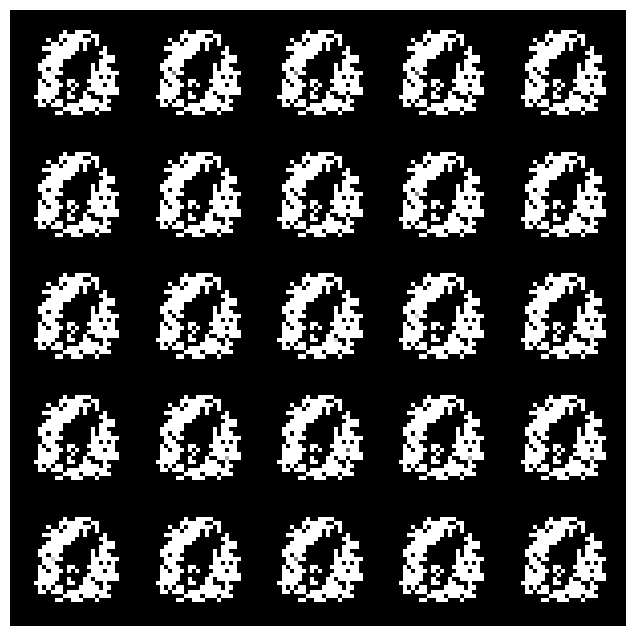

Discriminator Accuracy: 0.40646666666666664, Generator Accuracy: 0.45336666666666664
Epoch 14/30 completed


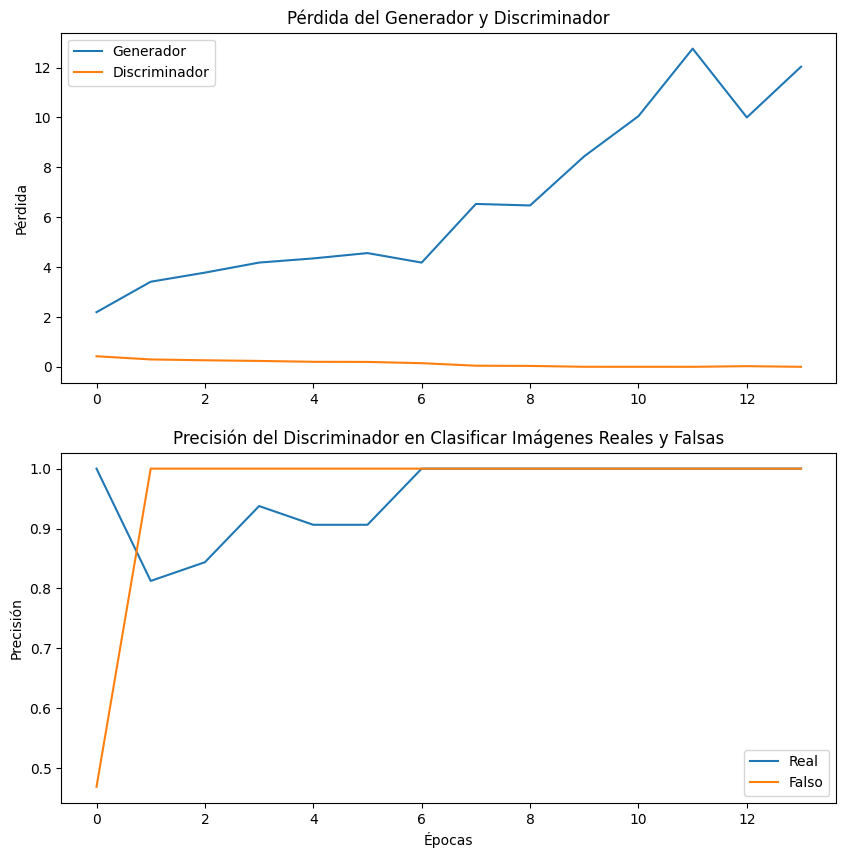

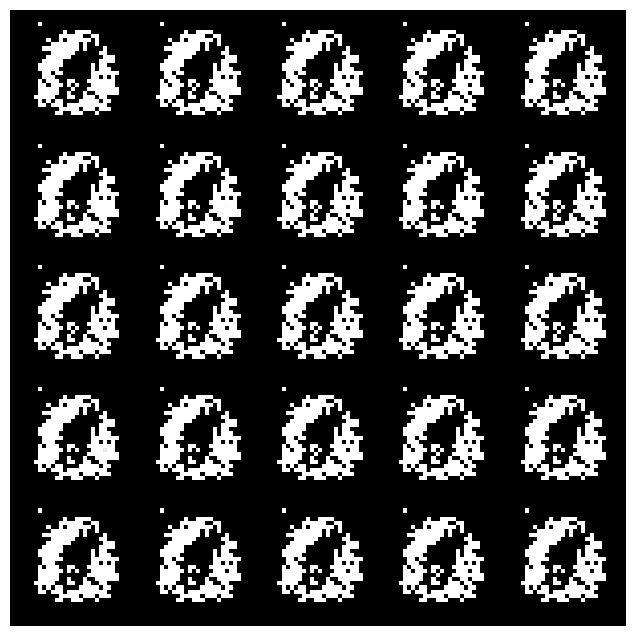

Discriminator Accuracy: 0.40646666666666664, Generator Accuracy: 0.45336666666666664
Epoch 15/30 completed


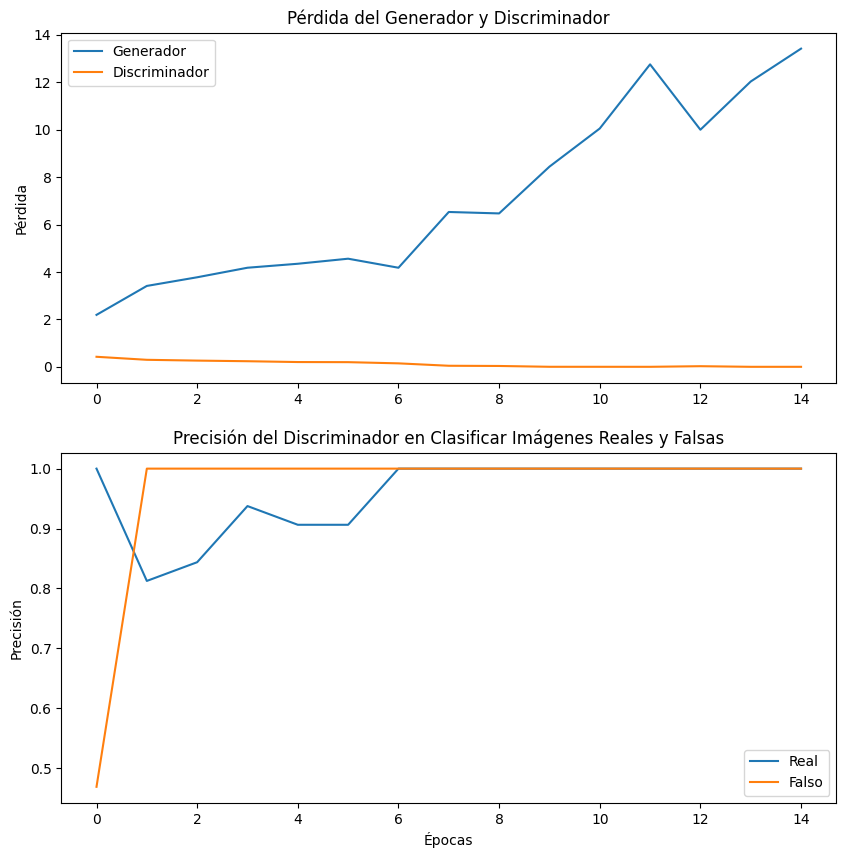

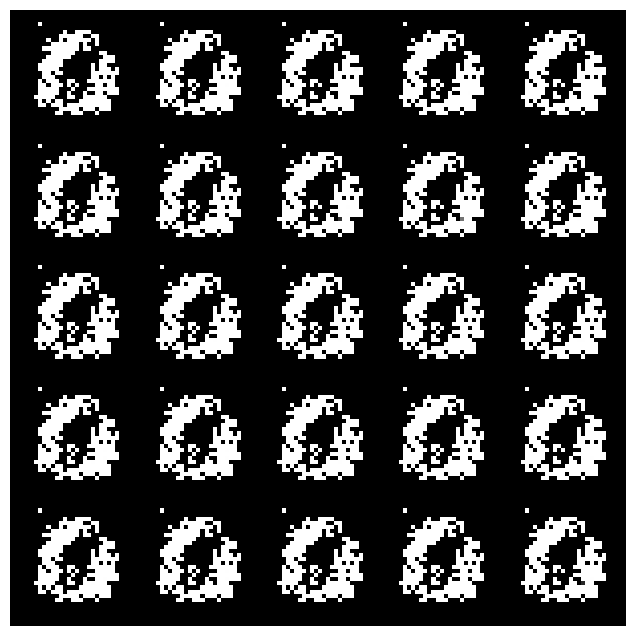

Discriminator Accuracy: 0.40646666666666664, Generator Accuracy: 0.45336666666666664
Epoch 16/30 completed


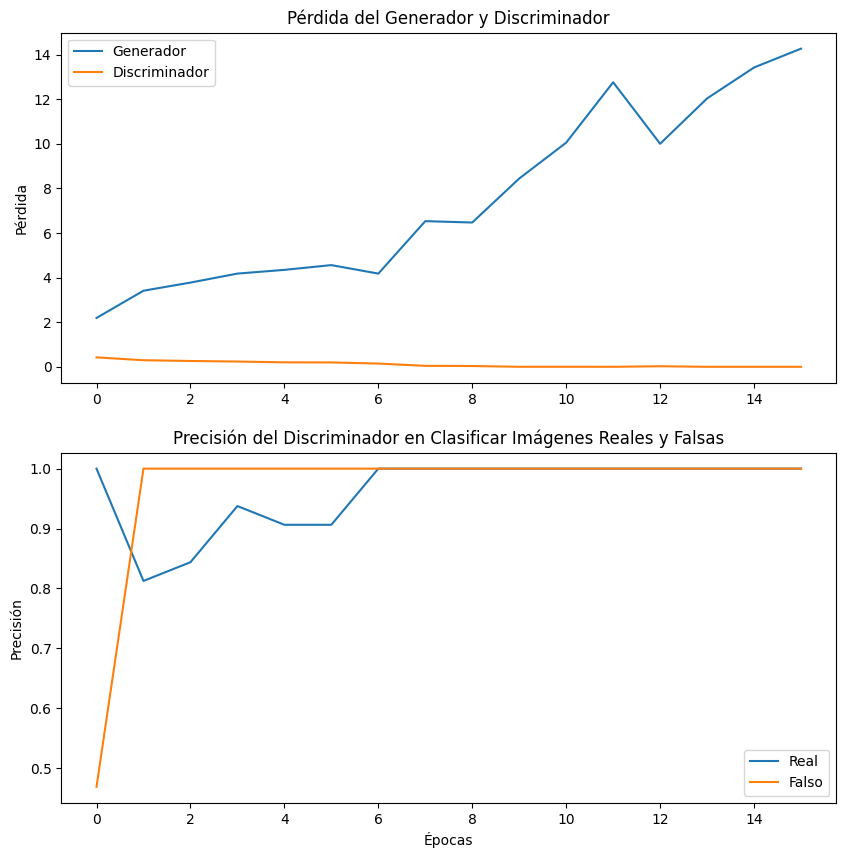

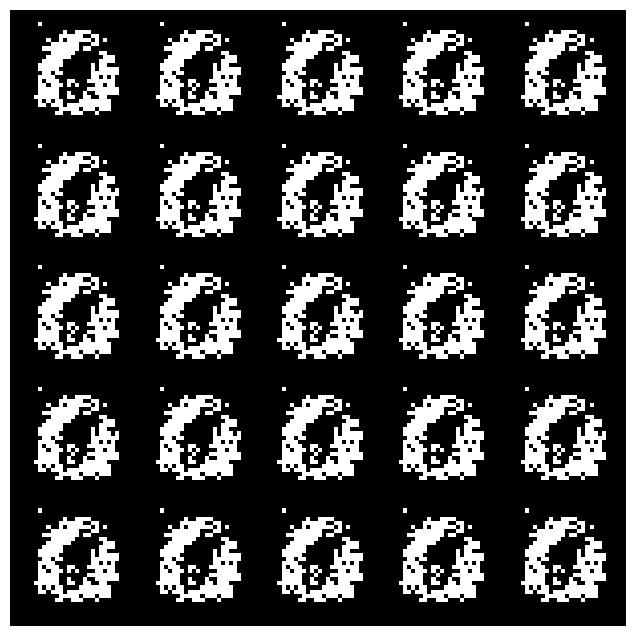

Discriminator Accuracy: 0.40646666666666664, Generator Accuracy: 0.45336666666666664
Epoch 17/30 completed


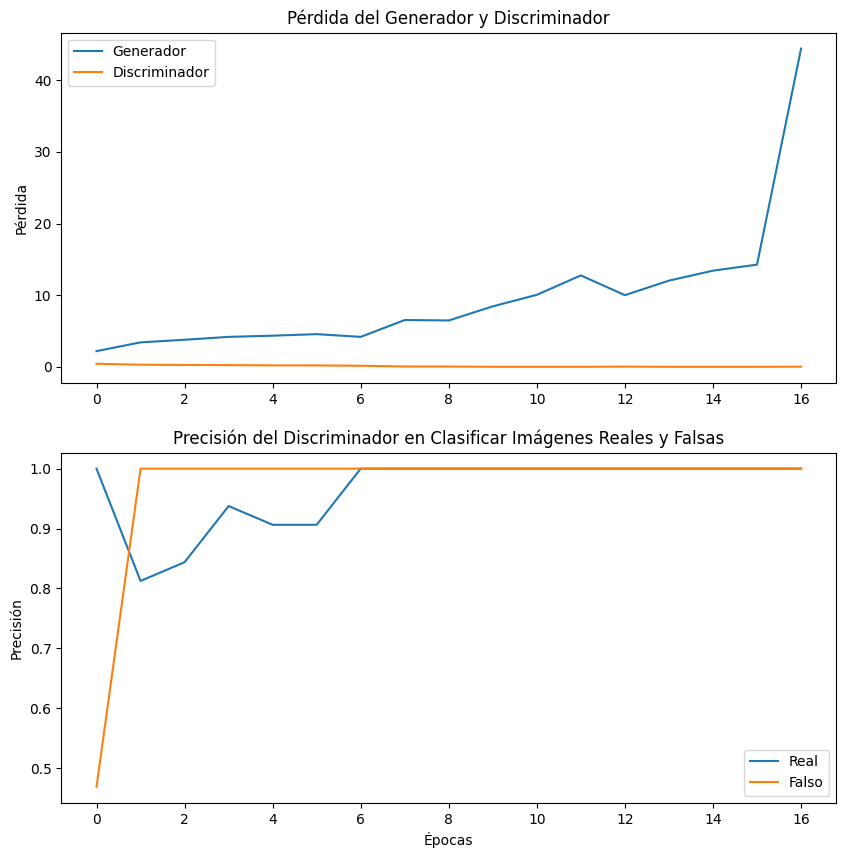

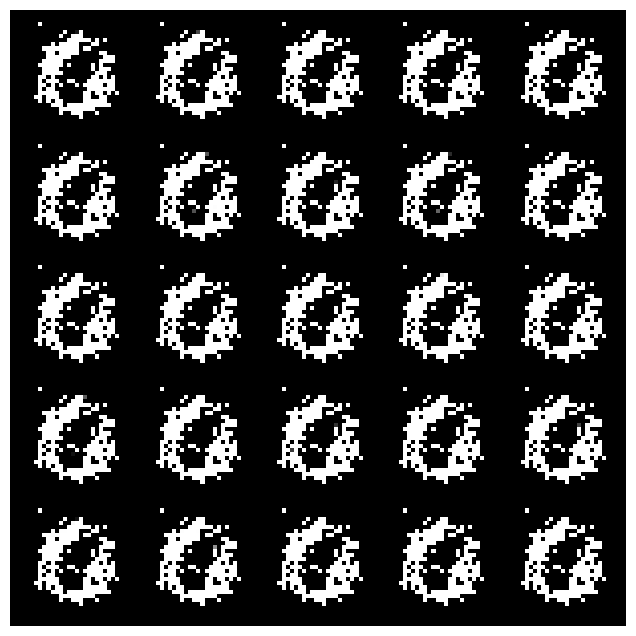

Discriminator Accuracy: 0.40646666666666664, Generator Accuracy: 0.45336666666666664
Epoch 18/30 completed


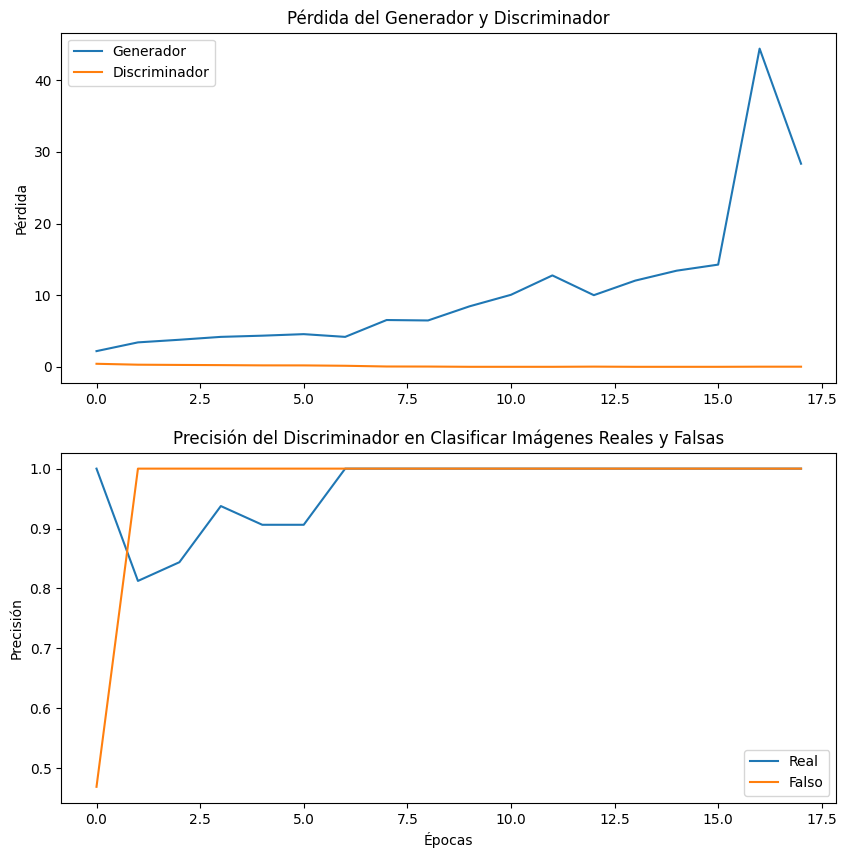

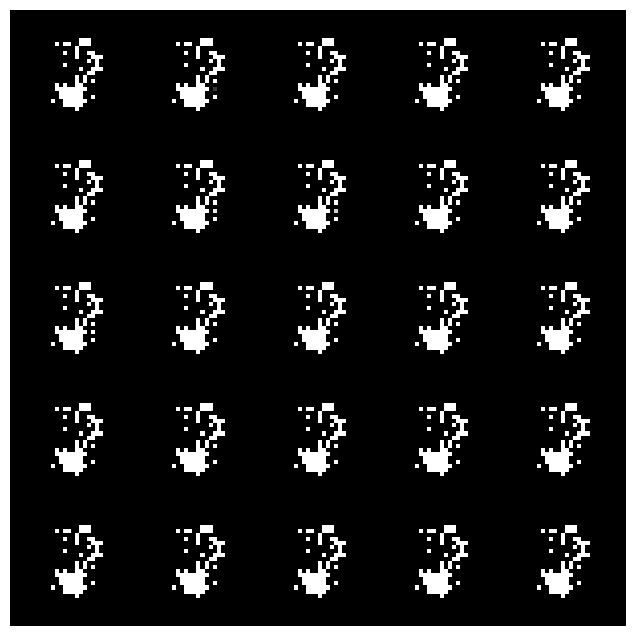

Discriminator Accuracy: 0.40646666666666664, Generator Accuracy: 0.45336666666666664
Epoch 19/30 completed


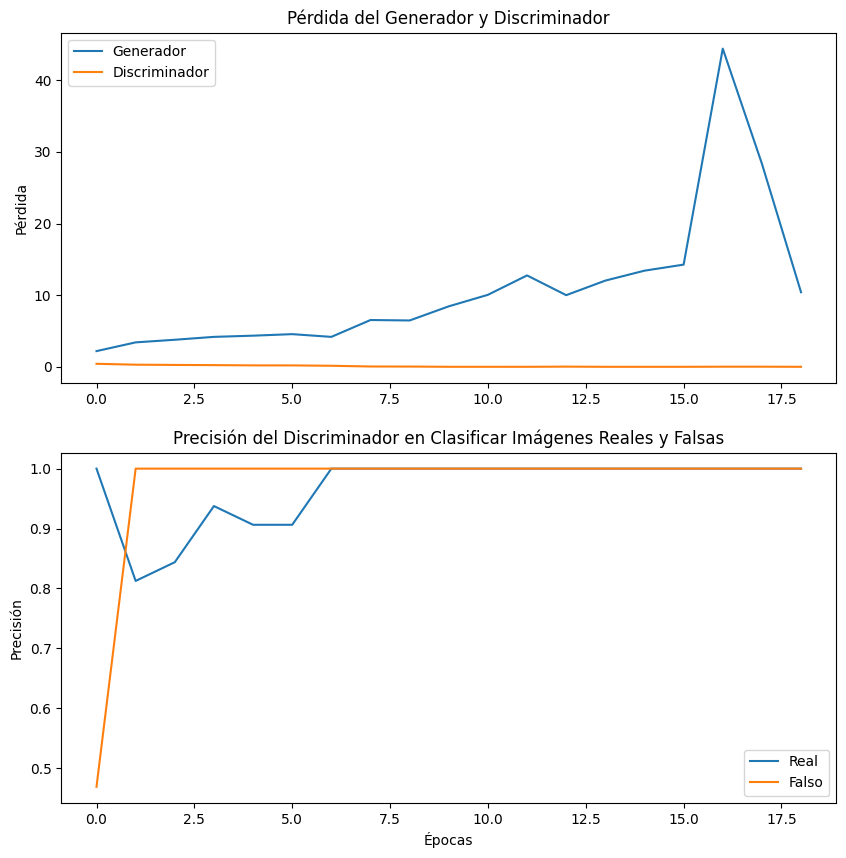

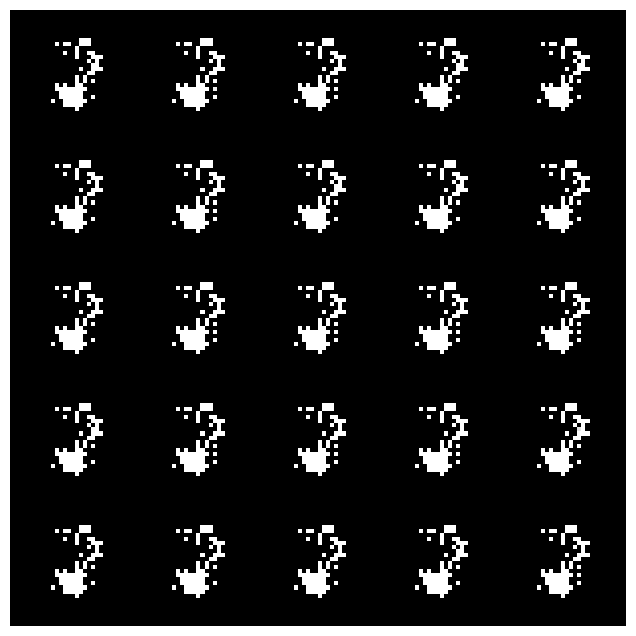

Discriminator Accuracy: 0.40646666666666664, Generator Accuracy: 0.45336666666666664
Epoch 20/30 completed


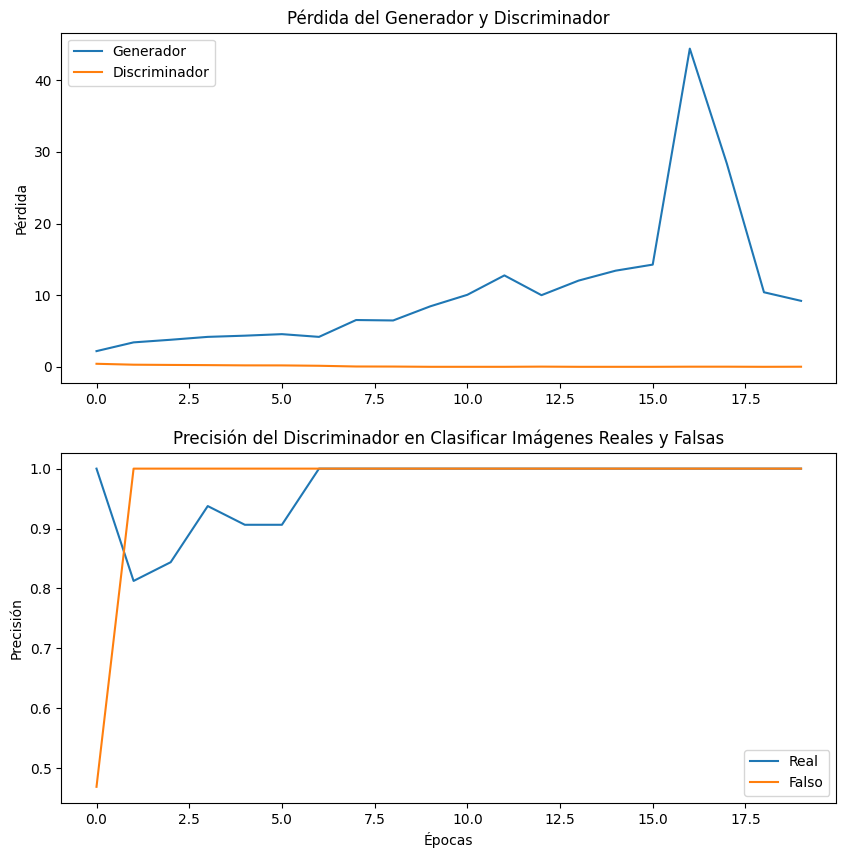

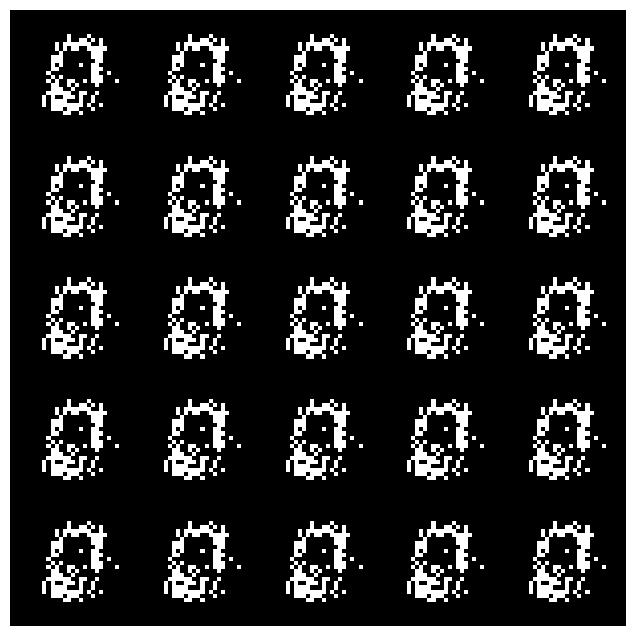

Discriminator Accuracy: 0.40646666666666664, Generator Accuracy: 0.45336666666666664
Epoch 21/30 completed


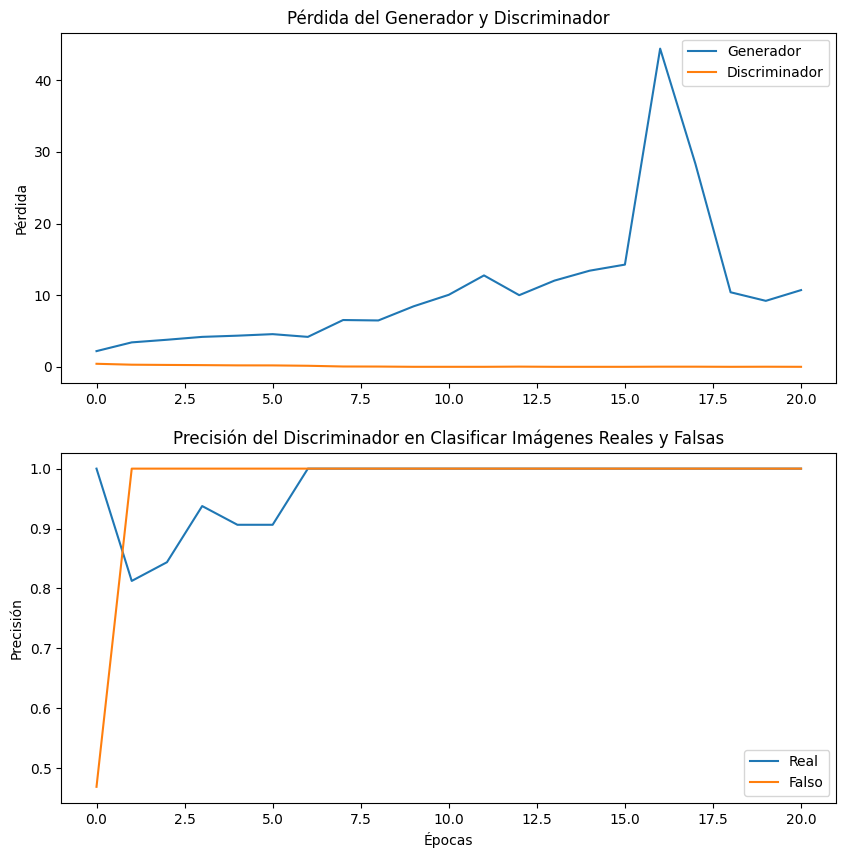

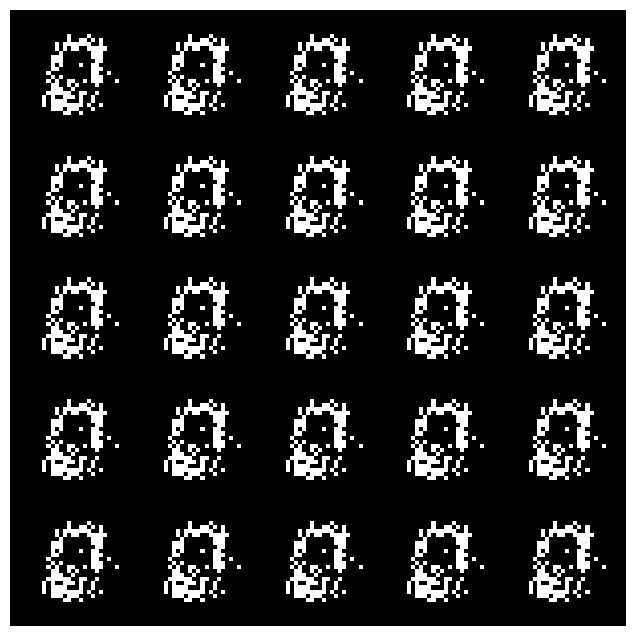

Discriminator Accuracy: 0.40646666666666664, Generator Accuracy: 0.45336666666666664
Epoch 22/30 completed


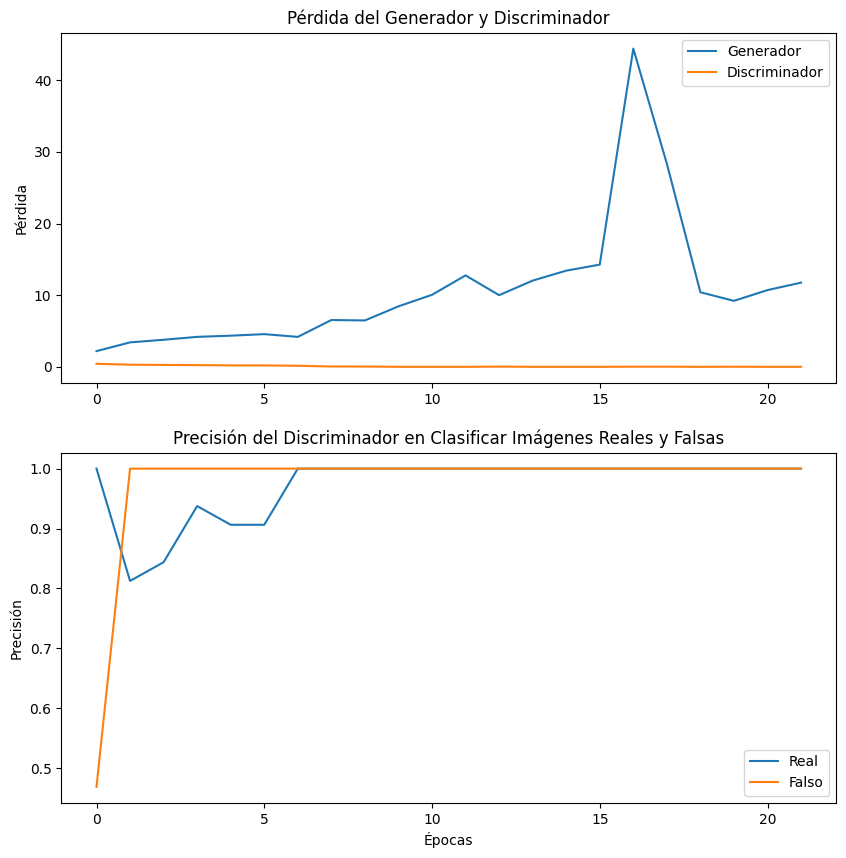

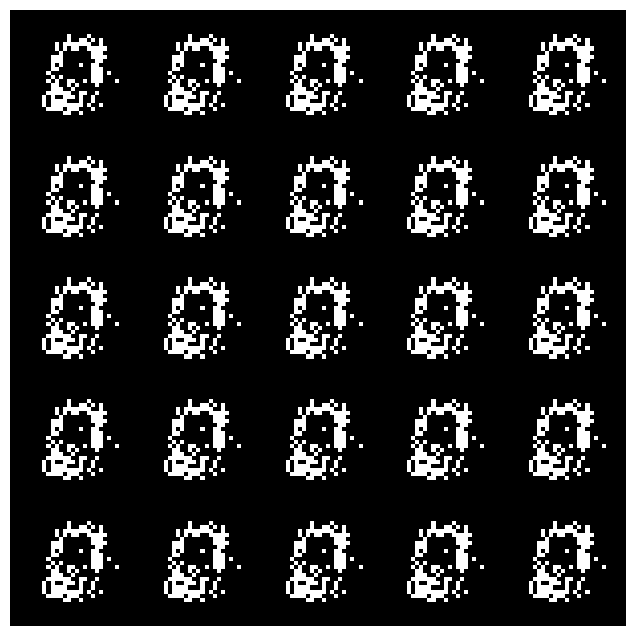

Discriminator Accuracy: 0.40646666666666664, Generator Accuracy: 0.45336666666666664
Epoch 23/30 completed


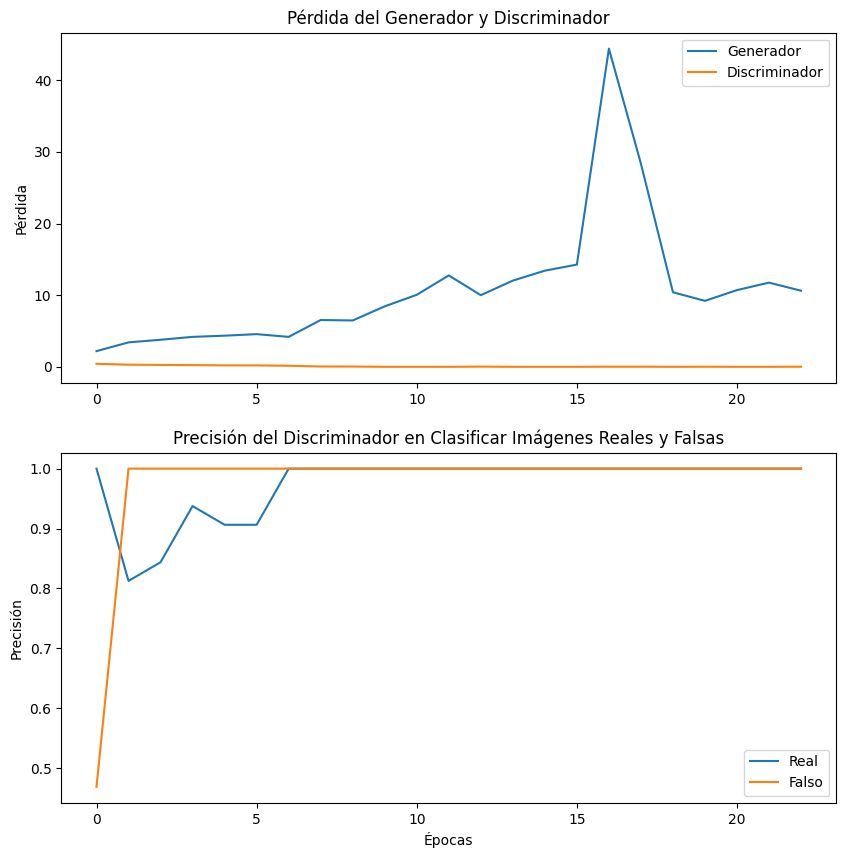

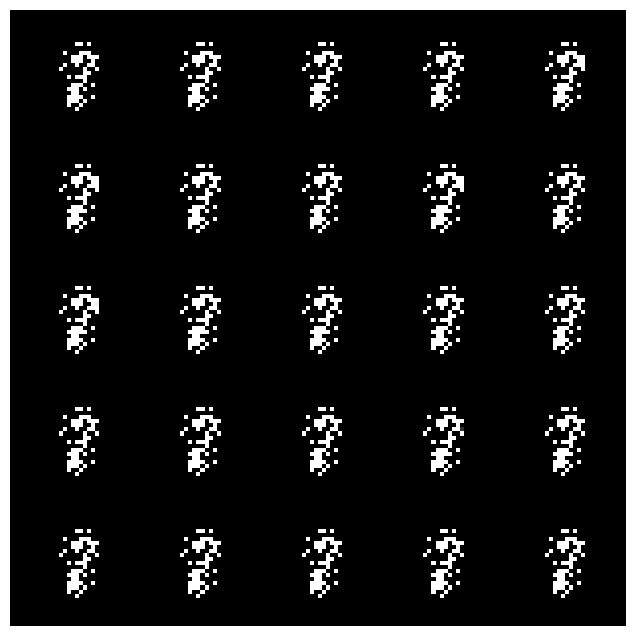

Discriminator Accuracy: 0.40646666666666664, Generator Accuracy: 0.45336666666666664
Epoch 24/30 completed


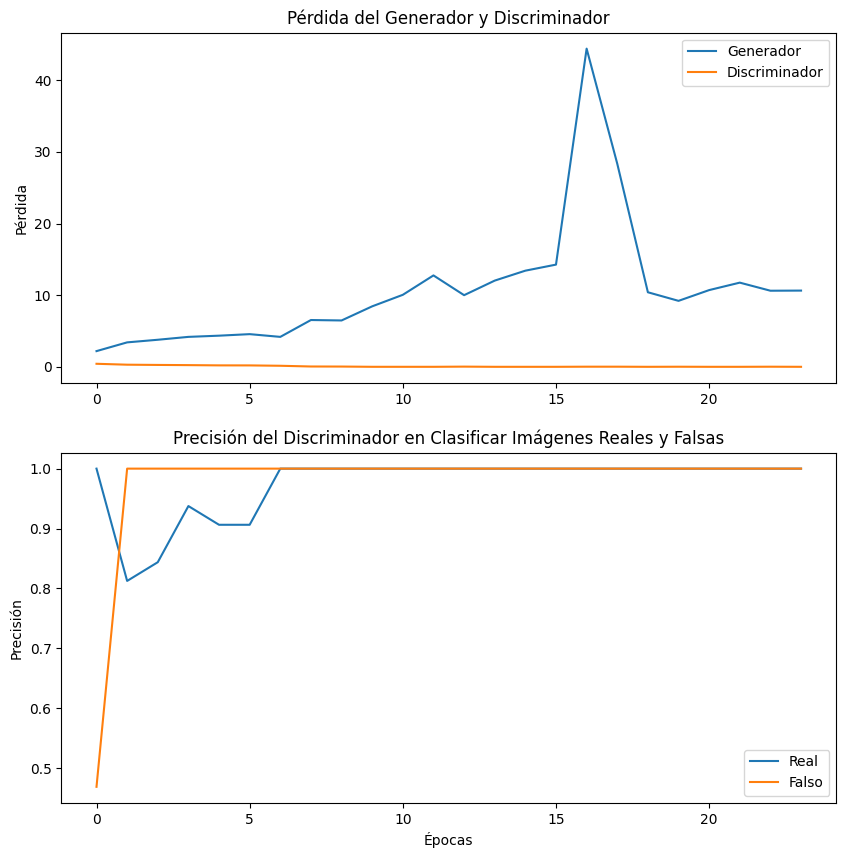

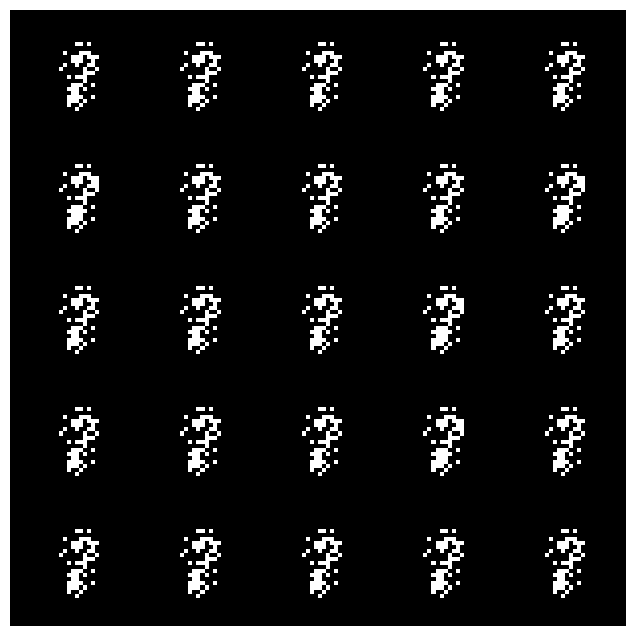

Discriminator Accuracy: 0.40646666666666664, Generator Accuracy: 0.45336666666666664
Epoch 25/30 completed


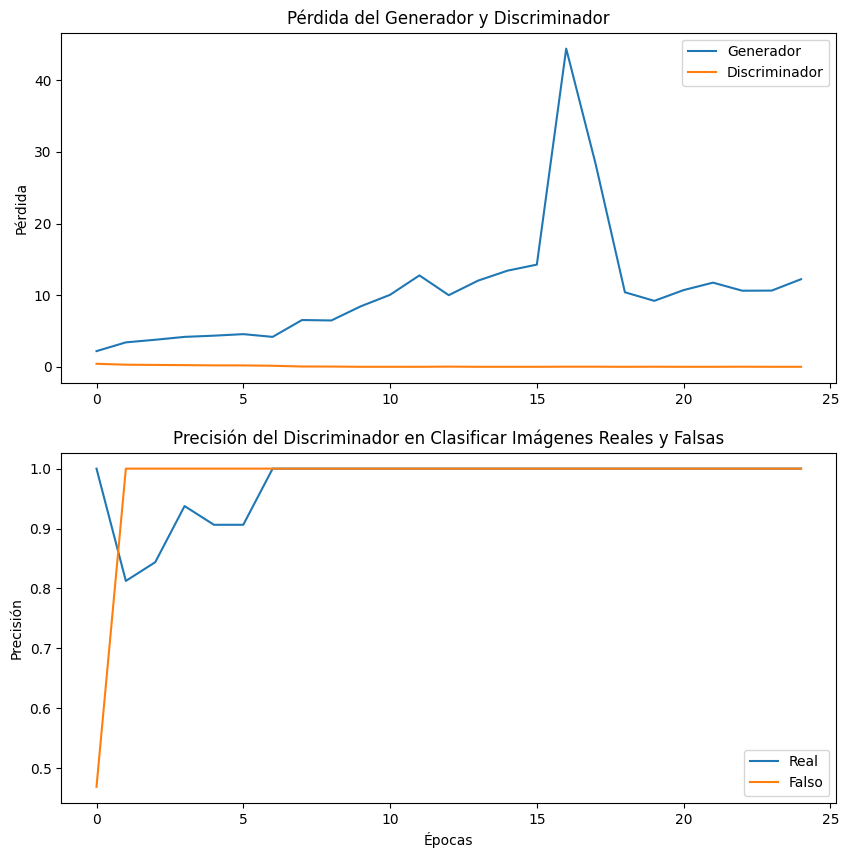

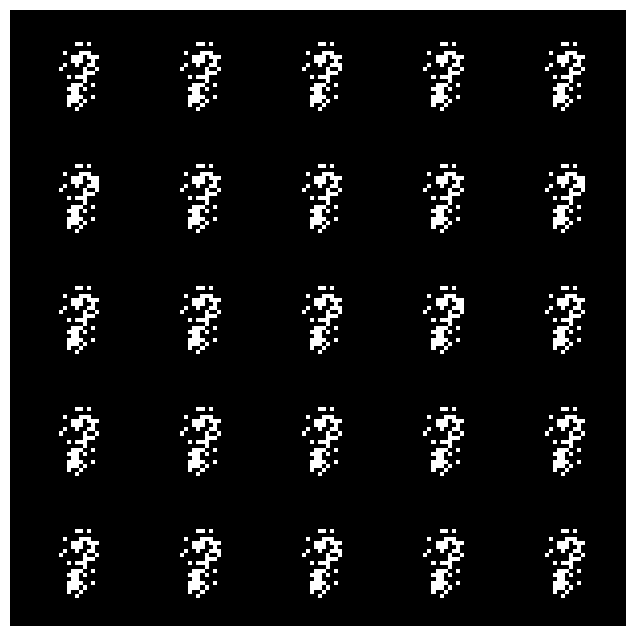

Discriminator Accuracy: 0.40646666666666664, Generator Accuracy: 0.45336666666666664
Epoch 26/30 completed


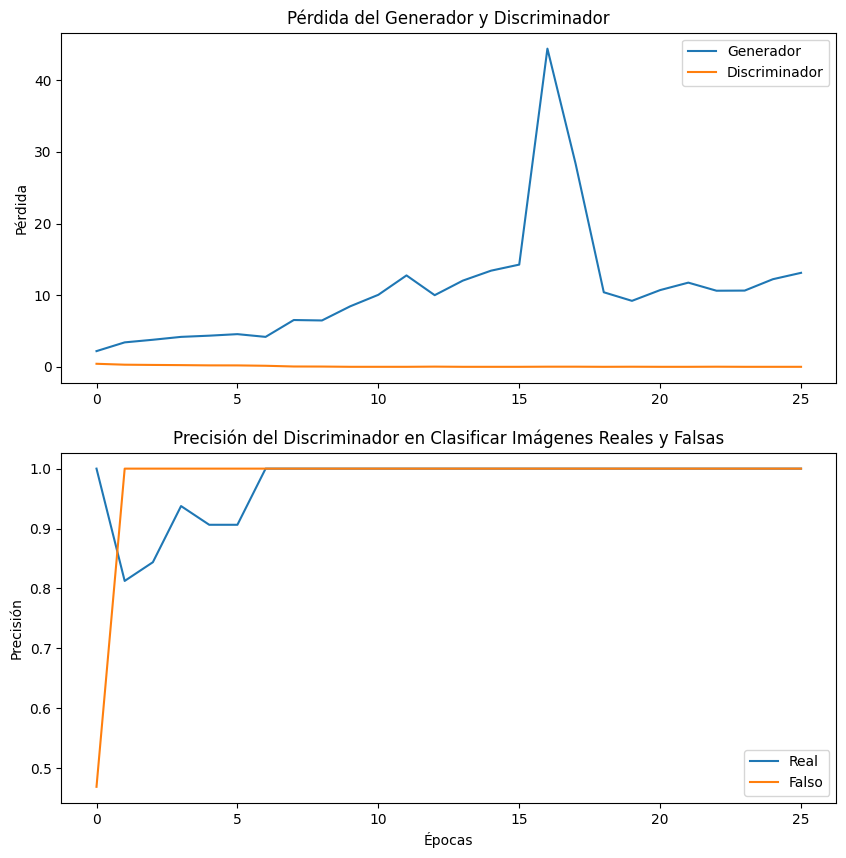

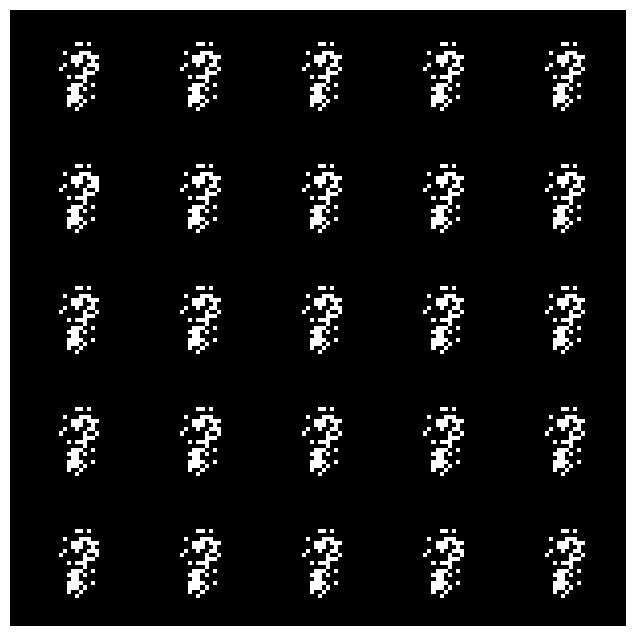

Discriminator Accuracy: 0.40646666666666664, Generator Accuracy: 0.45336666666666664
Epoch 27/30 completed


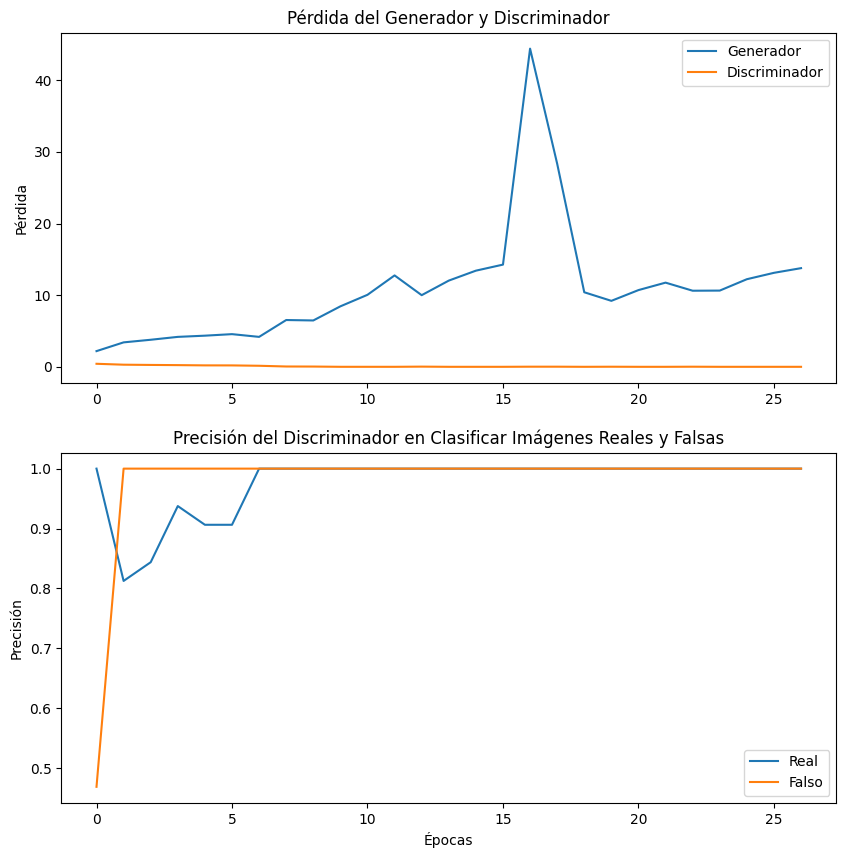

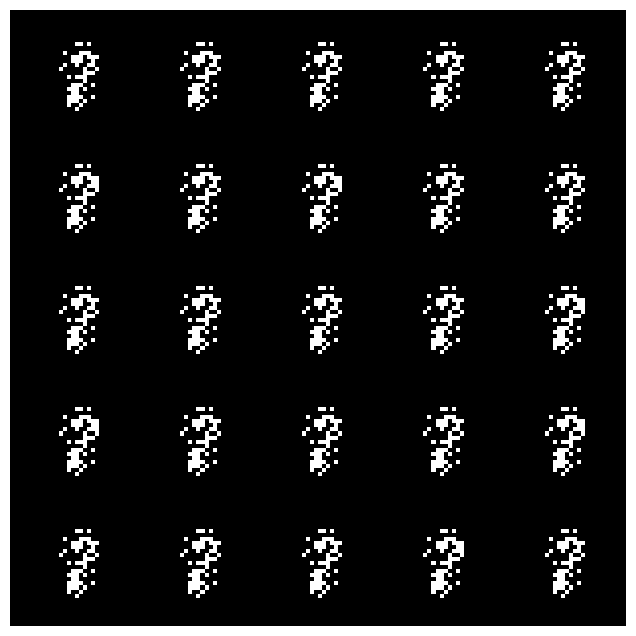

Discriminator Accuracy: 0.40646666666666664, Generator Accuracy: 0.45336666666666664
Epoch 28/30 completed


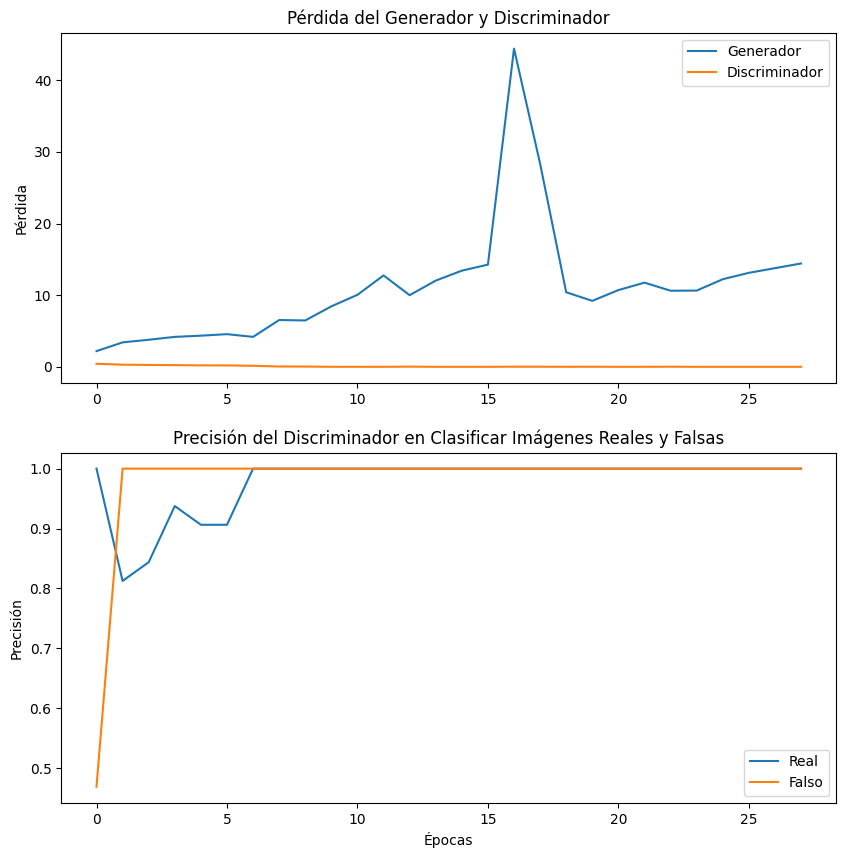

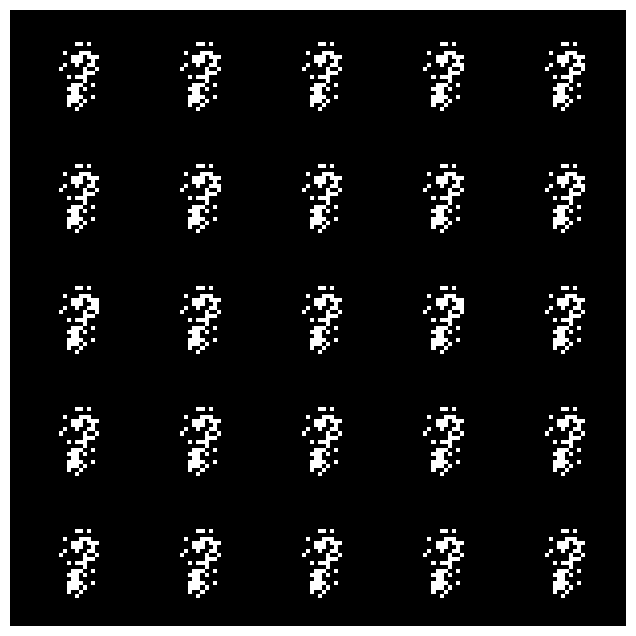

Discriminator Accuracy: 0.40646666666666664, Generator Accuracy: 0.45336666666666664
Epoch 29/30 completed


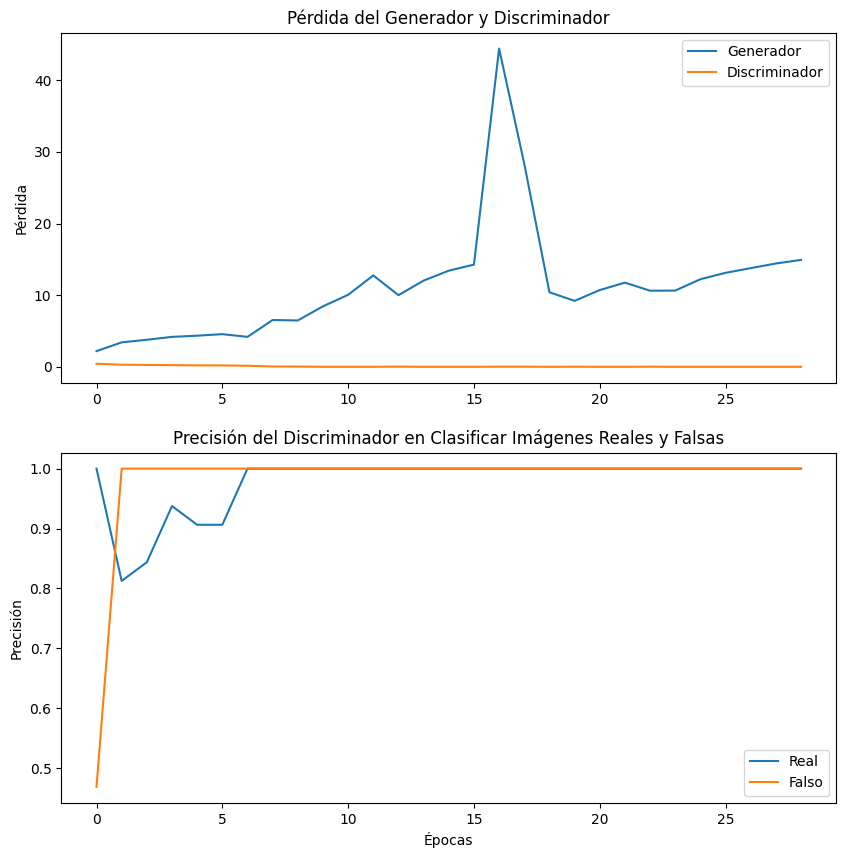

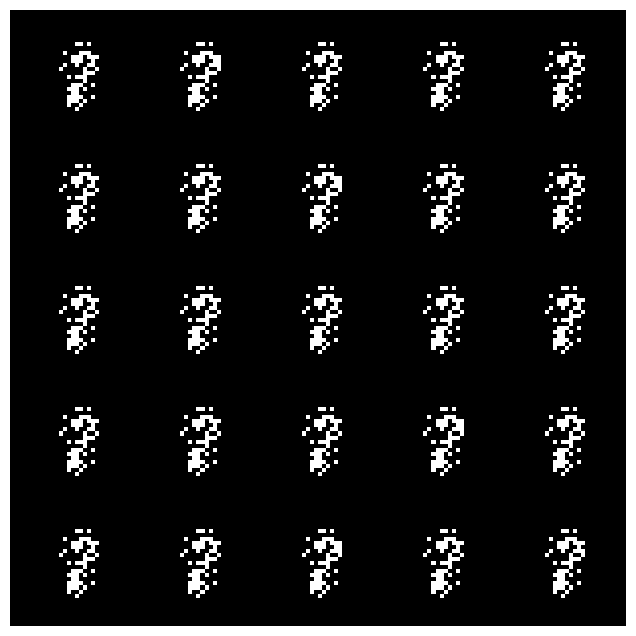

Discriminator Accuracy: 0.40646666666666664, Generator Accuracy: 0.45336666666666664
Epoch 30/30 completed


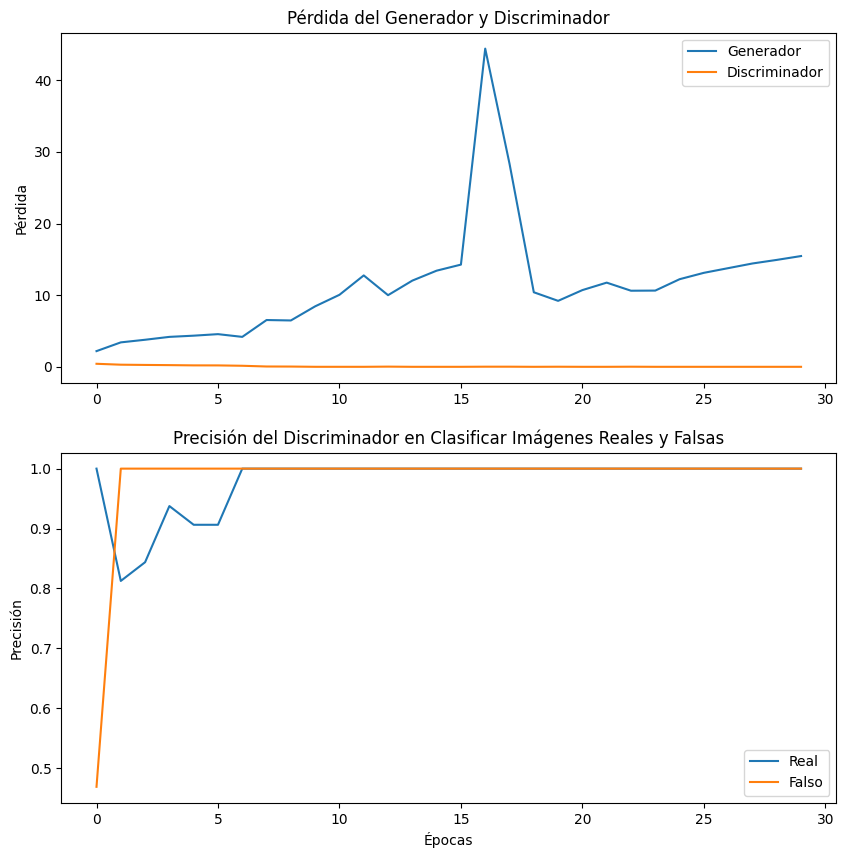

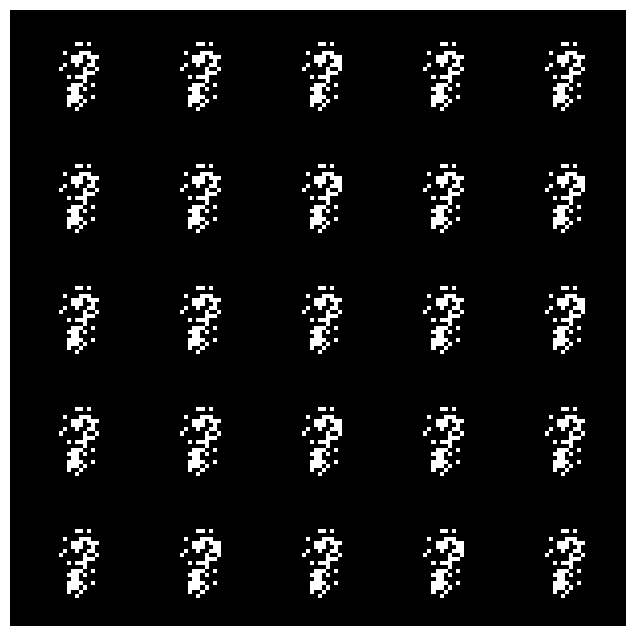

Discriminator Accuracy: 0.40646666666666664, Generator Accuracy: 0.45336666666666664
Average Generator Accuracy: 0.4533666666666665
Average Discriminator Accuracy: 0.40646666666666664


In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

generator = GeneratorCGAN().to(device)
discriminator = DiscriminatorCGAN().to(device)

# Optimizadores
optimizer_G = optim.Adam(generator.parameters(), lr=0.0002, betas=(0.5, 0.999))
optimizer_D = optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))

# Función de pérdida
criterion = nn.BCELoss()

# Listas para almacenar pérdidas
G_losses = []
D_losses = []
D_real_accuracy = []
D_fake_accuracy = []
average_G_losses = []
average_D_losses = []
G_accuracies = []
D_accuracies = []


# Número de épocas
num_epochs = 30

# Entrenamiento
for epoch in range(num_epochs):
    G_loss_accum = 0.0
    D_loss_accum = 0.0
    num_batches = 0
    num_correct_real = 0
    num_correct_fake = 0
    total_samples = 0
    for i, (real_images, labels) in enumerate(mnist_train_loader):
        num_batches += 1
        total_samples += real_images.size(0)
        real_images = real_images.to(device)
        labels = labels.to(device)
        real = torch.ones(real_images.size(0), 1, device=device)
        fake = torch.zeros(real_images.size(0), 1, device=device)

        # Entrenar el discriminador con imágenes reales y etiquetas
        discriminator.zero_grad()
        real_preds = discriminator(real_images, labels)
        loss_real = criterion(real_preds, real)
        num_correct_real += torch.sum(output_real >= 0.5).item()  # Imágenes reales clasificadas como reales

        # Generar imágenes falsas
        noise = torch.randn(real_images.size(0), 100, device=device)
        fake_images = generator(noise, labels)
        fake_preds = discriminator(fake_images.detach(), labels)
        loss_fake = criterion(fake_preds, fake)
        num_correct_fake += torch.sum(output_fake < 0.5).item()  # Imágenes falsas clasificadas como falsas


        loss_D = (loss_real + loss_fake) / 2
        loss_D.backward()
        optimizer_D.step()

        # Entrenar el generador
        generator.zero_grad()
        output = discriminator(fake_images, labels)
        loss_G = criterion(output, real)
        loss_G.backward()
        optimizer_G.step()

        # Guardar las pérdidas para visualización
        G_losses.append(loss_G.item())
        D_losses.append(loss_D.item())
        G_loss_accum += loss_G.item()
        D_loss_accum += loss_D.item()

        with torch.no_grad():
            real_correct = torch.sum(real_preds >= 0.5).item()  # Imágenes reales clasificadas como reales
            fake_correct = torch.sum(fake_preds < 0.5).item()  # Imágenes falsas clasificadas como falsas

    # Calcular precisión del discriminador y el generador
    D_accuracy = (num_correct_real + num_correct_fake) / (2 * total_samples)
    G_accuracy = num_correct_fake / total_samples
    D_accuracies.append(D_accuracy)
    G_accuracies.append(G_accuracy)

    average_G_losses.append(G_loss_accum / num_batches)
    average_D_losses.append(D_loss_accum / num_batches)
    D_real_accuracy.append(real_correct / real_images.size(0))
    D_fake_accuracy.append(fake_correct / real_images.size(0))

    save_generated_images(generator, device, epoch)
    create_gif('generated_images', "cgan_mnist.gif")
    # Mostrar pérdidas y generar imágenes al final de cada época
    print(f"Epoch {epoch + 1}/{num_epochs} completed")
    plot_metrics(average_G_losses, average_D_losses, D_real_accuracy, D_fake_accuracy)
    show_generated_images(generator, device, labels)
    print(f"Discriminator Accuracy: {D_accuracy}, Generator Accuracy: {G_accuracy}")

# Imprimir la precisión promedio del discriminador y del generador al final
print(f"Average Generator Accuracy: {np.mean(G_accuracies)}")
print(f"Average Discriminator Accuracy: {np.mean(D_accuracies)}")

#### Fashion MNIST Dataset

##### GAN Simple

<ipython-input-51-902d87a423af>:4: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  images.append(imageio.imread(file_name))


Epoch 1/30 completed


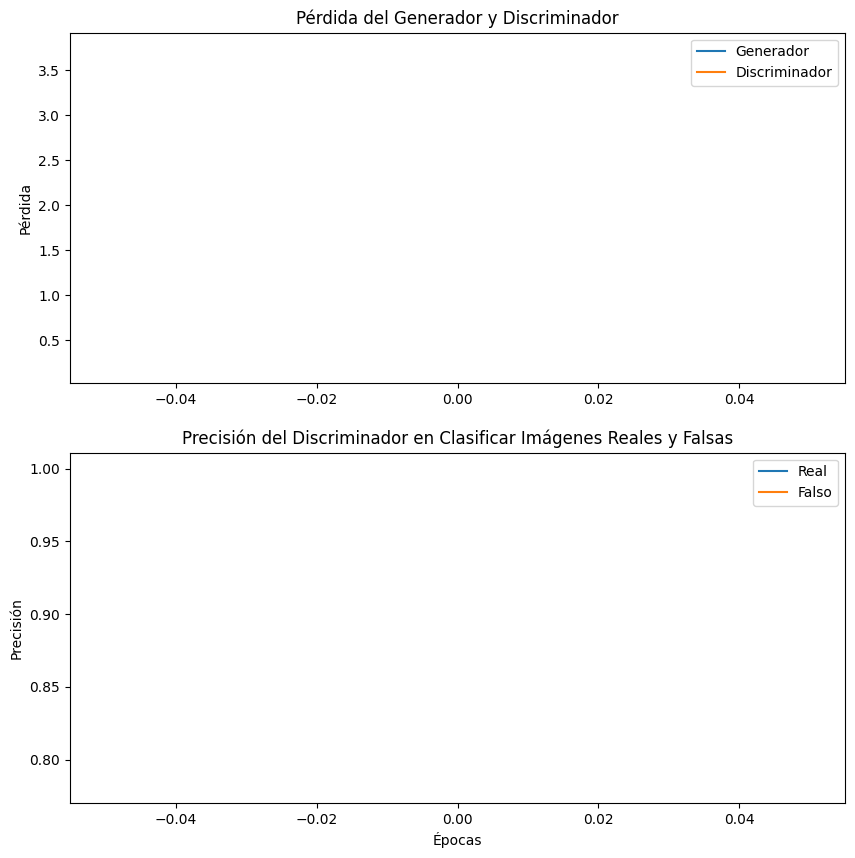

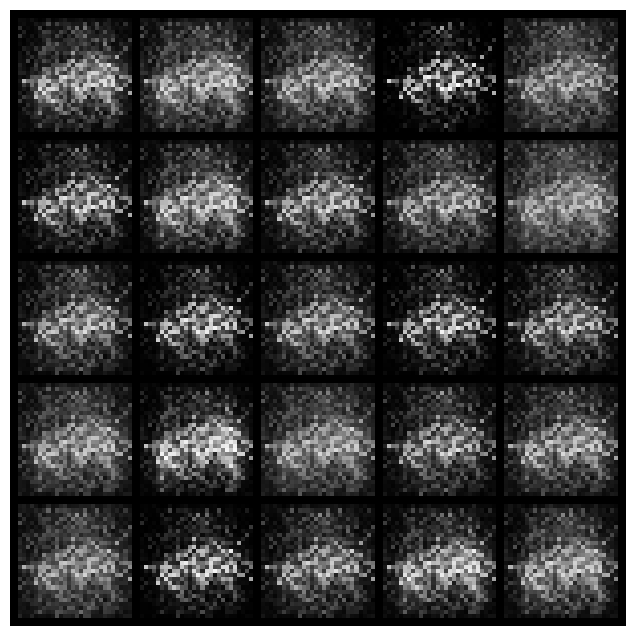

Discriminator Accuracy: 0.9270916666666666, Generator Accuracy: 0.90565
Epoch 2/30 completed


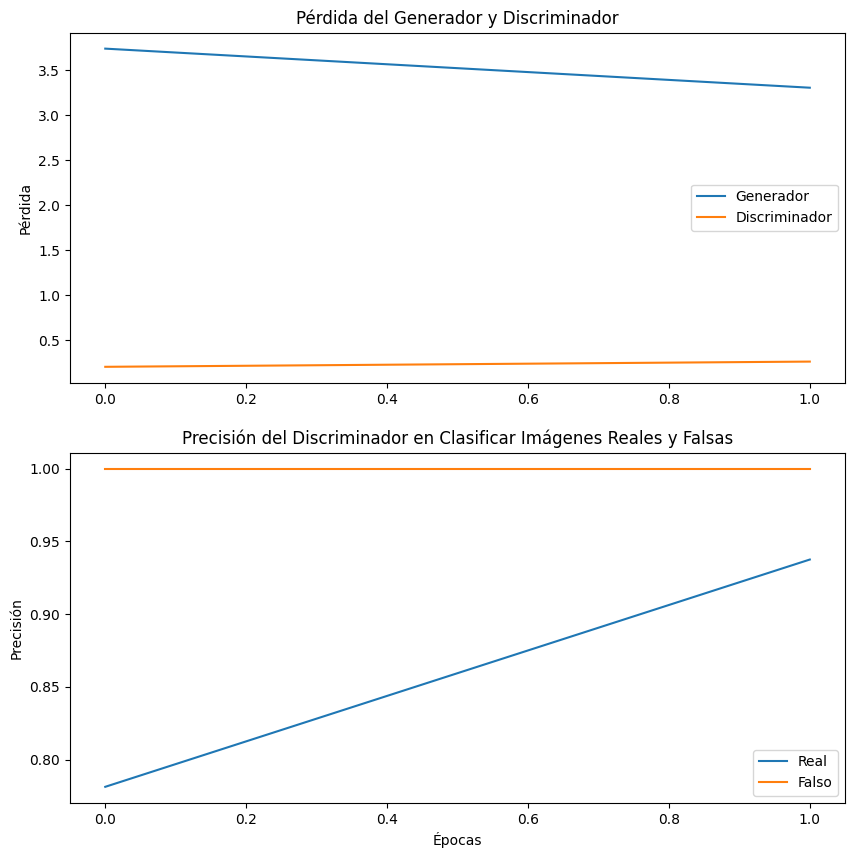

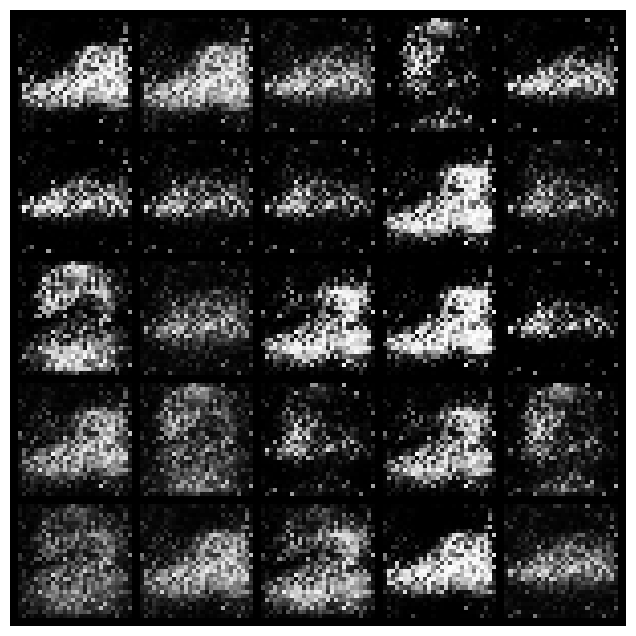

Discriminator Accuracy: 0.9011833333333333, Generator Accuracy: 0.94265
Epoch 3/30 completed


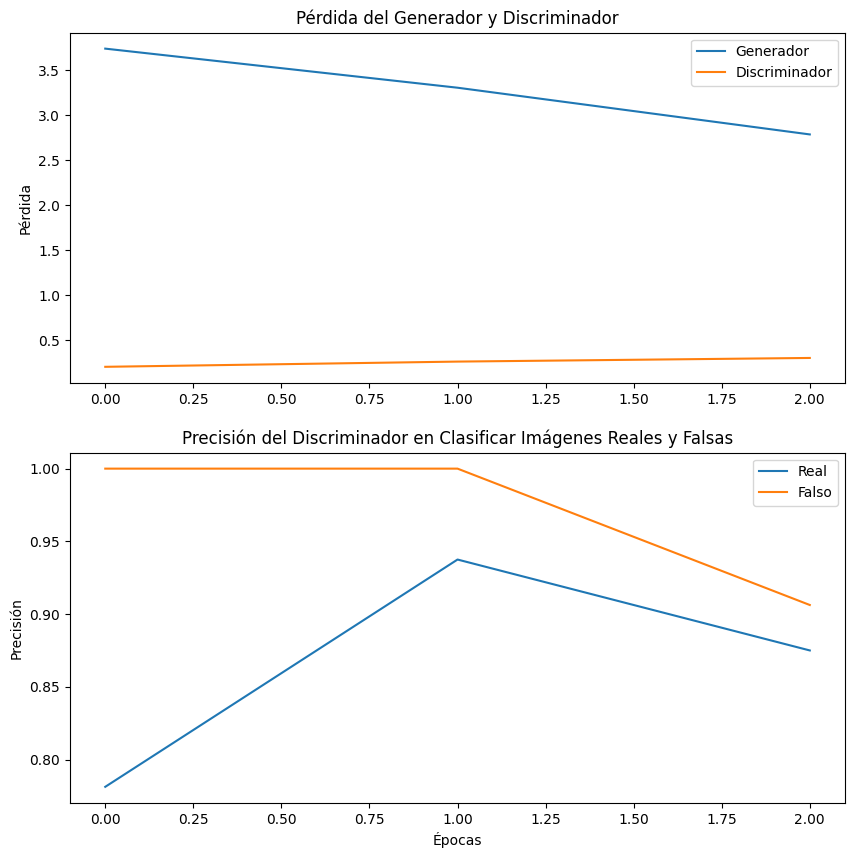

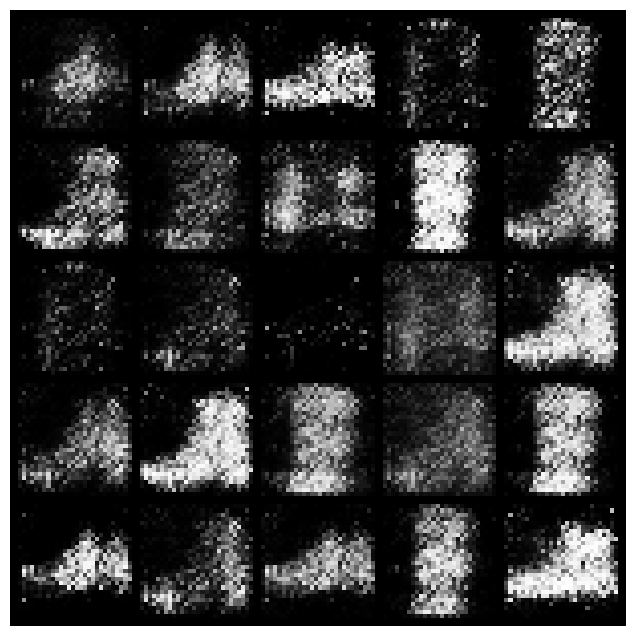

Discriminator Accuracy: 0.8798166666666667, Generator Accuracy: 0.9264666666666667
Epoch 4/30 completed


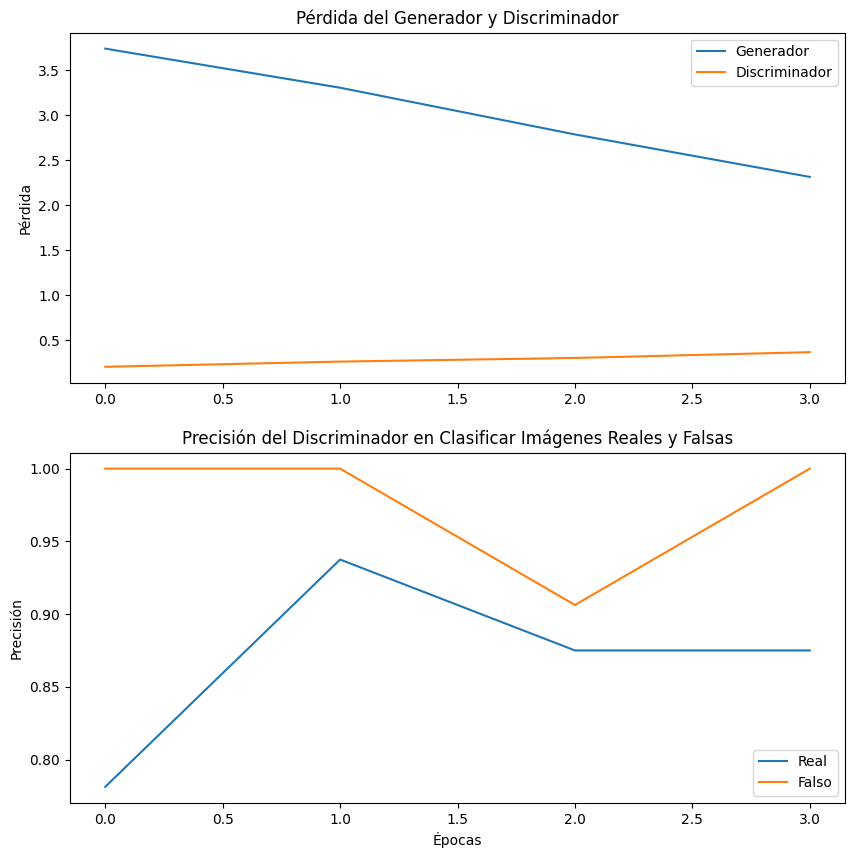

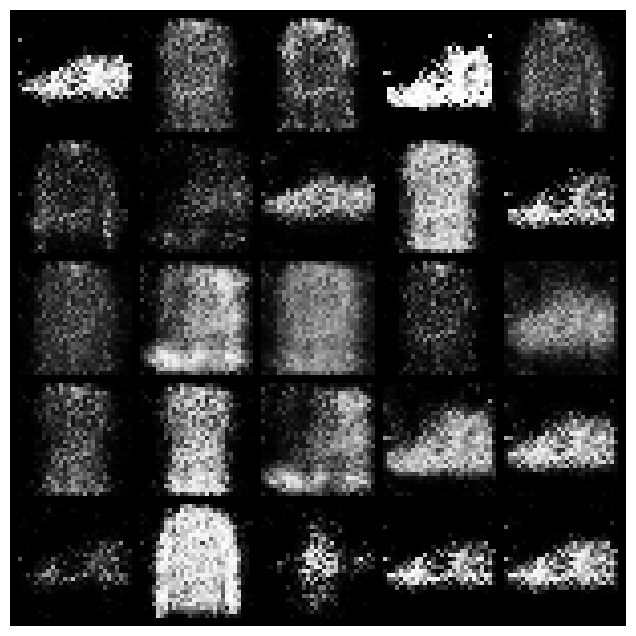

Discriminator Accuracy: 0.8422333333333333, Generator Accuracy: 0.89405
Epoch 5/30 completed


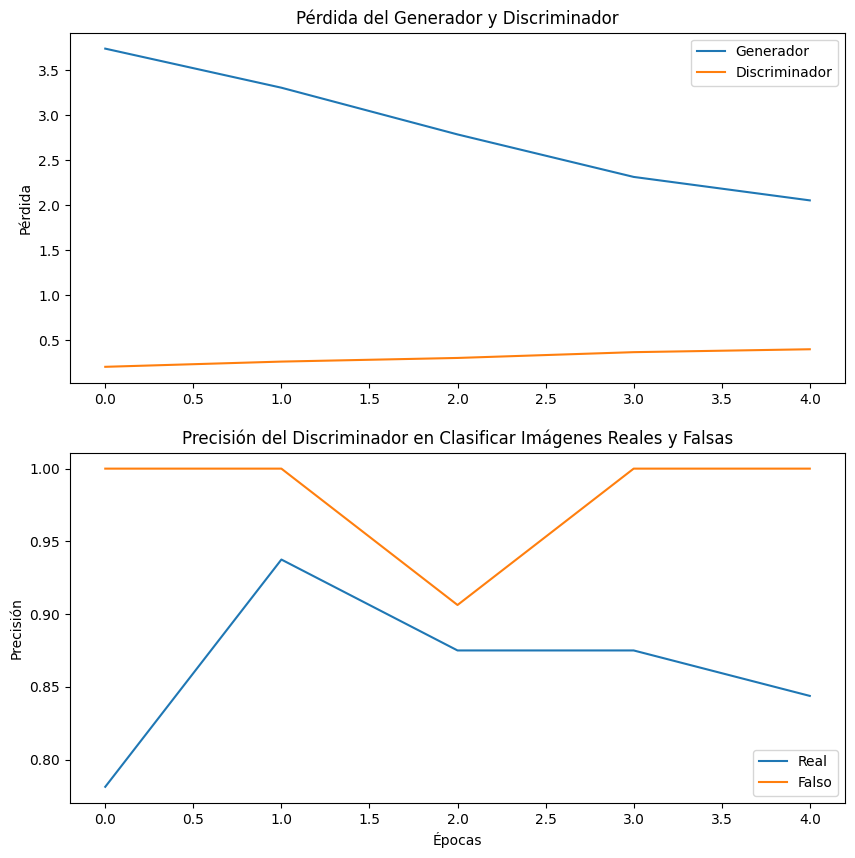

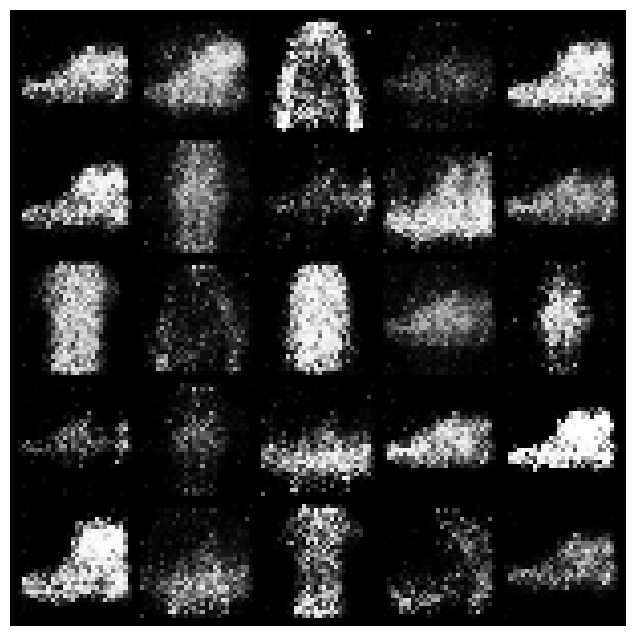

Discriminator Accuracy: 0.821525, Generator Accuracy: 0.8799833333333333
Epoch 6/30 completed


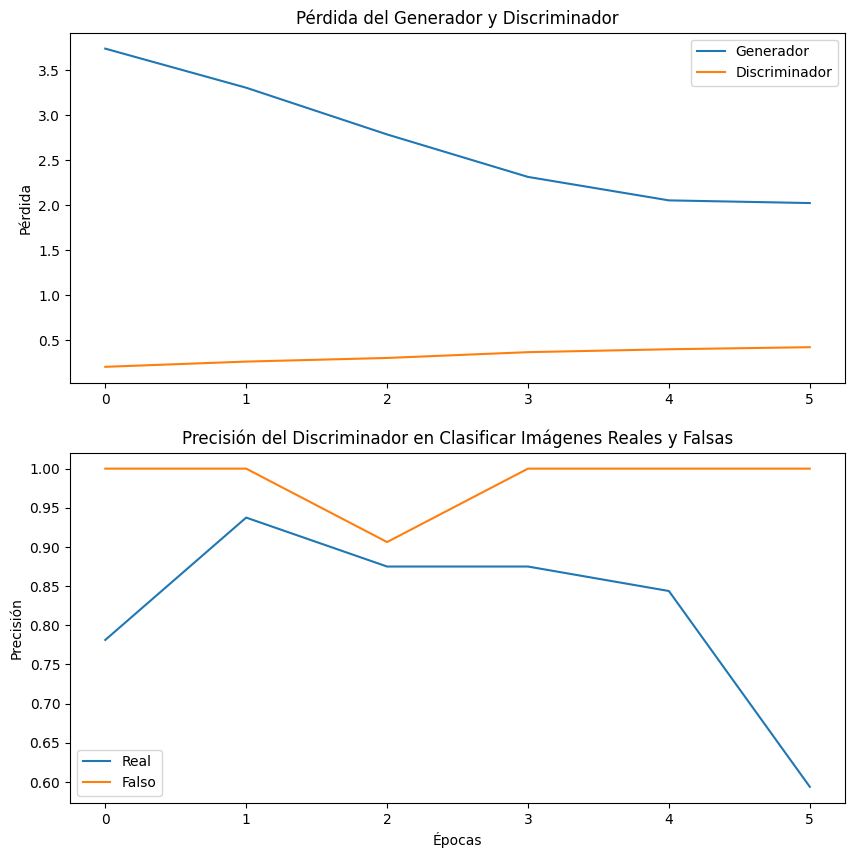

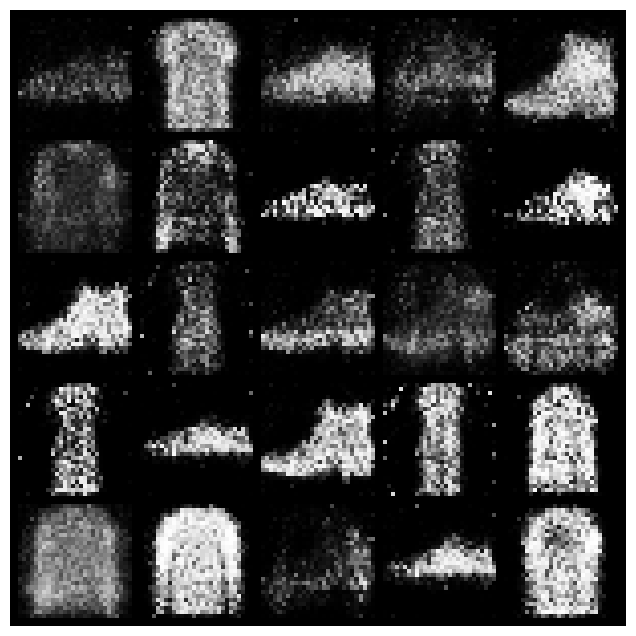

Discriminator Accuracy: 0.808675, Generator Accuracy: 0.8561666666666666
Epoch 7/30 completed


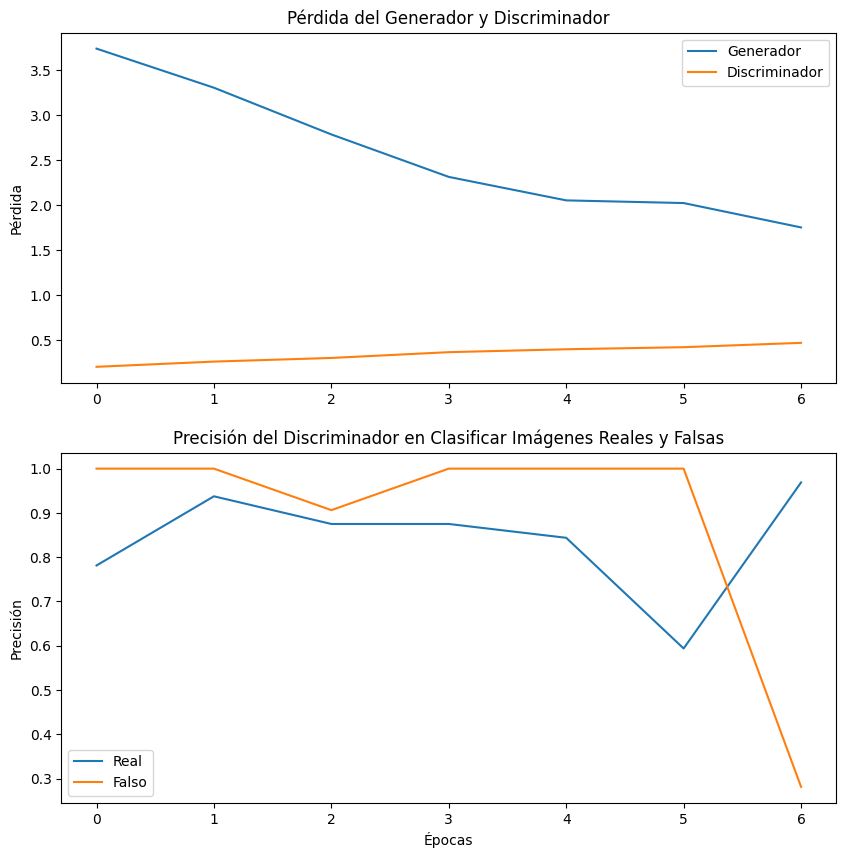

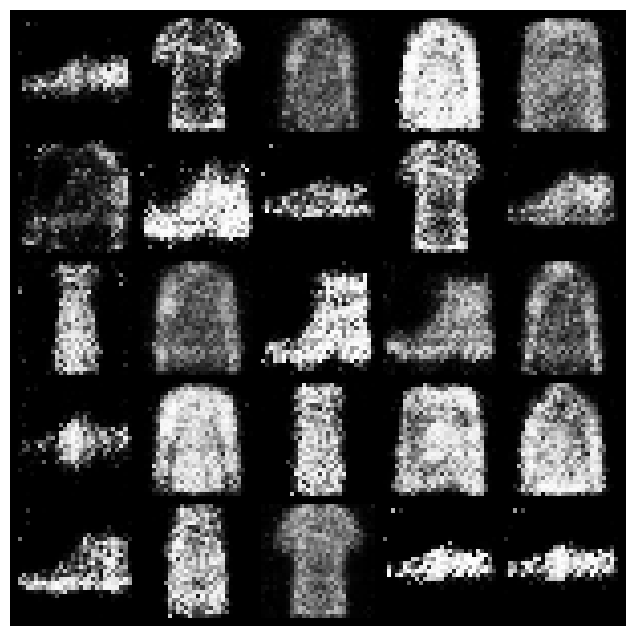

Discriminator Accuracy: 0.77755, Generator Accuracy: 0.8244833333333333
Epoch 8/30 completed


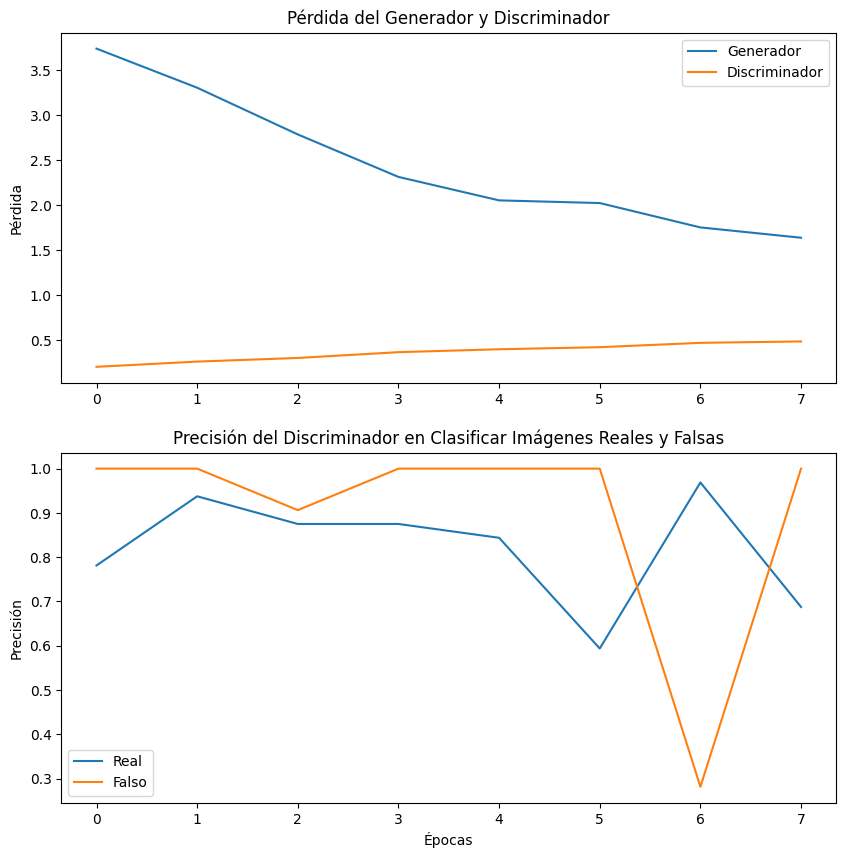

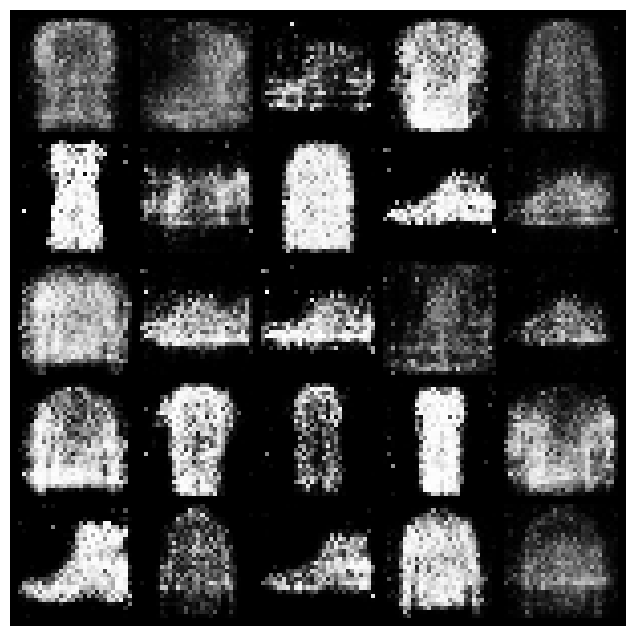

Discriminator Accuracy: 0.7661166666666667, Generator Accuracy: 0.8207833333333333
Epoch 9/30 completed


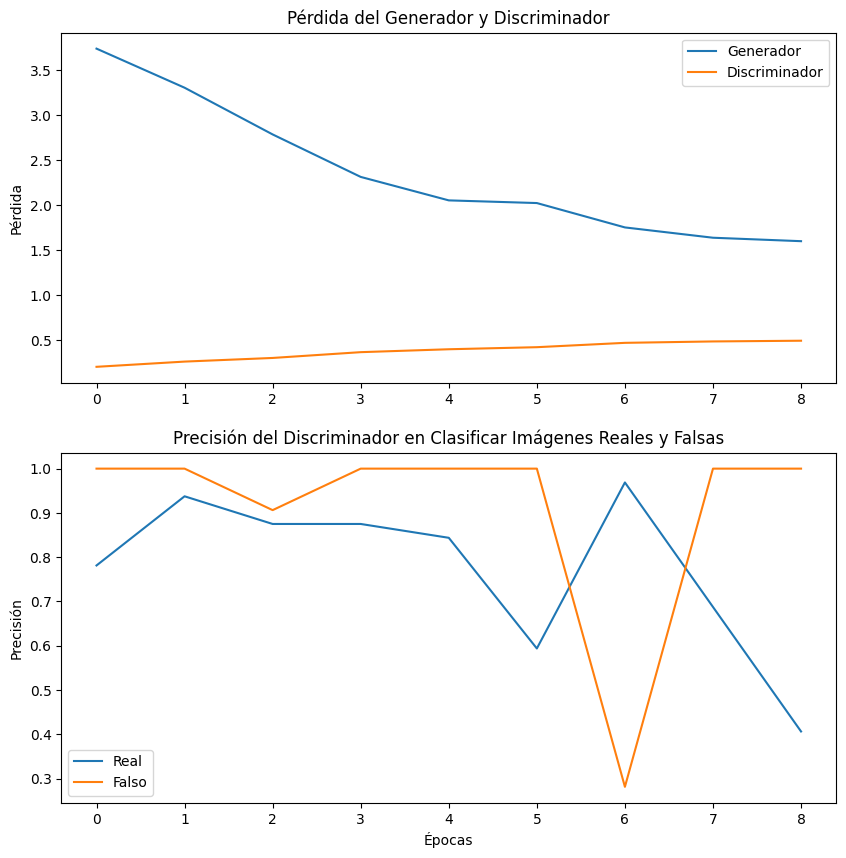

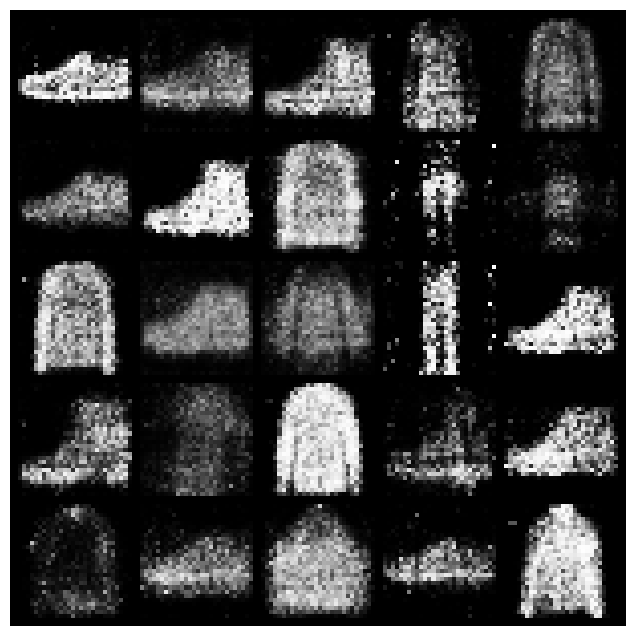

Discriminator Accuracy: 0.7592166666666667, Generator Accuracy: 0.8088166666666666
Epoch 10/30 completed


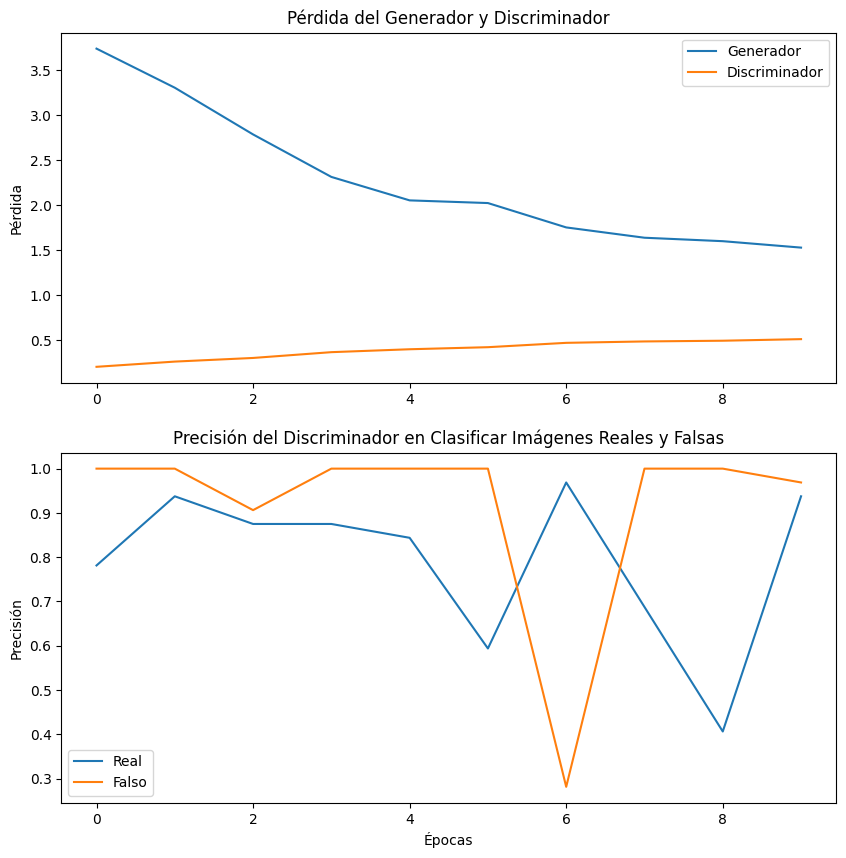

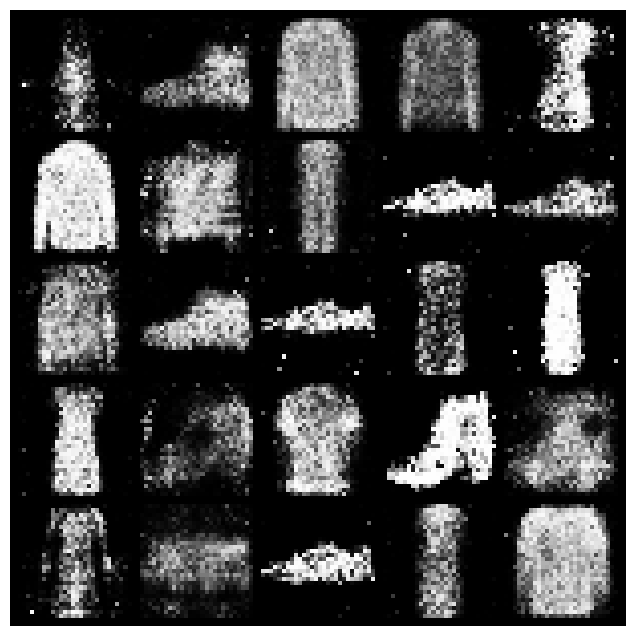

Discriminator Accuracy: 0.746375, Generator Accuracy: 0.7994833333333333
Epoch 11/30 completed


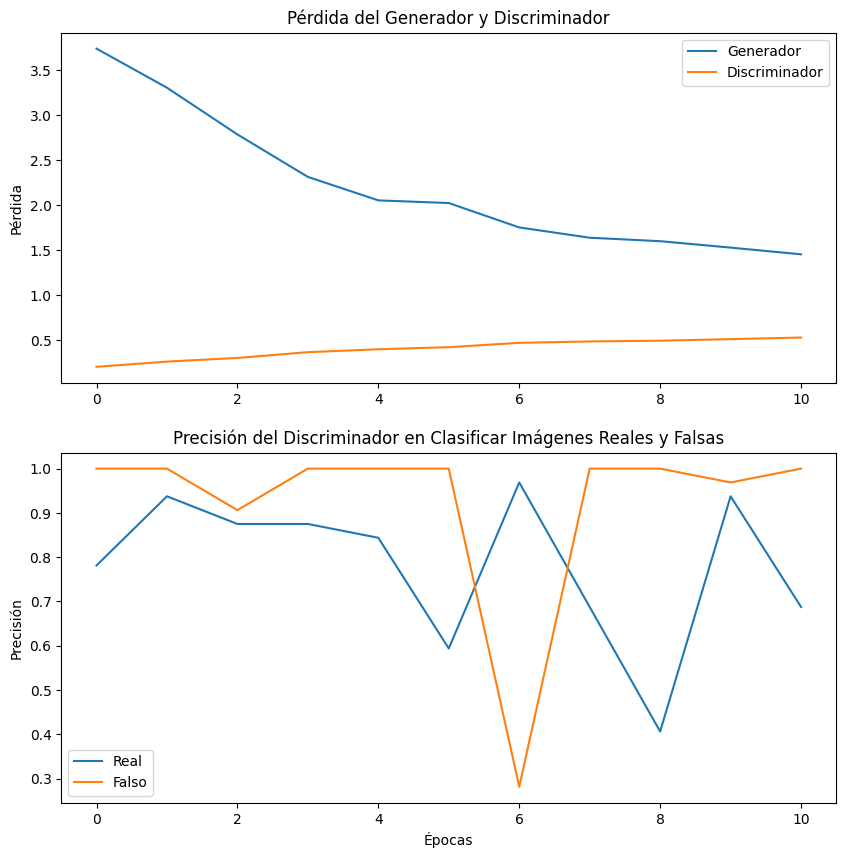

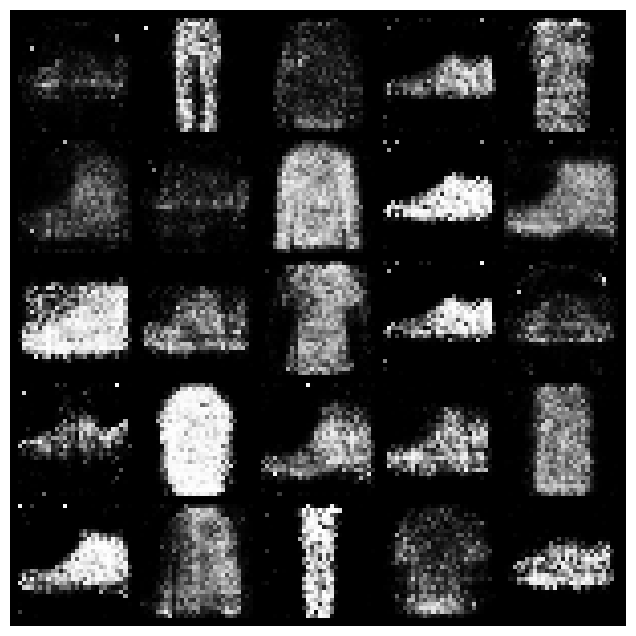

Discriminator Accuracy: 0.733275, Generator Accuracy: 0.78085
Epoch 12/30 completed


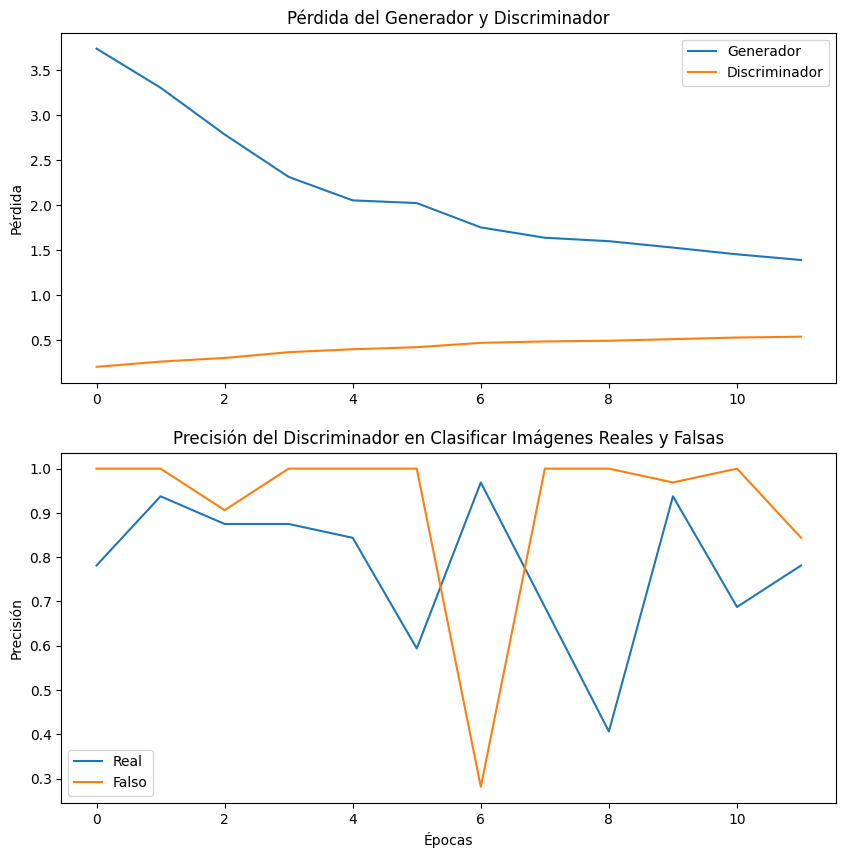

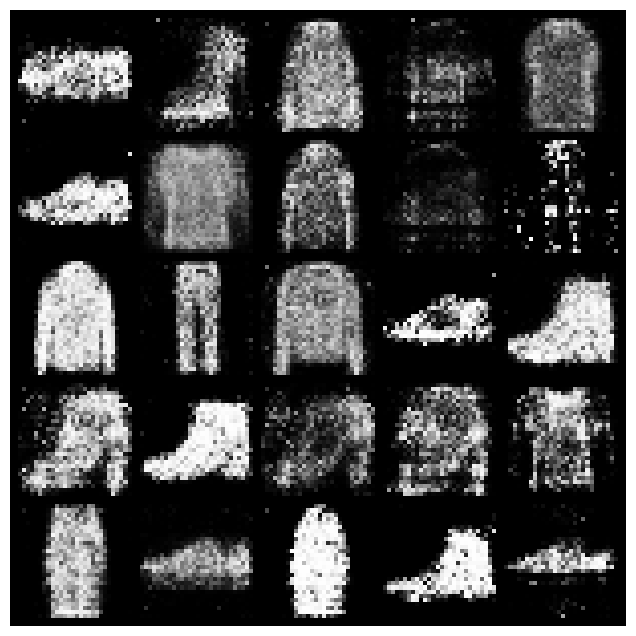

Discriminator Accuracy: 0.7254916666666666, Generator Accuracy: 0.7773833333333333
Epoch 13/30 completed


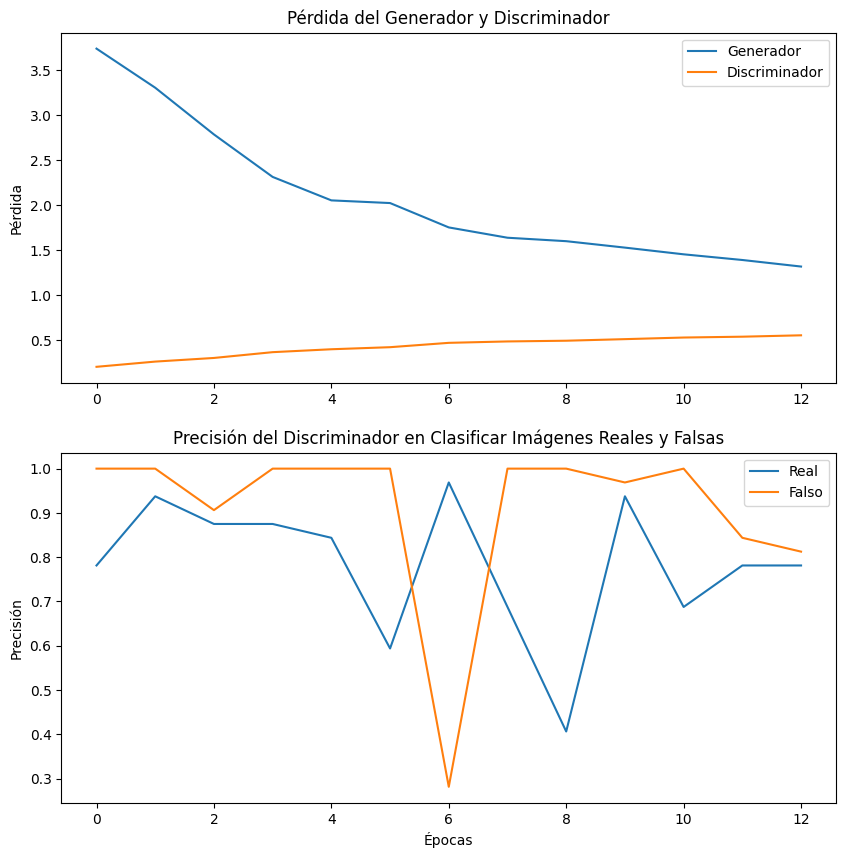

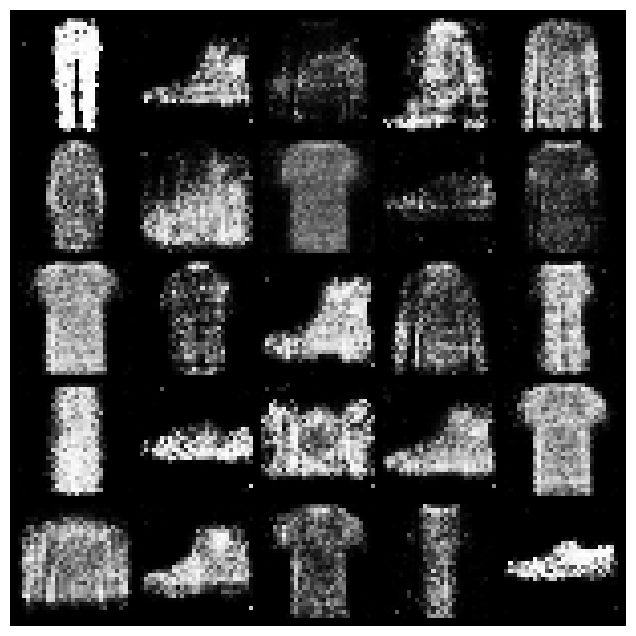

Discriminator Accuracy: 0.7111083333333333, Generator Accuracy: 0.7673166666666666
Epoch 14/30 completed


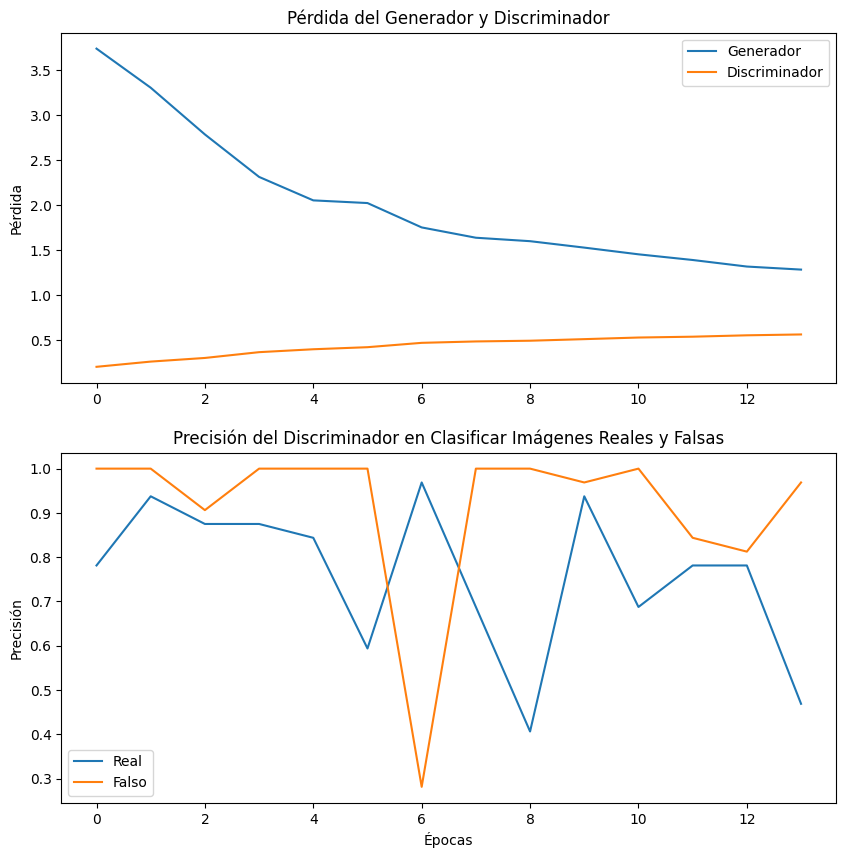

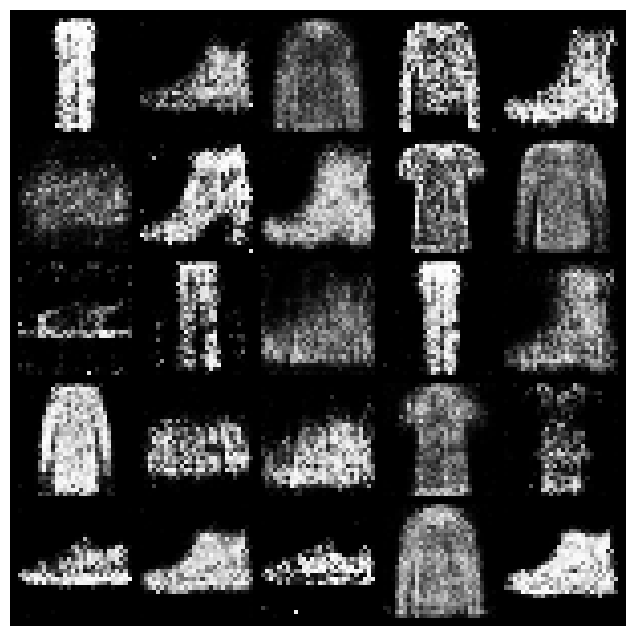

Discriminator Accuracy: 0.7044916666666666, Generator Accuracy: 0.75375
Epoch 15/30 completed


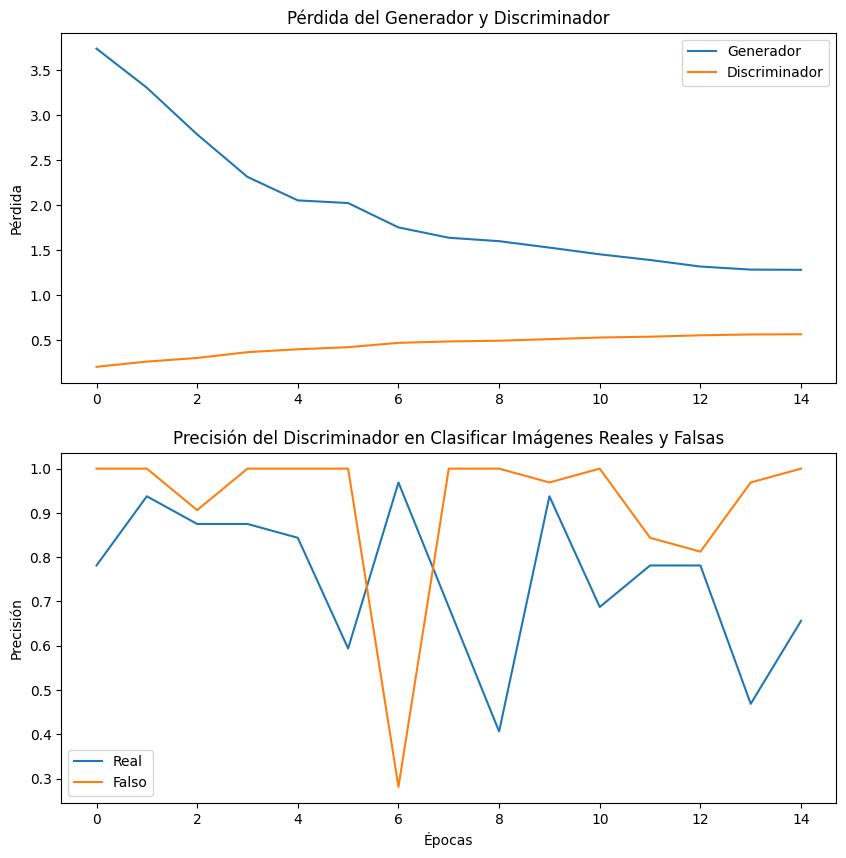

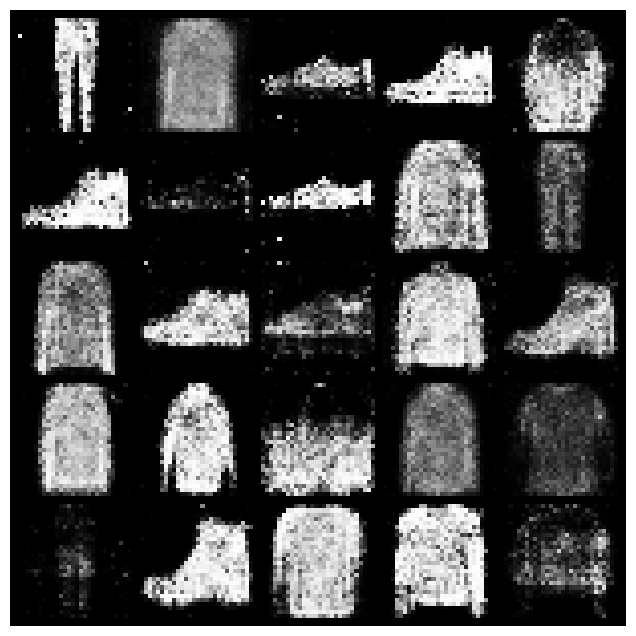

Discriminator Accuracy: 0.7042916666666666, Generator Accuracy: 0.75285
Epoch 16/30 completed


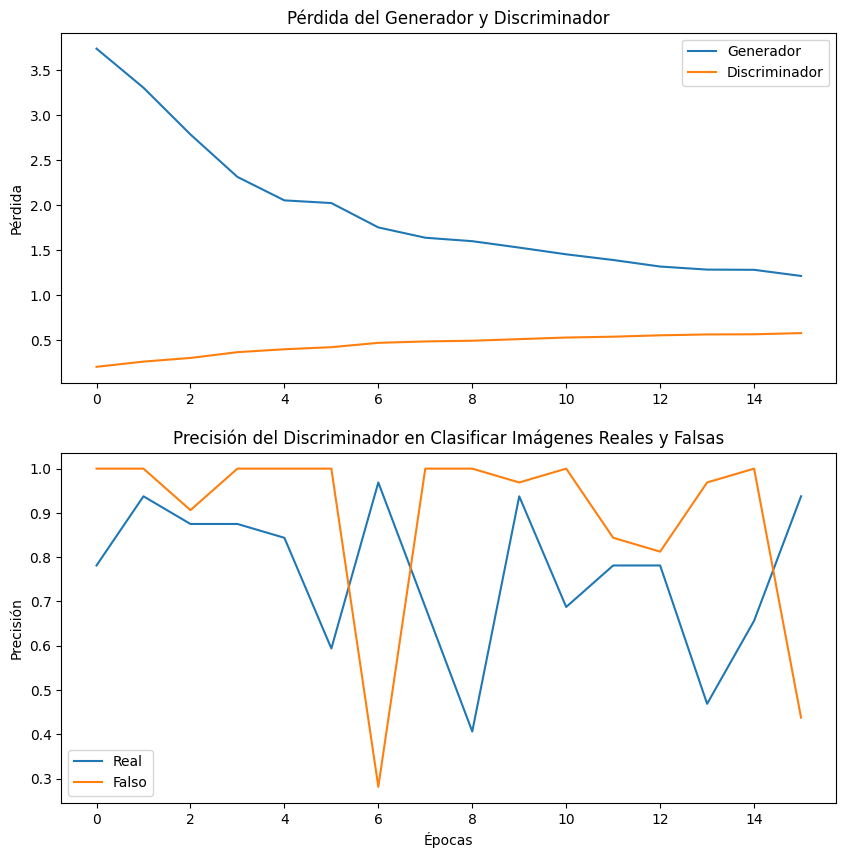

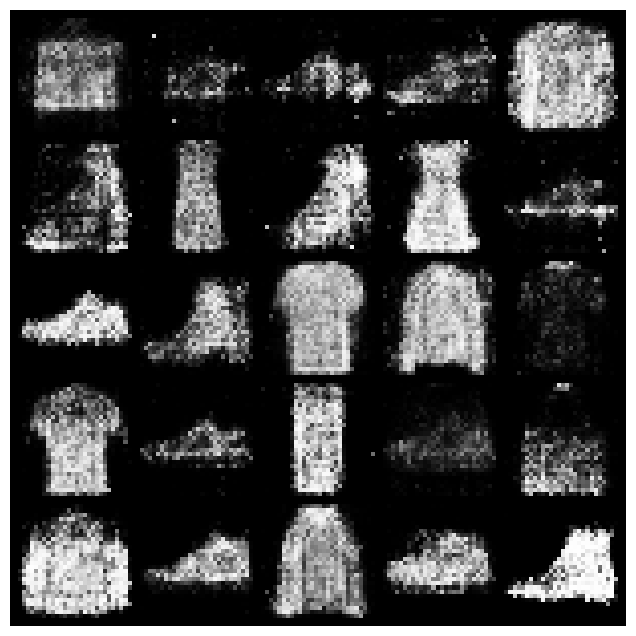

Discriminator Accuracy: 0.69105, Generator Accuracy: 0.7393666666666666
Epoch 17/30 completed


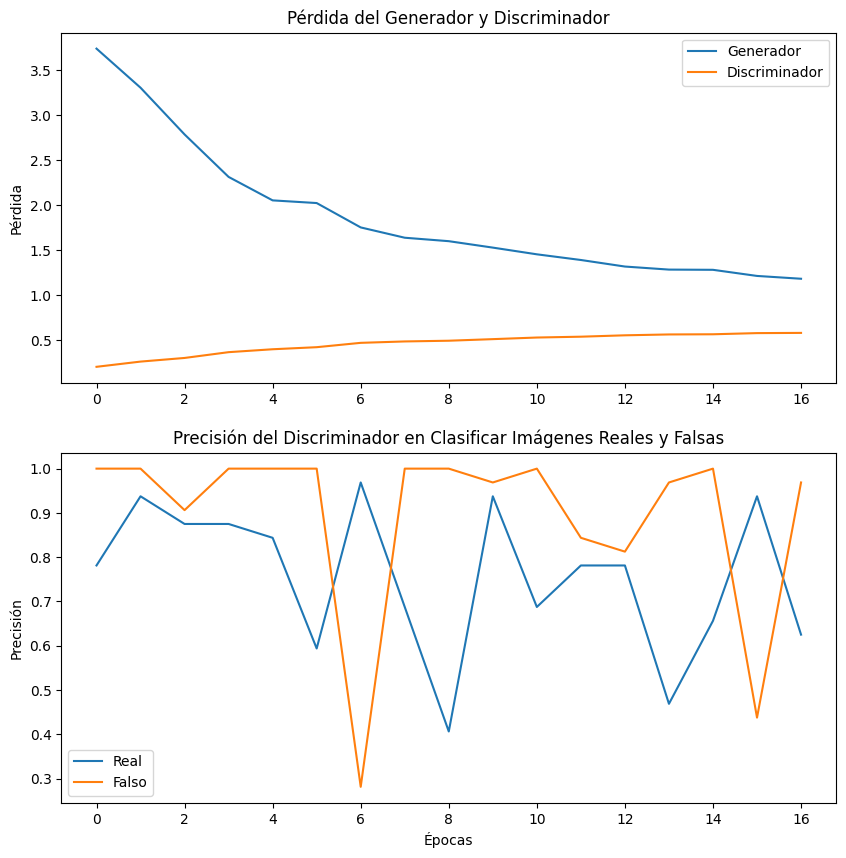

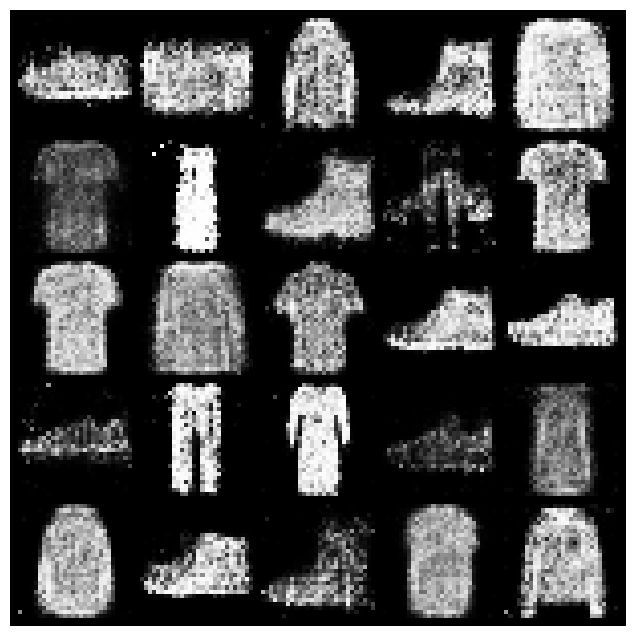

Discriminator Accuracy: 0.6906666666666667, Generator Accuracy: 0.7370666666666666
Epoch 18/30 completed


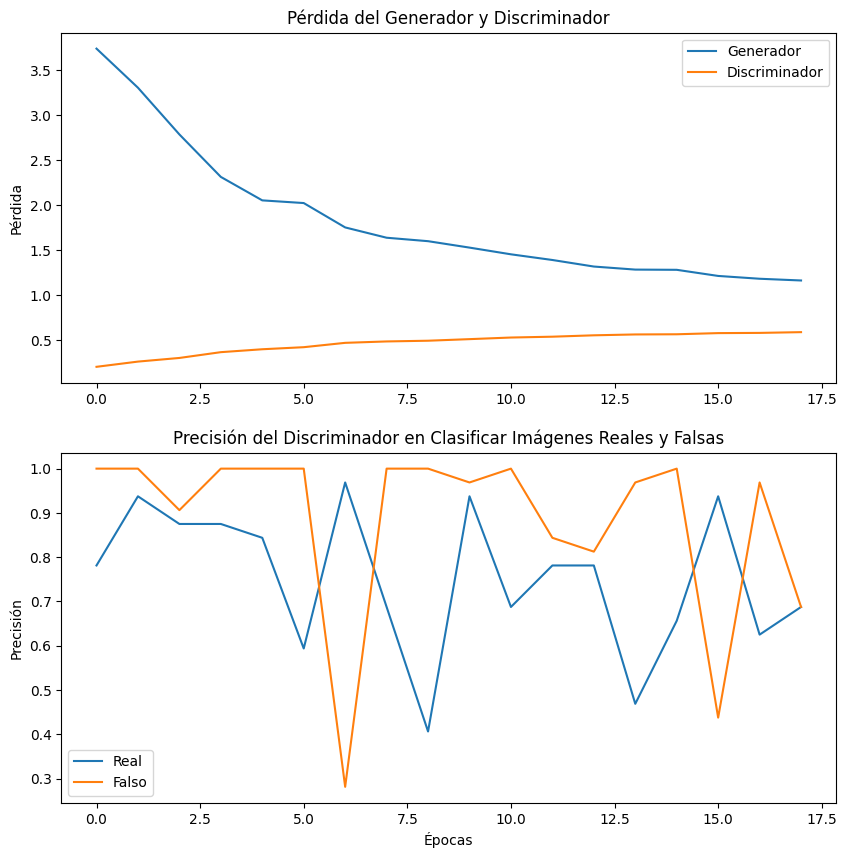

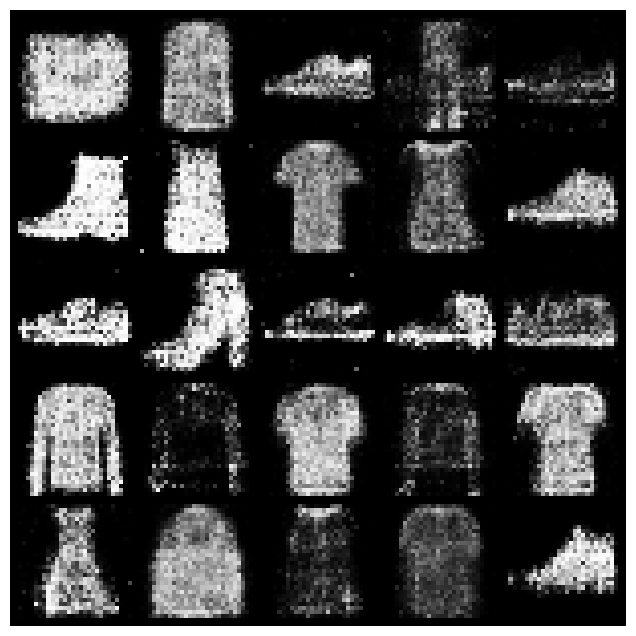

Discriminator Accuracy: 0.682025, Generator Accuracy: 0.7283666666666667
Epoch 19/30 completed


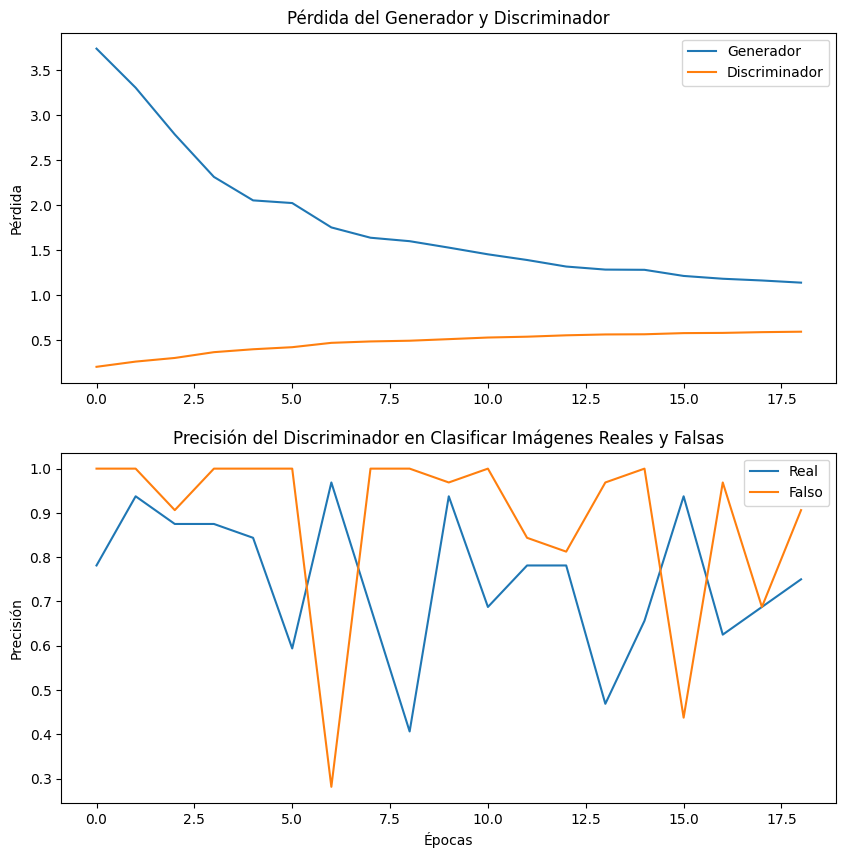

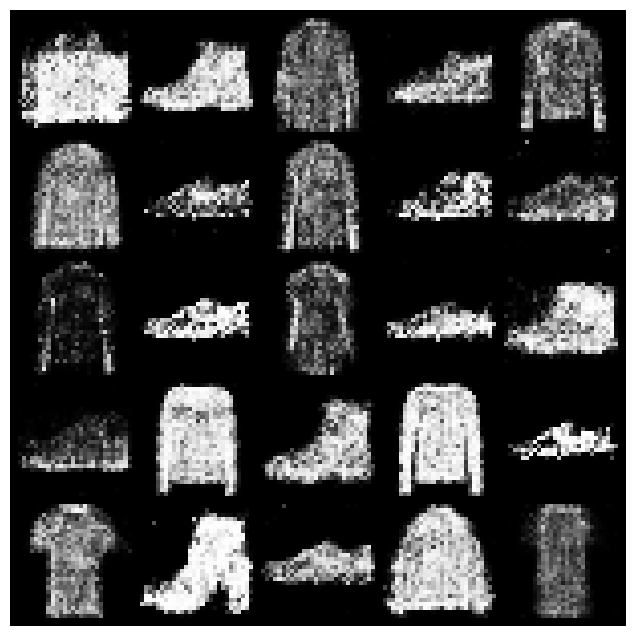

Discriminator Accuracy: 0.6782166666666667, Generator Accuracy: 0.7243666666666667
Epoch 20/30 completed


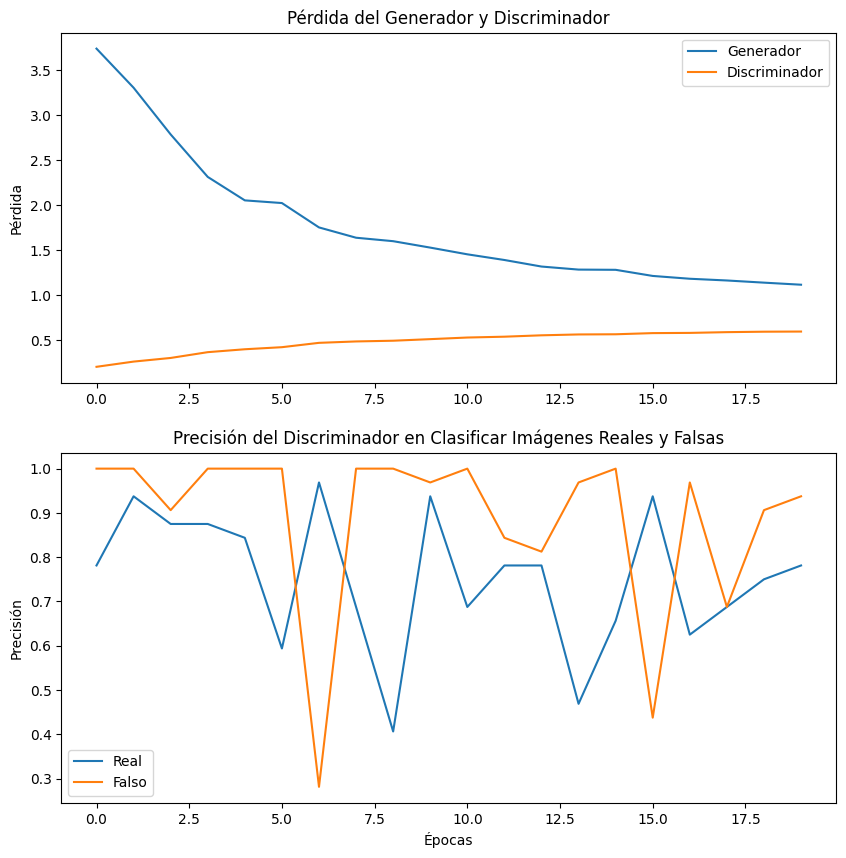

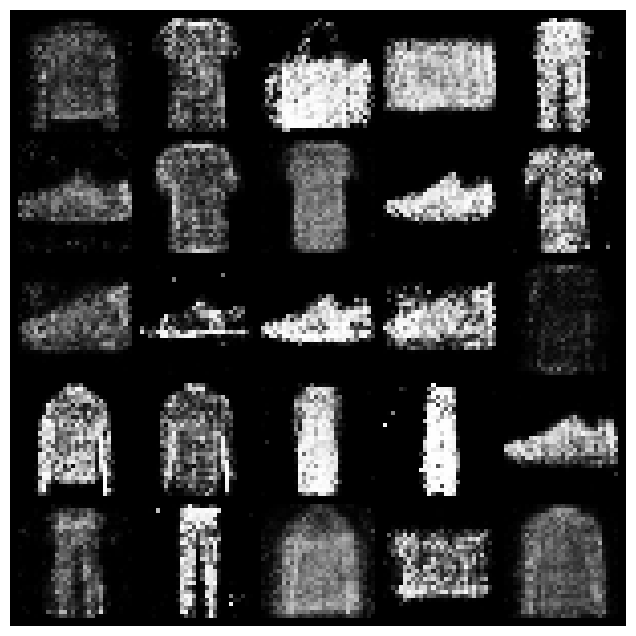

Discriminator Accuracy: 0.6758666666666666, Generator Accuracy: 0.7204833333333334
Epoch 21/30 completed


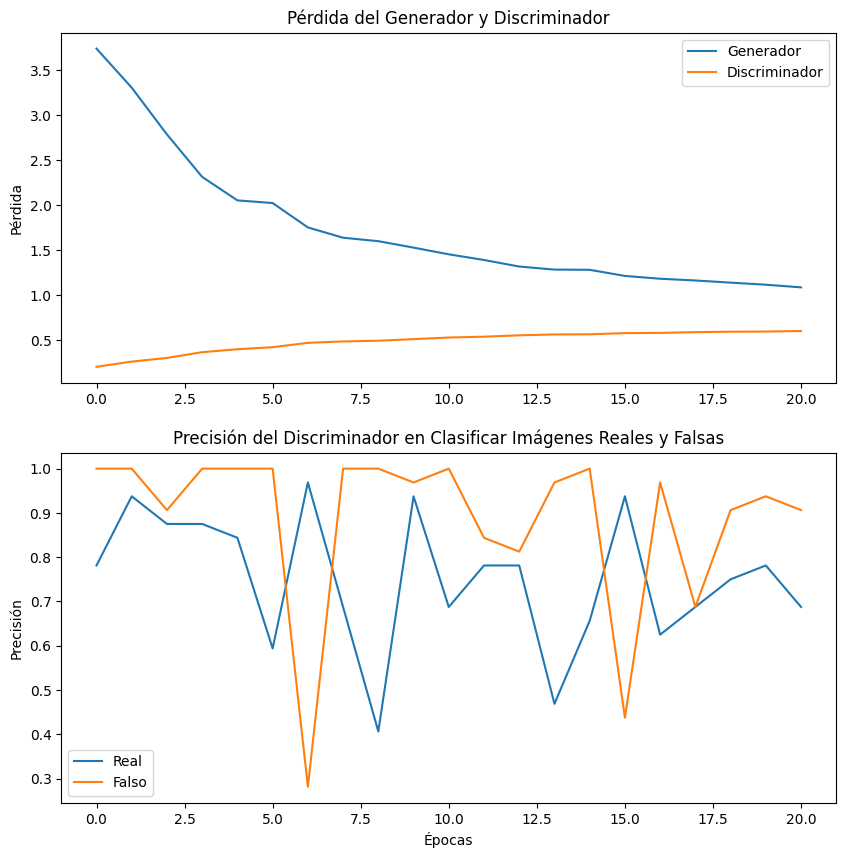

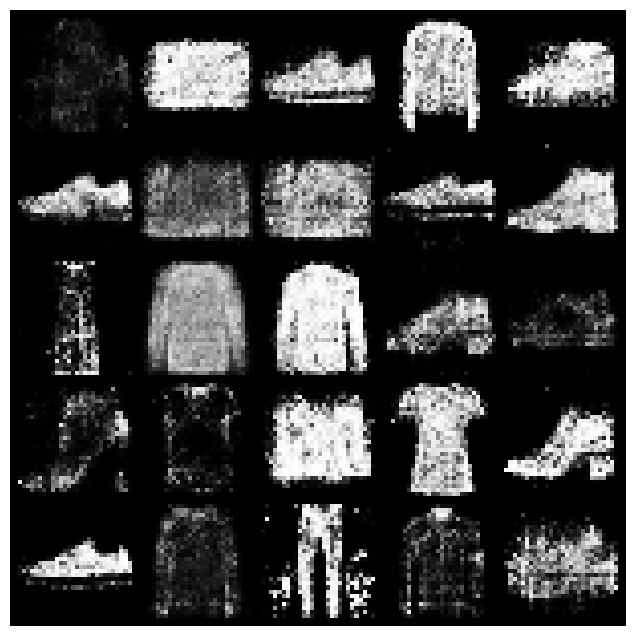

Discriminator Accuracy: 0.6694, Generator Accuracy: 0.7167666666666667
Epoch 22/30 completed


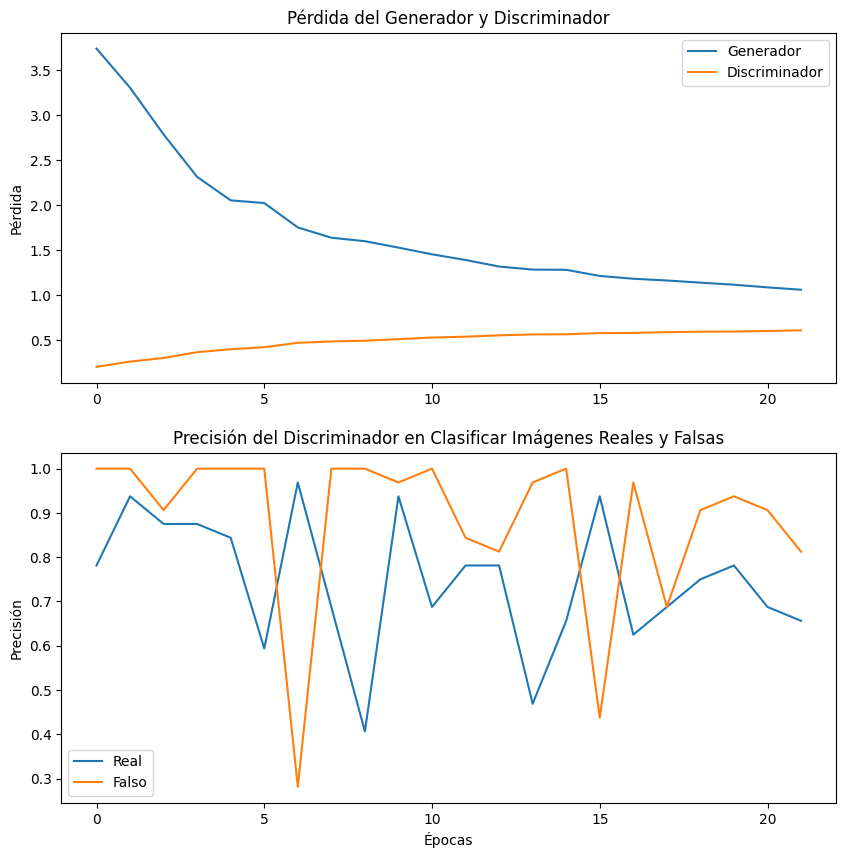

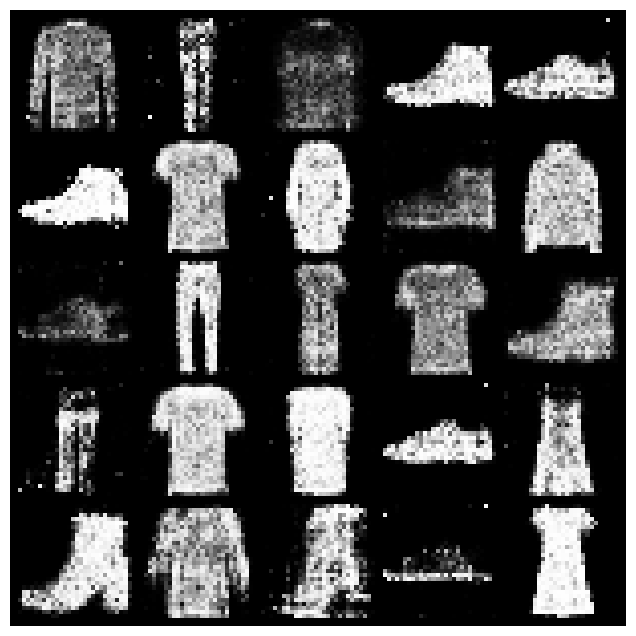

Discriminator Accuracy: 0.660925, Generator Accuracy: 0.7040666666666666
Epoch 23/30 completed


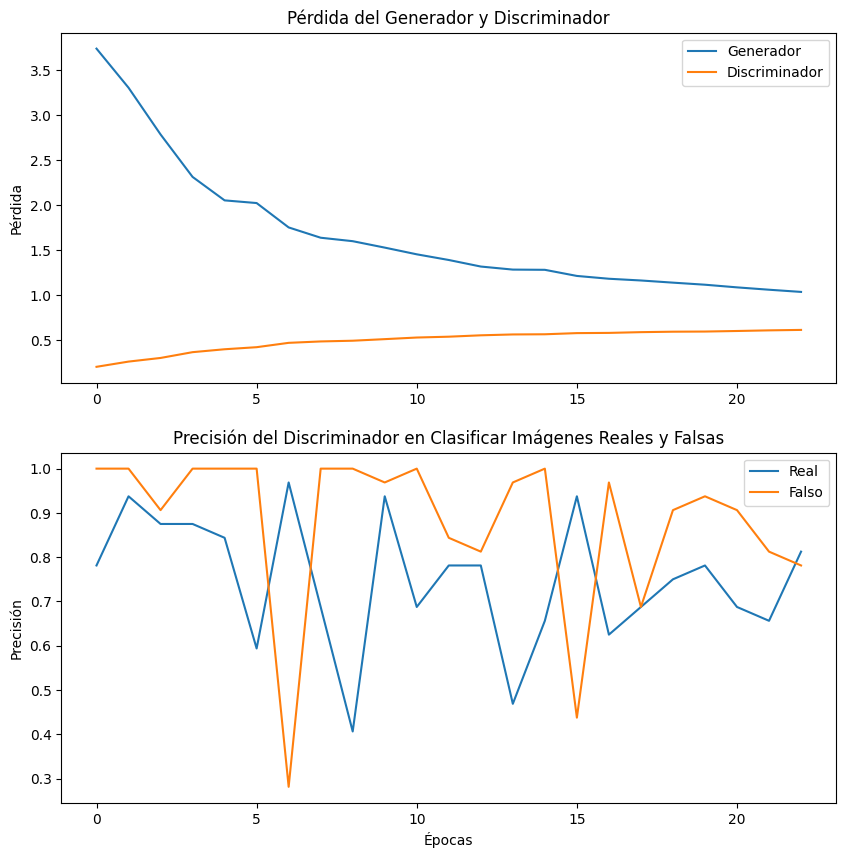

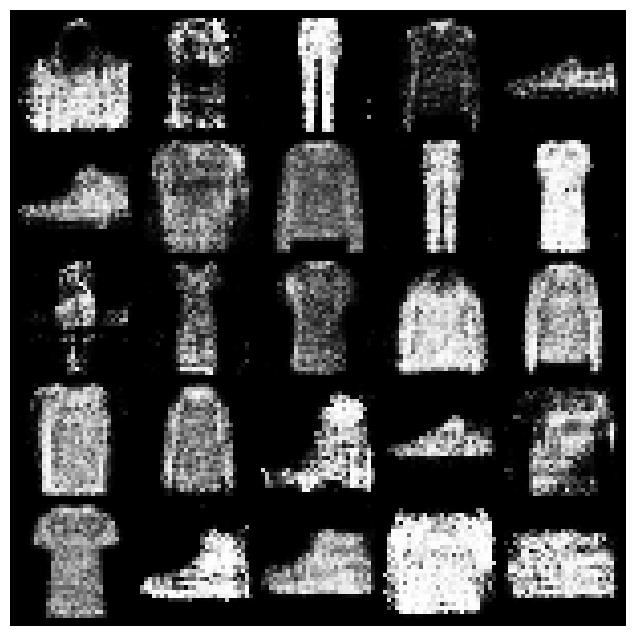

Discriminator Accuracy: 0.6565083333333334, Generator Accuracy: 0.6952833333333334
Epoch 24/30 completed


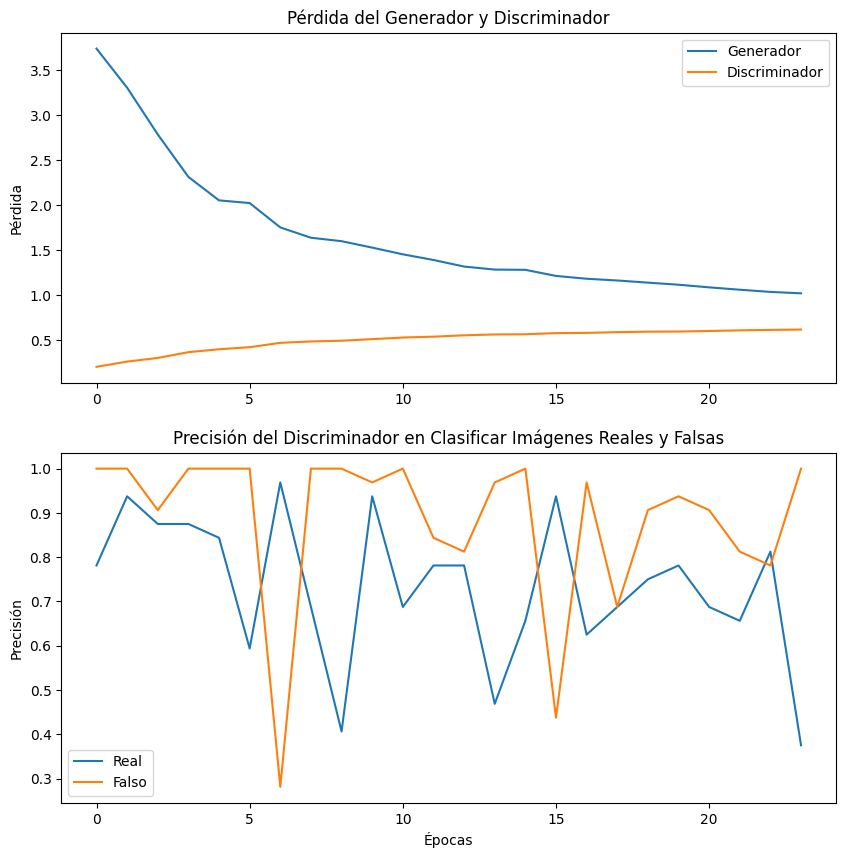

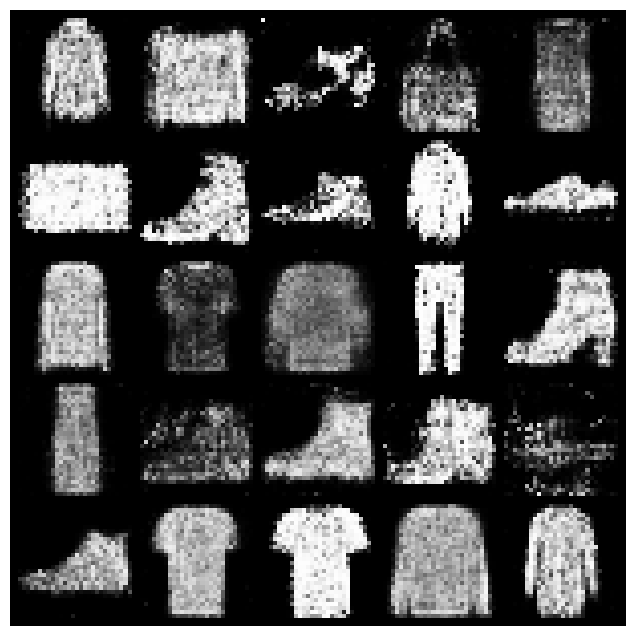

Discriminator Accuracy: 0.6517833333333334, Generator Accuracy: 0.69235
Epoch 25/30 completed


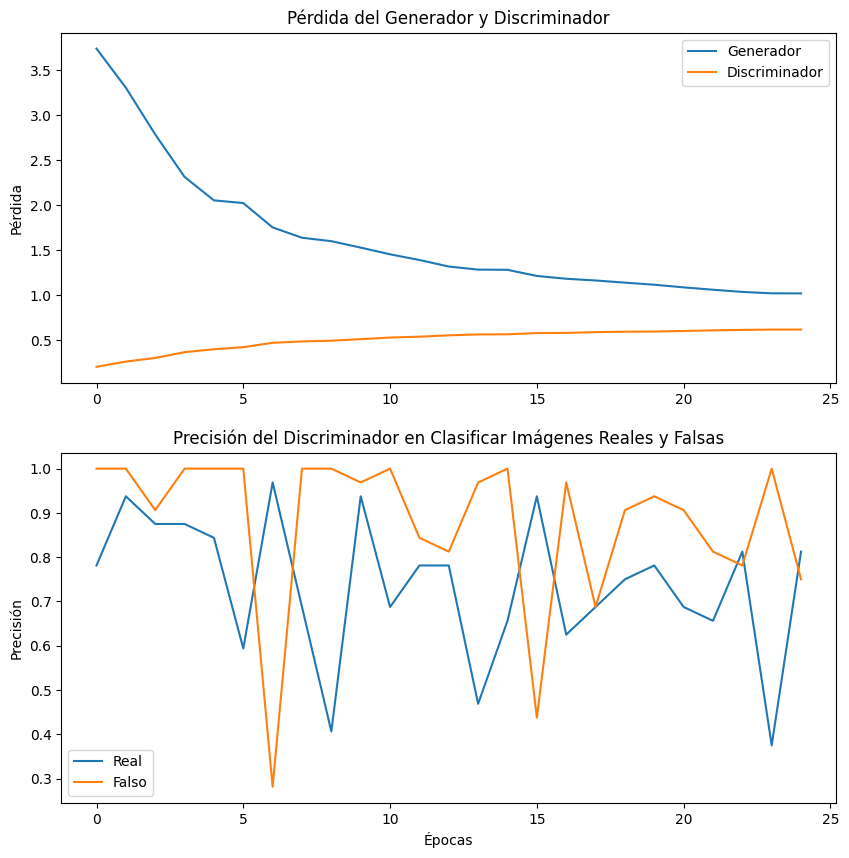

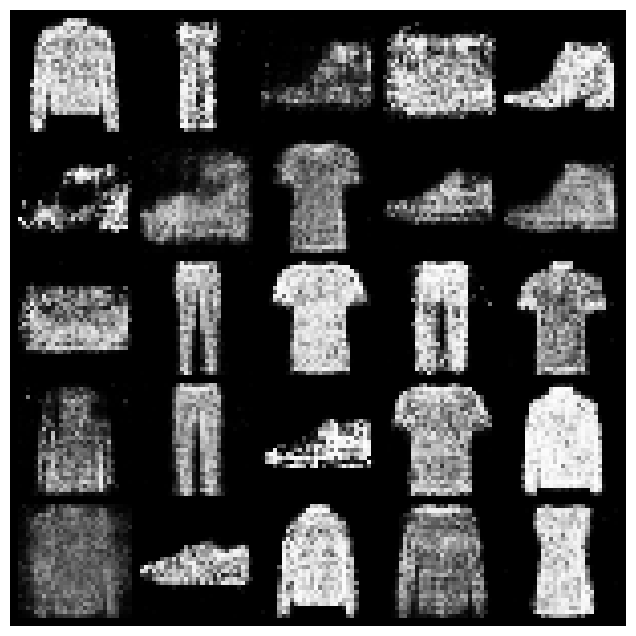

Discriminator Accuracy: 0.6512916666666667, Generator Accuracy: 0.68965
Epoch 26/30 completed


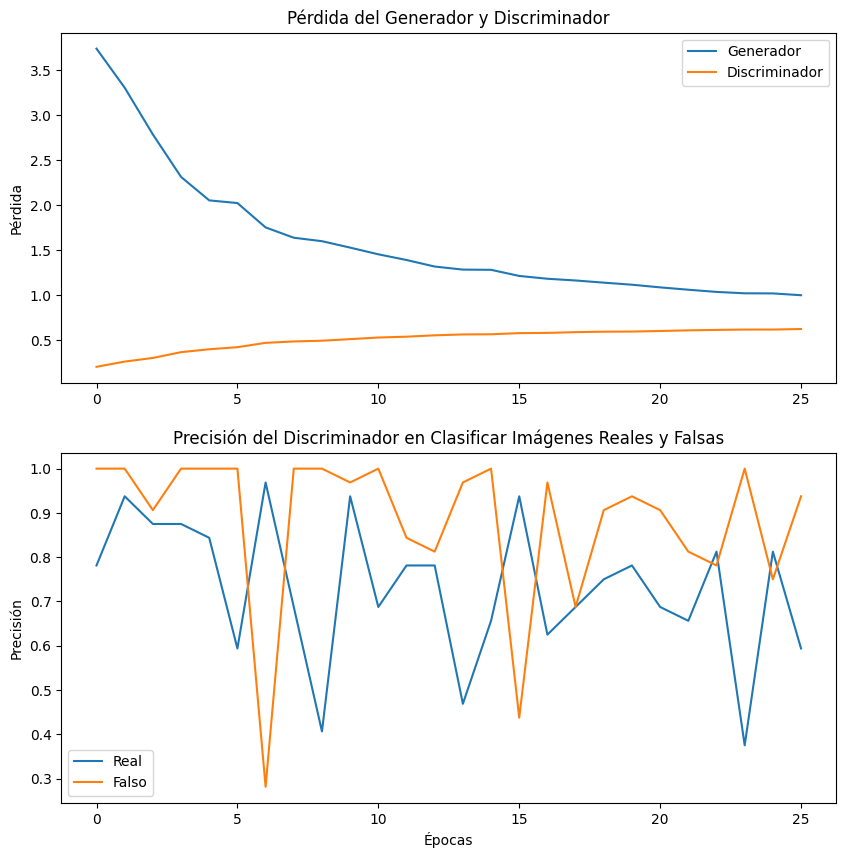

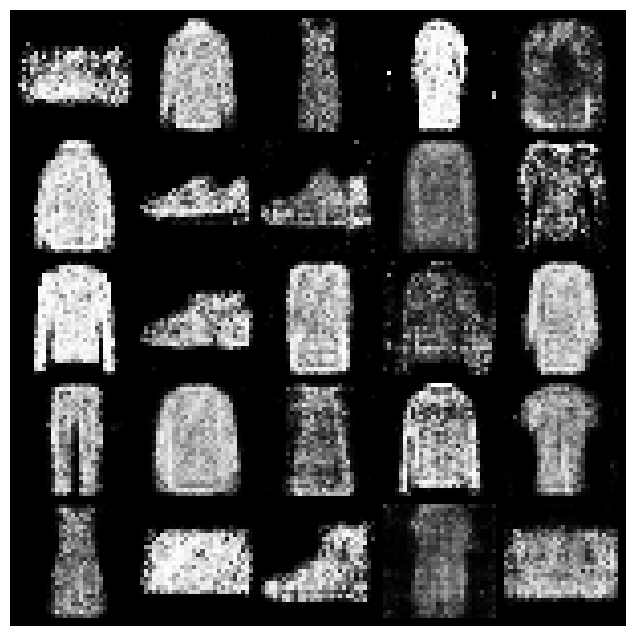

Discriminator Accuracy: 0.6450166666666667, Generator Accuracy: 0.6820166666666667
Epoch 27/30 completed


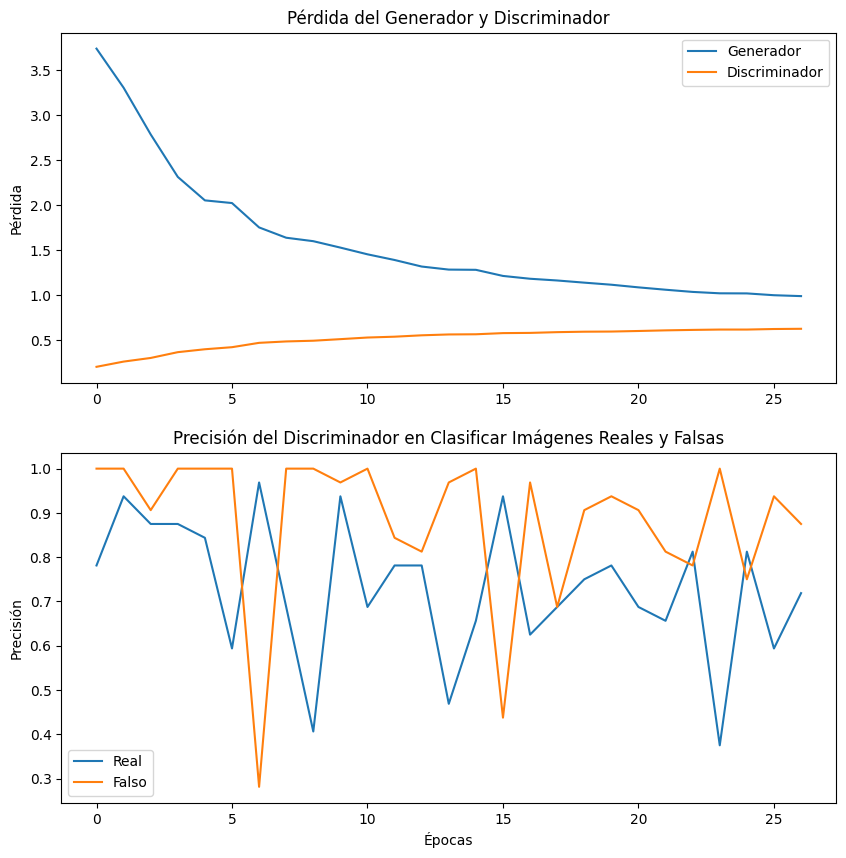

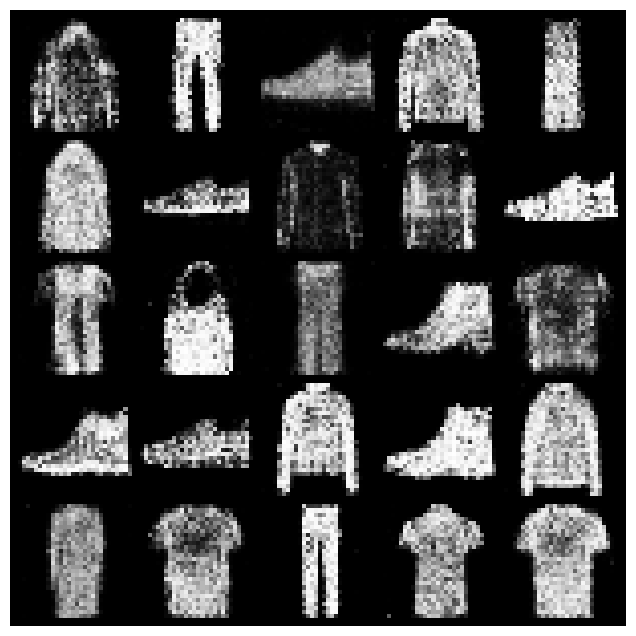

Discriminator Accuracy: 0.6430666666666667, Generator Accuracy: 0.6784
Epoch 28/30 completed


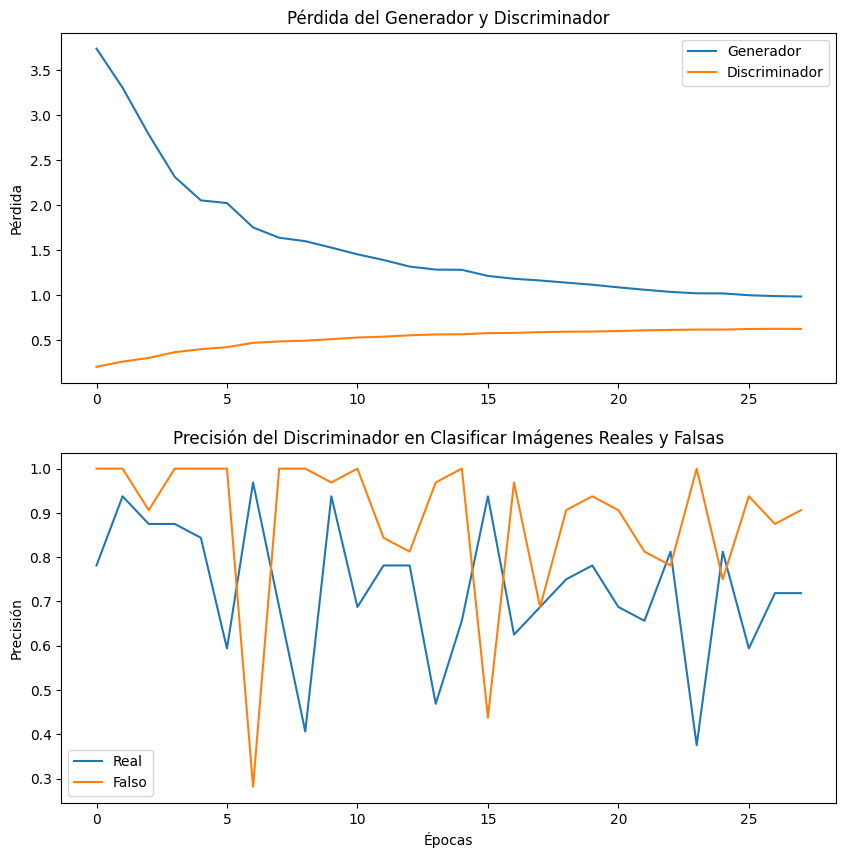

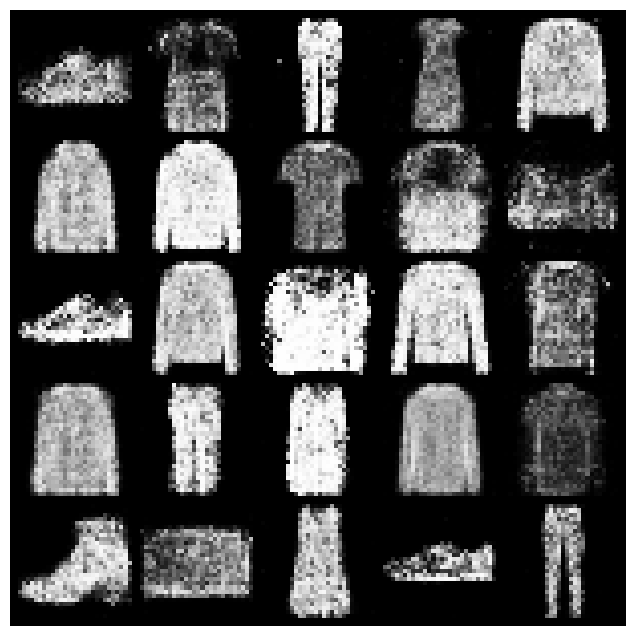

Discriminator Accuracy: 0.6457083333333333, Generator Accuracy: 0.68325
Epoch 29/30 completed


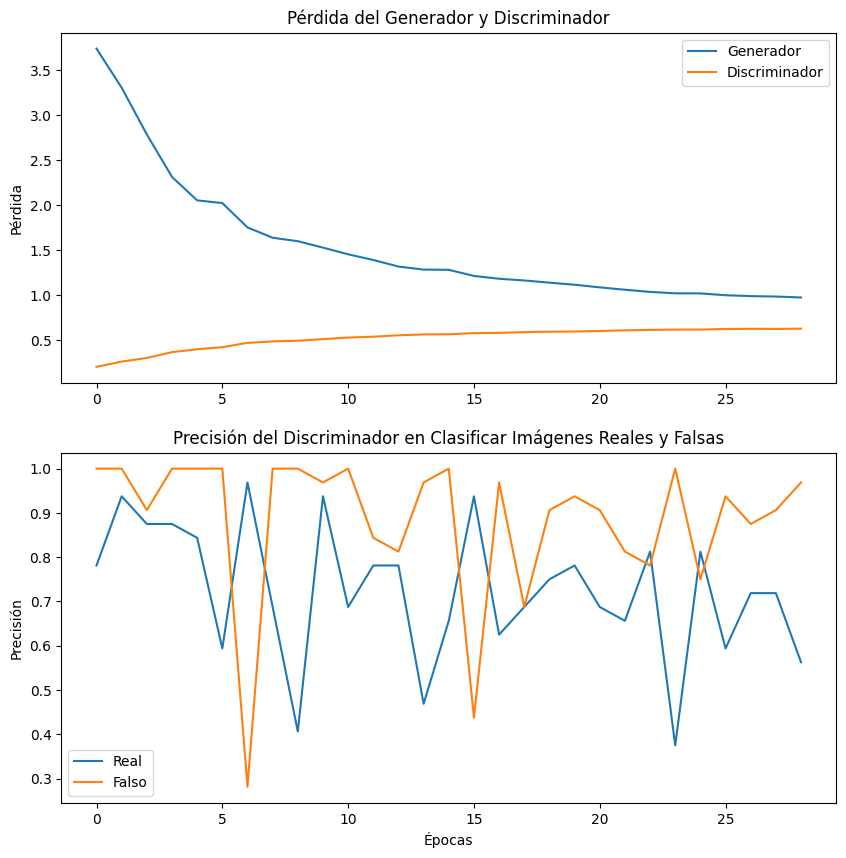

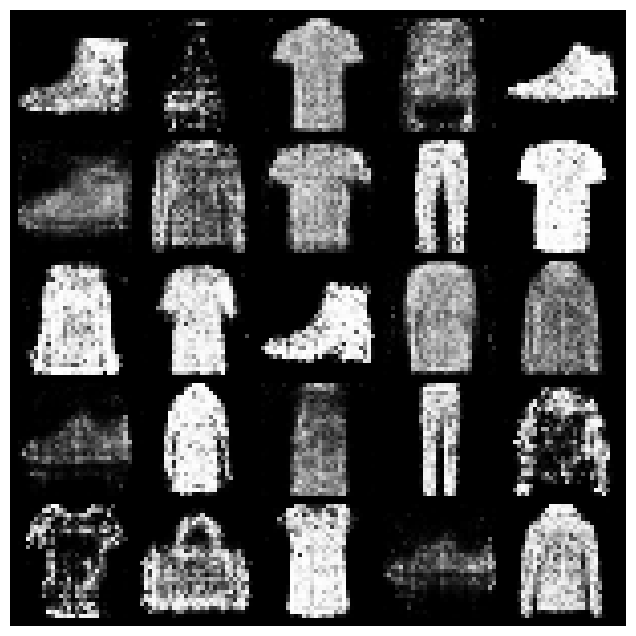

Discriminator Accuracy: 0.6411333333333333, Generator Accuracy: 0.6740166666666667
Epoch 30/30 completed


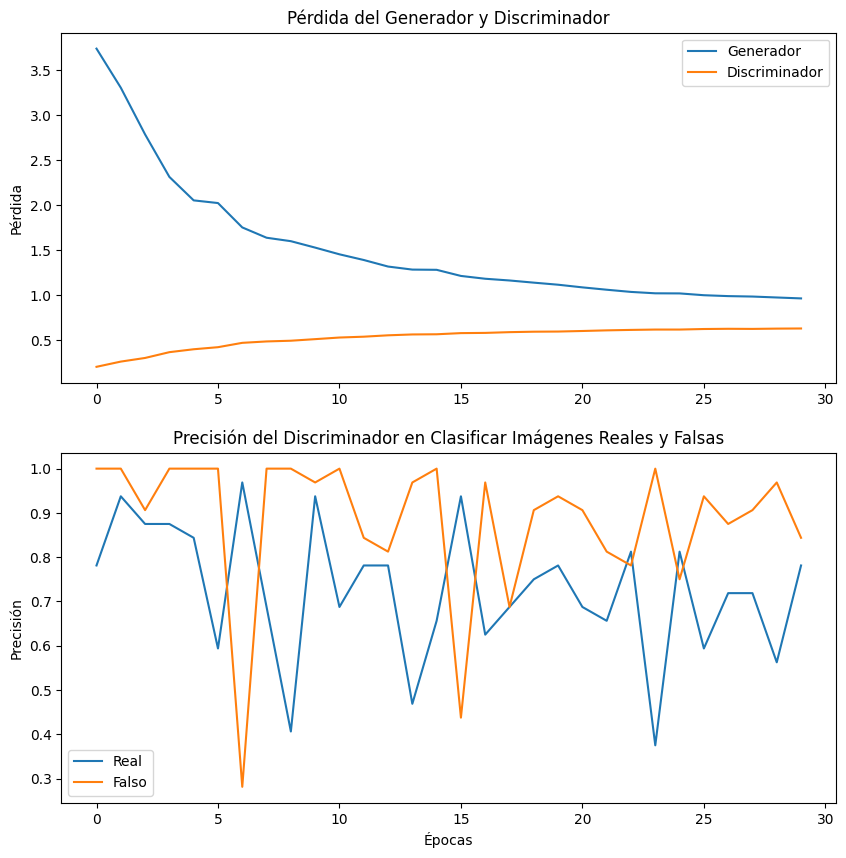

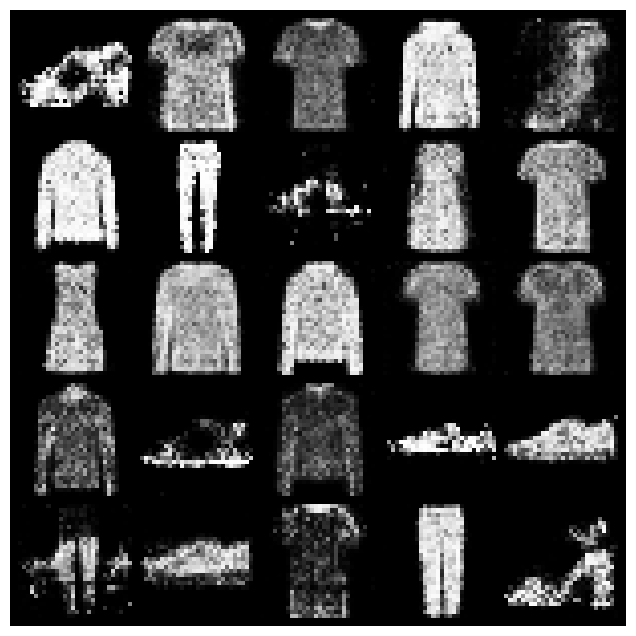

Discriminator Accuracy: 0.6400583333333333, Generator Accuracy: 0.6745
Average Generator Accuracy: 0.7676877777777776
Average Discriminator Accuracy: 0.7243719444444444


In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

generator = Generator().to(device)
discriminator = Discriminator().to(device)

# Optimizadores
optimizer_G = optim.Adam(generator.parameters(), lr=0.0002, betas=(0.5, 0.999))
optimizer_D = optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))

# Función de pérdida
criterion = nn.BCELoss()

# Listas para almacenar pérdidas
G_losses = []
D_losses = []
D_real_accuracy = []
D_fake_accuracy = []
average_G_losses = []
average_D_losses = []
G_accuracies = []
D_accuracies = []

# Número de épocas
num_epochs = 30

# Entrenamiento
for epoch in range(num_epochs):
    G_loss_accum = 0.0
    D_loss_accum = 0.0
    num_batches = 0
    num_correct_real = 0
    num_correct_fake = 0
    total_samples = 0

    for i, (real_images, _) in enumerate(fashion_mnist_train_loader):
        num_batches += 1
        total_samples += real_images.size(0)
        # Configuración de las etiquetas reales y falsas
        real = torch.ones(real_images.size(0), 1, device=device)
        fake = torch.zeros(real_images.size(0), 1, device=device)

        # Entrenar Discriminador
        discriminator.zero_grad()

        # Imágenes reales
        real_imgs = real_images.to(device)
        output_real = discriminator(real_imgs)
        loss_real = criterion(output_real, real)
        num_correct_real += torch.sum(output_real >= 0.5).item()  # Imágenes reales clasificadas como reales


        # Imágenes falsas
        noise = torch.randn(real_images.size(0), 100, device=device)
        fake_imgs = generator(noise)
        output_fake = discriminator(fake_imgs.detach())
        loss_fake = criterion(output_fake, fake)
        num_correct_fake += torch.sum(output_fake < 0.5).item()  # Imágenes falsas clasificadas como falsas


        # Pérdida total y actualizar
        loss_D = (loss_real + loss_fake) / 2
        loss_D.backward()
        optimizer_D.step()

        # Entrenar Generador
        generator.zero_grad()

        # Engañar al discriminador
        output_fake = discriminator(fake_imgs)
        loss_G = criterion(output_fake, real)
        loss_G.backward()
        optimizer_G.step()

        # Guardar las pérdidas para visualización
        G_losses.append(loss_G.item())
        D_losses.append(loss_D.item())
        G_loss_accum += loss_G.item()
        D_loss_accum += loss_D.item()



        with torch.no_grad():
            real_pred = discriminator(real_images.to(device))
            real_correct = torch.sum(real_pred >= 0.5).item()  # Imágenes reales clasificadas como reales
            fake_pred = discriminator(fake_imgs.detach())
            fake_correct = torch.sum(fake_pred < 0.5).item()  # Imágenes falsas clasificadas como falsas
    average_G_losses.append(G_loss_accum / num_batches)
    average_D_losses.append(D_loss_accum / num_batches)
    D_real_accuracy.append(real_correct / real_images.size(0))
    D_fake_accuracy.append(fake_correct / real_images.size(0))


  # Calcular precisión del discriminador y el generador
    D_accuracy = (num_correct_real + num_correct_fake) / (2 * total_samples)
    G_accuracy = num_correct_fake / total_samples
    D_accuracies.append(D_accuracy)
    G_accuracies.append(G_accuracy)


    save_generated_images(generator, device, epoch)
    create_gif('generated_images', "gan_fashion_mnist.gif")
    # Mostrar pérdidas y generar imágenes al final de cada época
    print(f"Epoch {epoch + 1}/{num_epochs} completed")
    plot_metrics(average_G_losses, average_D_losses, D_real_accuracy, D_fake_accuracy)
    show_generated_images(generator, device)
    print(f"Discriminator Accuracy: {D_accuracy}, Generator Accuracy: {G_accuracy}")

# Imprimir la precisión promedio del discriminador y del generador al final
print(f"Average Generator Accuracy: {np.mean(G_accuracies)}")
print(f"Average Discriminator Accuracy: {np.mean(D_accuracies)}")

<ipython-input-51-902d87a423af>:4: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  images.append(imageio.imread(file_name))


Epoch 1/30 completed


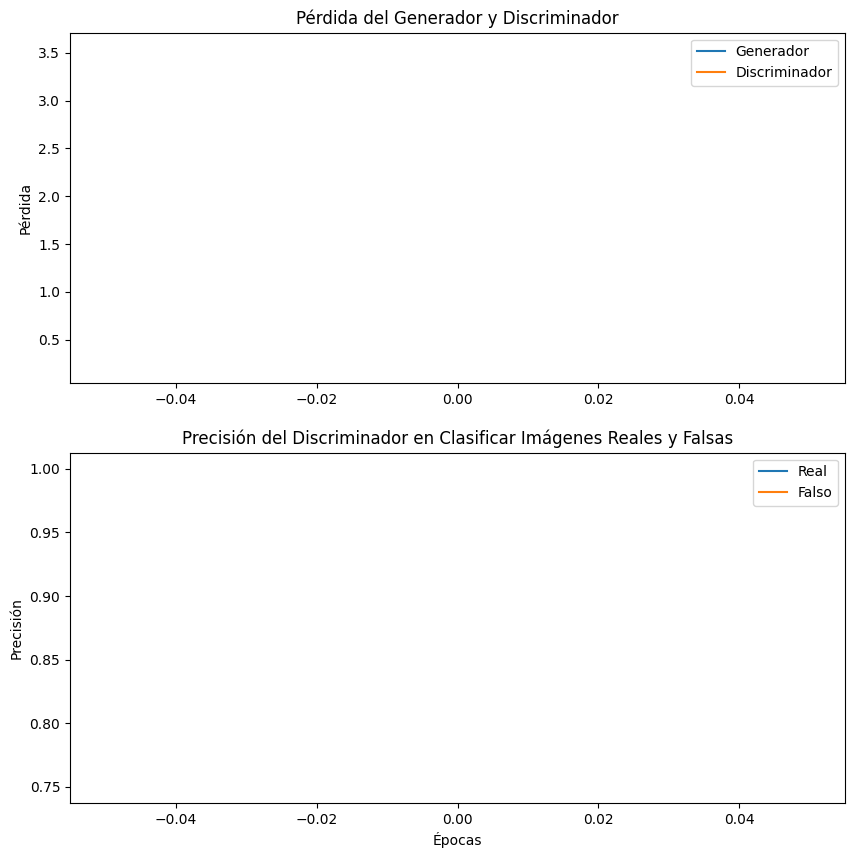

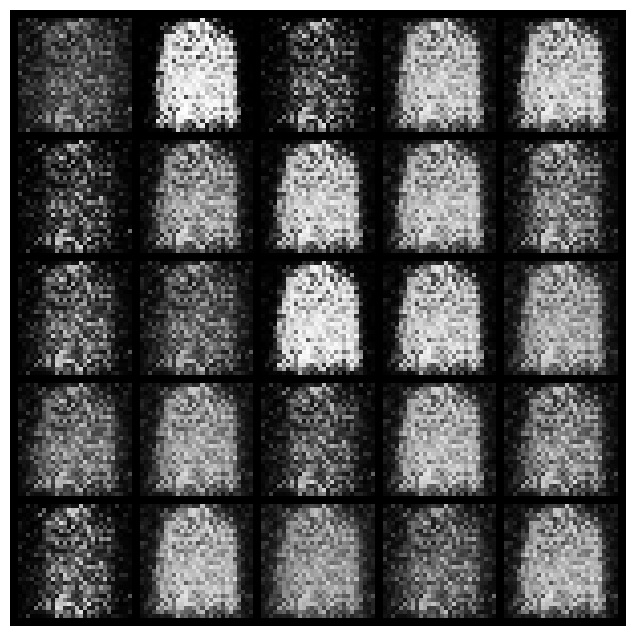

Epoch 2/30 completed


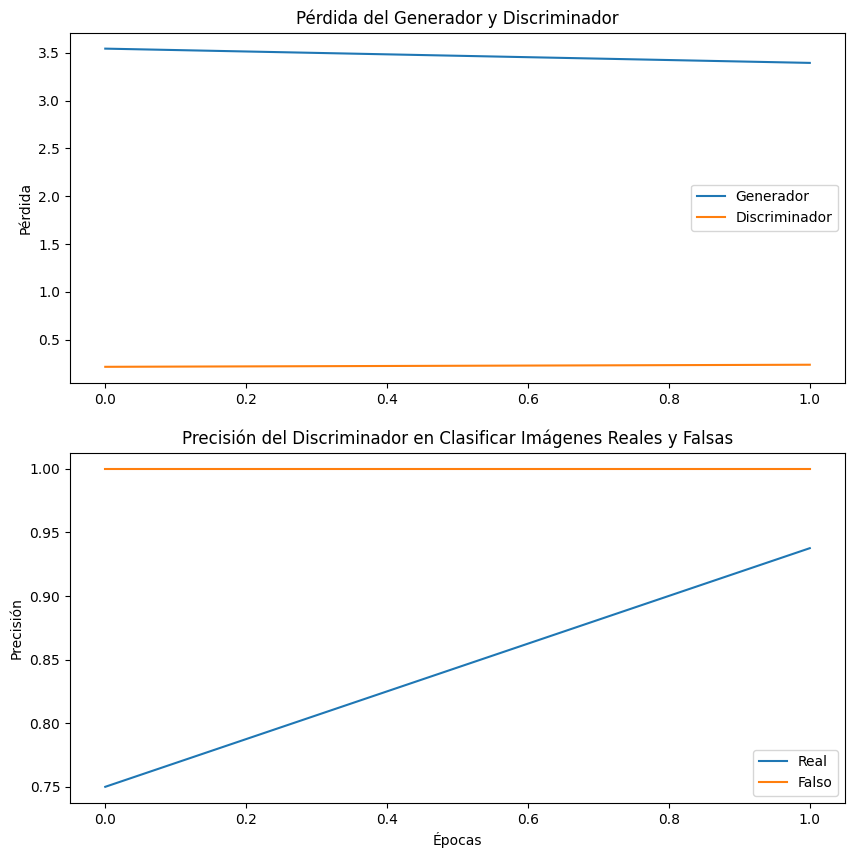

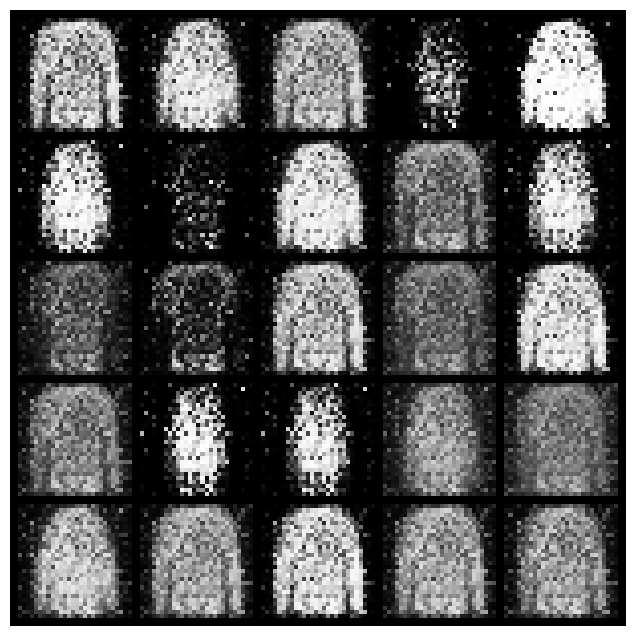

Epoch 3/30 completed


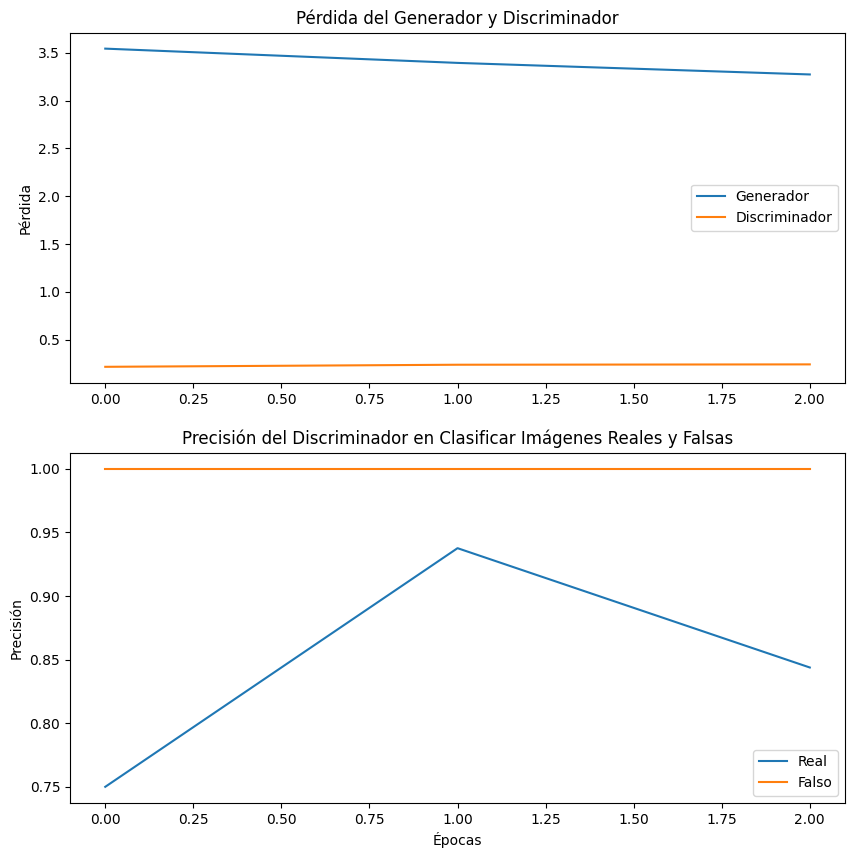

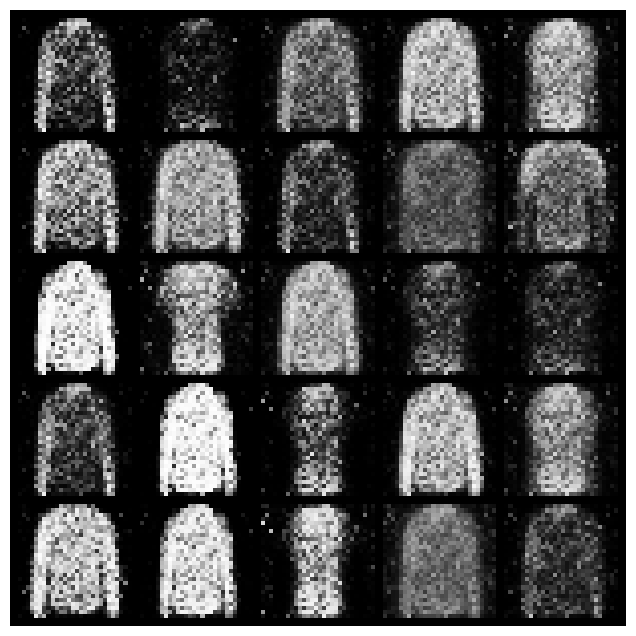

Epoch 4/30 completed


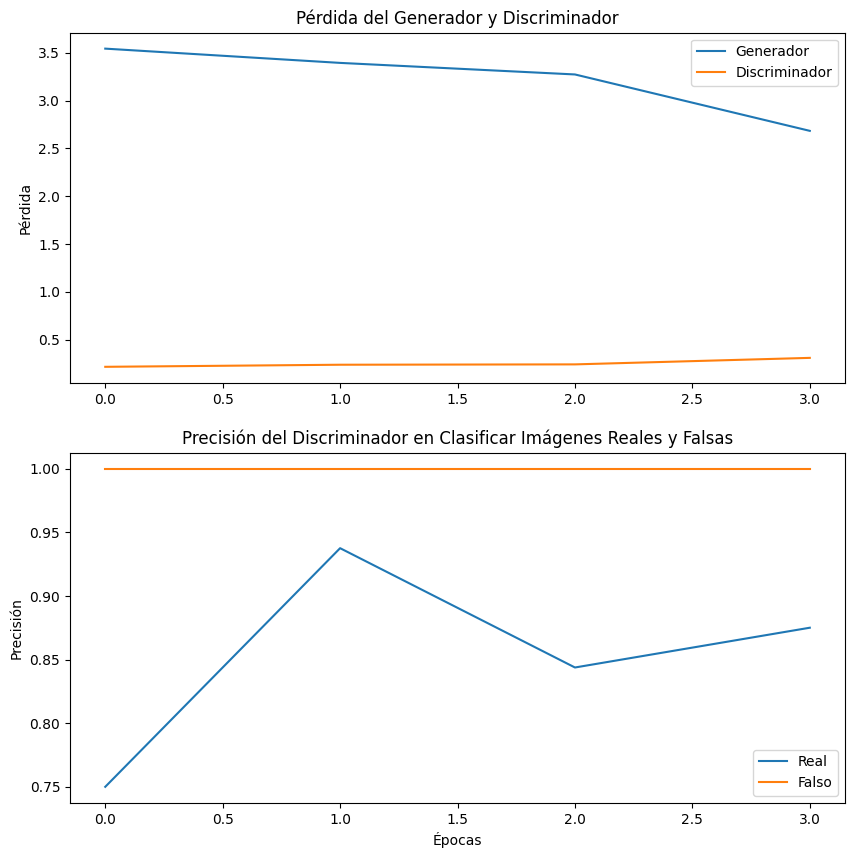

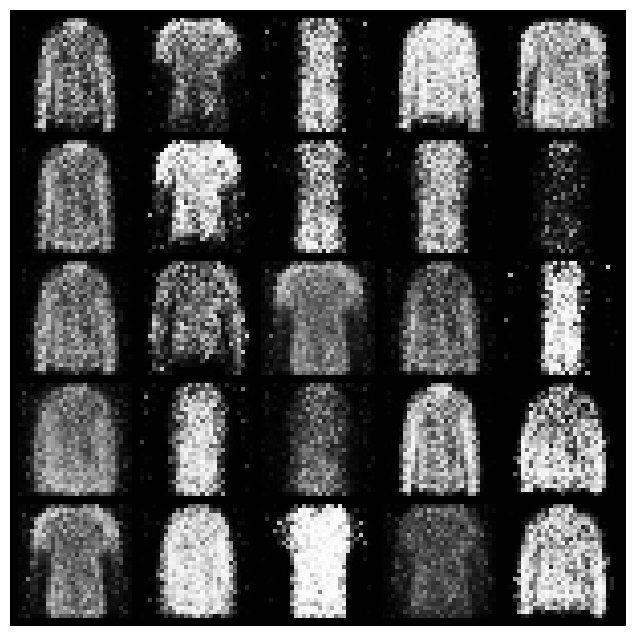

Epoch 5/30 completed


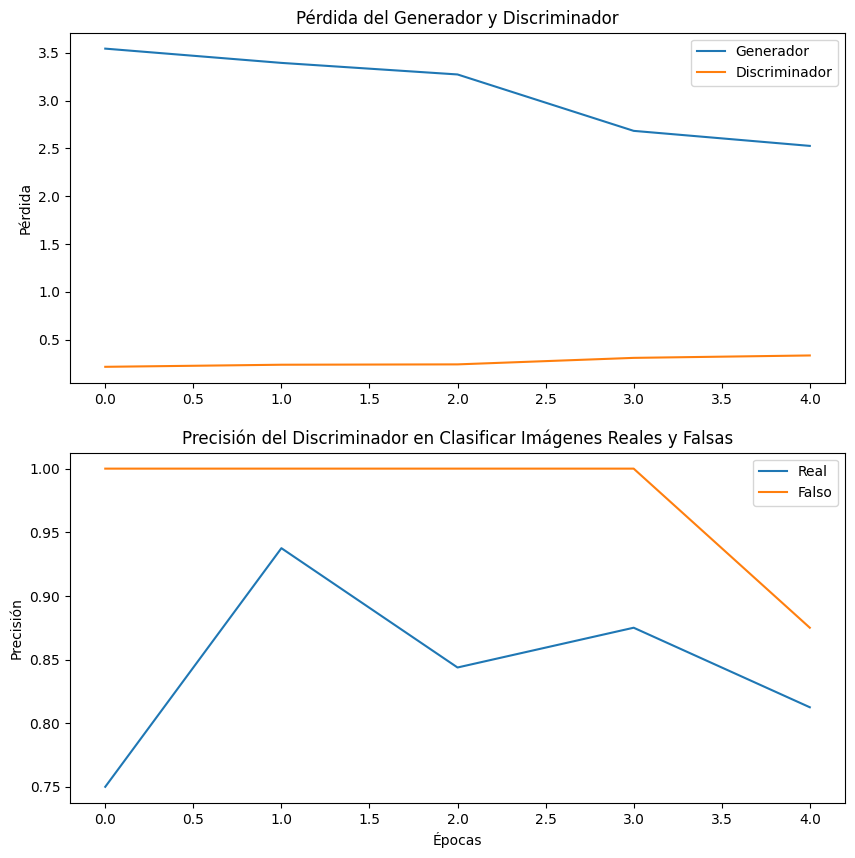

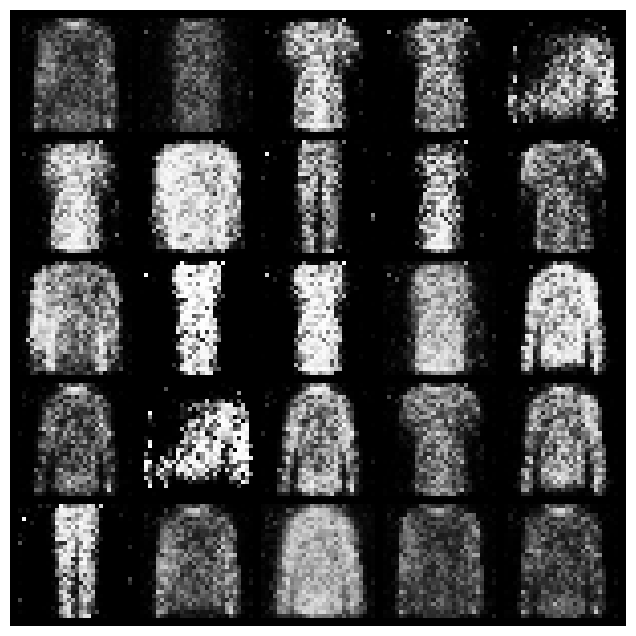

Epoch 6/30 completed


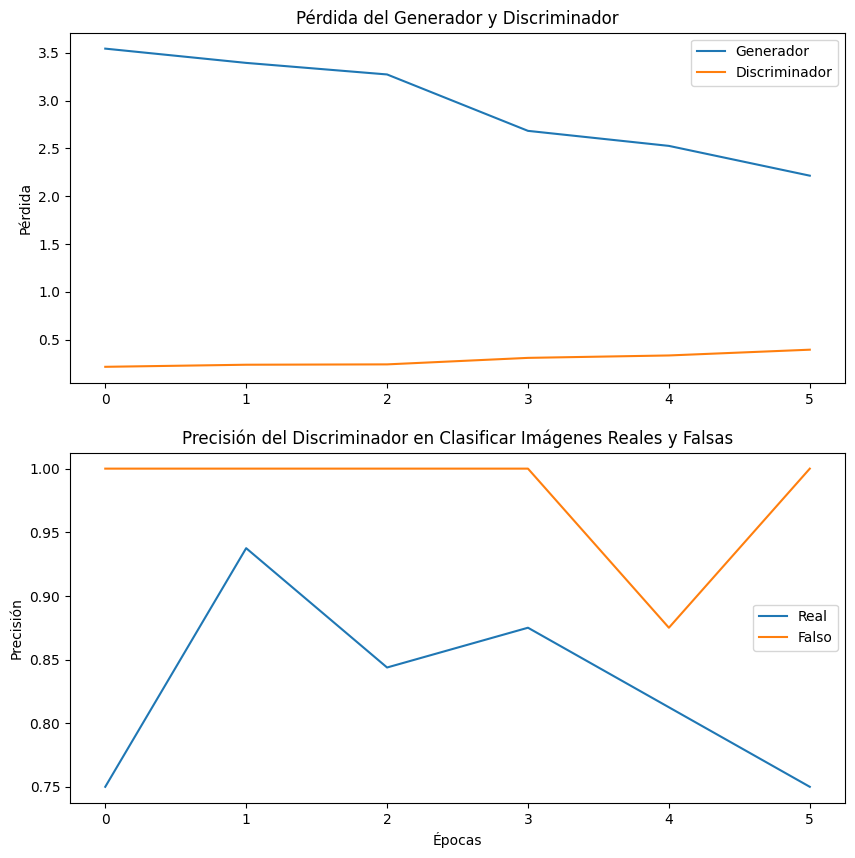

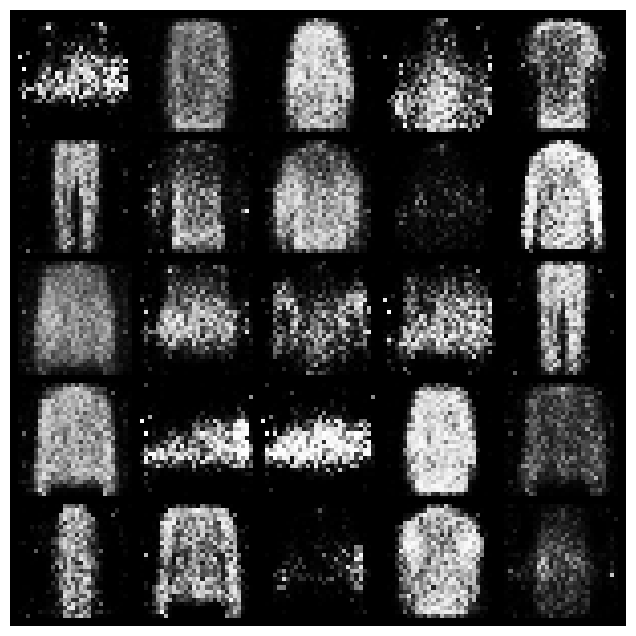

Epoch 7/30 completed


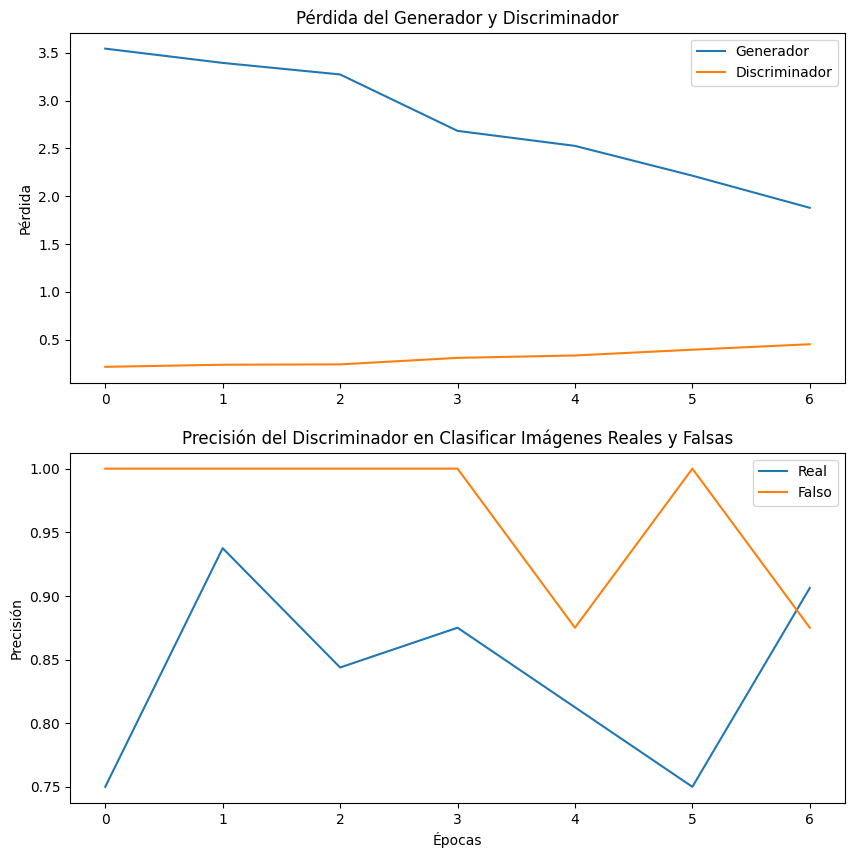

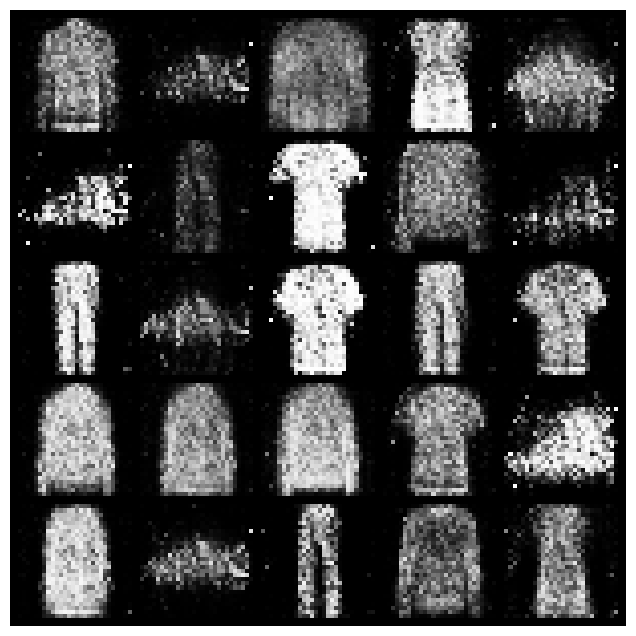

Epoch 8/30 completed


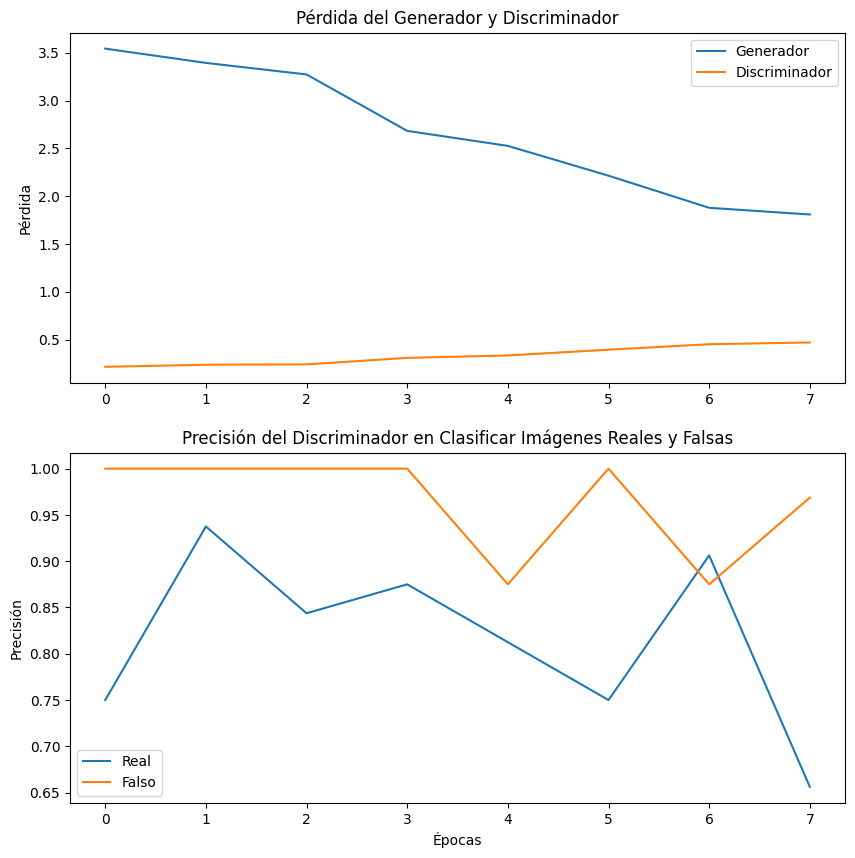

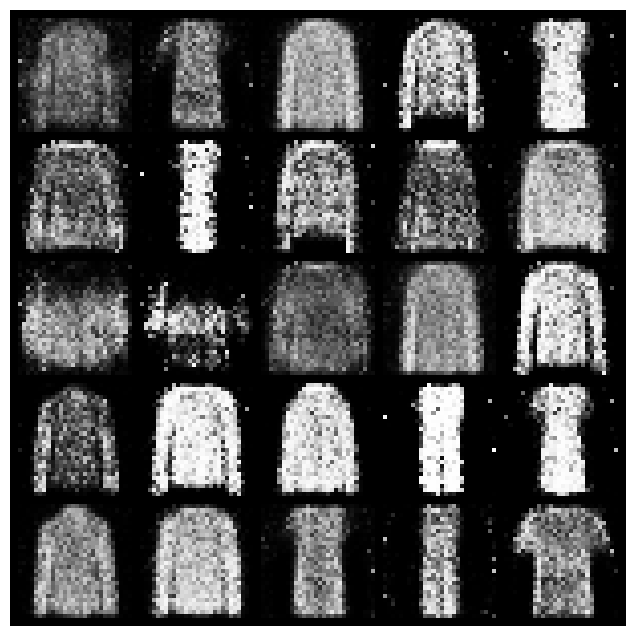

Epoch 9/30 completed


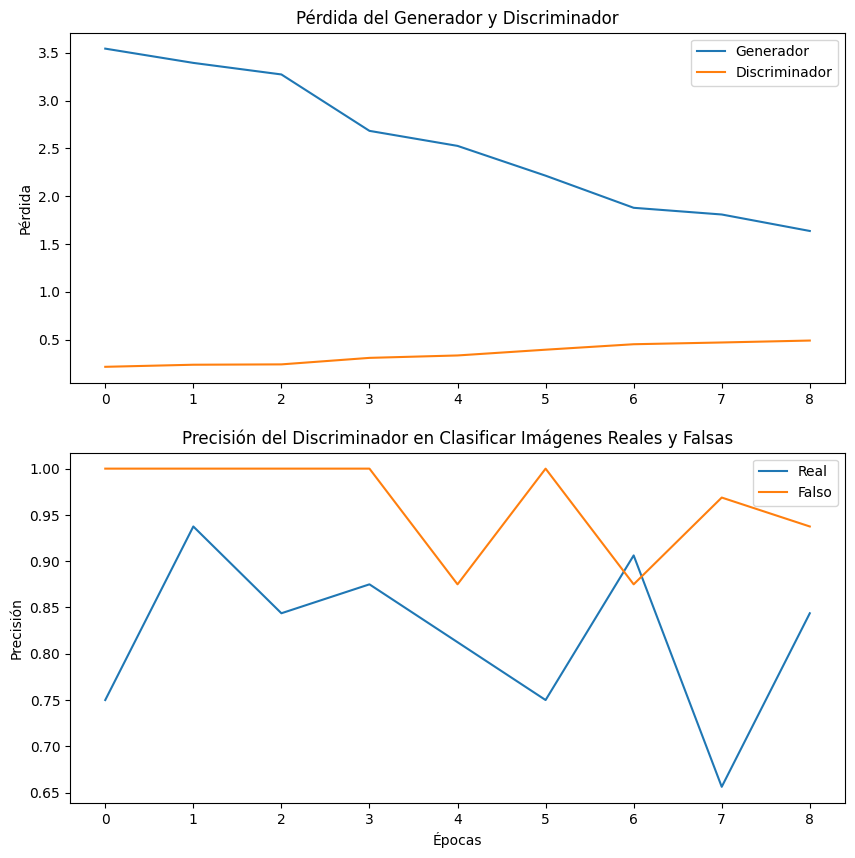

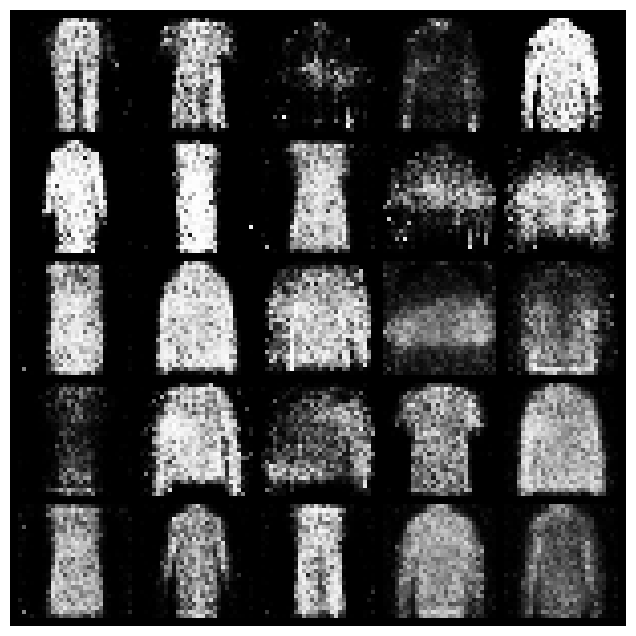

Epoch 10/30 completed


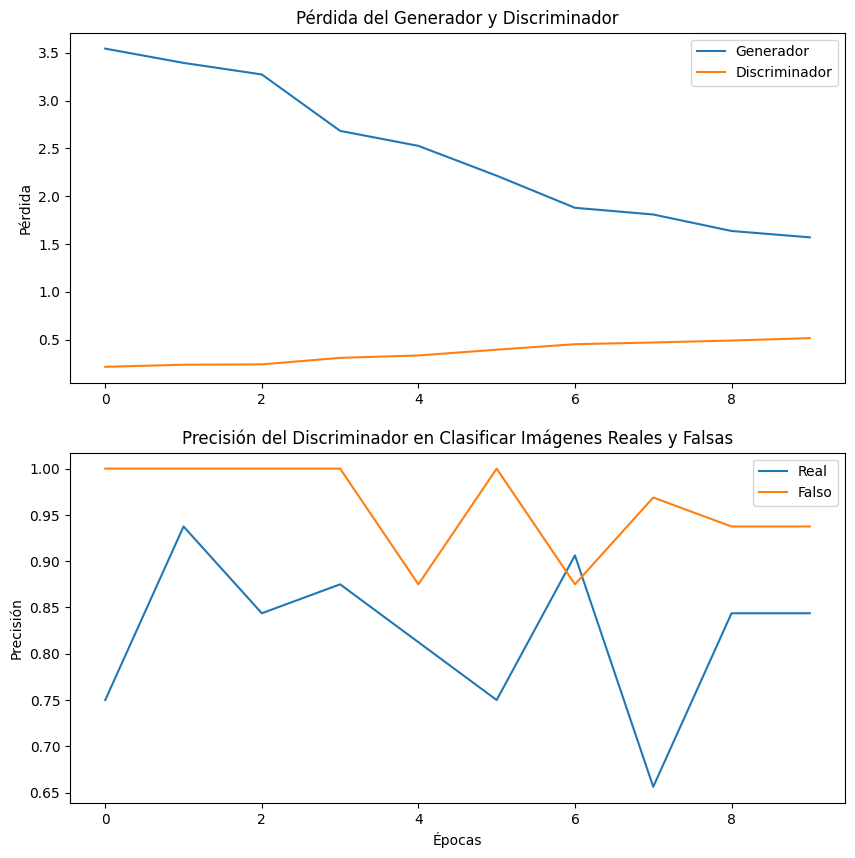

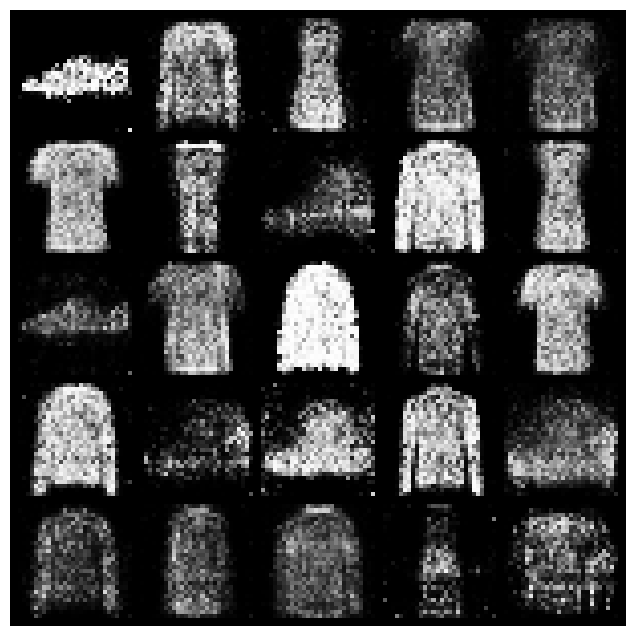

Epoch 11/30 completed


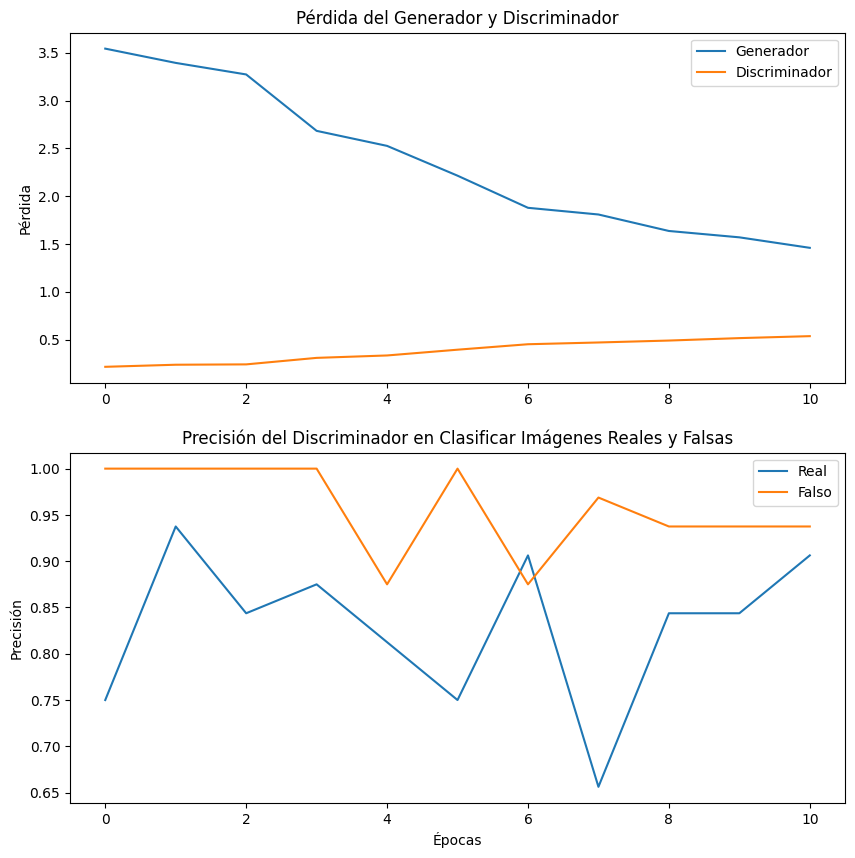

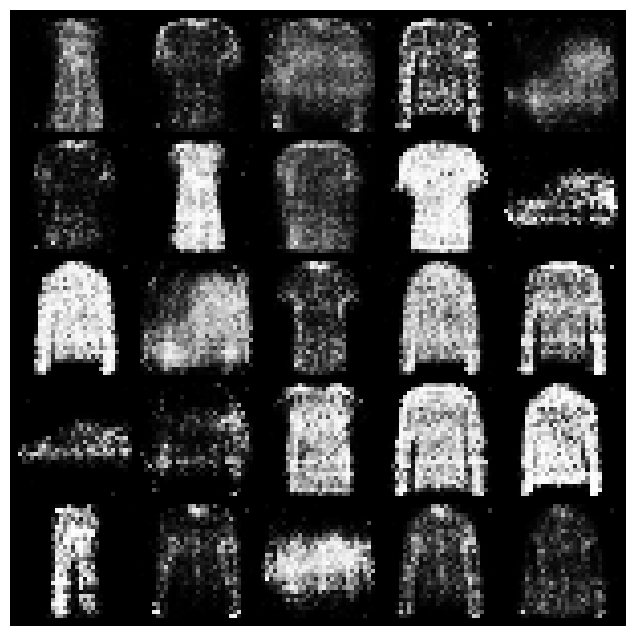

Epoch 12/30 completed


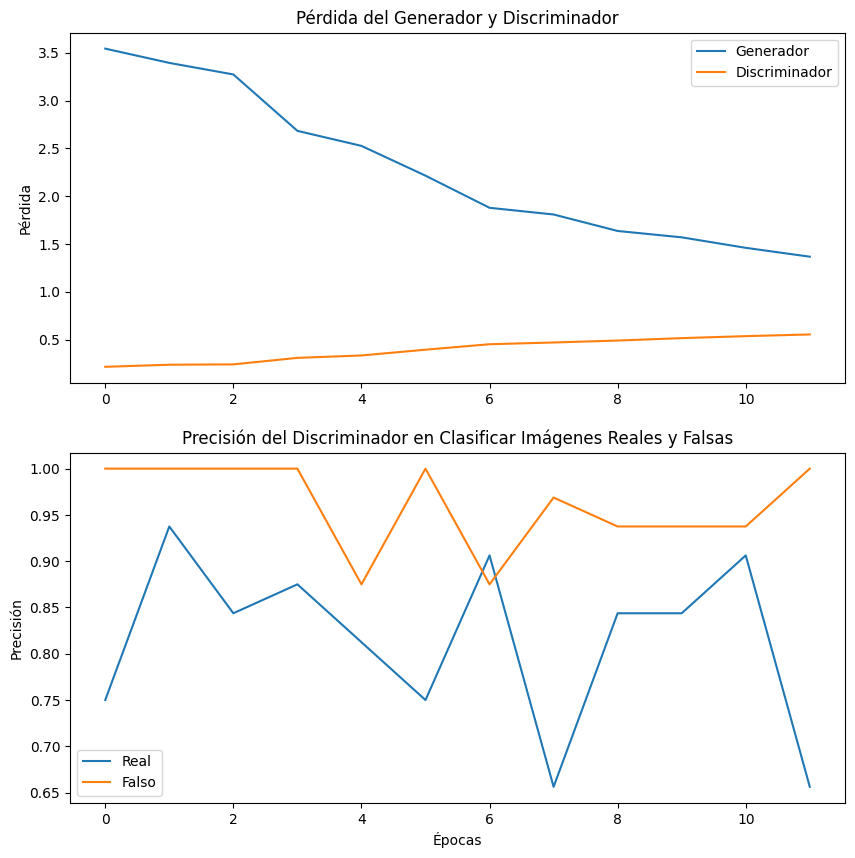

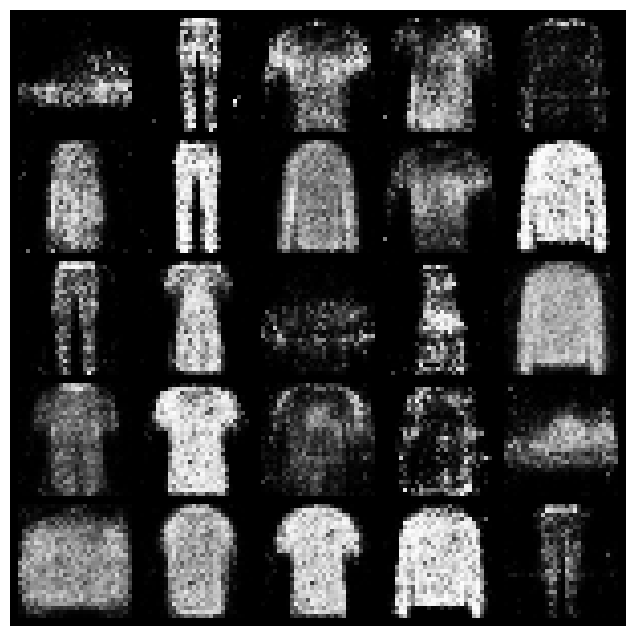

Epoch 13/30 completed


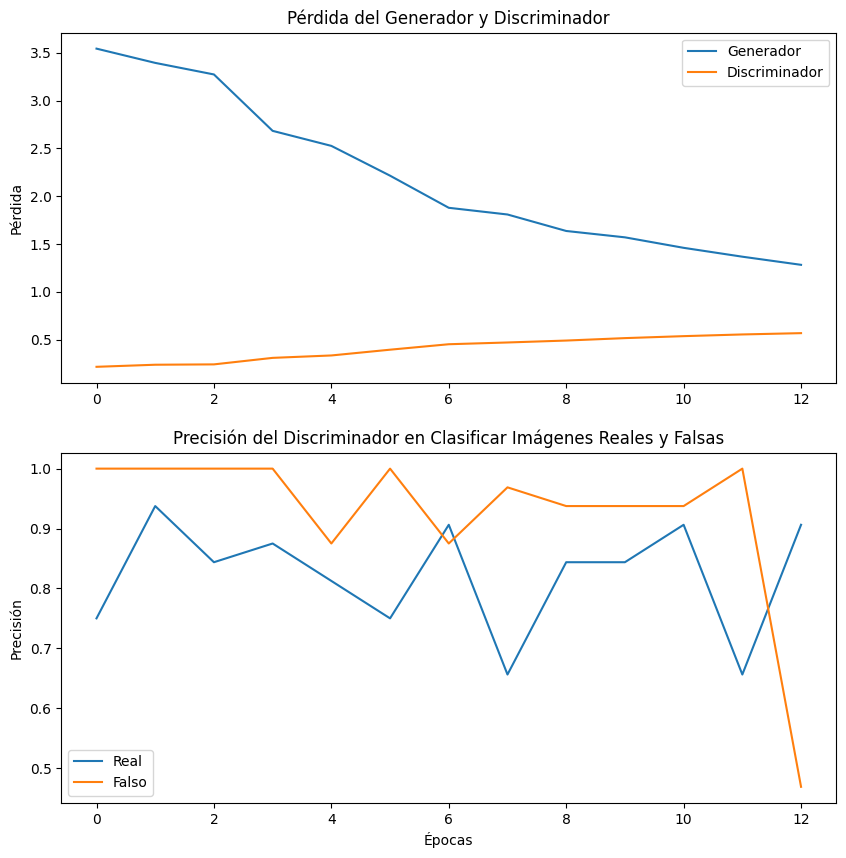

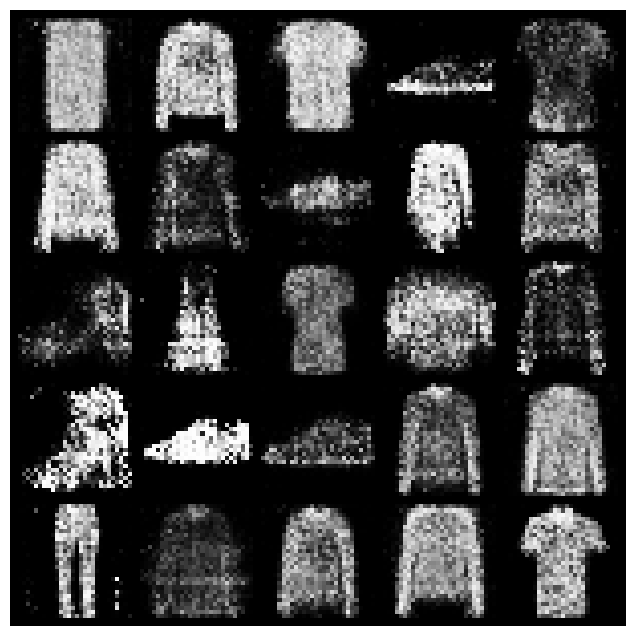

Epoch 14/30 completed


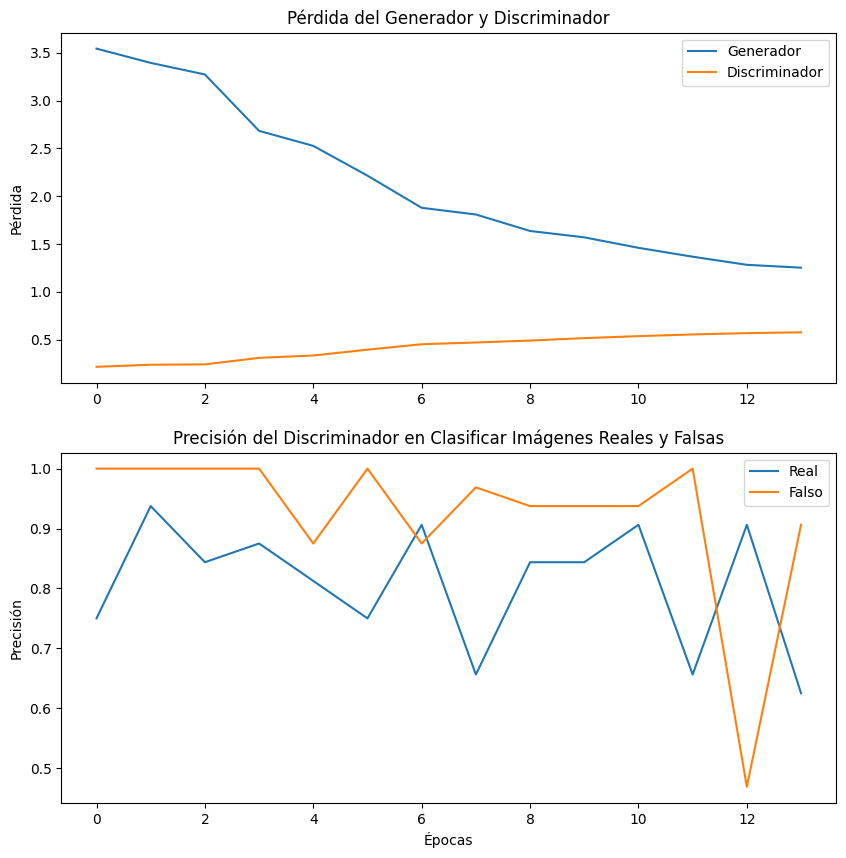

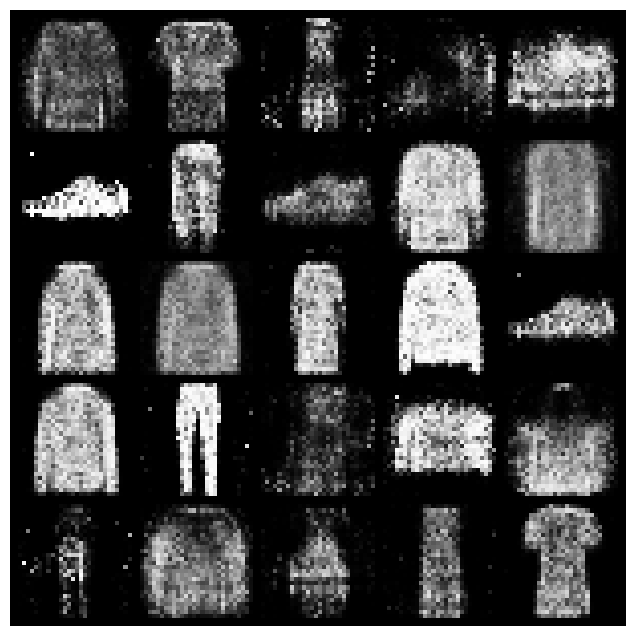

Epoch 15/30 completed


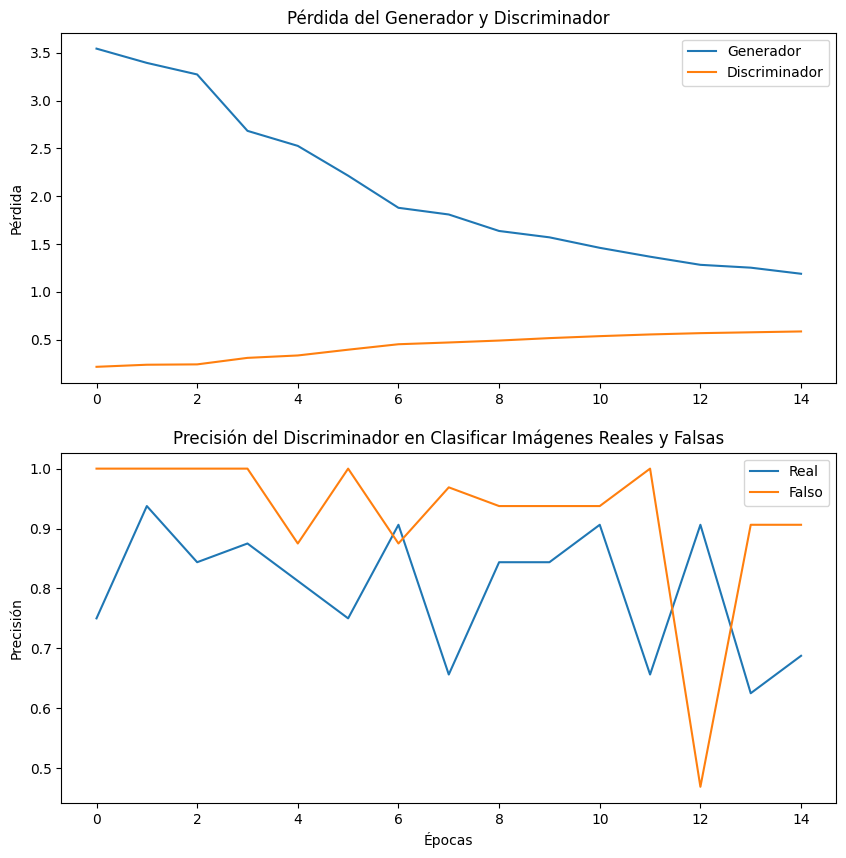

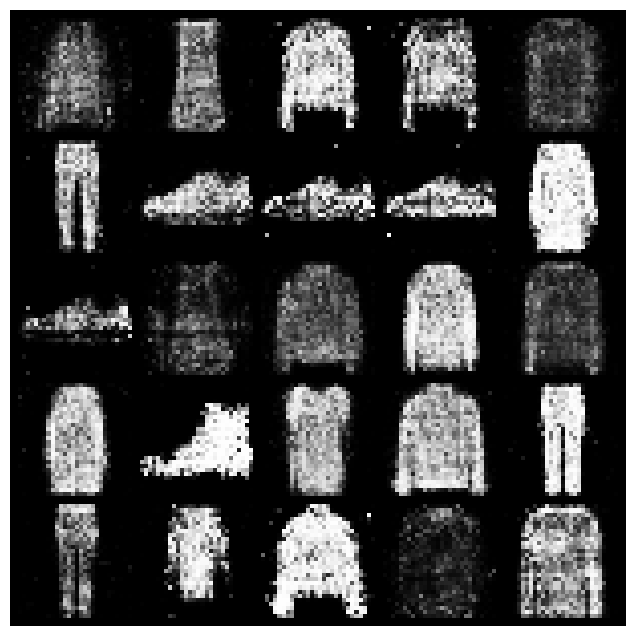

Epoch 16/30 completed


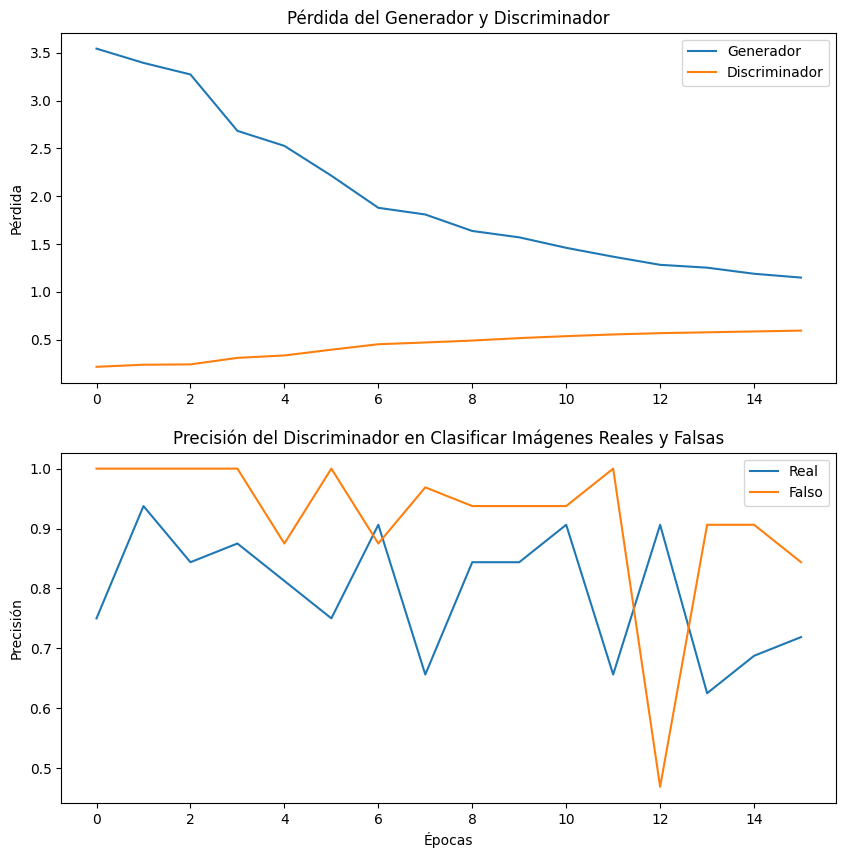

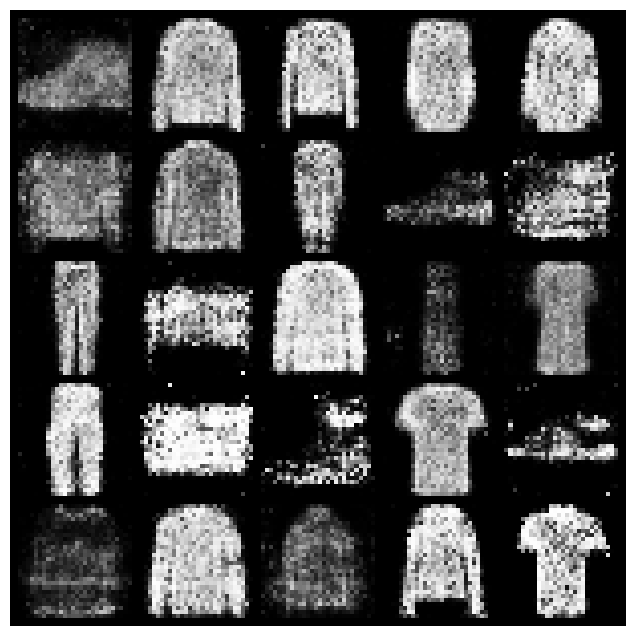

Epoch 17/30 completed


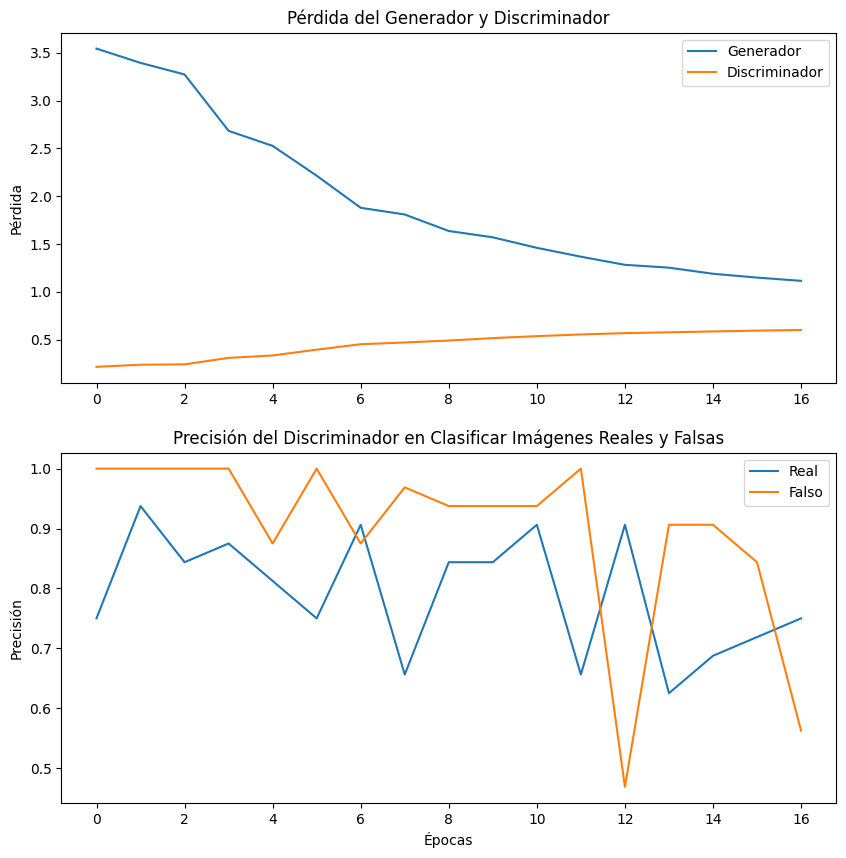

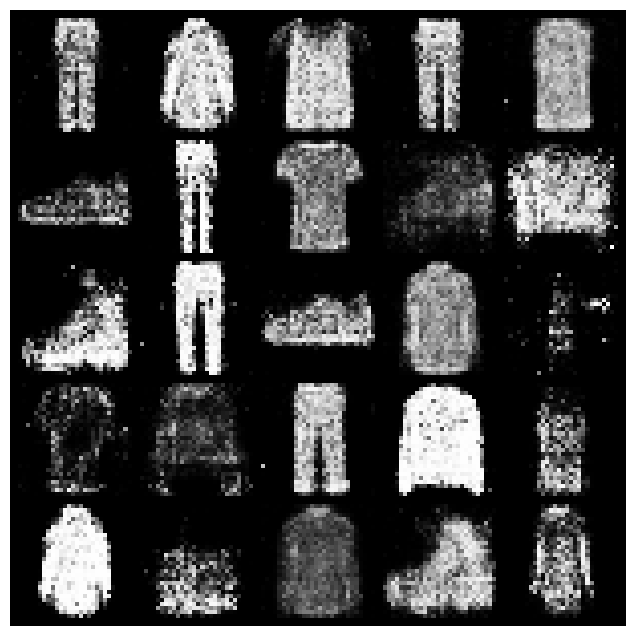

Epoch 18/30 completed


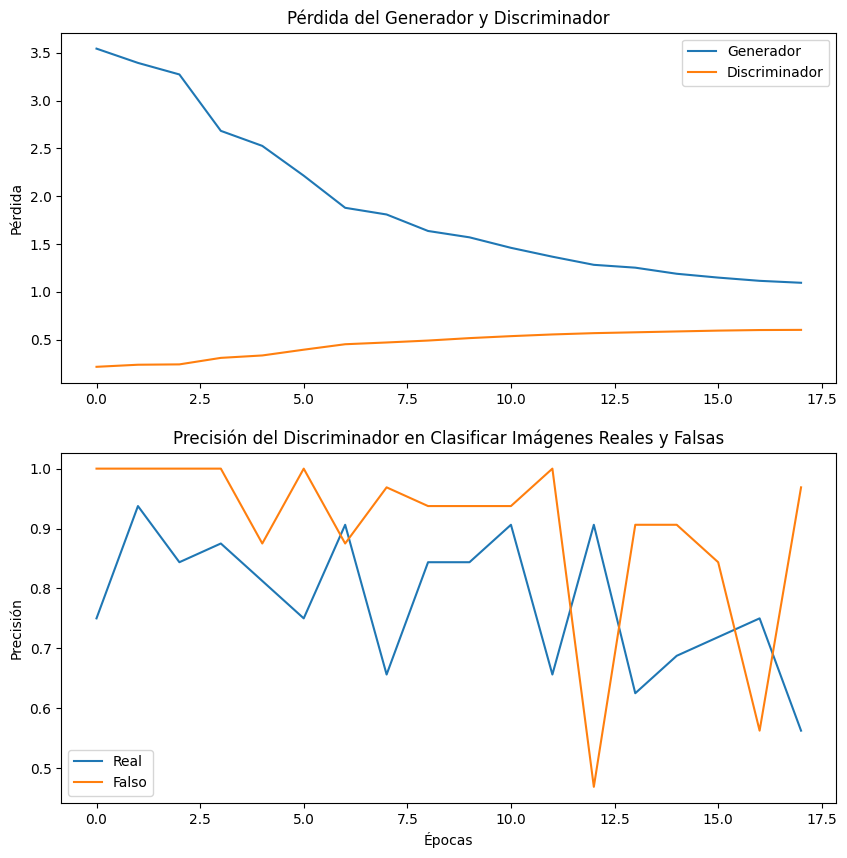

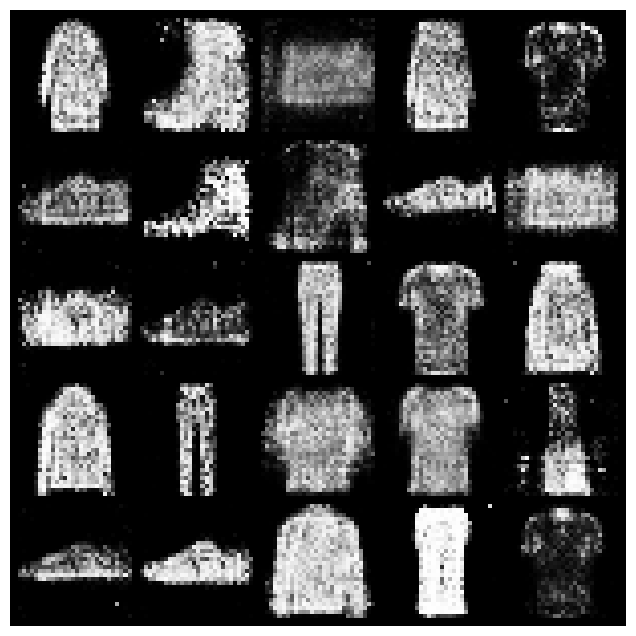

Epoch 19/30 completed


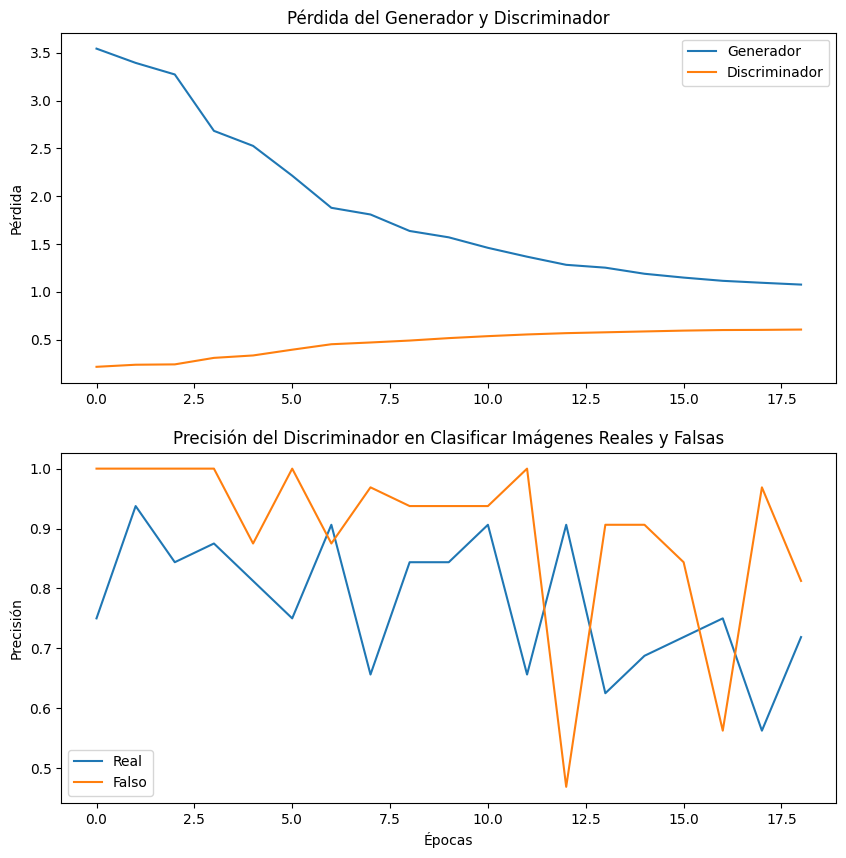

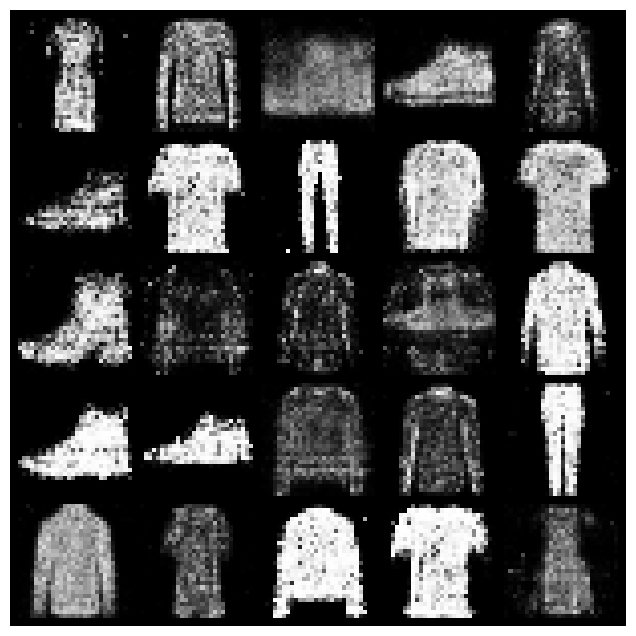

Epoch 20/30 completed


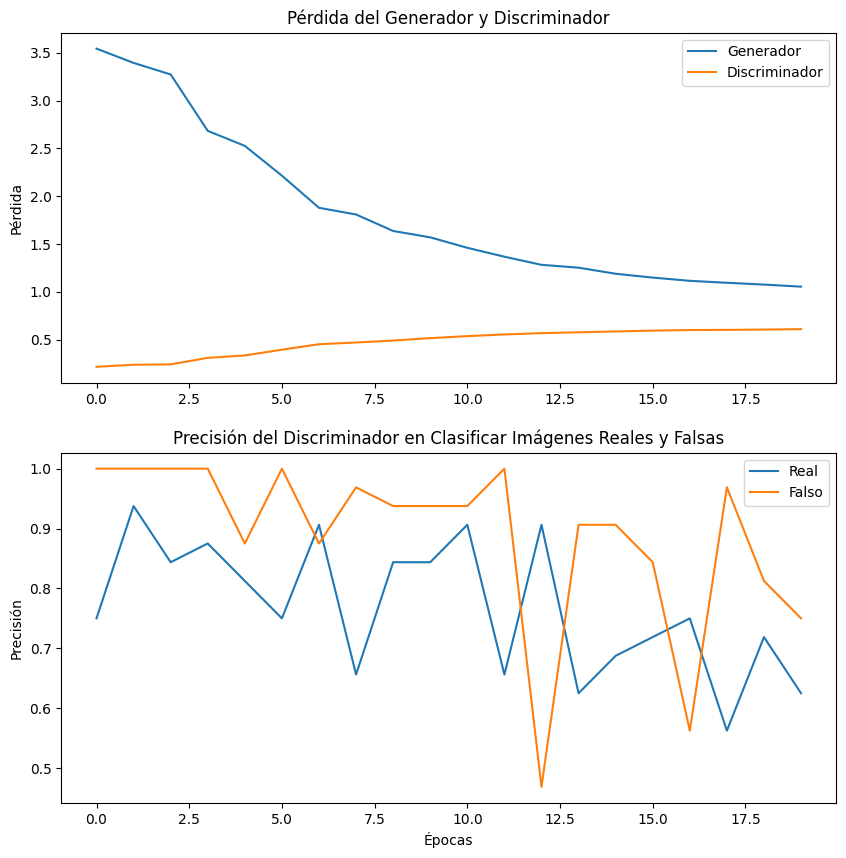

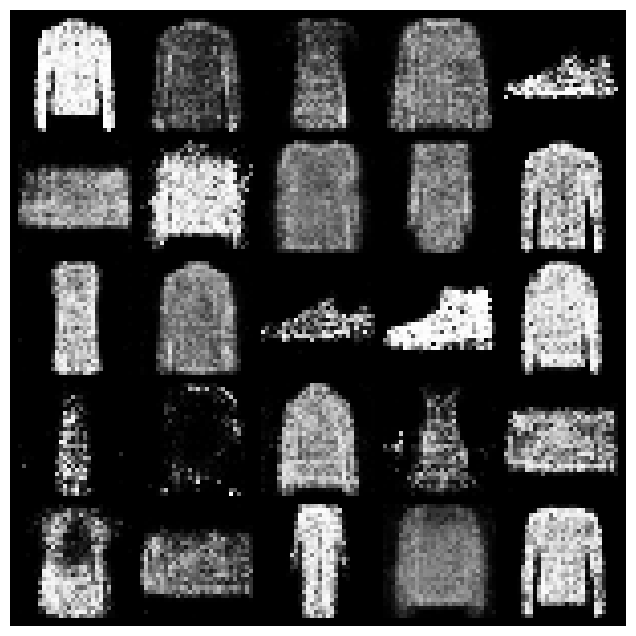

Epoch 21/30 completed


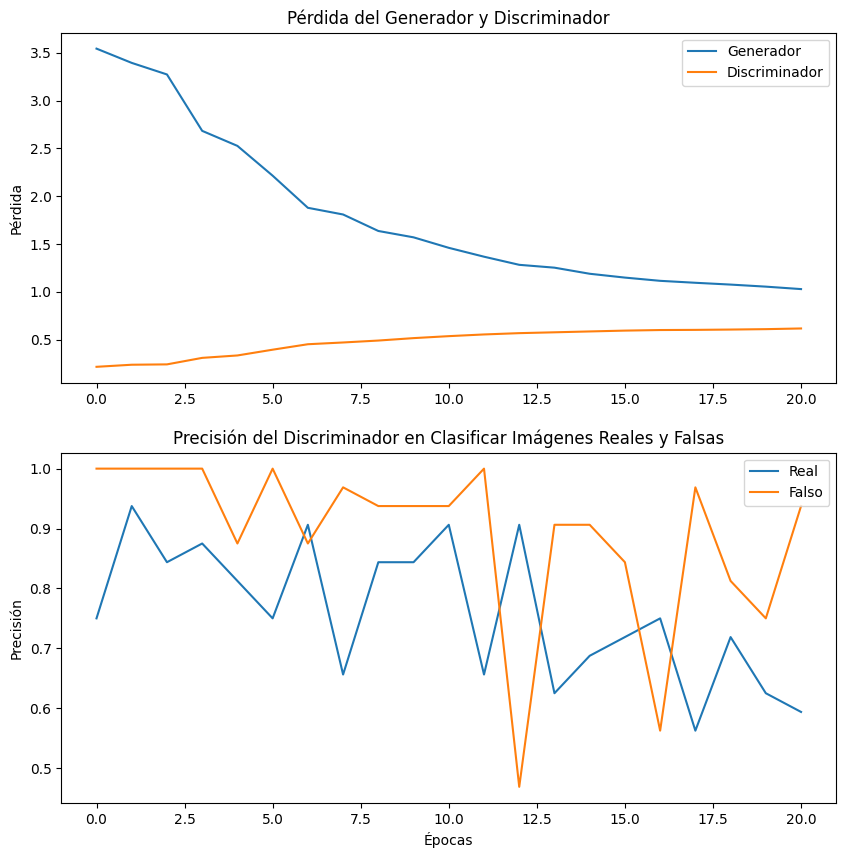

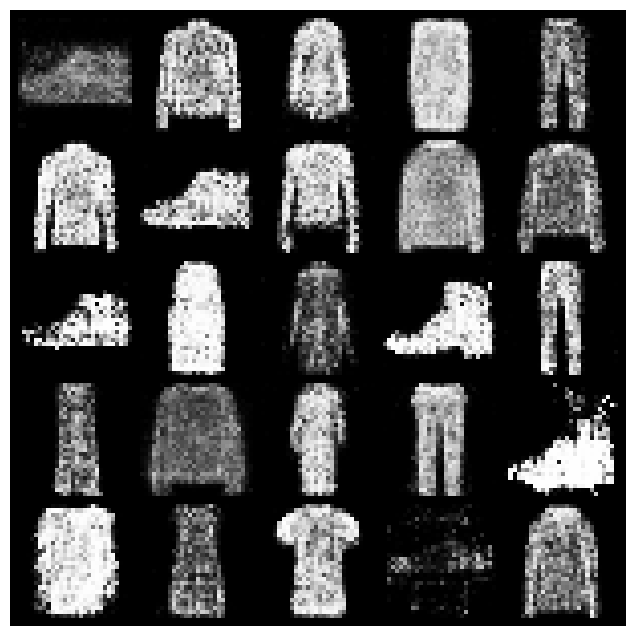

Epoch 22/30 completed


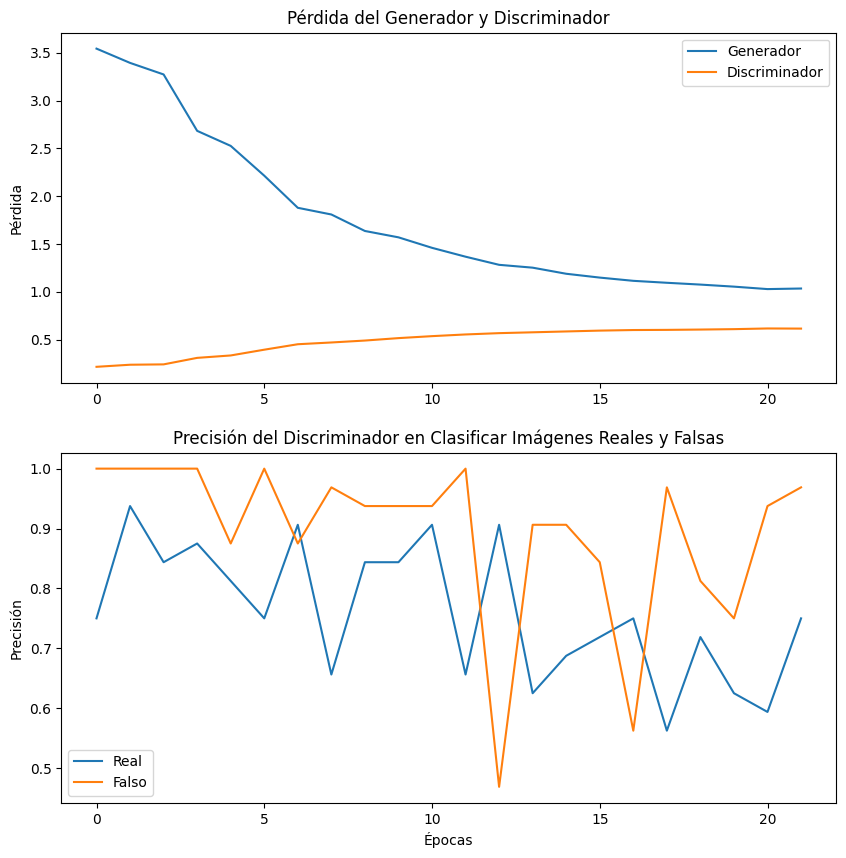

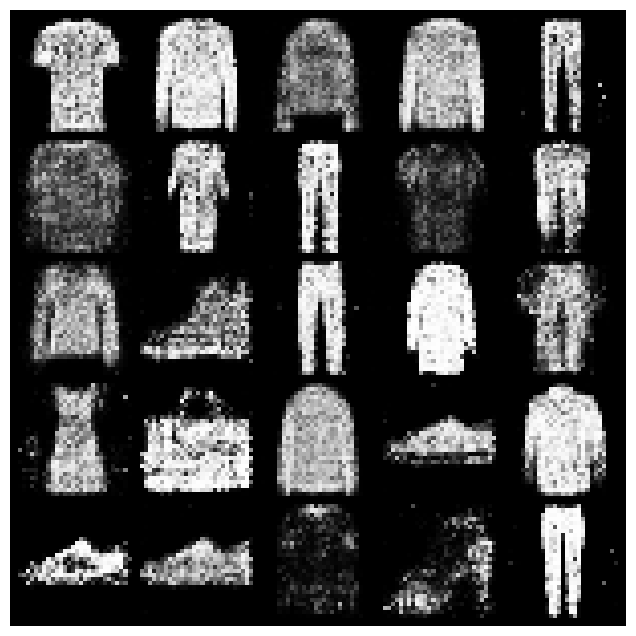

Epoch 23/30 completed


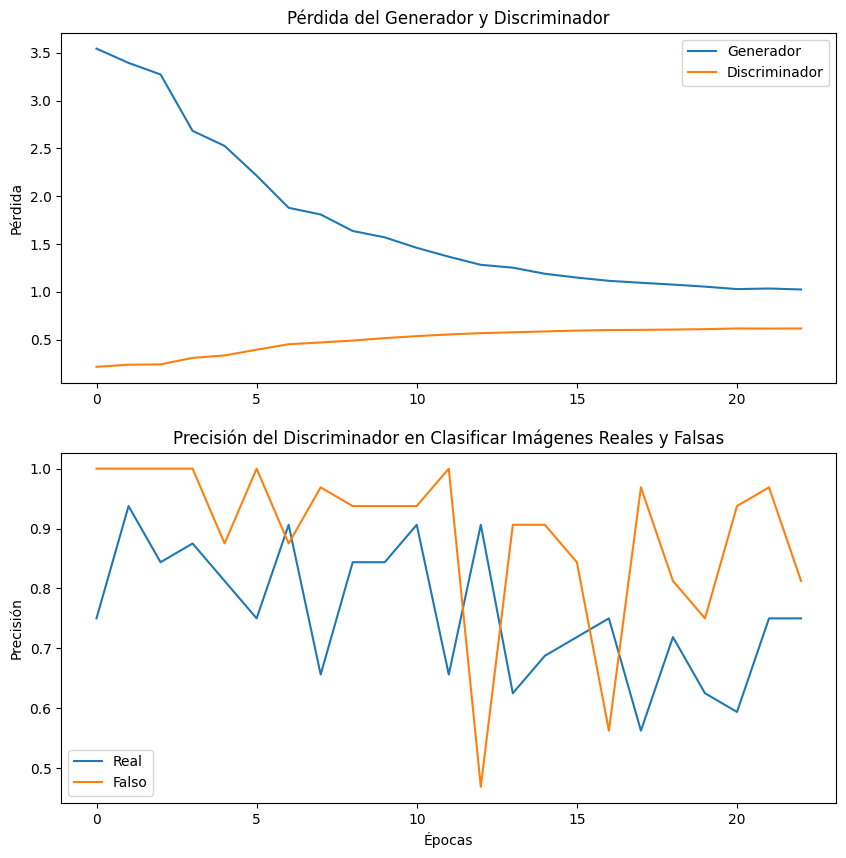

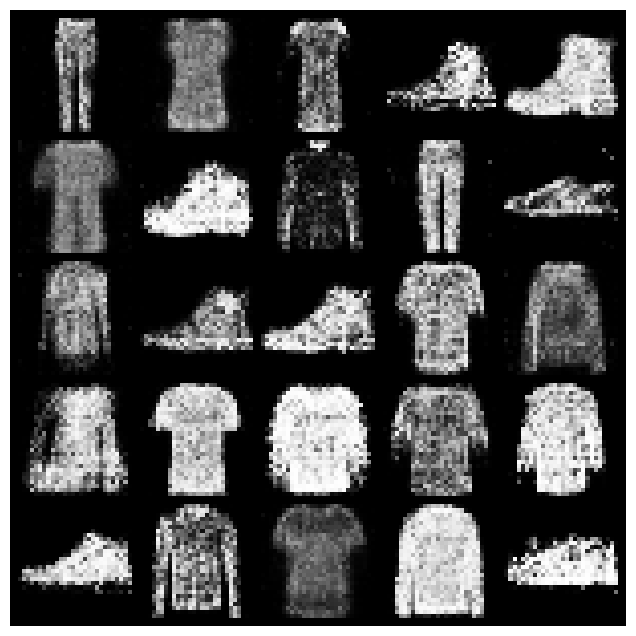

Epoch 24/30 completed


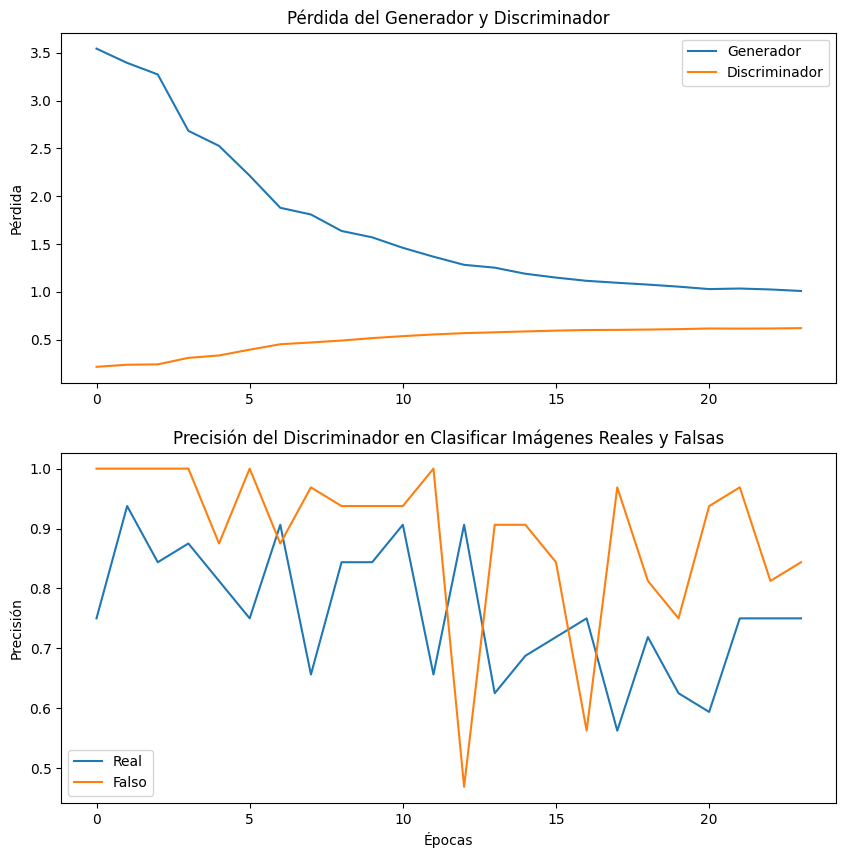

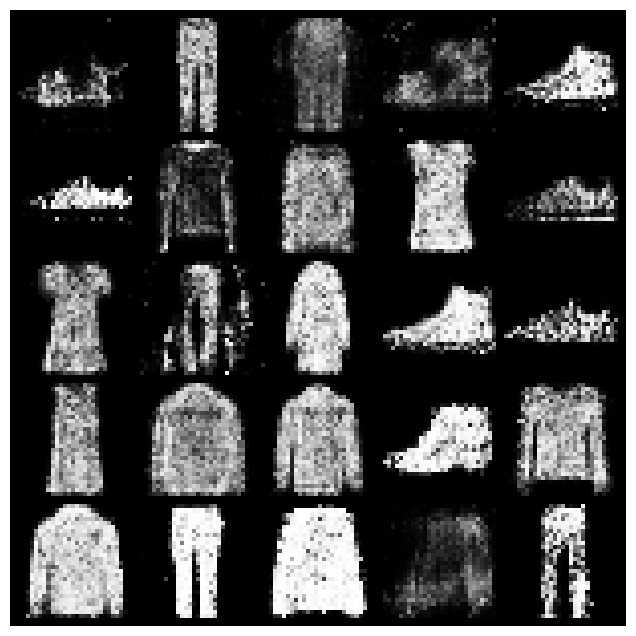

Epoch 25/30 completed


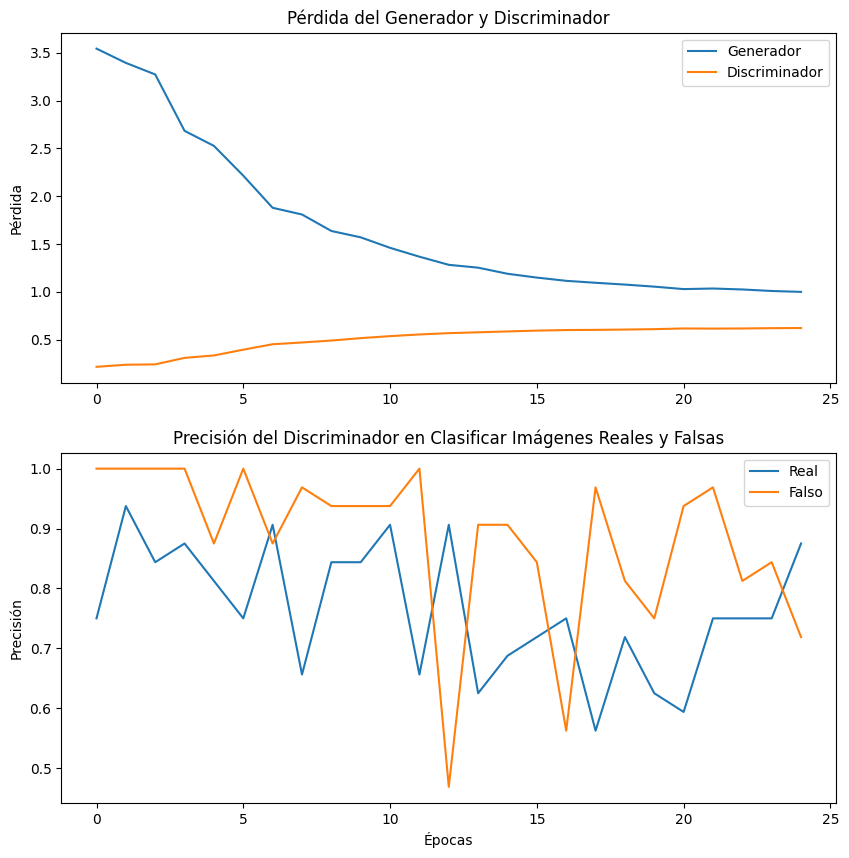

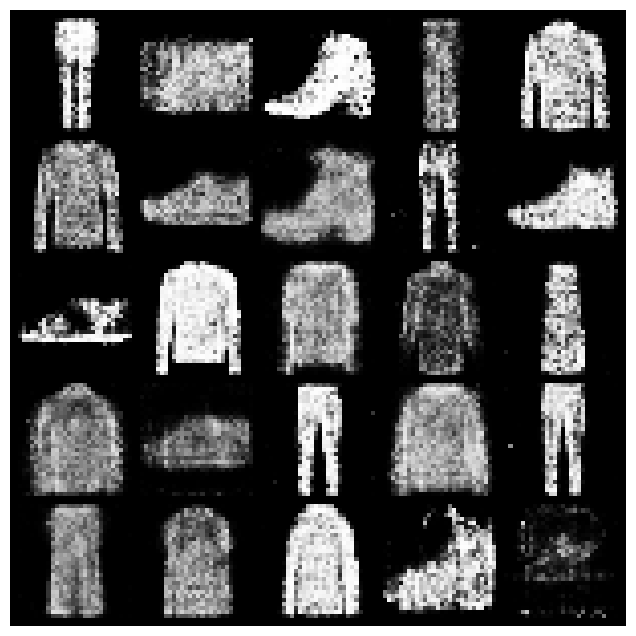

Epoch 26/30 completed


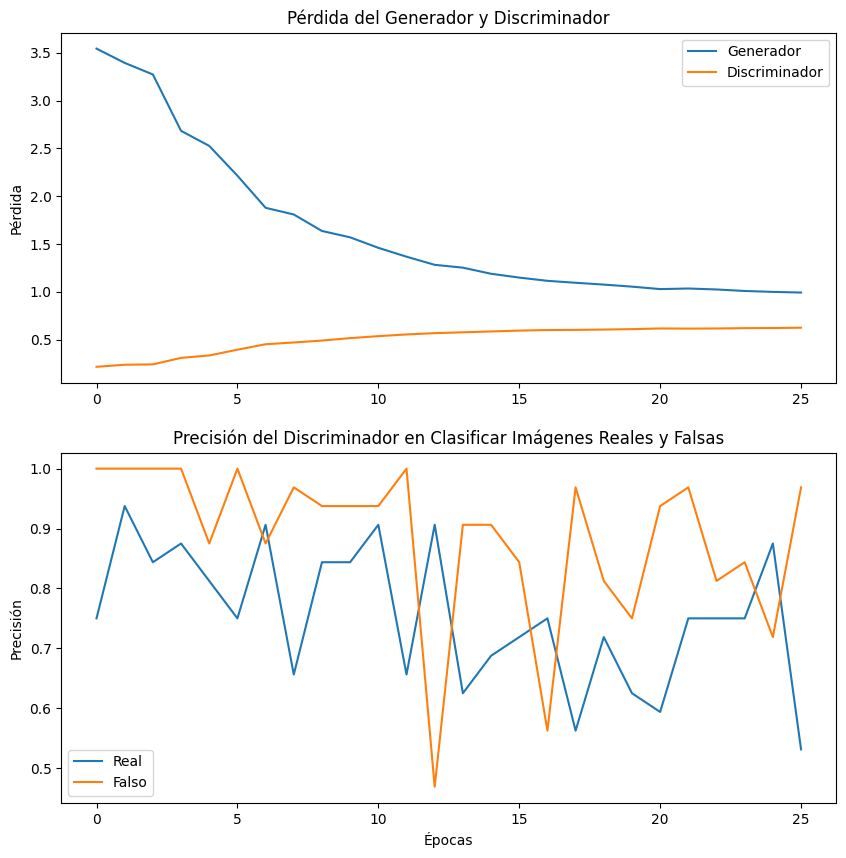

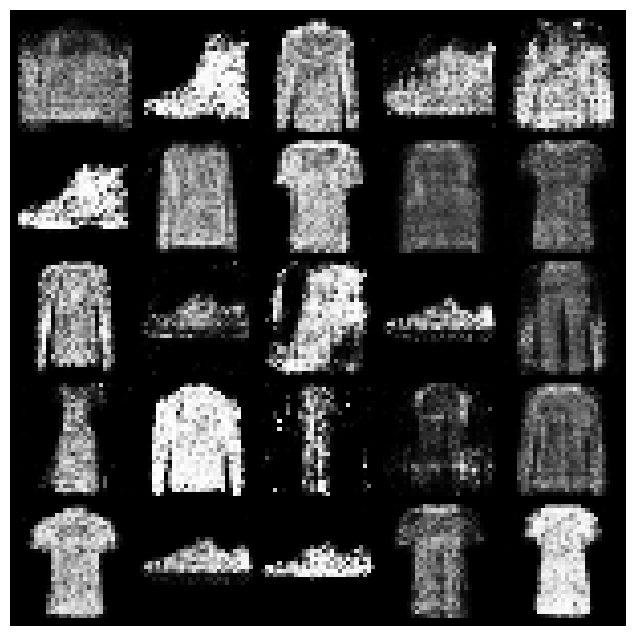

Epoch 27/30 completed


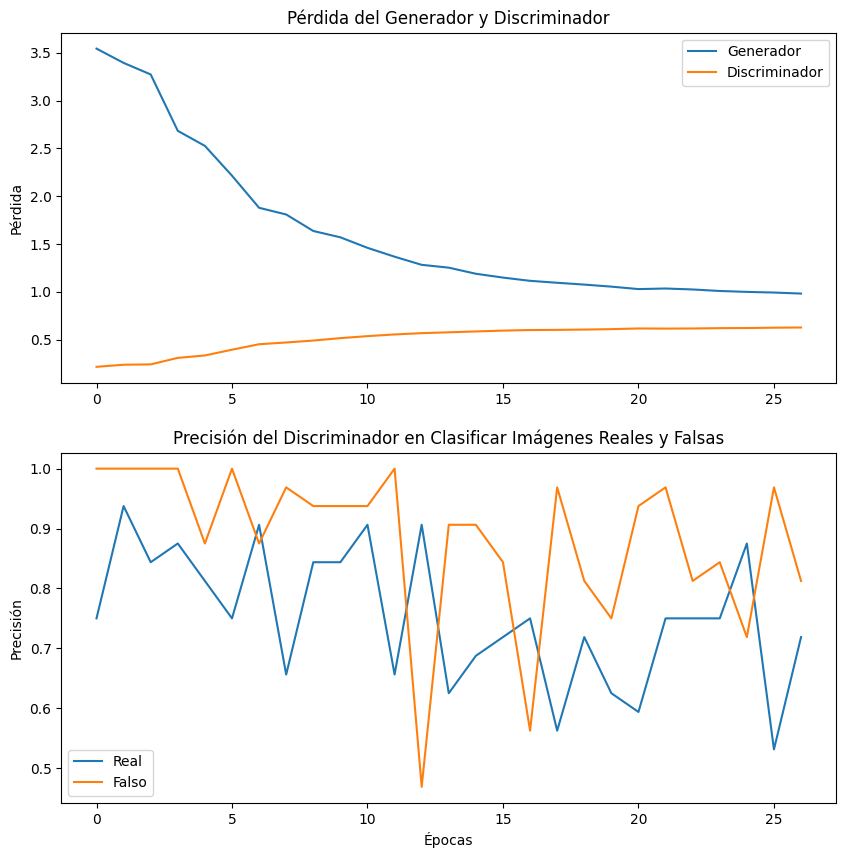

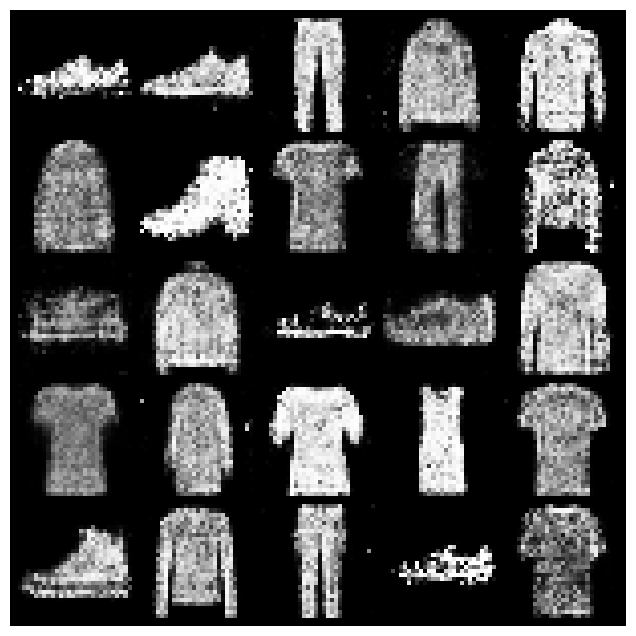

Epoch 28/30 completed


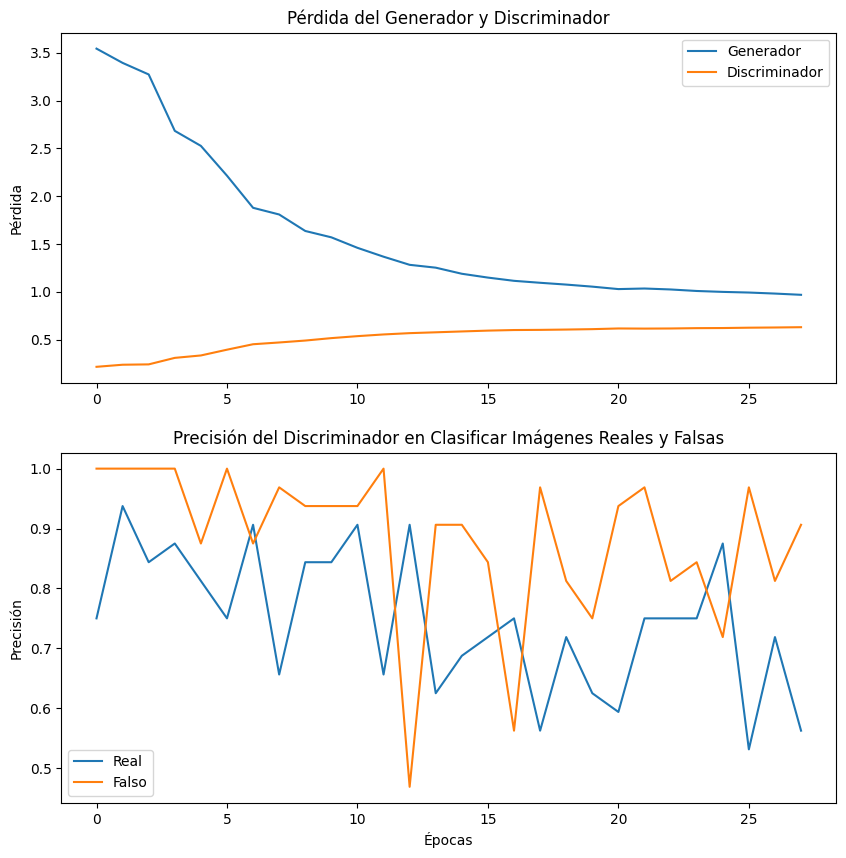

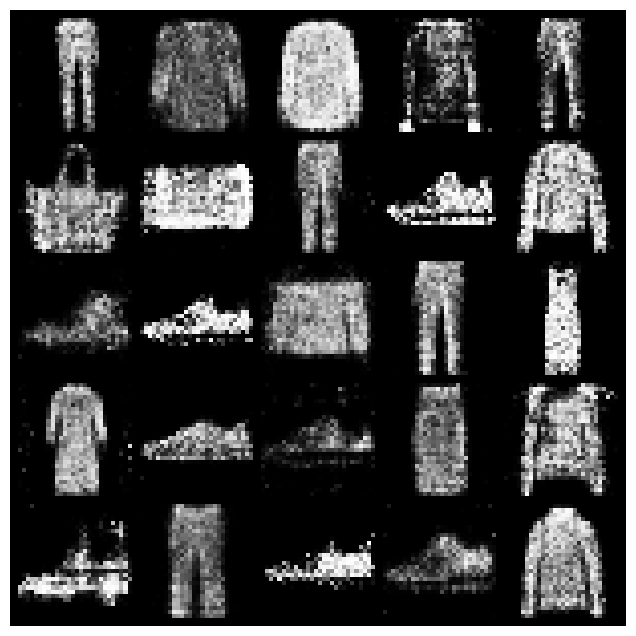

Epoch 29/30 completed


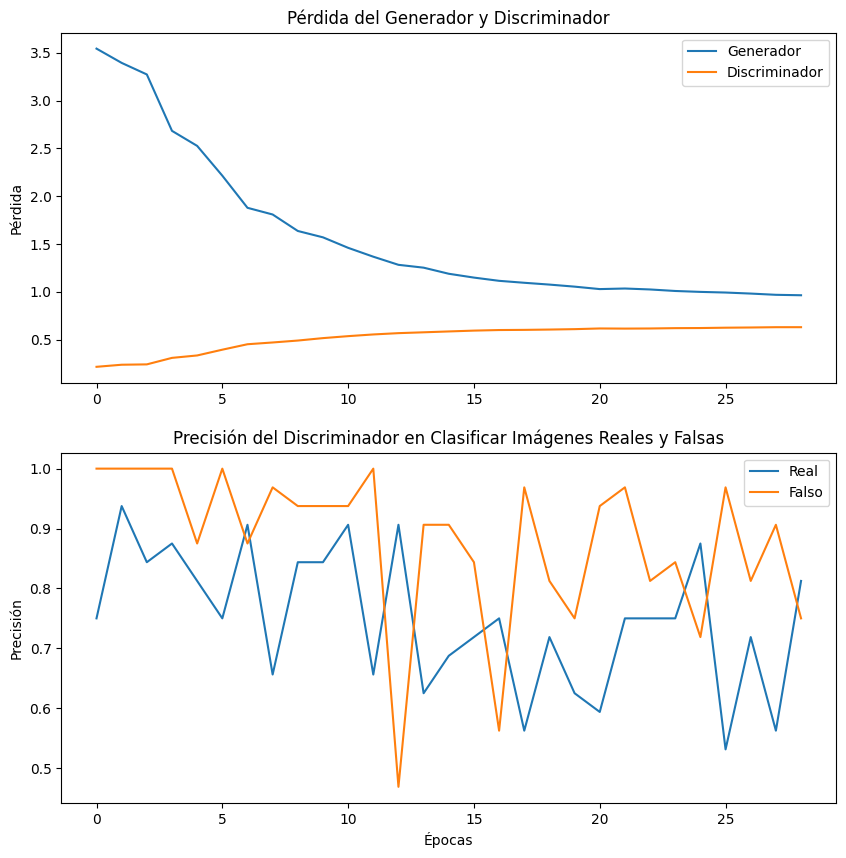

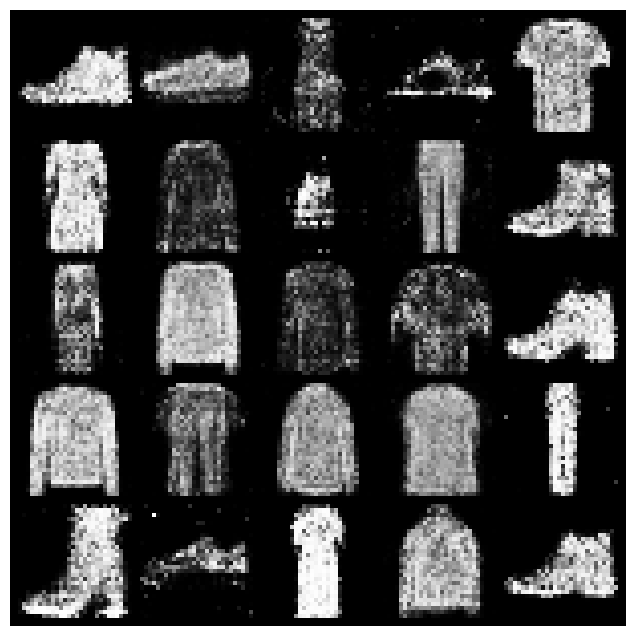

Epoch 30/30 completed


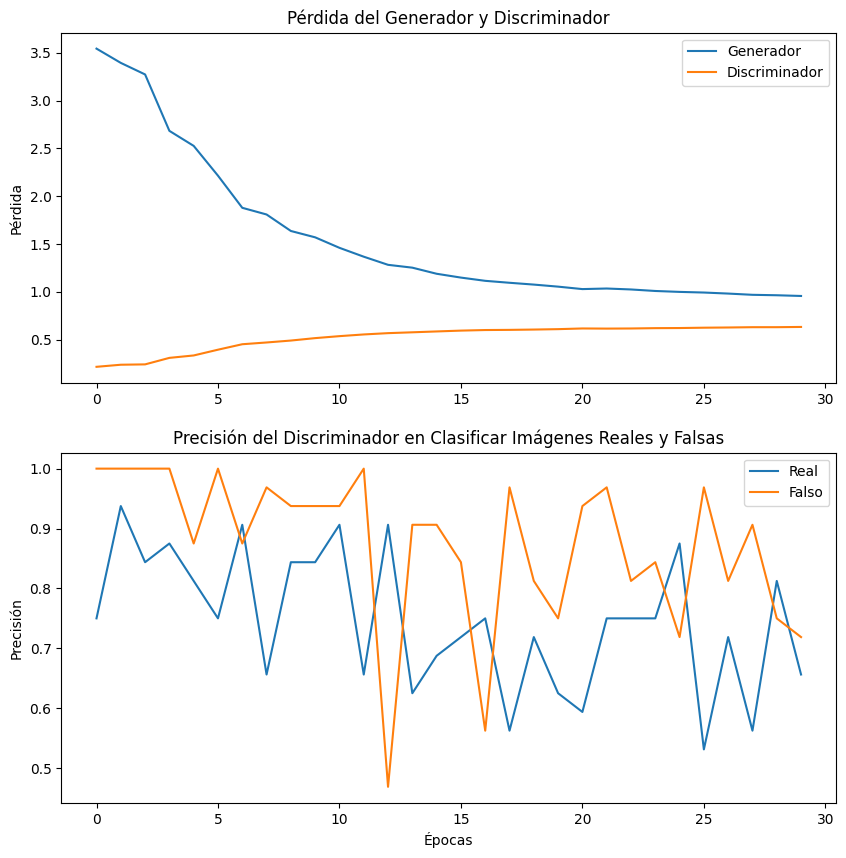

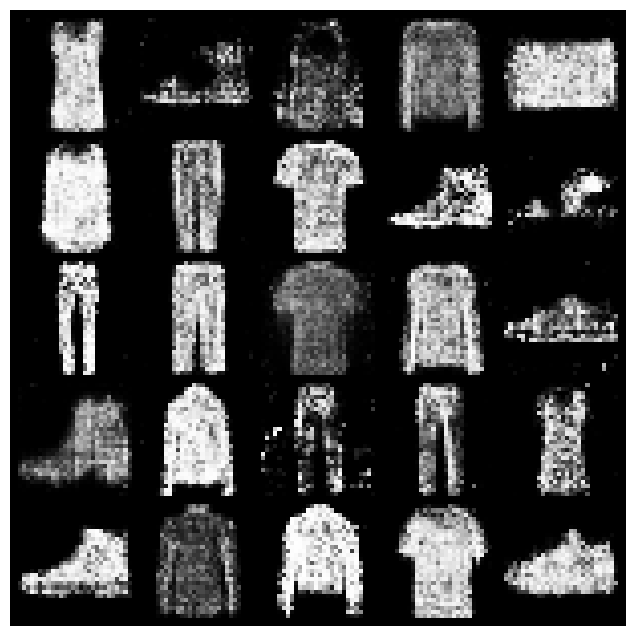

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

generator = Generator().to(device)
discriminator = Discriminator().to(device)

# Optimizadores
optimizer_G = optim.Adam(generator.parameters(), lr=0.0002, betas=(0.5, 0.999))
optimizer_D = optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))

# Función de pérdida
criterion = nn.BCELoss()

# Listas para almacenar pérdidas
G_losses = []
D_losses = []
D_real_accuracy = []
D_fake_accuracy = []
average_G_losses = []
average_D_losses = []
# Número de épocas
num_epochs = 30

# Entrenamiento
for epoch in range(num_epochs):
    G_loss_accum = 0.0
    D_loss_accum = 0.0
    num_batches = 0
    for i, (real_images, _) in enumerate(fashion_mnist_train_loader):
        num_batches += 1
        # Configuración de las etiquetas reales y falsas
        real = torch.ones(real_images.size(0), 1, device=device)
        fake = torch.zeros(real_images.size(0), 1, device=device)

        # Entrenar Discriminador
        discriminator.zero_grad()

        # Imágenes reales
        real_imgs = real_images.to(device)
        output_real = discriminator(real_imgs)
        loss_real = criterion(output_real, real)

        # Imágenes falsas
        noise = torch.randn(real_images.size(0), 100, device=device)
        fake_imgs = generator(noise)
        output_fake = discriminator(fake_imgs.detach())
        loss_fake = criterion(output_fake, fake)

        # Pérdida total y actualizar
        loss_D = (loss_real + loss_fake) / 2
        loss_D.backward()
        optimizer_D.step()

        # Entrenar Generador
        generator.zero_grad()

        # Engañar al discriminador
        output_fake = discriminator(fake_imgs)
        loss_G = criterion(output_fake, real)
        loss_G.backward()
        optimizer_G.step()

        # Guardar las pérdidas para visualización
        G_losses.append(loss_G.item())
        D_losses.append(loss_D.item())
        G_loss_accum += loss_G.item()
        D_loss_accum += loss_D.item()

        with torch.no_grad():
            real_pred = discriminator(real_images.to(device))
            real_correct = torch.sum(real_pred >= 0.5).item()  # Imágenes reales clasificadas como reales
            fake_pred = discriminator(fake_imgs.detach())
            fake_correct = torch.sum(fake_pred < 0.5).item()  # Imágenes falsas clasificadas como falsas

    average_G_losses.append(G_loss_accum / num_batches)
    average_D_losses.append(D_loss_accum / num_batches)
    D_real_accuracy.append(real_correct / real_images.size(0))
    D_fake_accuracy.append(fake_correct / real_images.size(0))

    save_generated_images(generator, device, epoch)
    create_gif('generated_images', "gan_fashion_mnist.gif")
    # Mostrar pérdidas y generar imágenes al final de cada época
    print(f"Epoch {epoch + 1}/{num_epochs} completed")
    plot_metrics(average_G_losses, average_D_losses, D_real_accuracy, D_fake_accuracy)
    show_generated_images(generator, device)

##### CGAN

<ipython-input-51-902d87a423af>:4: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  images.append(imageio.imread(file_name))


Epoch 1/30 completed


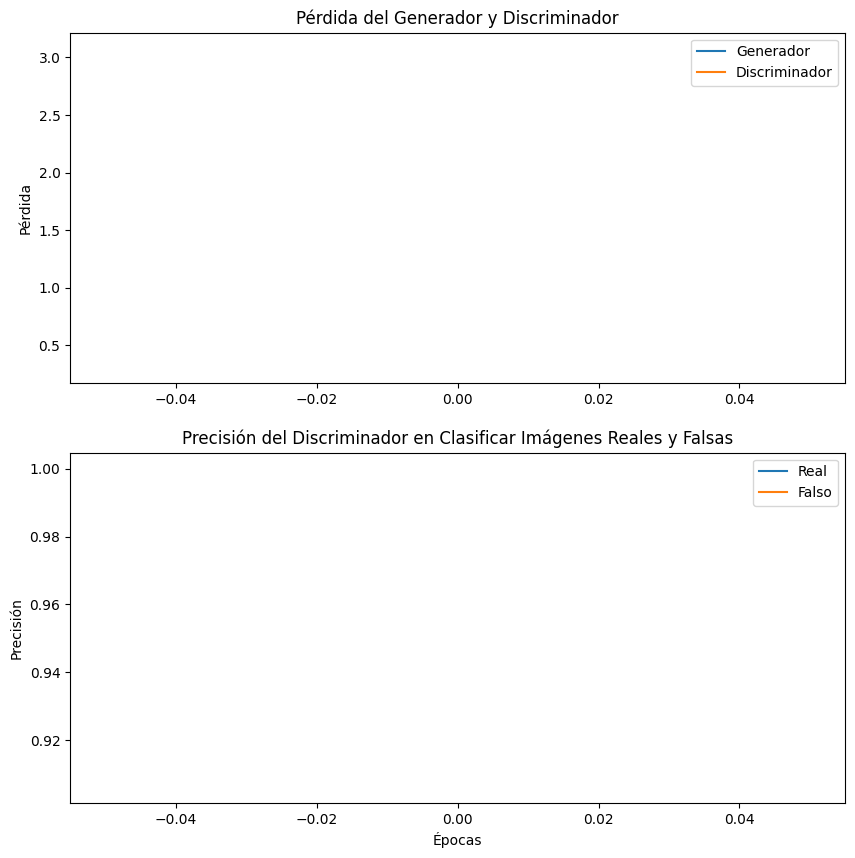

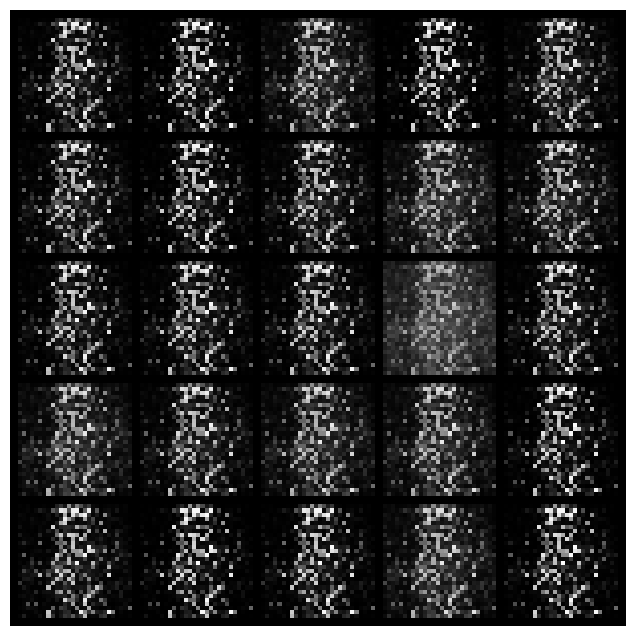

Discriminator Accuracy: 0.2814, Generator Accuracy: 0.35956666666666665
Epoch 2/30 completed


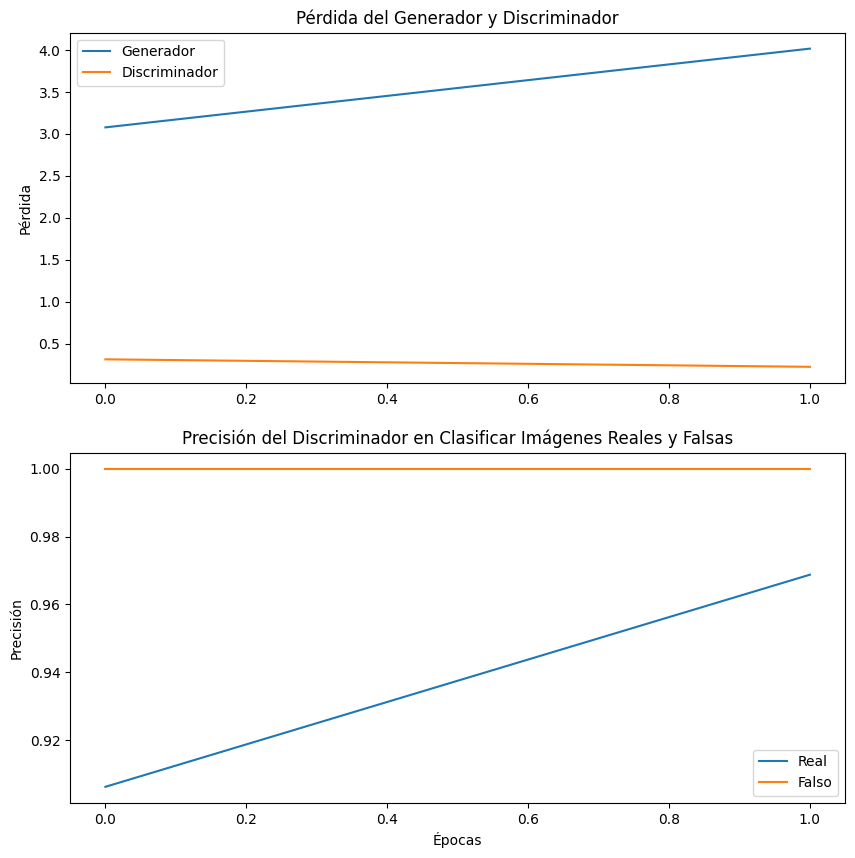

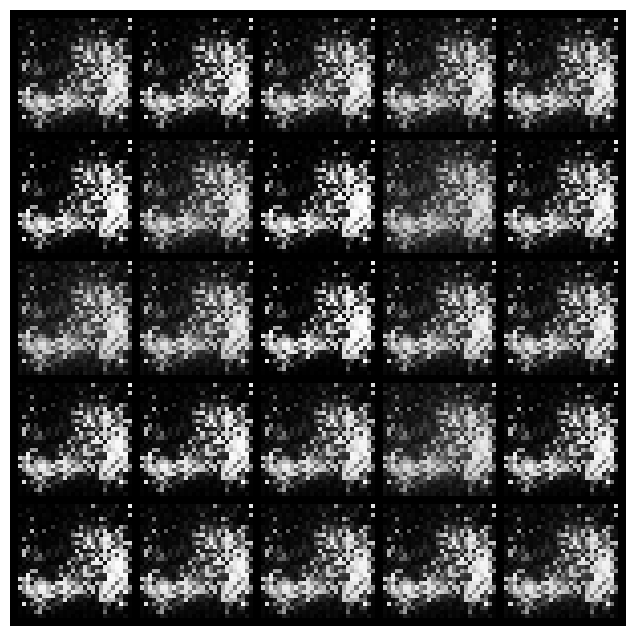

Discriminator Accuracy: 0.2814, Generator Accuracy: 0.35956666666666665
Epoch 3/30 completed


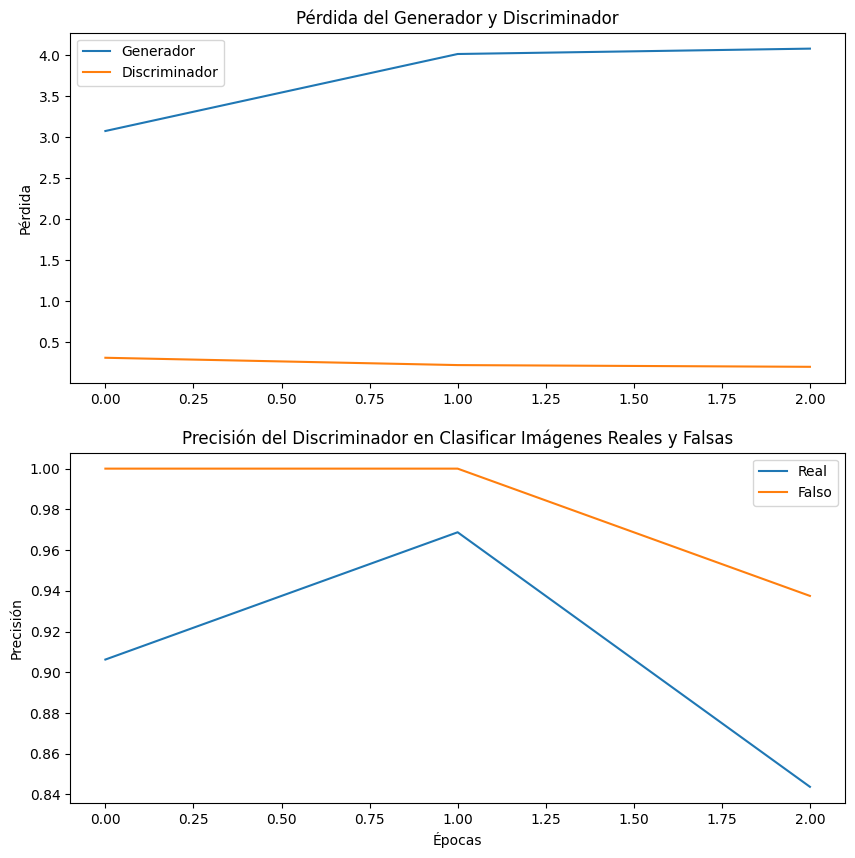

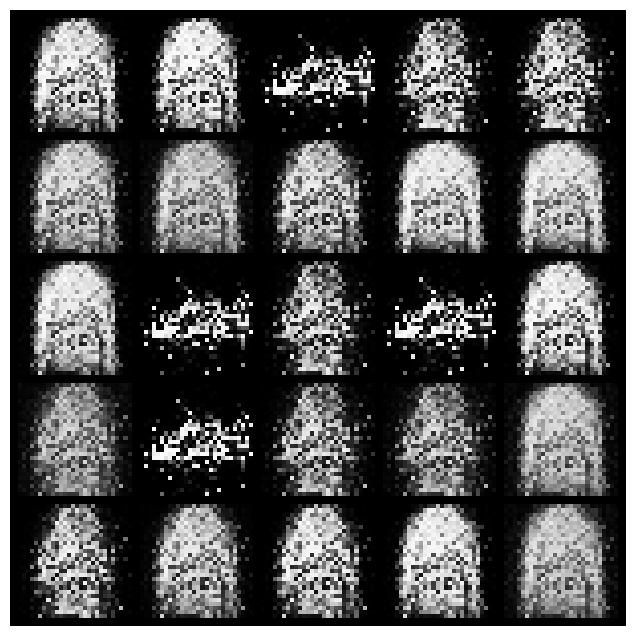

Discriminator Accuracy: 0.2814, Generator Accuracy: 0.35956666666666665
Epoch 4/30 completed


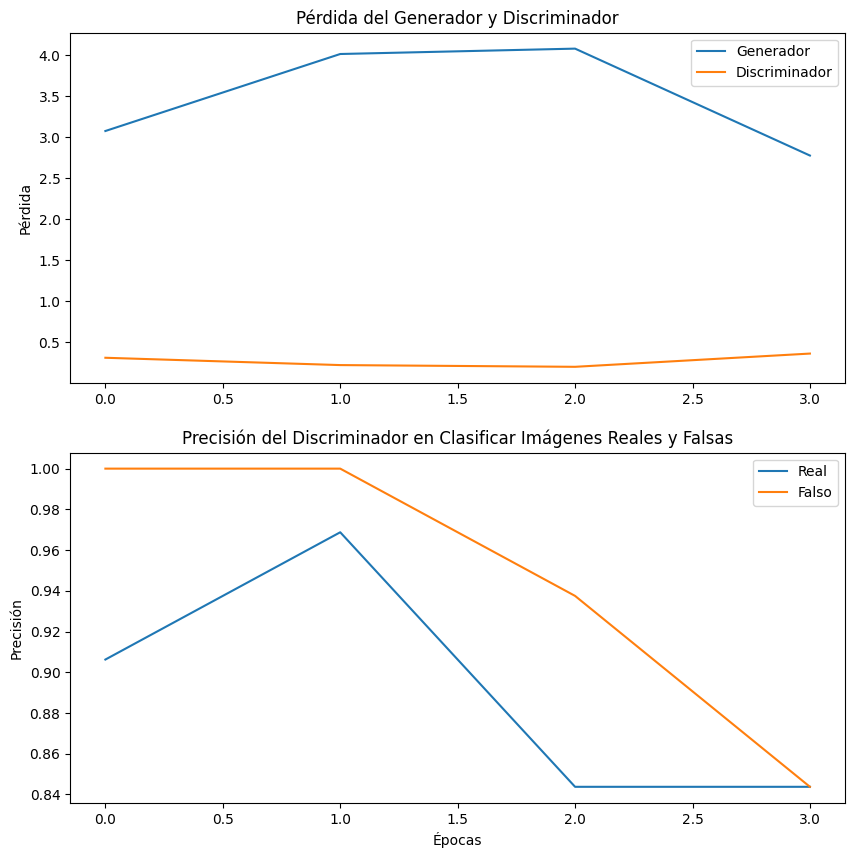

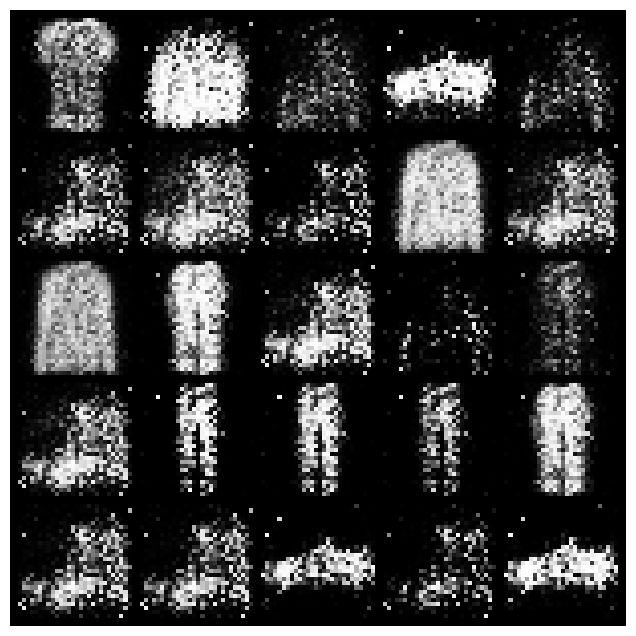

Discriminator Accuracy: 0.2814, Generator Accuracy: 0.35956666666666665
Epoch 5/30 completed


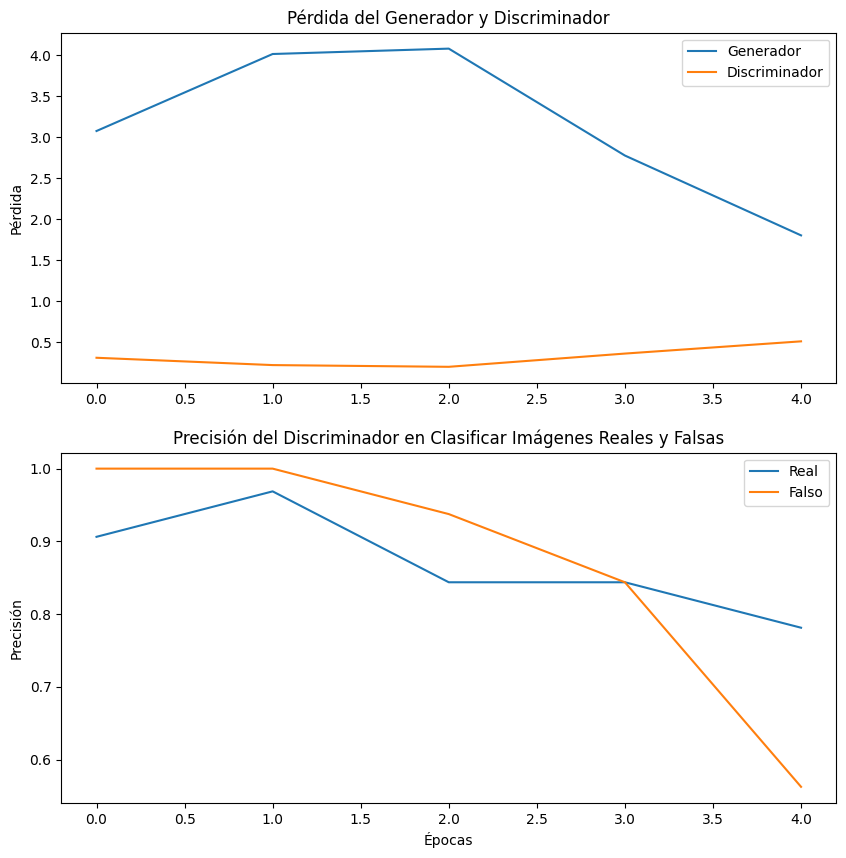

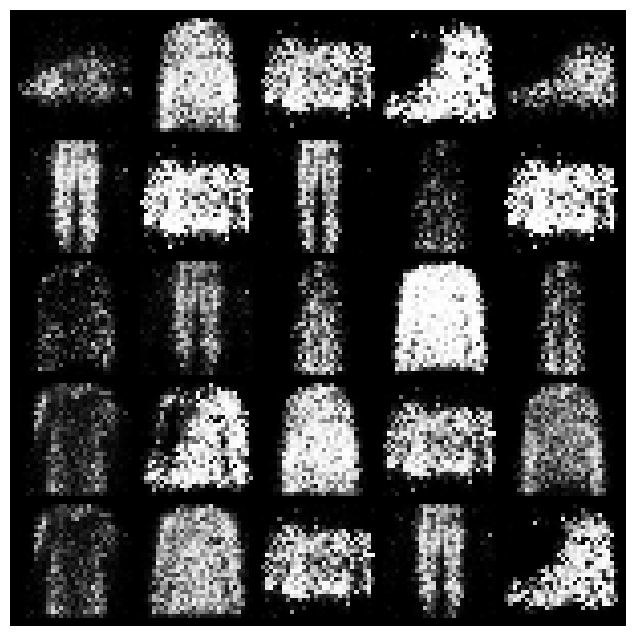

Discriminator Accuracy: 0.2814, Generator Accuracy: 0.35956666666666665
Epoch 6/30 completed


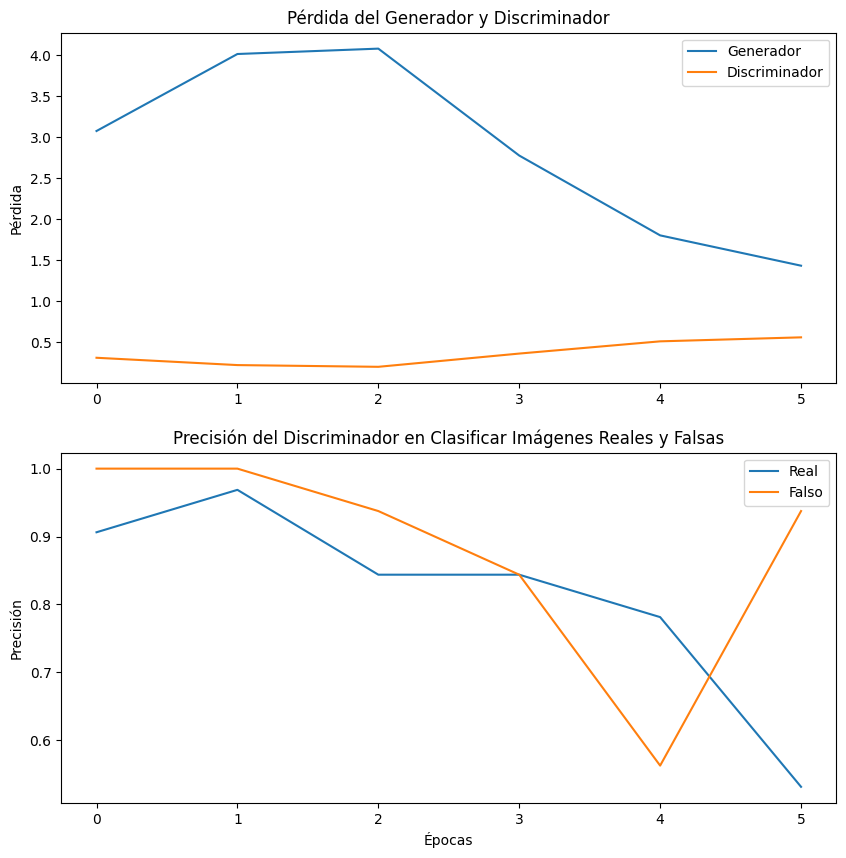

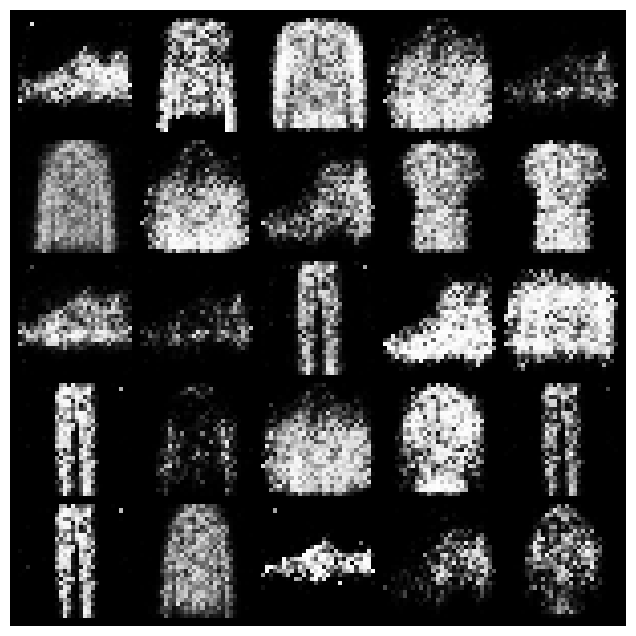

Discriminator Accuracy: 0.2814, Generator Accuracy: 0.35956666666666665
Epoch 7/30 completed


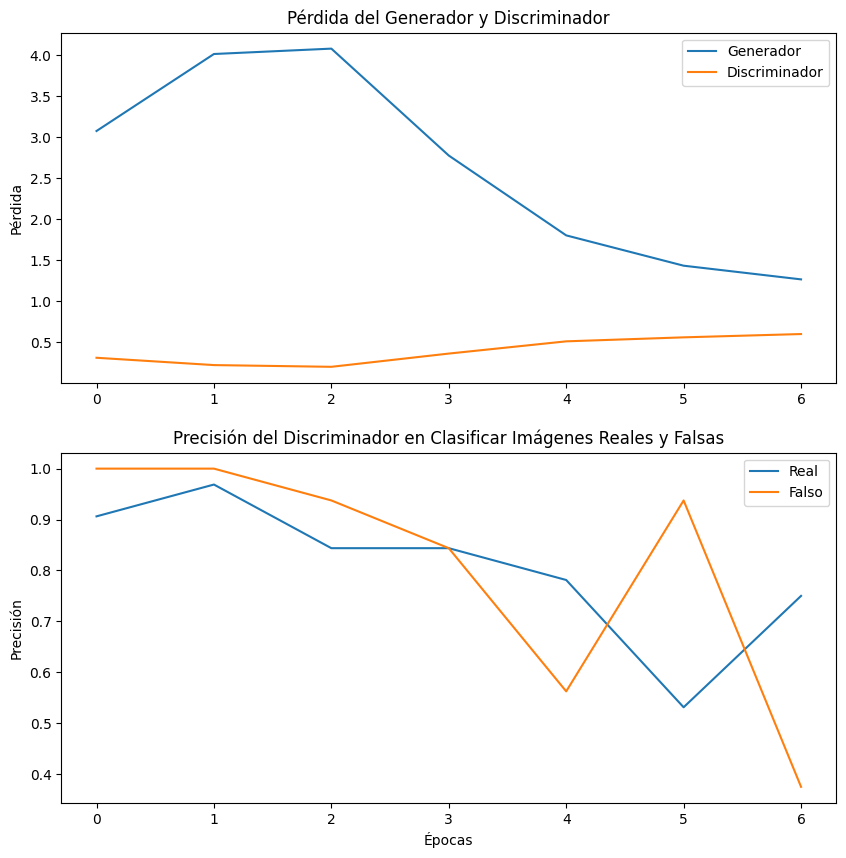

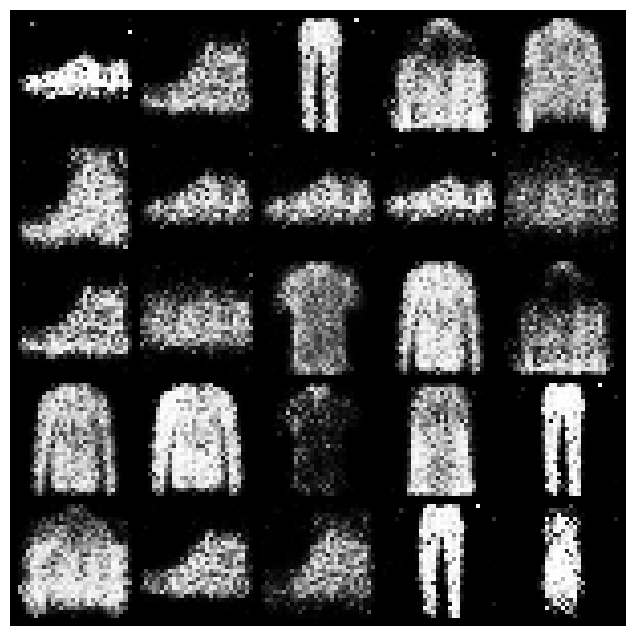

Discriminator Accuracy: 0.2814, Generator Accuracy: 0.35956666666666665
Epoch 8/30 completed


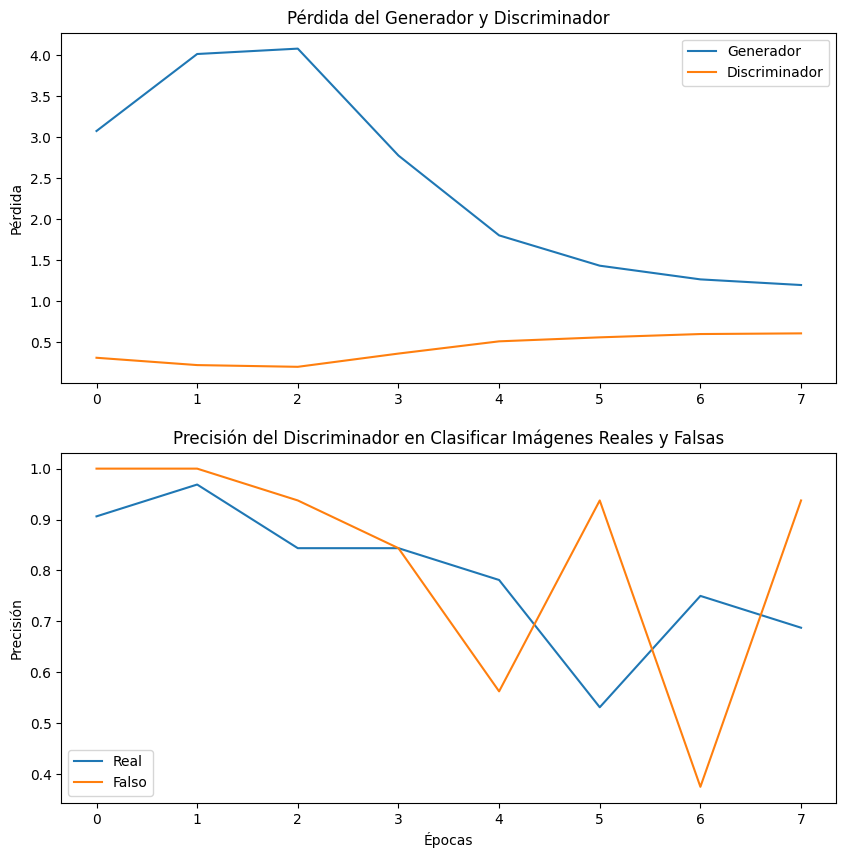

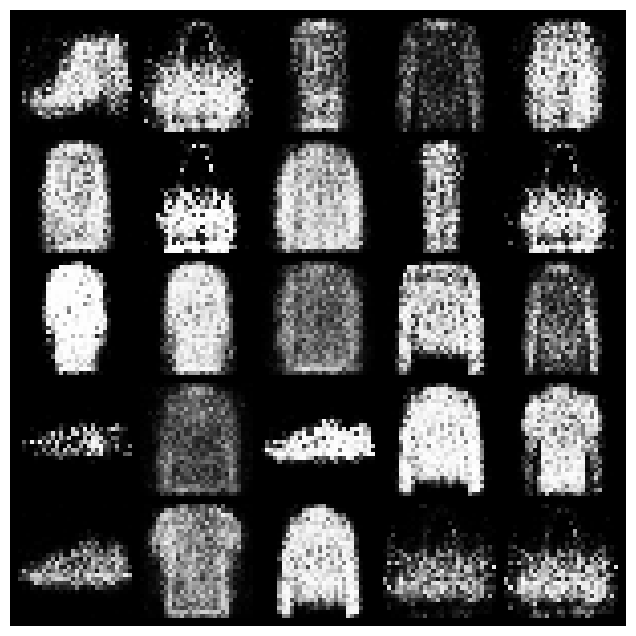

Discriminator Accuracy: 0.2814, Generator Accuracy: 0.35956666666666665
Epoch 9/30 completed


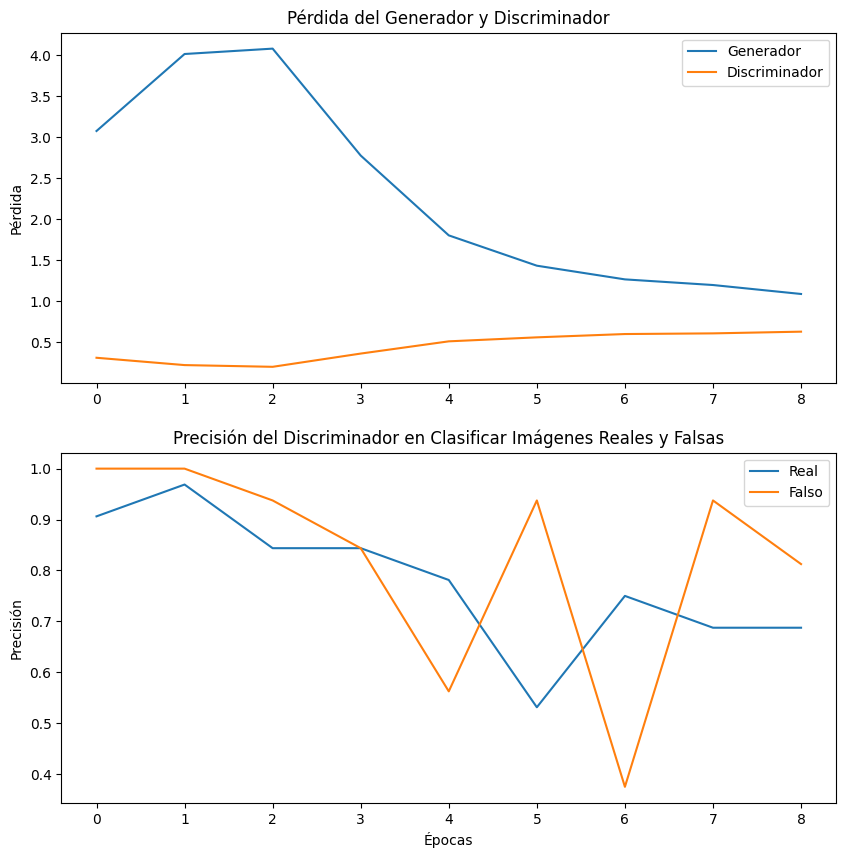

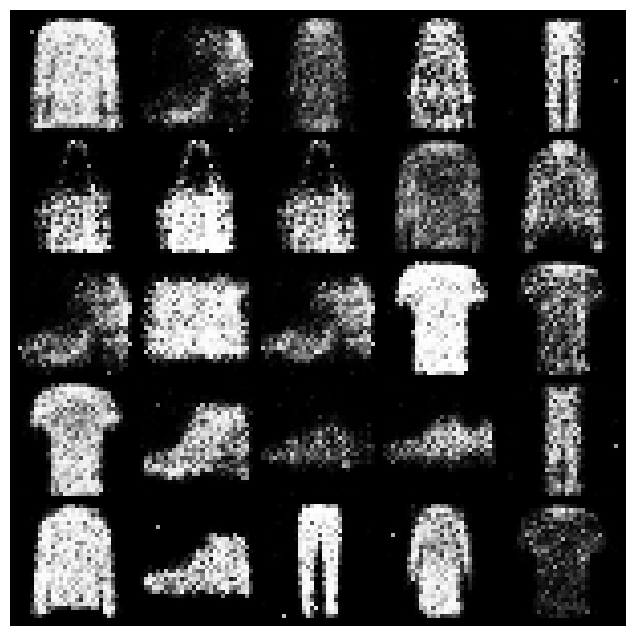

Discriminator Accuracy: 0.2814, Generator Accuracy: 0.35956666666666665
Epoch 10/30 completed


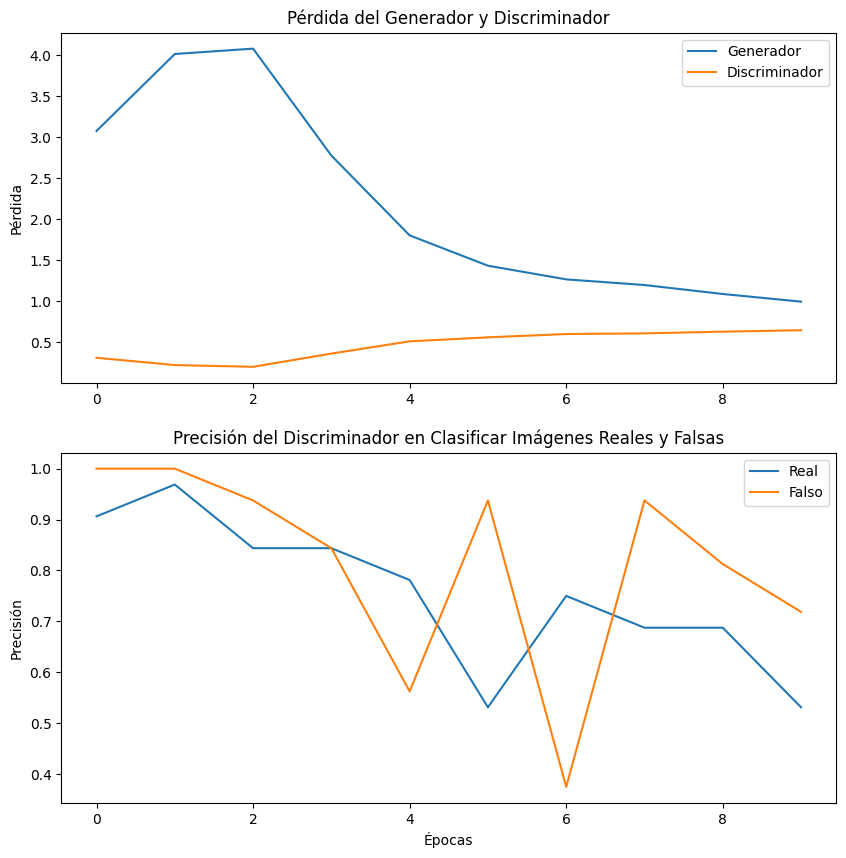

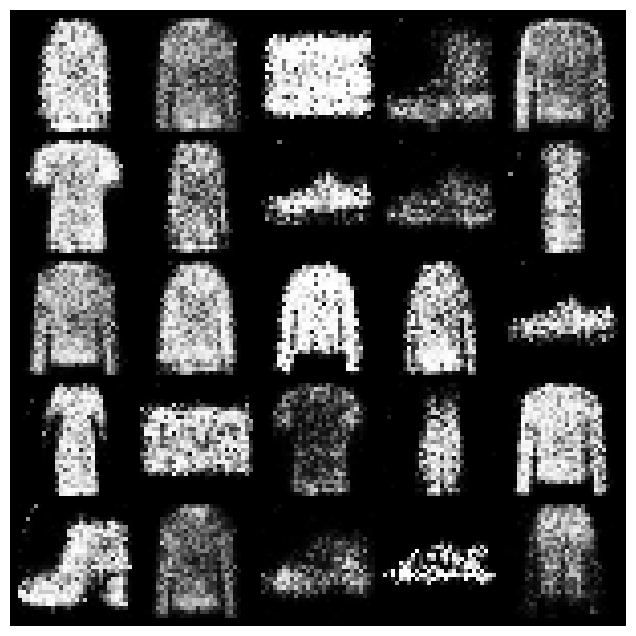

Discriminator Accuracy: 0.2814, Generator Accuracy: 0.35956666666666665
Epoch 11/30 completed


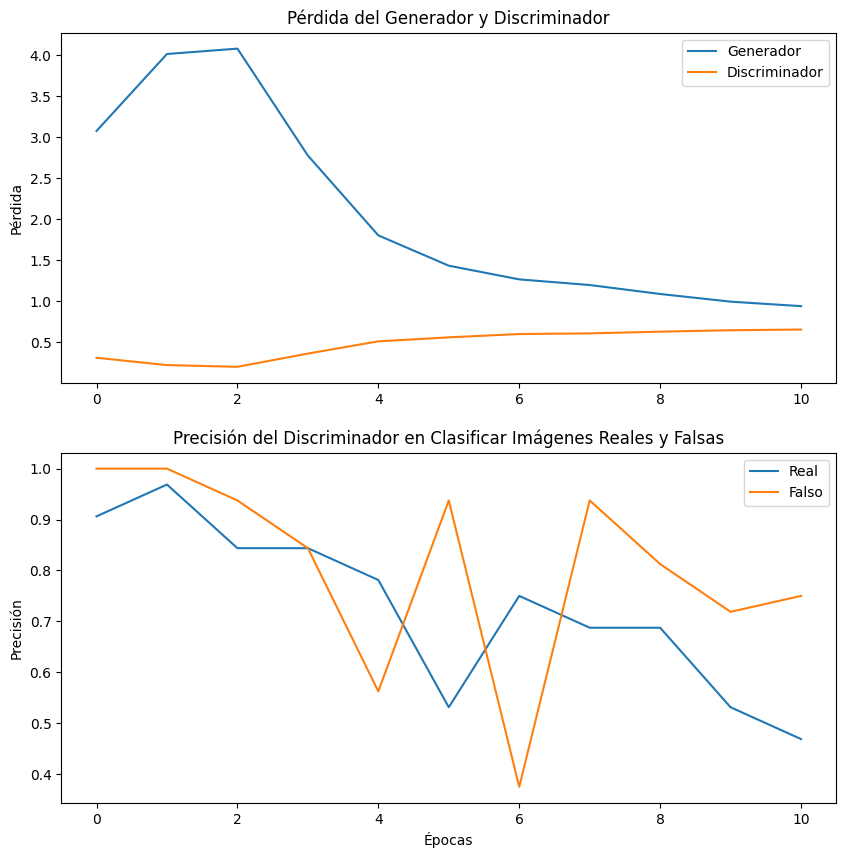

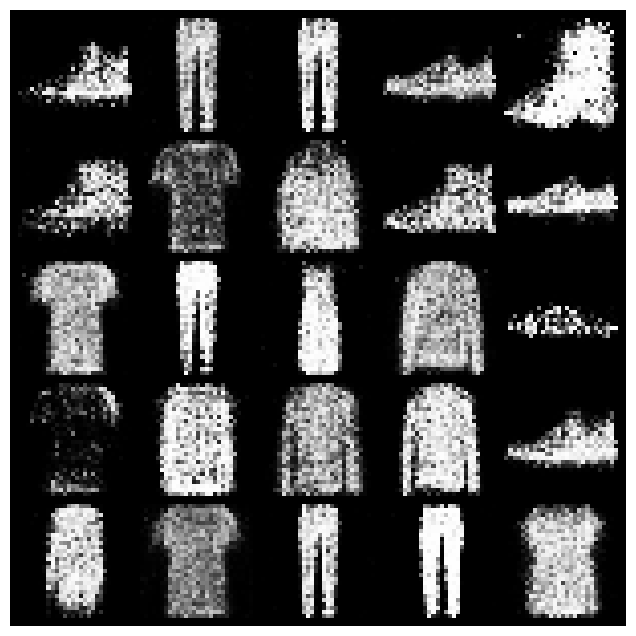

Discriminator Accuracy: 0.2814, Generator Accuracy: 0.35956666666666665
Epoch 12/30 completed


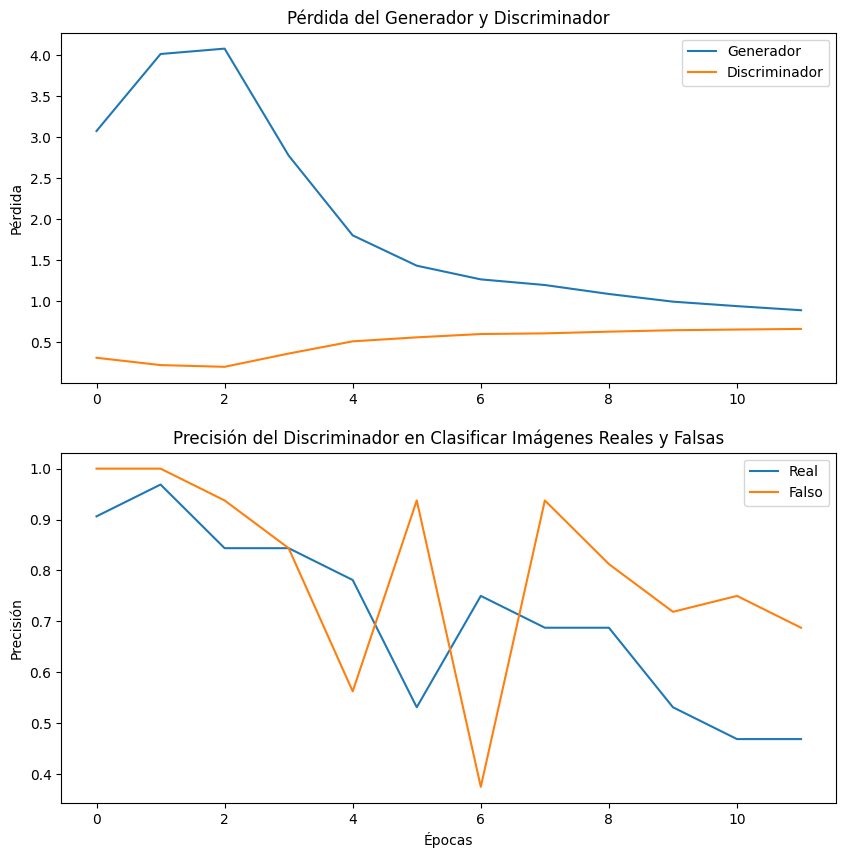

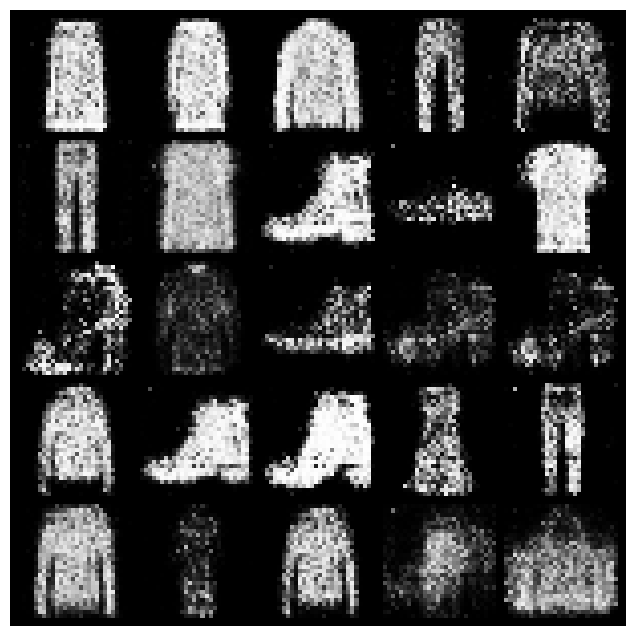

Discriminator Accuracy: 0.2814, Generator Accuracy: 0.35956666666666665
Epoch 13/30 completed


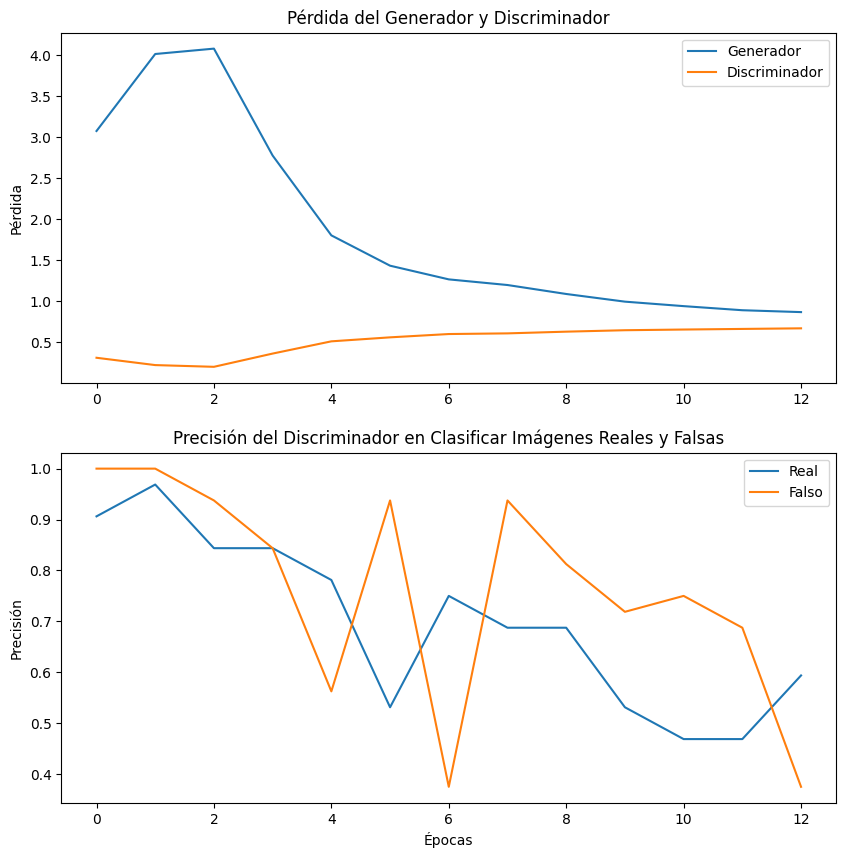

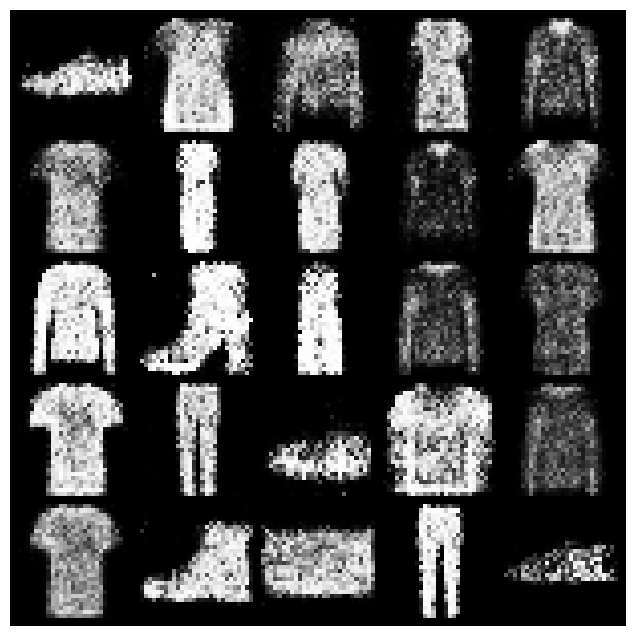

Discriminator Accuracy: 0.2814, Generator Accuracy: 0.35956666666666665
Epoch 14/30 completed


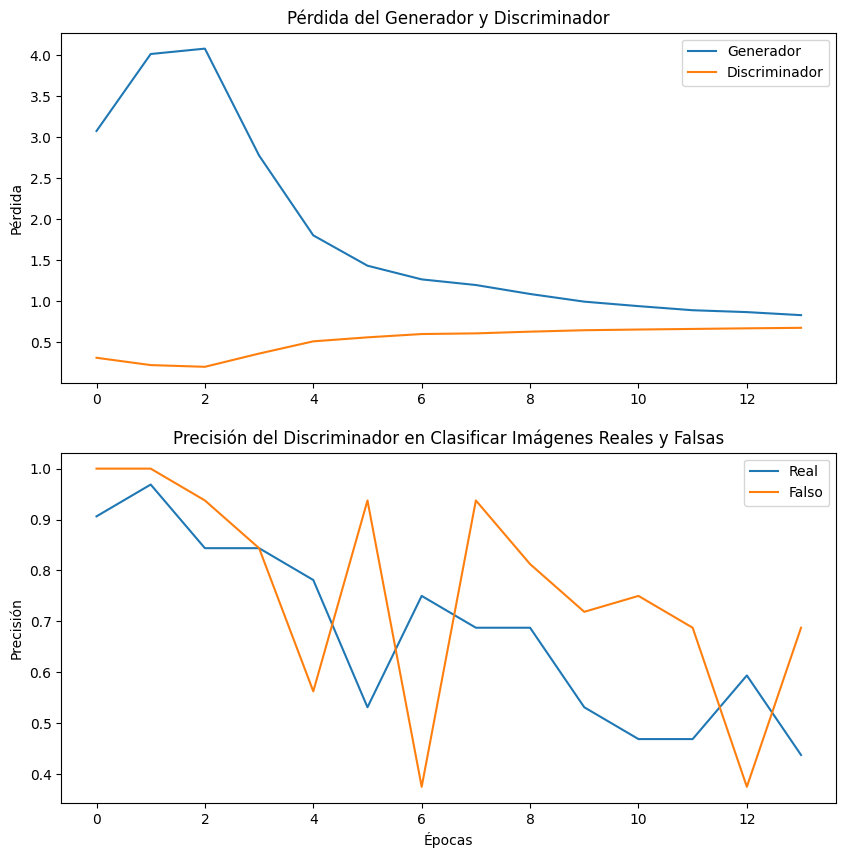

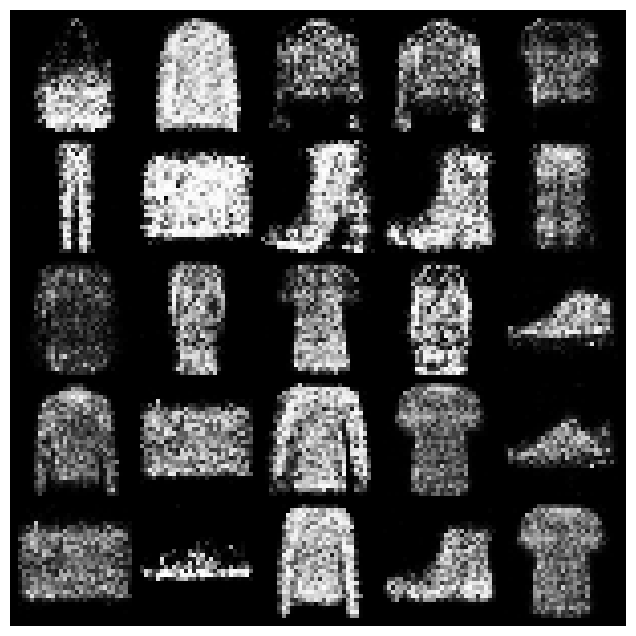

Discriminator Accuracy: 0.2814, Generator Accuracy: 0.35956666666666665
Epoch 15/30 completed


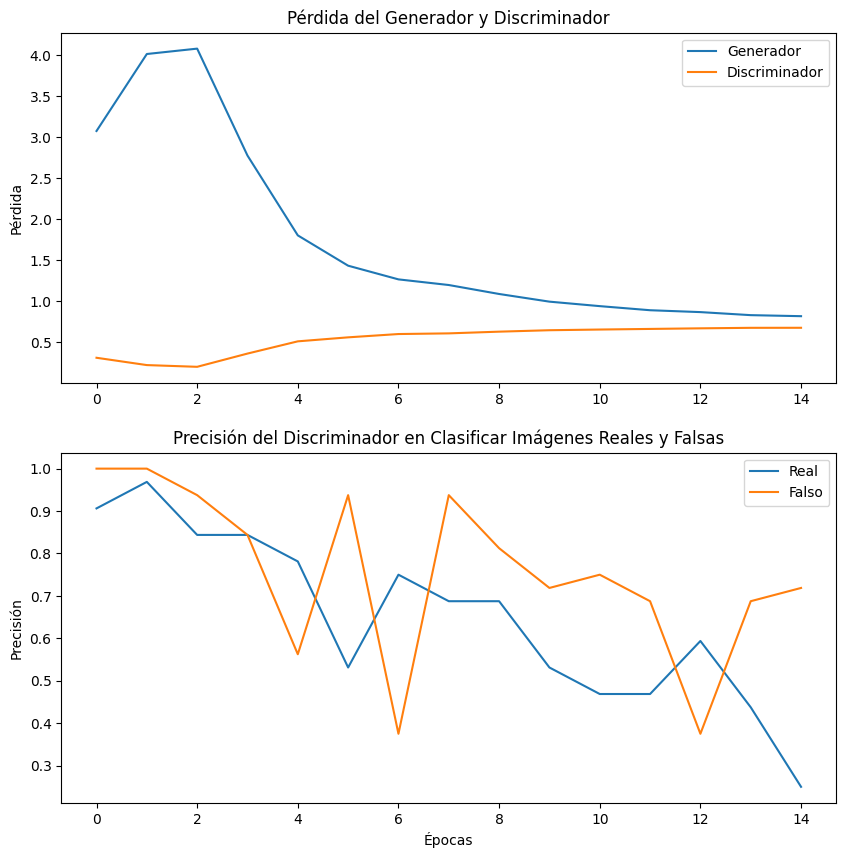

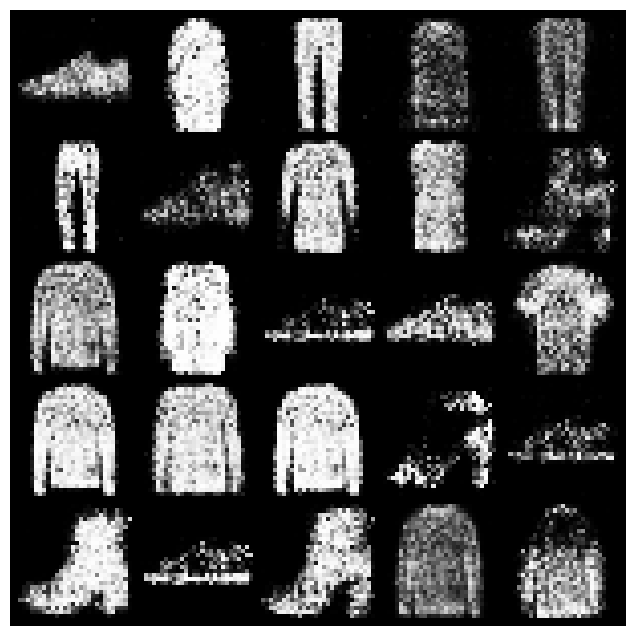

Discriminator Accuracy: 0.2814, Generator Accuracy: 0.35956666666666665
Epoch 16/30 completed


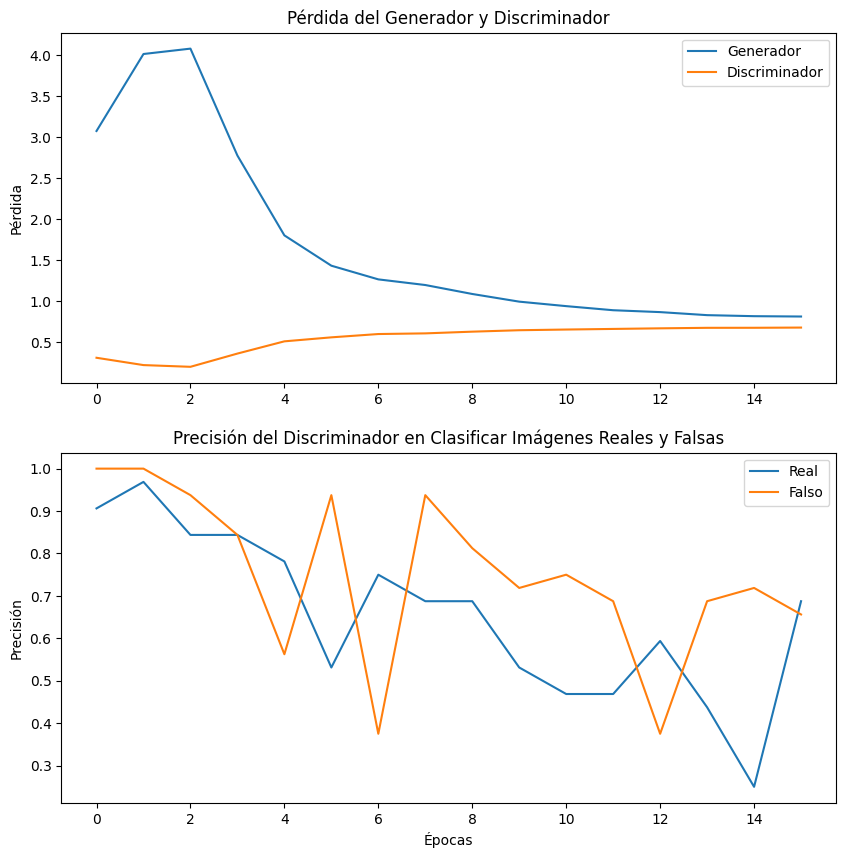

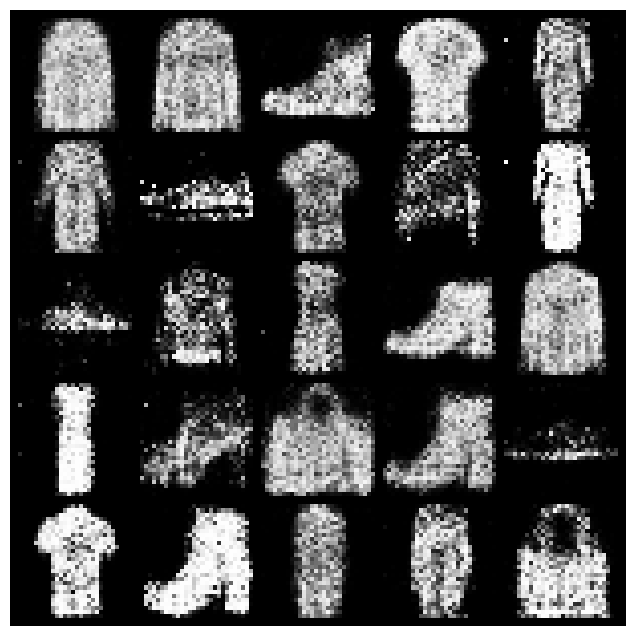

Discriminator Accuracy: 0.2814, Generator Accuracy: 0.35956666666666665
Epoch 17/30 completed


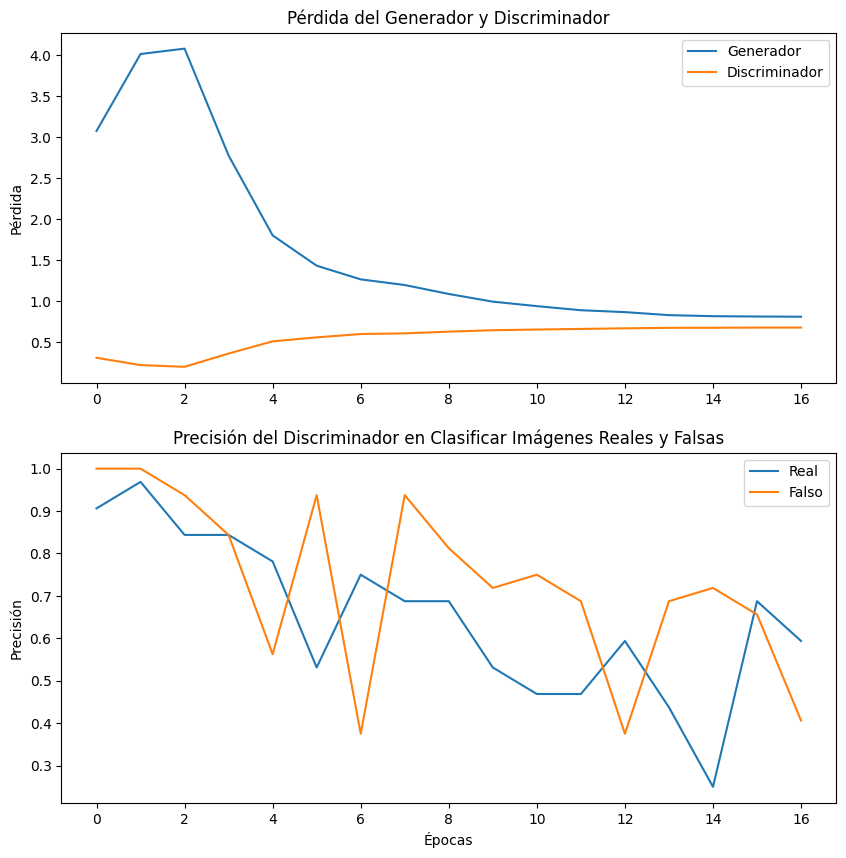

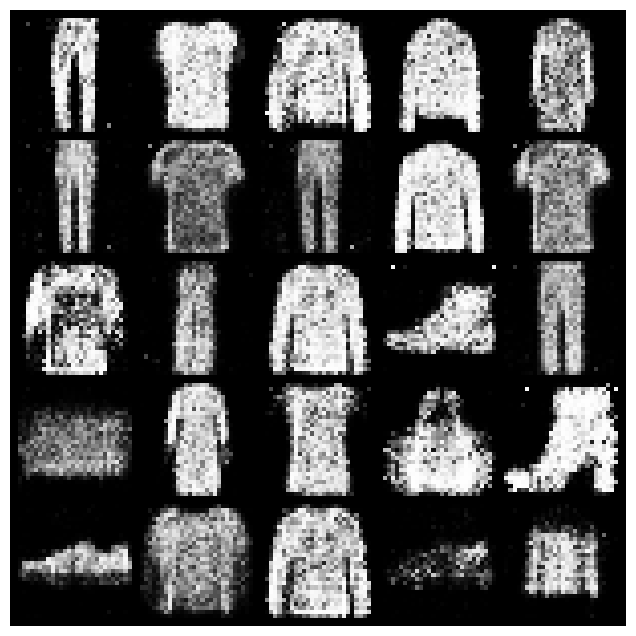

Discriminator Accuracy: 0.2814, Generator Accuracy: 0.35956666666666665
Epoch 18/30 completed


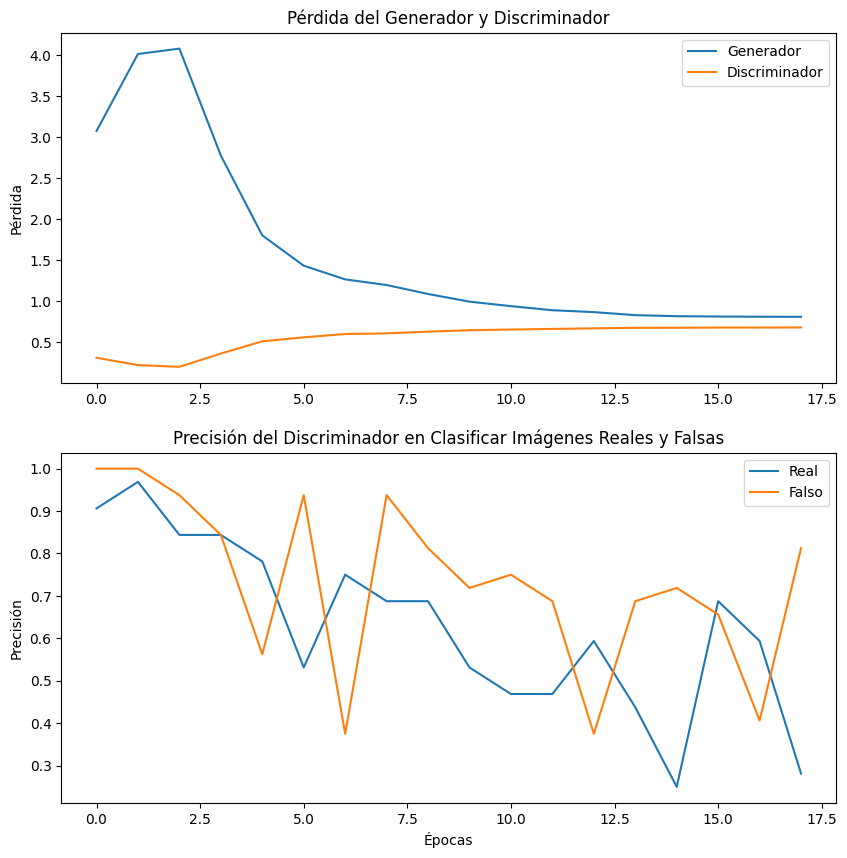

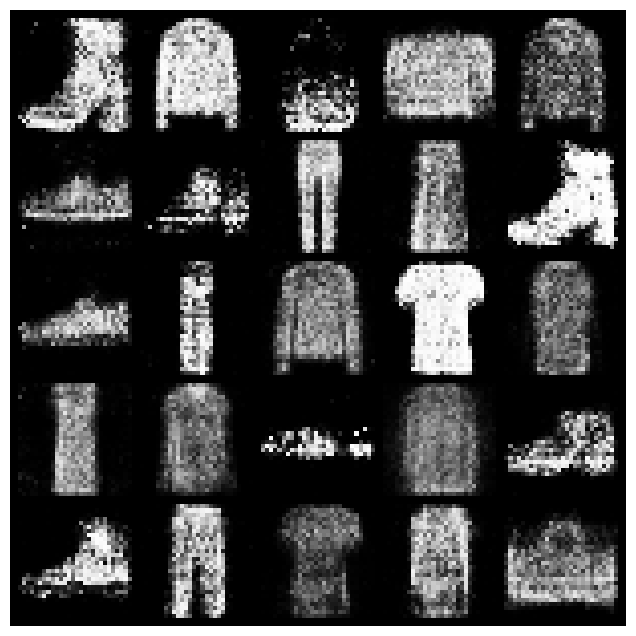

Discriminator Accuracy: 0.2814, Generator Accuracy: 0.35956666666666665
Epoch 19/30 completed


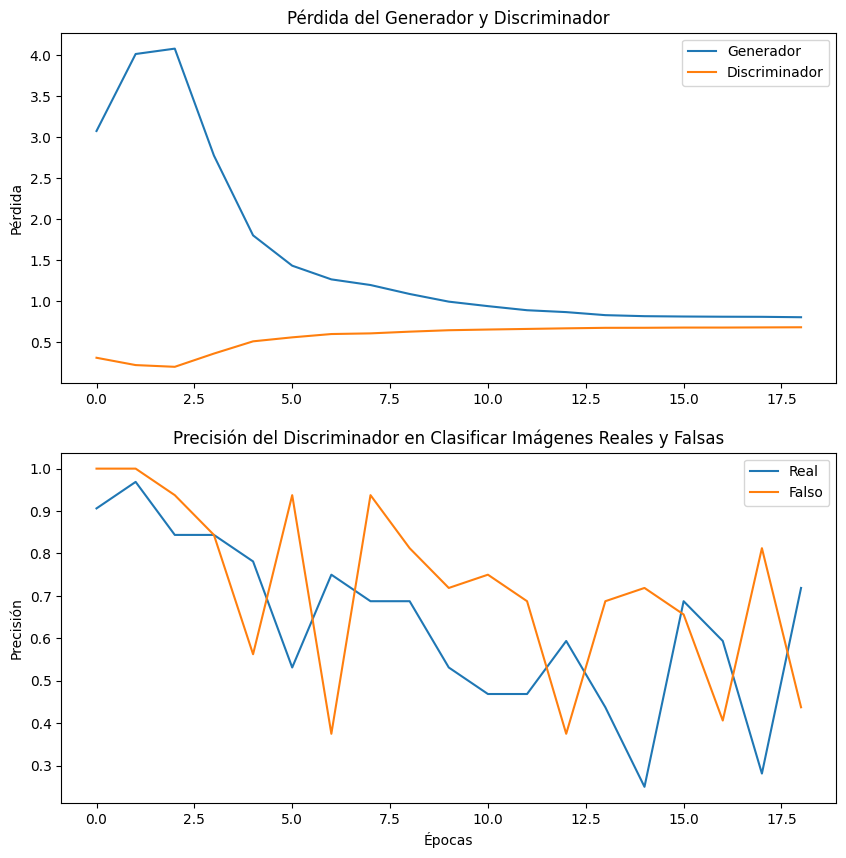

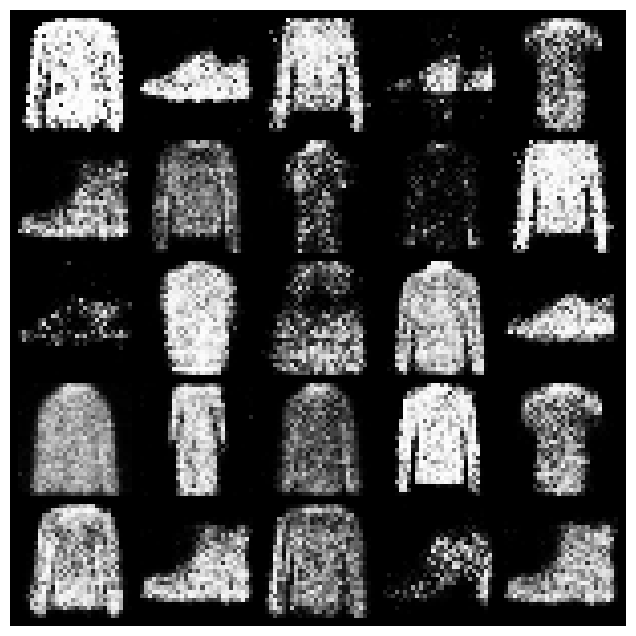

Discriminator Accuracy: 0.2814, Generator Accuracy: 0.35956666666666665
Epoch 20/30 completed


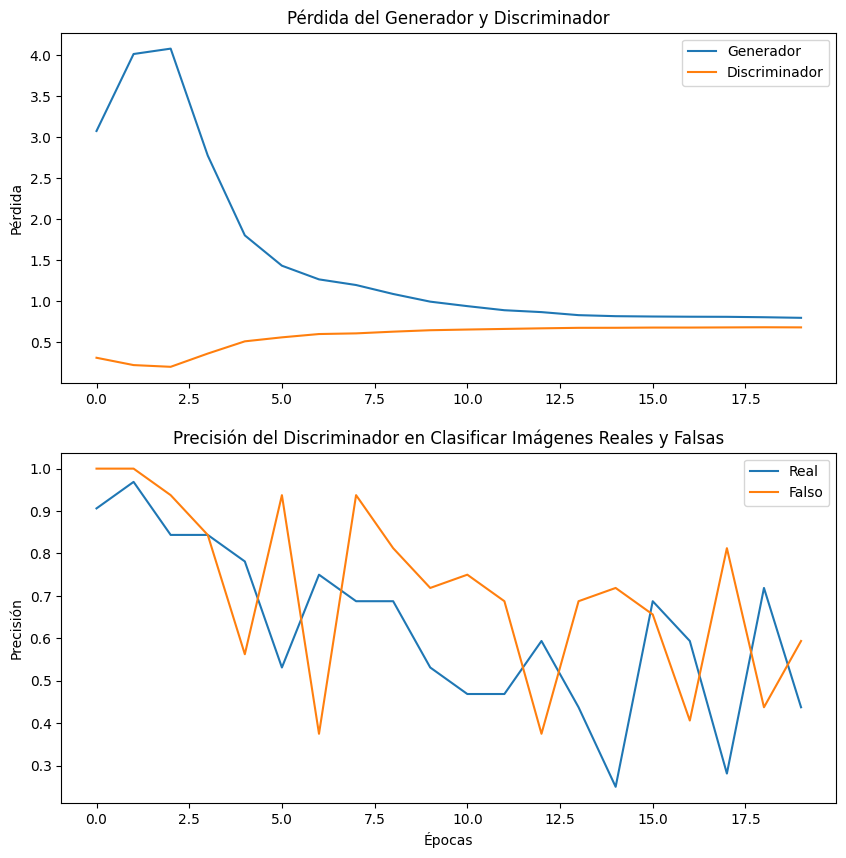

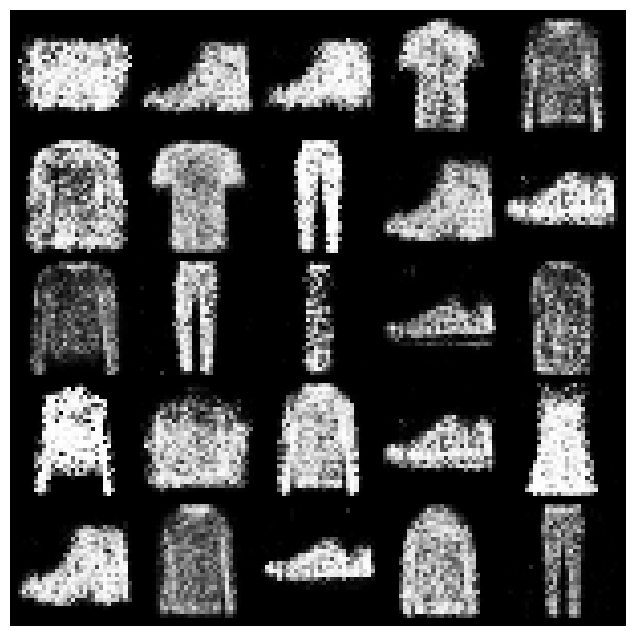

Discriminator Accuracy: 0.2814, Generator Accuracy: 0.35956666666666665
Epoch 21/30 completed


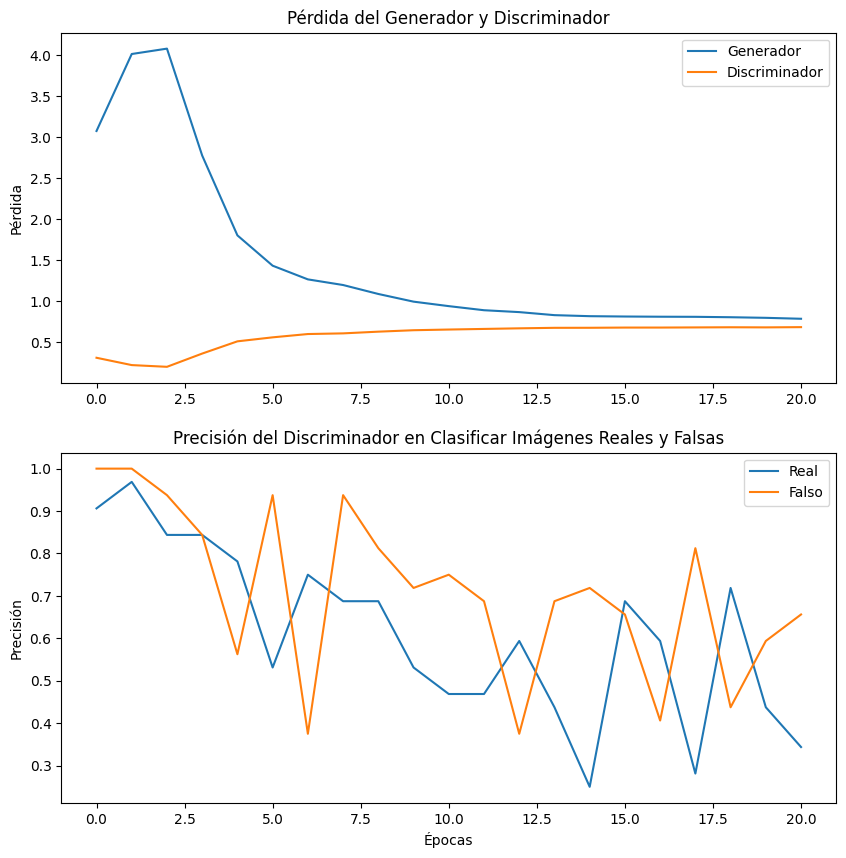

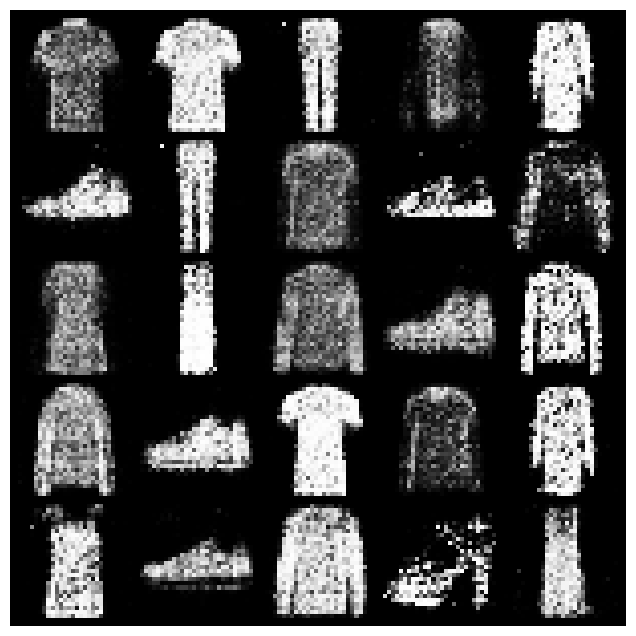

Discriminator Accuracy: 0.2814, Generator Accuracy: 0.35956666666666665
Epoch 22/30 completed


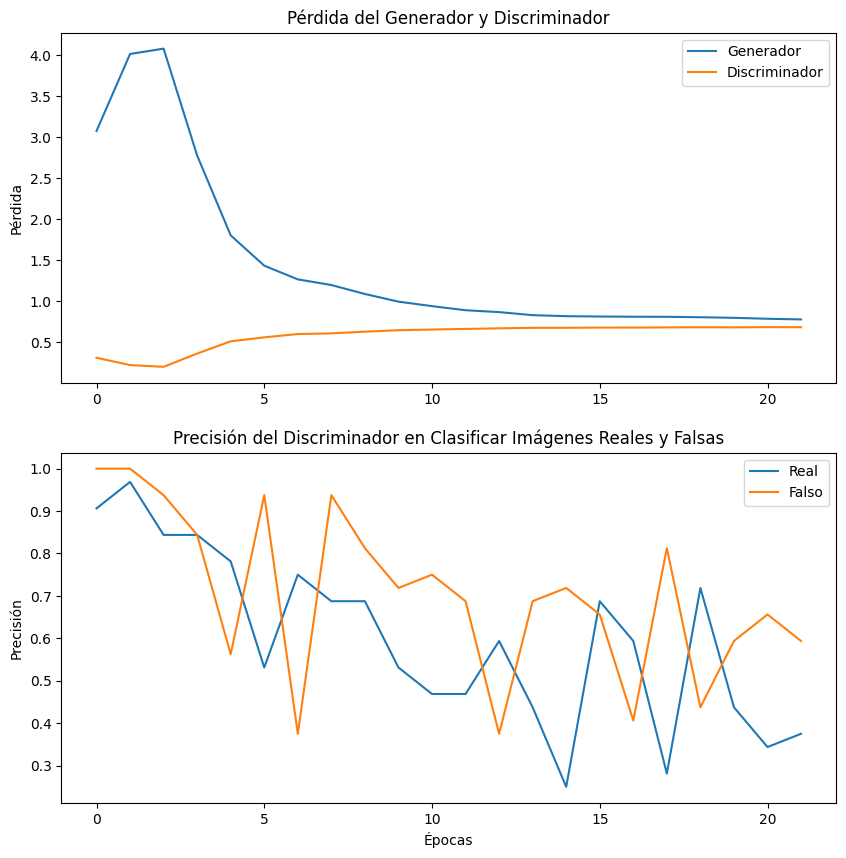

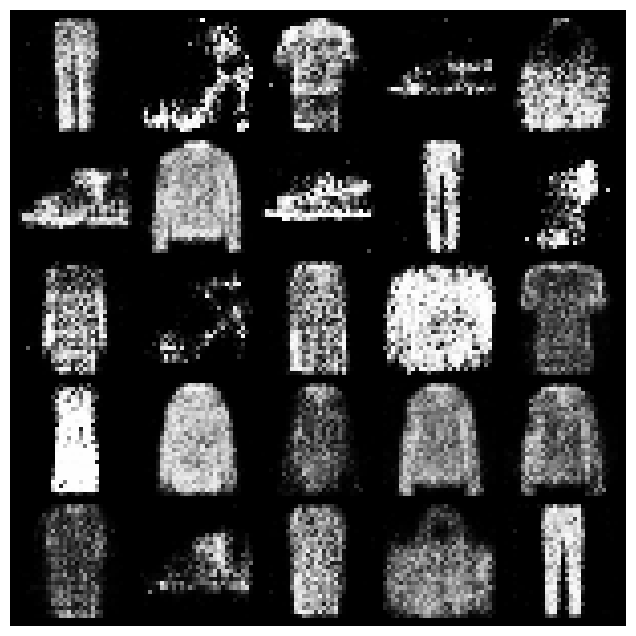

Discriminator Accuracy: 0.2814, Generator Accuracy: 0.35956666666666665
Epoch 23/30 completed


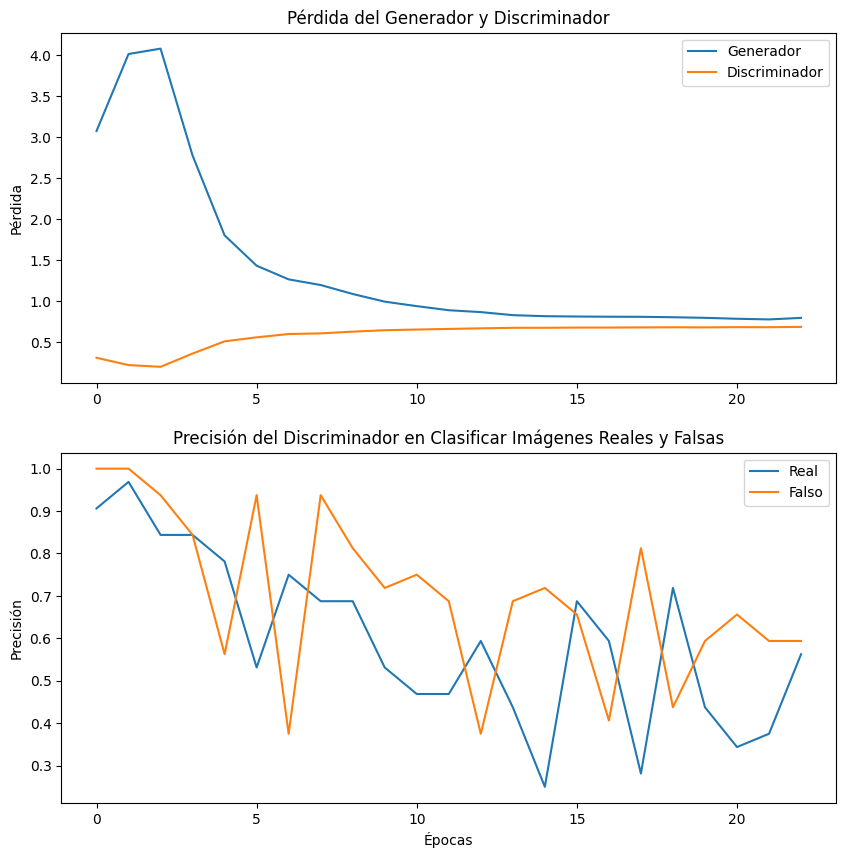

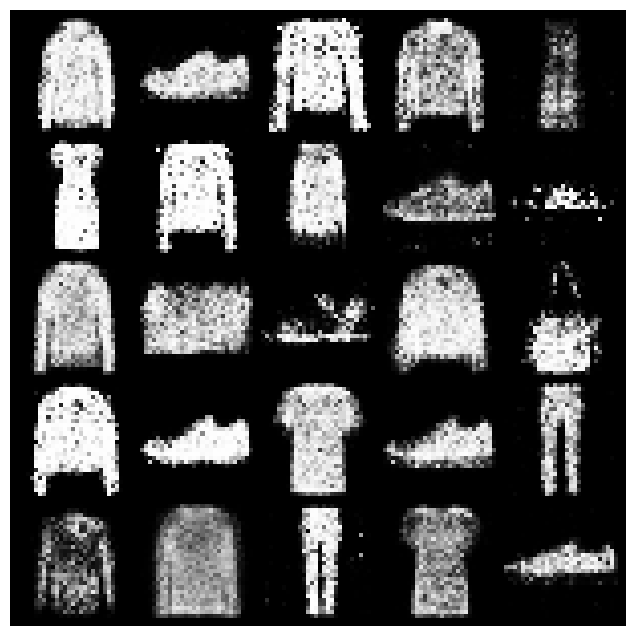

Discriminator Accuracy: 0.2814, Generator Accuracy: 0.35956666666666665
Epoch 24/30 completed


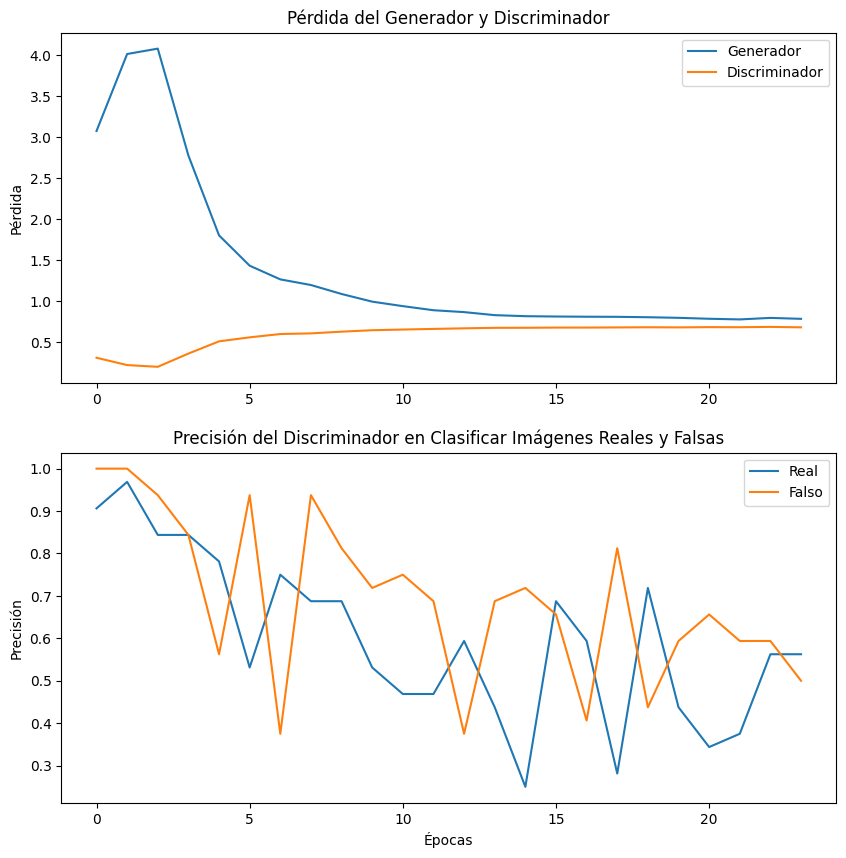

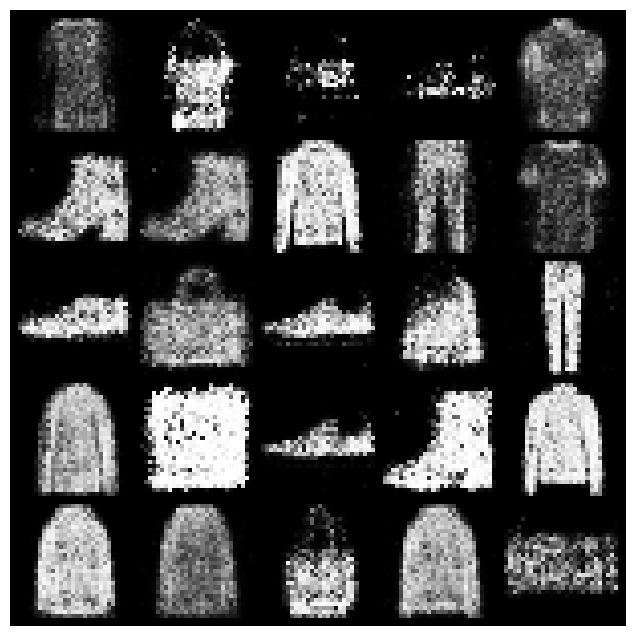

Discriminator Accuracy: 0.2814, Generator Accuracy: 0.35956666666666665
Epoch 25/30 completed


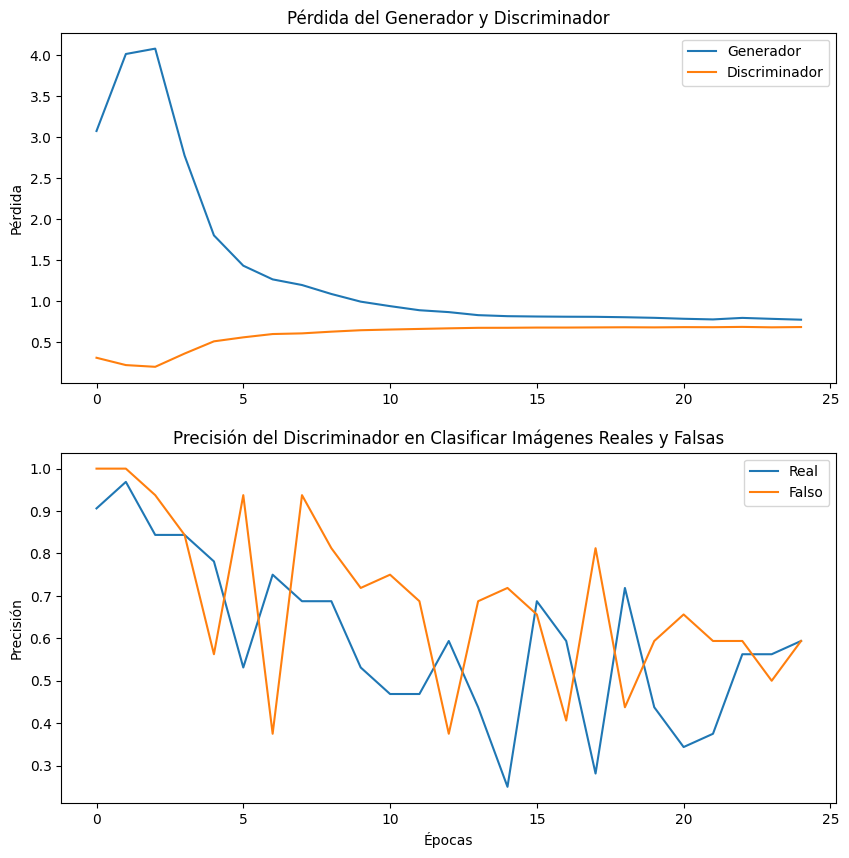

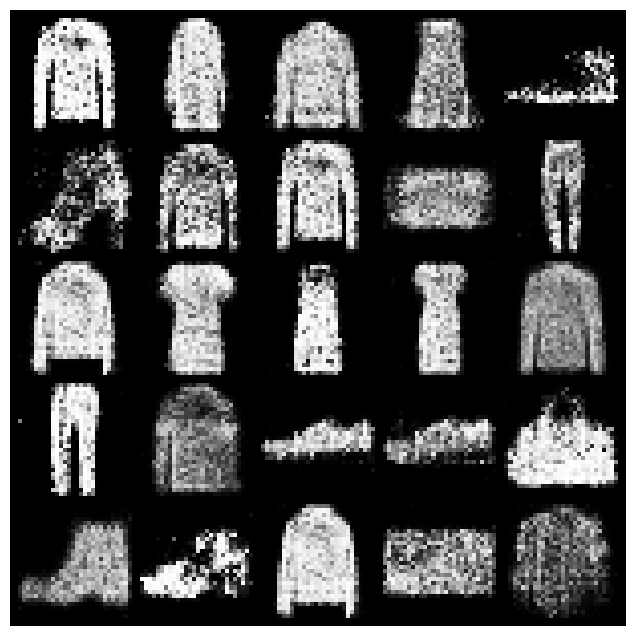

Discriminator Accuracy: 0.2814, Generator Accuracy: 0.35956666666666665
Epoch 26/30 completed


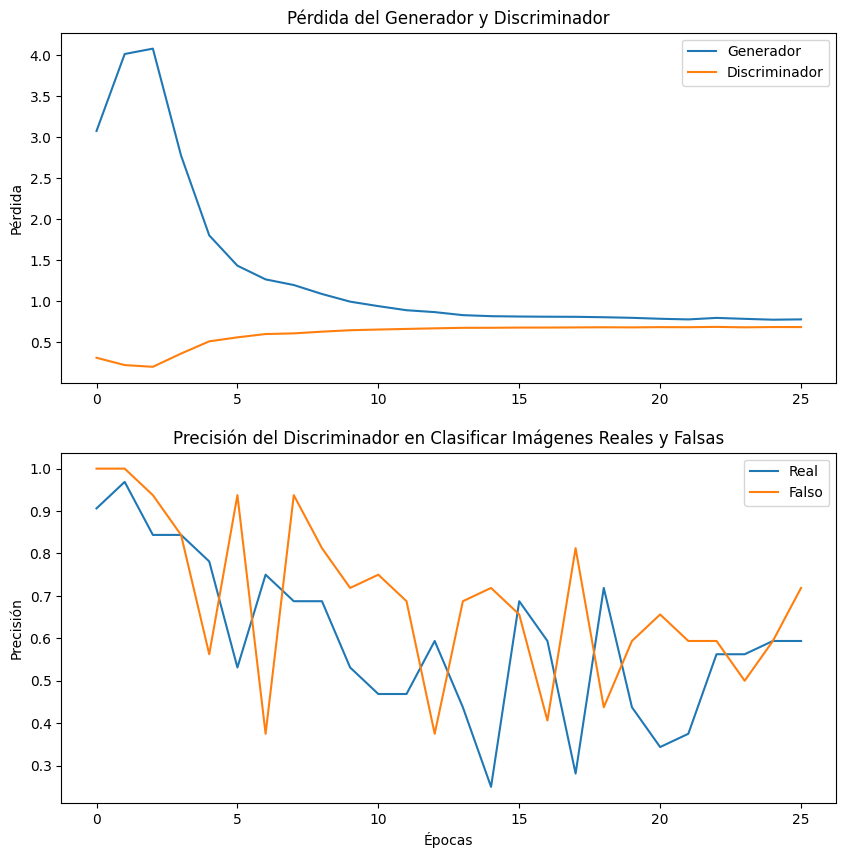

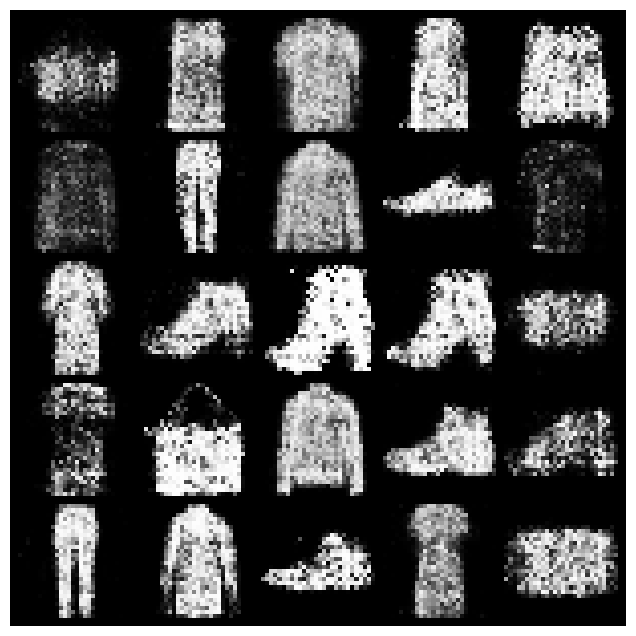

Discriminator Accuracy: 0.2814, Generator Accuracy: 0.35956666666666665
Epoch 27/30 completed


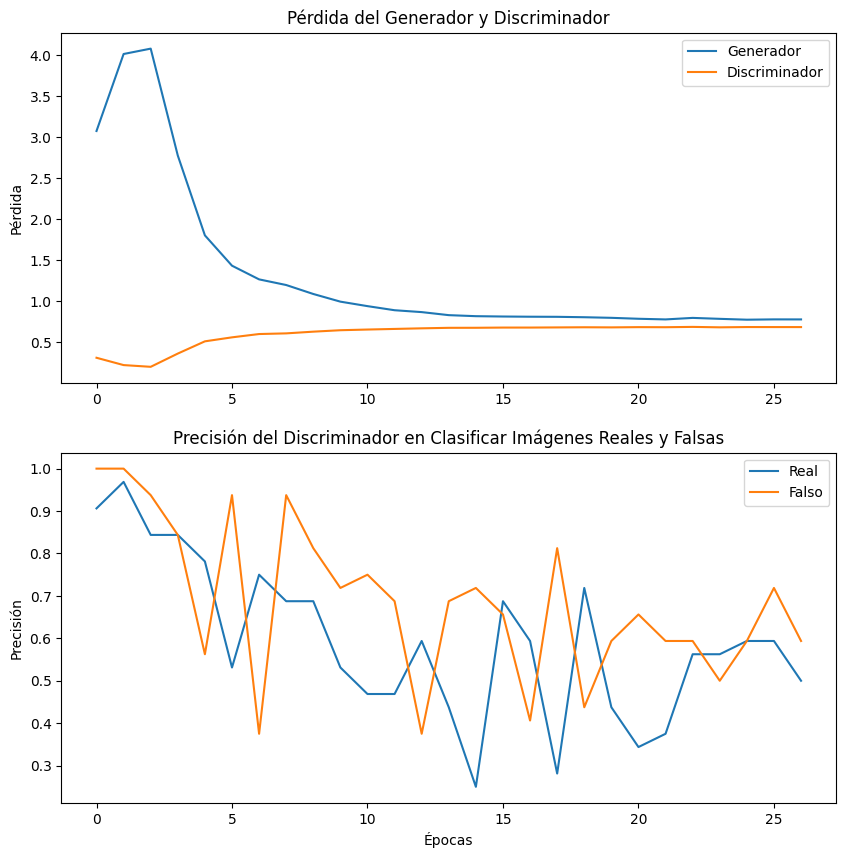

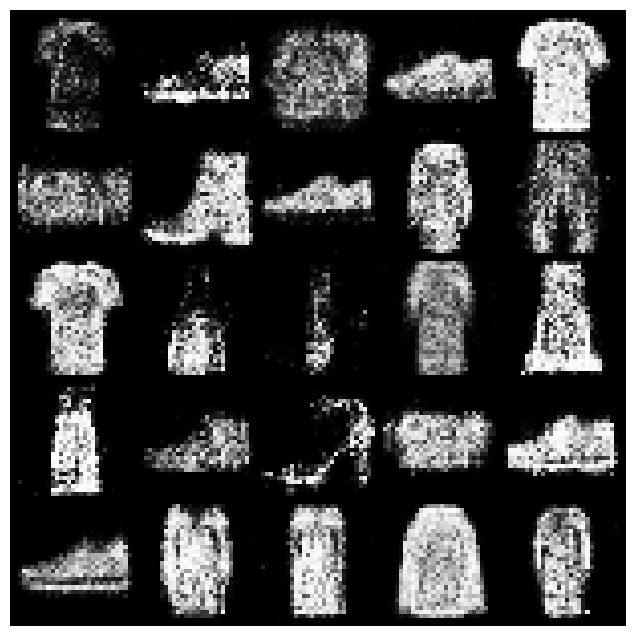

Discriminator Accuracy: 0.2814, Generator Accuracy: 0.35956666666666665
Epoch 28/30 completed


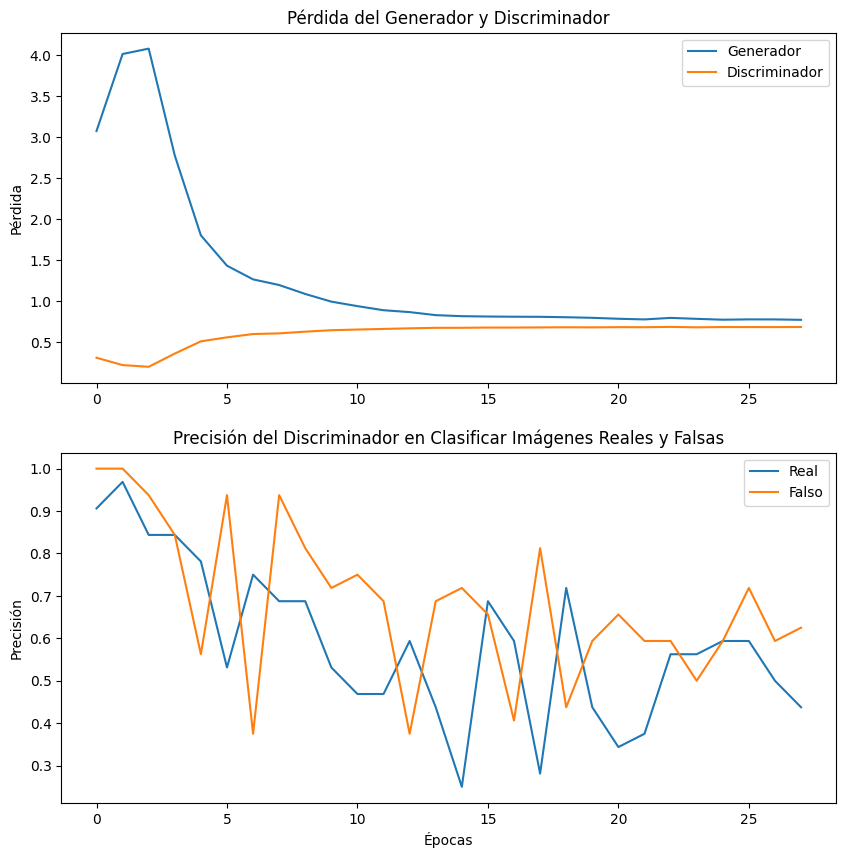

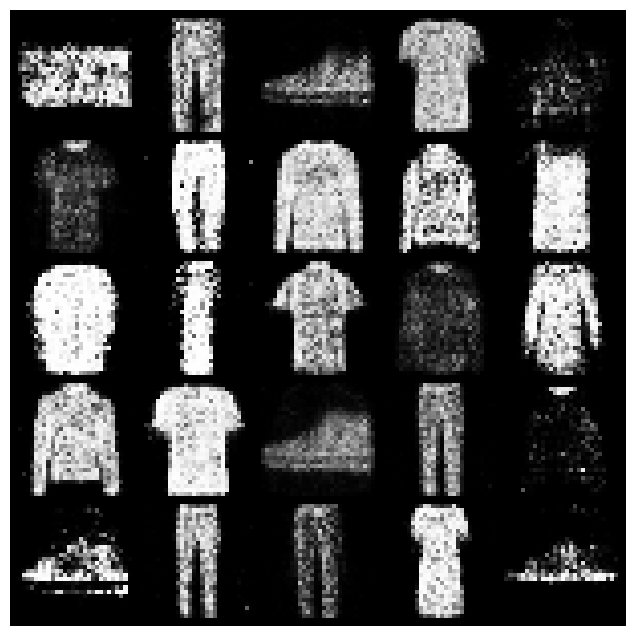

Discriminator Accuracy: 0.2814, Generator Accuracy: 0.35956666666666665
Epoch 29/30 completed


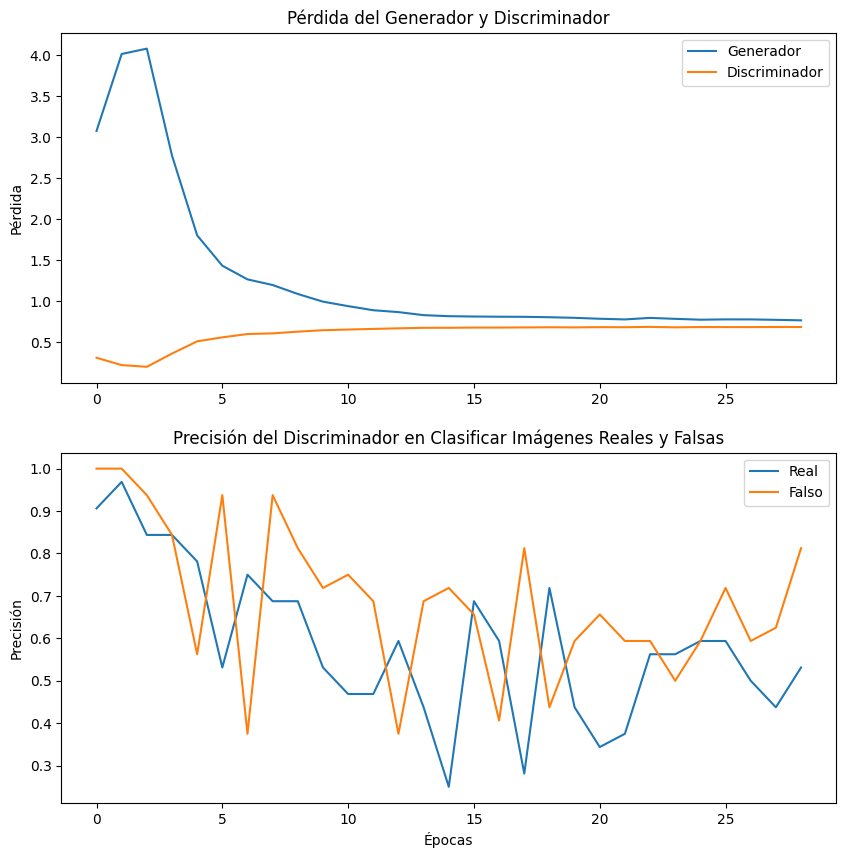

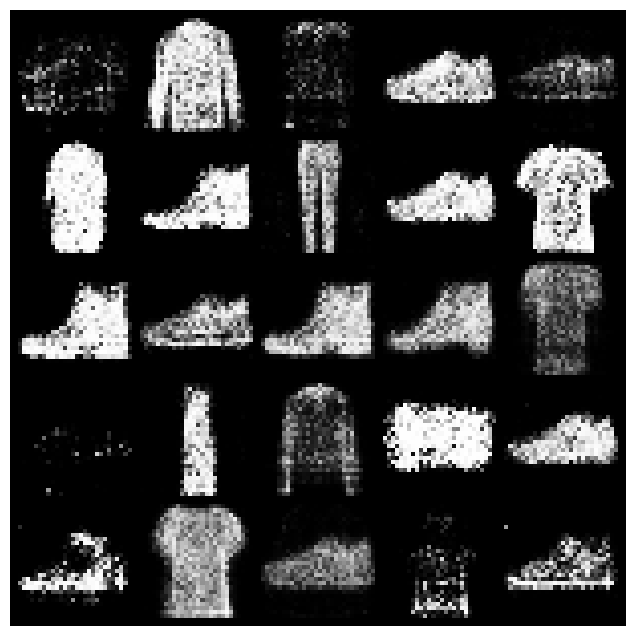

Discriminator Accuracy: 0.2814, Generator Accuracy: 0.35956666666666665
Epoch 30/30 completed


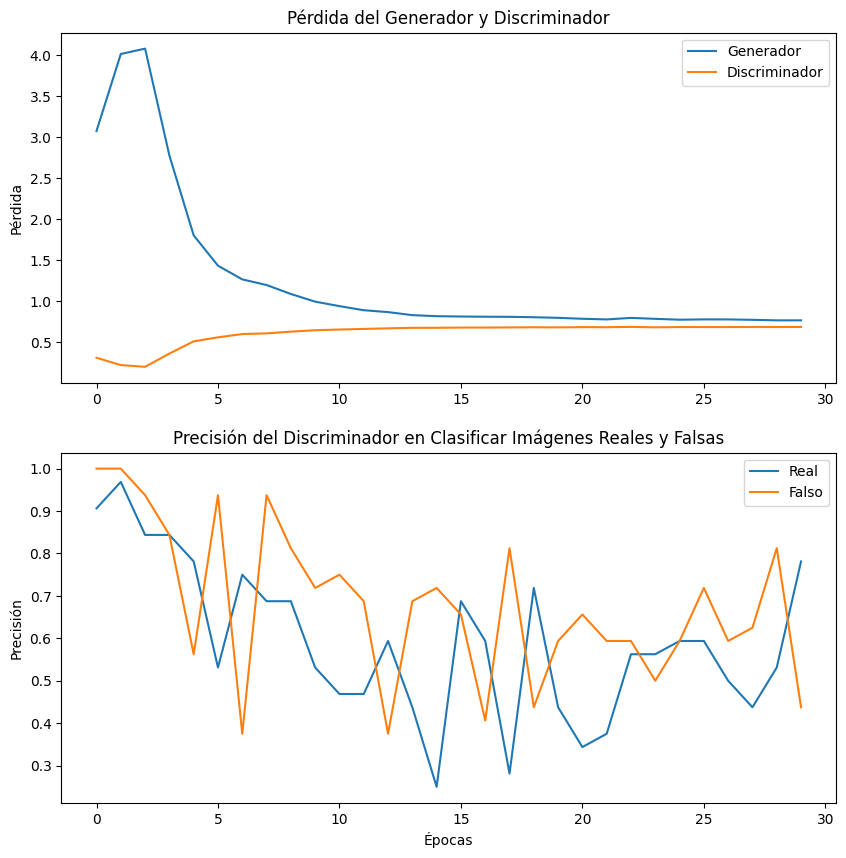

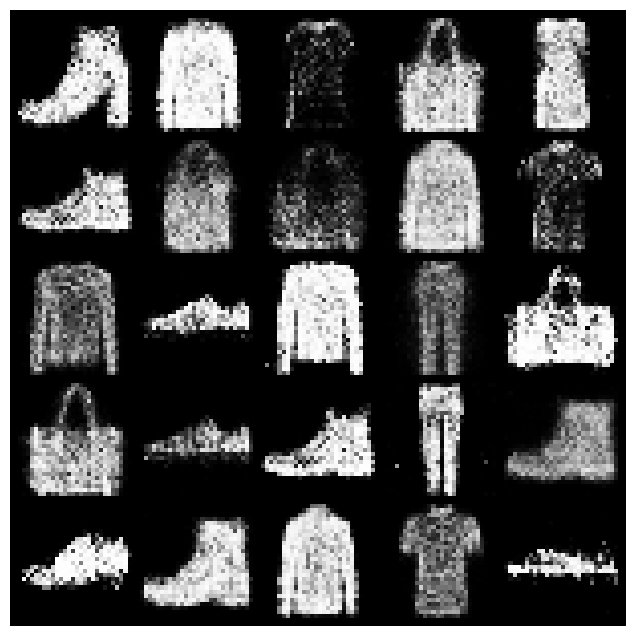

Discriminator Accuracy: 0.2814, Generator Accuracy: 0.35956666666666665
Average Generator Accuracy: 0.35956666666666653
Average Discriminator Accuracy: 0.28139999999999993


In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

generator = GeneratorCGAN().to(device)
discriminator = DiscriminatorCGAN().to(device)

# Optimizadores
optimizer_G = optim.Adam(generator.parameters(), lr=0.0002, betas=(0.5, 0.999))
optimizer_D = optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))

# Función de pérdida
criterion = nn.BCELoss()

# Listas para almacenar pérdidas
G_losses = []
D_losses = []
D_real_accuracy = []
D_fake_accuracy = []
average_G_losses = []
average_D_losses = []
G_accuracies = []
D_accuracies = []


# Número de épocas
num_epochs = 30

# Entrenamiento
for epoch in range(num_epochs):
    G_loss_accum = 0.0
    D_loss_accum = 0.0
    num_batches = 0
    num_correct_real = 0
    num_correct_fake = 0
    total_samples = 0
    for i, (real_images, labels) in enumerate(fashion_mnist_train_loader):
        num_batches += 1
        total_samples += real_images.size(0)
        real_images = real_images.to(device)
        labels = labels.to(device)
        real = torch.ones(real_images.size(0), 1, device=device)
        fake = torch.zeros(real_images.size(0), 1, device=device)

        # Entrenar el discriminador con imágenes reales y etiquetas
        discriminator.zero_grad()
        real_preds = discriminator(real_images, labels)
        loss_real = criterion(real_preds, real)
        num_correct_real += torch.sum(output_real >= 0.5).item()  # Imágenes reales clasificadas como reales

        # Generar imágenes falsas
        noise = torch.randn(real_images.size(0), 100, device=device)
        fake_images = generator(noise, labels)
        fake_preds = discriminator(fake_images.detach(), labels)
        loss_fake = criterion(fake_preds, fake)
        num_correct_fake += torch.sum(output_fake < 0.5).item()  # Imágenes falsas clasificadas como falsas


        loss_D = (loss_real + loss_fake) / 2
        loss_D.backward()
        optimizer_D.step()

        # Entrenar el generador
        generator.zero_grad()
        output = discriminator(fake_images, labels)
        loss_G = criterion(output, real)
        loss_G.backward()
        optimizer_G.step()

        # Guardar las pérdidas para visualización
        G_losses.append(loss_G.item())
        D_losses.append(loss_D.item())
        G_loss_accum += loss_G.item()
        D_loss_accum += loss_D.item()

        with torch.no_grad():
            real_correct = torch.sum(real_preds >= 0.5).item()  # Imágenes reales clasificadas como reales
            fake_correct = torch.sum(fake_preds < 0.5).item()  # Imágenes falsas clasificadas como falsas

    # Calcular precisión del discriminador y el generador
    D_accuracy = (num_correct_real + num_correct_fake) / (2 * total_samples)
    G_accuracy = num_correct_fake / total_samples
    D_accuracies.append(D_accuracy)
    G_accuracies.append(G_accuracy)

    average_G_losses.append(G_loss_accum / num_batches)
    average_D_losses.append(D_loss_accum / num_batches)
    D_real_accuracy.append(real_correct / real_images.size(0))
    D_fake_accuracy.append(fake_correct / real_images.size(0))

    save_generated_images(generator, device, epoch)
    create_gif('generated_images', "cgan_fashion_mnist.gif")
    # Mostrar pérdidas y generar imágenes al final de cada época
    print(f"Epoch {epoch + 1}/{num_epochs} completed")
    plot_metrics(average_G_losses, average_D_losses, D_real_accuracy, D_fake_accuracy)
    show_generated_images(generator, device, labels)
    print(f"Discriminator Accuracy: {D_accuracy}, Generator Accuracy: {G_accuracy}")

# Imprimir la precisión promedio del discriminador y del generador al final
print(f"Average Generator Accuracy: {np.mean(G_accuracies)}")
print(f"Average Discriminator Accuracy: {np.mean(D_accuracies)}")

### Búsqueda de Mejores Hiperparámetros

#### MNIST Dataset

##### GAN

In [ ]:
!pip install optuna

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 380.1/380.1 kB 3.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 233.4/233.4 kB 17.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.8/78.8 kB 11.1 MB/s eta 0:00:00


In [ ]:
#32 minutos en correr
import optuna
import torch
import torch.optim as optim
from torch.utils.data import DataLoader
from torchvision import datasets, transforms

def objective(trial):
    # Definir los hiperparámetros que quieres optimizar
    lr = trial.suggest_loguniform('lr', 1e-5, 1e-3)
    batch_size = trial.suggest_categorical('batch_size', [64, 128, 256])
    betas_first = trial.suggest_uniform('betas_first', 0.5, 0.999)

    # DataLoader
    transform = transforms.Compose([
        transforms.ToTensor(),
        transforms.Normalize((0.5,), (0.5,)),
    ])
    train_dataset = datasets.MNIST(root='./data', train=True, download=True, transform=transform)
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)

    # Modelos y optimizadores
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    generator = Generator().to(device)
    discriminator = Discriminator().to(device)
    optimizer_G = optim.Adam(generator.parameters(), lr=lr, betas=(betas_first, 0.999))
    optimizer_D = optim.Adam(discriminator.parameters(), lr=lr, betas=(betas_first, 0.999))

    # Aquí incluirías tu ciclo de entrenamiento y devolverías una métrica de rendimiento, como la pérdida
    num_epochs = 10
    for epoch in range(num_epochs):
      G_loss_accum = 0.0
      D_loss_accum = 0.0
      num_batches = 0
      for i, (real_images, _) in enumerate(train_loader):
          num_batches += 1
          # Configuración de las etiquetas reales y falsas
          real = torch.ones(real_images.size(0), 1, device=device)
          fake = torch.zeros(real_images.size(0), 1, device=device)

          # Entrenar Discriminador
          discriminator.zero_grad()

          # Imágenes reales
          real_imgs = real_images.to(device)
          output_real = discriminator(real_imgs)
          loss_real = criterion(output_real, real)

          # Imágenes falsas
          noise = torch.randn(real_images.size(0), 100, device=device)
          fake_imgs = generator(noise)
          output_fake = discriminator(fake_imgs.detach())
          loss_fake = criterion(output_fake, fake)

          # Pérdida total y actualizar
          loss_D = (loss_real + loss_fake) / 2
          loss_D.backward()
          optimizer_D.step()

          # Entrenar Generador
          generator.zero_grad()

          # Engañar al discriminador
          output_fake = discriminator(fake_imgs)
          loss_G = criterion(output_fake, real)
          loss_G.backward()
          optimizer_G.step()

          # Guardar las pérdidas para visualización
          G_losses.append(loss_G.item())
          D_losses.append(loss_D.item())
          G_loss_accum += loss_G.item()
          D_loss_accum += loss_D.item()

          with torch.no_grad():
              real_pred = discriminator(real_images.to(device))
              real_correct = torch.sum(real_pred >= 0.5).item()  # Imágenes reales clasificadas como reales
              fake_pred = discriminator(fake_imgs.detach())
              fake_correct = torch.sum(fake_pred < 0.5).item()  # Imágenes falsas clasificadas como falsas.

    # Supongamos que devolvemos la última pérdida del discriminador como medida de rendimiento
    return loss_G.item()

# Crear un estudio que minimice la métrica de rendimiento (pérdida)
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=10)

print("Mejores hiperparámetros: ", study.best_params)

[I 2024-04-23 18:31:41,435] A new study created in memory with name: no-name-3841b5b4-2f2a-4c77-8d16-f0f722f944b9
<ipython-input-59-a2e1f37e9c53>:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  lr = trial.suggest_loguniform('lr', 1e-5, 1e-3)
<ipython-input-59-a2e1f37e9c53>:12: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  betas_first = trial.suggest_uniform('betas_first', 0.5, 0.999)
[I 2024-04-23 18:35:20,334] Trial 0 finished with value: 1.7817959785461426 and parameters: {'lr': 1.276272246372295e-05, 'batch_size': 256, 'betas_first': 0.5941315186845112}. Best is trial 0 with value: 1.7817959785461426.
[I 2024-04-23 18:39:22,185] Trial 1 finished with value: 5.498140335083008 and par

Mejores hiperparámetros:  {'lr': 0.00027989485705198866, 'batch_size': 64, 'betas_first': 0.5008431232221313}


Resultados de búsqueda:

* Trial 0 finished with value: 0.0 and parameters: {'lr': 0.0007730909434563413, 'batch_size': 256, 'betas_first': 0.9391944528468013}.
* Trial 1 finished with value: 0.06944382190704346 and parameters: {'lr': 5.9991676281966986e-05, 'batch_size': 128, 'betas_first': 0.7358854767493155}.
* Trial 2 finished with value: 0.3374004662036896 and parameters: {'lr': 0.00029877840711377344, 'batch_size': 256, 'betas_first': 0.6173061743704642}.
* Trial 3 finished with value: 0.2788194715976715 and parameters: {'lr': 0.00014822823975400577, 'batch_size': 64, 'betas_first': 0.7589582653994749}.
* Trial 4 finished with value: 0.304333359003067 and parameters: {'lr': 0.00015857352719027878, 'batch_size': 64, 'betas_first': 0.7532619037273769}.
* Trial 5 finished with value: 0.6243920922279358 and parameters: {'lr': 0.0005196488055174085, 'batch_size': 64, 'betas_first': 0.5727875813730183}.
* Trial 6 finished with value: 0.03121170774102211 and parameters: {'lr': 1.5253460388410911e-05, 'batch_size': 64, 'betas_first': 0.9882711189908816}.
* Trial 7 finished with value: 0.0215448047965765 and parameters: {'lr': 1.4914806300510269e-05, 'batch_size': 256, 'betas_first': 0.6408499882003582}.
* Trial 8 finished with value: 0.04827561974525452 and parameters: {'lr': 4.017632745983749e-05, 'batch_size': 256, 'betas_first': 0.5721098168835344}.
* Trial 9 finished with value: 0.020811740309000015 and parameters: {'lr': 1.5145923670331933e-05, 'batch_size': 128, 'betas_first': 0.6570138681131947}.
* Mejores hiperparámetros:  {'lr': 0.0007730909434563413, 'batch_size': 256, 'betas_first': 0.9391944528468013}

In [ ]:
lr = 1.5253460388410911e-05
batch_size = 64
betas_first = 0.9882711189908816

In [ ]:
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])
train_dataset = datasets.MNIST(root='./data', train=True, download=True, transform=transform)
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

generator = Generator().to(device)
discriminator = Discriminator().to(device)

# Optimizadores
optimizer_G = optim.Adam(generator.parameters(), lr=lr, betas=(betas_first, 0.999))
optimizer_D = optim.Adam(discriminator.parameters(), lr=lr, betas=(betas_first, 0.999))

# Función de pérdida
criterion = nn.BCELoss()

# Listas para almacenar pérdidas
G_losses = []
D_losses = []
D_real_accuracy = []
D_fake_accuracy = []
average_G_losses = []
average_D_losses = []


# Número de épocas
num_epochs = 30

# Entrenamiento
for epoch in range(num_epochs):
    G_loss_accum = 0.0
    D_loss_accum = 0.0
    num_batches = 0
    for i, (real_images, _) in enumerate(train_loader):
        num_batches += 1
        # Configuración de las etiquetas reales y falsas
        real = torch.ones(real_images.size(0), 1, device=device)
        fake = torch.zeros(real_images.size(0), 1, device=device)

        # Entrenar Discriminador
        discriminator.zero_grad()

        # Imágenes reales
        real_imgs = real_images.to(device)
        output_real = discriminator(real_imgs)
        loss_real = criterion(output_real, real)

        # Imágenes falsas
        noise = torch.randn(real_images.size(0), 100, device=device)
        fake_imgs = generator(noise)
        output_fake = discriminator(fake_imgs.detach())
        loss_fake = criterion(output_fake, fake)

        # Pérdida total y actualizar
        loss_D = (loss_real + loss_fake) / 2
        loss_D.backward()
        optimizer_D.step()

        # Entrenar Generador
        generator.zero_grad()

        # Engañar al discriminador
        output_fake = discriminator(fake_imgs)
        loss_G = criterion(output_fake, real)
        loss_G.backward()
        optimizer_G.step()

        # Guardar las pérdidas para visualización
        G_losses.append(loss_G.item())
        D_losses.append(loss_D.item())
        G_loss_accum += loss_G.item()
        D_loss_accum += loss_D.item()

        with torch.no_grad():
            real_pred = discriminator(real_images.to(device))
            real_correct = torch.sum(real_pred >= 0.5).item()  # Imágenes reales clasificadas como reales
            fake_pred = discriminator(fake_imgs.detach())
            fake_correct = torch.sum(fake_pred < 0.5).item()  # Imágenes falsas clasificadas como falsas
    average_G_losses.append(G_loss_accum / num_batches)
    average_D_losses.append(D_loss_accum / num_batches)
    D_real_accuracy.append(real_correct / real_images.size(0))
    D_fake_accuracy.append(fake_correct / real_images.size(0))

    save_generated_images(generator, device, epoch)
    create_gif('generated_images', "best_gan_mnist.gif")
    # Mostrar pérdidas y generar imágenes al final de cada época
    print(f"Epoch {epoch + 1}/{num_epochs} completed")
    plot_metrics(average_G_losses, average_D_losses, D_real_accuracy, D_fake_accuracy)
    show_generated_images(generator, device)